### BADASS Analysis: NASH (nonalcoholic fatty liver disease) - 3 classes

Can we train an ML model to distinguish between serum samples from three different classes of patient ("normal" patients, patients with CAD (coronary artery disease) and patients with NASH (nonalcoholic fatty liver disease))? And can the model successfully classify samples from patients it has not seen during training?

(In this dataset, include multiple readings for each patient.)

#### Analytes

Normal:
- Patient 1
- Patient 2
- Patient 3
- Patient 4
- Patient 5
- Patient 6
- Patient 7
- Patient 8
- Patient 9
- Patient 10
- Patient 11
- Patient 12
- Patient 13
- Patient 14

CAD:
- Patient 29
- Patient 30
- Patient 31
- Patient 32
- Patient 33
- Patient 34
- Patient 35
- Patient 36
- Patient 37
- Patient 38
- Patient 39
- Patient 40
- Patient 41
- Patient 42

NASH:
- Patient 15
- Patient 16
- Patient 17
- Patient 18
- Patient 19
- Patient 20
- Patient 21
- Patient 22
- Patient 23
- Patient 24
- Patient 25
- Patient 26
- Patient 27
- Patient 28

There are several caveats to this data! Firstly, all of the NASH patients also have CAD. 10 of the CAD patients are currently diagnosed with CAD at the time of sample collection, whereas 4 are "normal" at the time of sample collection but have CAD in their medical history (and so have been included in the CAD class). Moreover, the "normal" patients have a range of other medical conditions. Finally, whilst the NASH patients definitely have NASH, the CAD and "normal" patients have not been tested to see if they also have NASH or not. Consequently, these classes are noisy, and this is likely to be reflected in the analysis!

In [1]:
# Import from array_sensing package
from subroutines.parse_array_data import ParseArrayData
from subroutines.train import RunML, draw_conf_matrices

In [2]:
import copy
import math
import os
import pickle
import random
import shutil
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from collections import OrderedDict
from IPython.display import display
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import (
    accuracy_score, recall_score, precision_score, f1_score, cohen_kappa_score, make_scorer
)
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import LinearSVC, SVC

%matplotlib inline
plt.rcParams['figure.figsize'] = (10, 10)  # Sets default figure size

#### Parse in input data

NASH data (large array)

In [3]:
nash_fluor_data = ParseArrayData(
    data_dirs_dict={'DPH': '/home/ks17361/ML_environment/BADASS/NASH_serum_data/'
                           'Reformatted_csvs_3_classes_split_patient/'},
    results_dir='/home/ks17361/ML_environment/BADASS/NASH_serum_analysis/NASH_3_classes_split_patient/'
                'NASH_plate_parsing_plots/',
    repeat_labels_list=['repeat_1', 'repeat_2', 'repeat_3', 'repeat_4'],
    peptide_dict = {'DPH': ['No Pep', 'CCPent', 'QLKEIA', 'CCHex2-I24K', 'CCHept-I24N', 'CCHept-L28W',
                            'GRP22', 'CCHex', 'NLKEIA', 'CCHept-L28K', 'CCHept-I24T', 'CCHept-L7Y',
                            'GRP35', 'CCHex2', 'CCHept-I17G-L21G', 'CCHept-I17H', 'CCHept-I24H', 'CCHept-L28Y',
                            'GRP46', 'CCHept', 'CCHept-I17A-L21A', 'CCHept-I17K-L24E', 'CCHept-L21S-I24S',
                            'CCHept-I24Y', 'GRP51', 'CCHept-I24D', 'CCHept-L14A', 'CCHept-L7K',
                            'CCHept-L21N-I24N', 'CCHept-L21S-I24Y', 'GRP52', 'CCHept-I24E', 'CCHept-L21A',
                            'CCHept-L21K-I24E', 'CCHept-L21T-I24T', 'CCHept-L21Y-I24S', 'GRP63', 'CCHept-I24K',
                            'CCHept-L21K', 'CCHept-L21E-I24K', 'CCHept-L21H-I24H', 'CCHept-I17T', 'GRP80',
                            'CCHept-I17K', 'CCPent-I24K', 'CCHept-I24S', 'CCHept-L7W', 'CCHept-I24P']},
    control_peptides={'DPH': ['GRP35']},
    control_analytes=[]
)

Locate xlsx files

In [4]:
nash_fluor_data.group_xlsx_repeats()

In [5]:
nash_fluor_data.repeat_dict

OrderedDict([('repeat_1',
              OrderedDict([('DPH',
                            ['CAD_forty_repeat_1.xlsx',
                             'CAD_fortyone_repeat_1.xlsx',
                             'CAD_fortytwo_repeat_1.xlsx',
                             'CAD_thirty_repeat_1.xlsx',
                             'CAD_thirtyeight_repeat_1.xlsx',
                             'CAD_thirtyfive_repeat_1.xlsx',
                             'CAD_thirtyfour_repeat_1.xlsx',
                             'CAD_thirtynine_repeat_1.xlsx',
                             'CAD_thirtyone_repeat_1.xlsx',
                             'CAD_thirtyseven_repeat_1.xlsx',
                             'CAD_thirtysix_repeat_1.xlsx',
                             'CAD_thirtythree_repeat_1.xlsx',
                             'CAD_thirtytwo_repeat_1.xlsx',
                             'CAD_twentynine_repeat_1.xlsx',
                             'NASH_eighteen_repeat_1.xlsx',
                             'NASH_fif

Read the data in each xlsx file into a dataframe and perform min-max scaling

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_forty_repeat_1.xlsx
Drawing scatter plot of data spread for CAD_forty_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

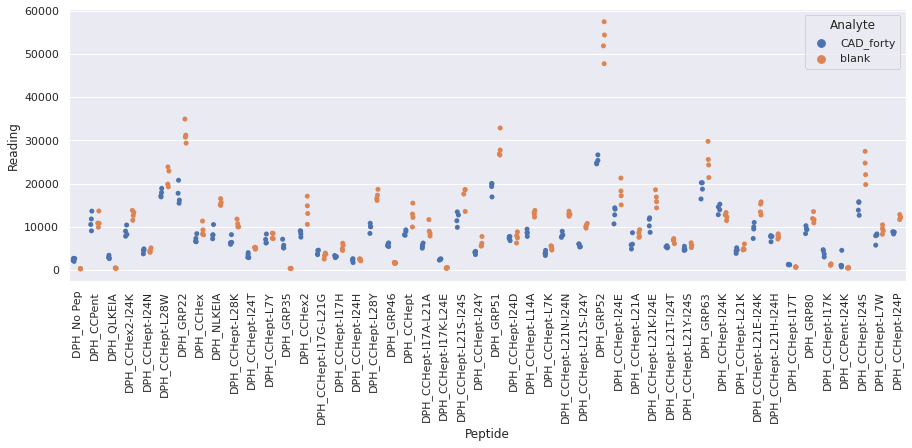

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortyone_repeat_1.xlsx
Drawing scatter plot of data spread for CAD_fortyone_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

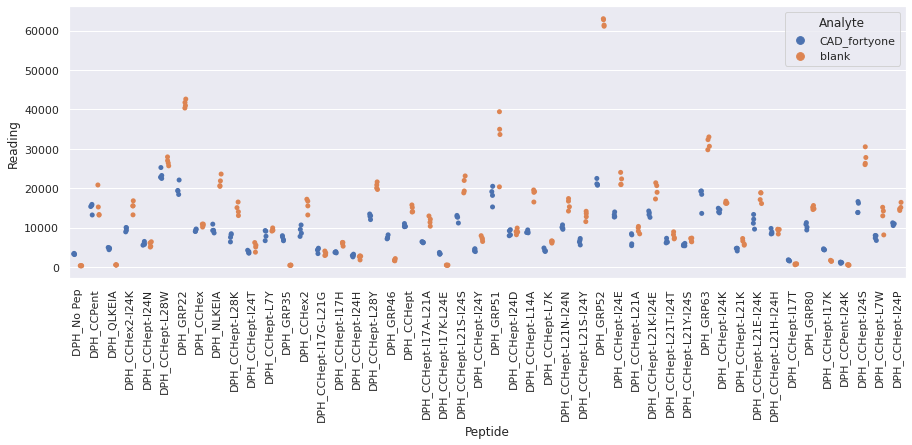

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortytwo_repeat_1.xlsx
Drawing scatter plot of data spread for CAD_fortytwo_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

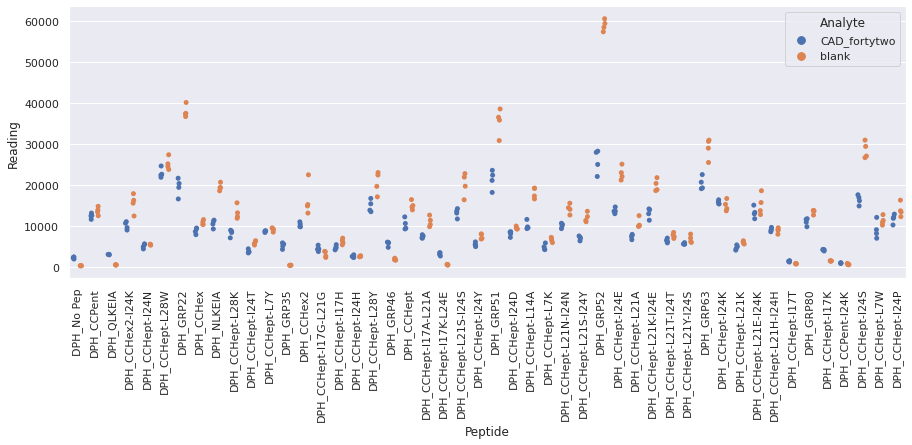

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirty_repeat_1.xlsx
Drawing scatter plot of data spread for CAD_thirty_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

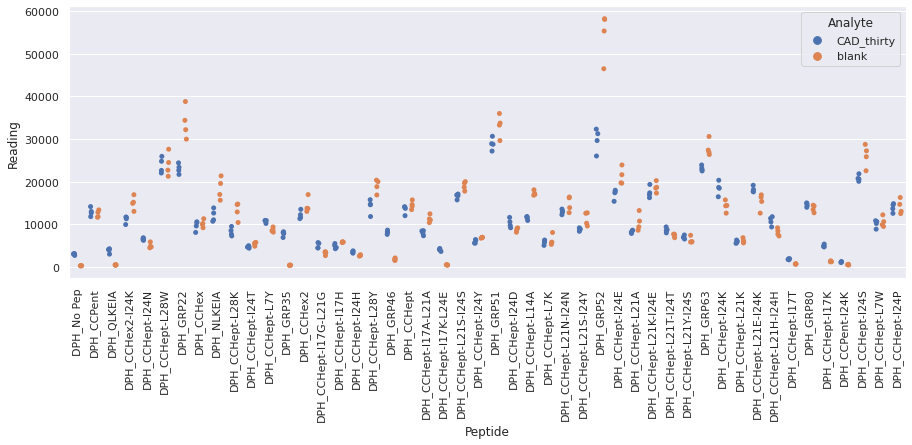

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyeight_repeat_1.xlsx
Drawing scatter plot of data spread for CAD_thirtyeight_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

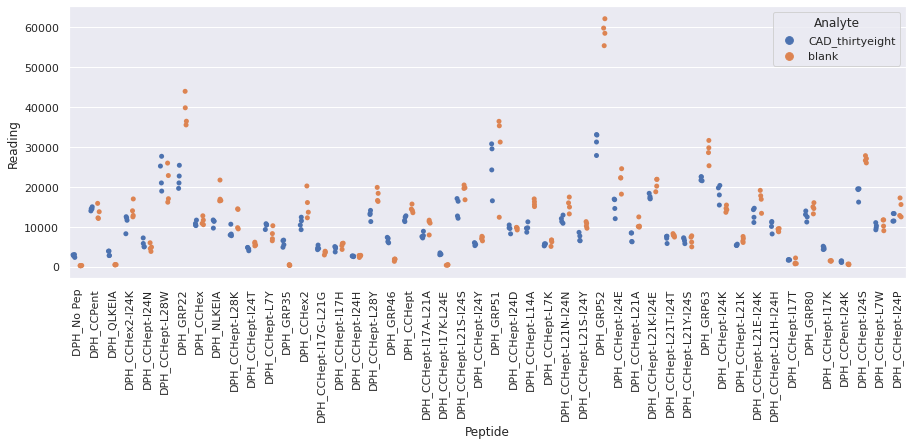

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfive_repeat_1.xlsx
Drawing scatter plot of data spread for CAD_thirtyfive_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

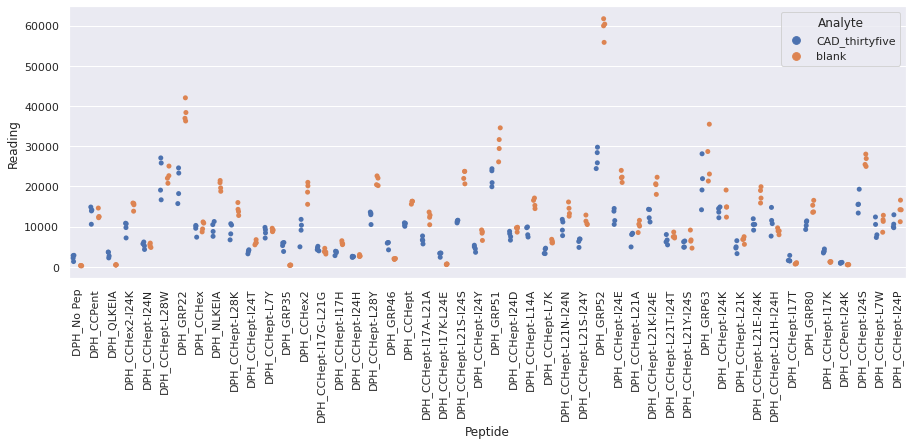

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfour_repeat_1.xlsx
Drawing scatter plot of data spread for CAD_thirtyfour_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

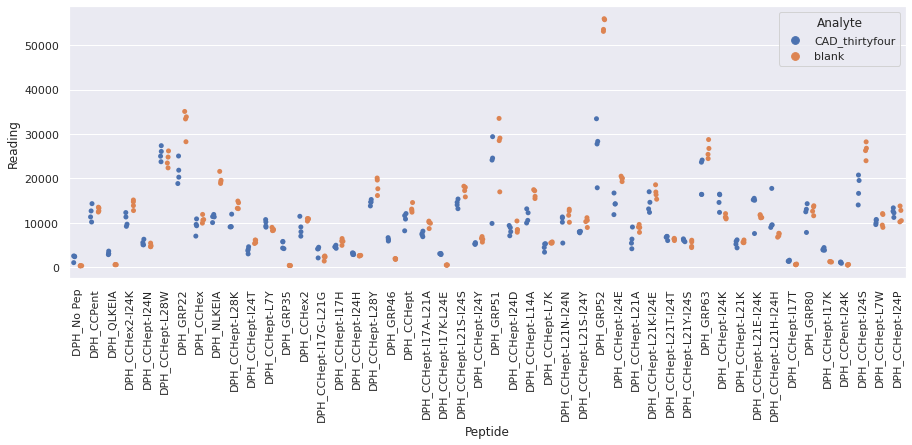

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtynine_repeat_1.xlsx
Drawing scatter plot of data spread for CAD_thirtynine_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

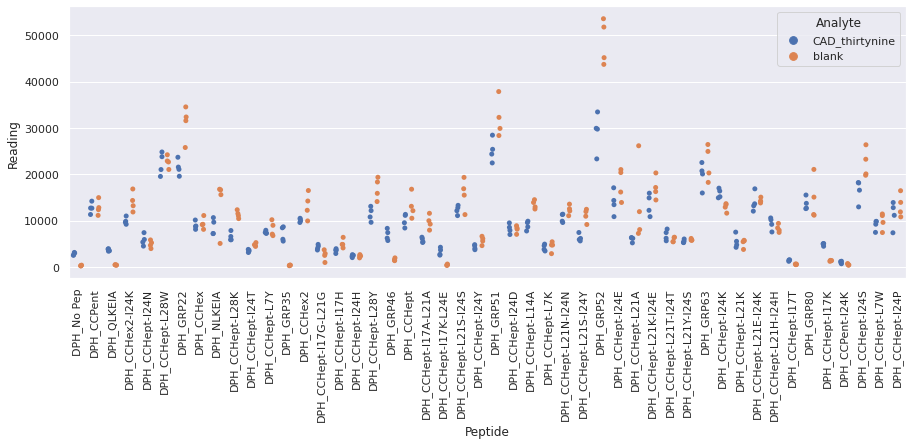

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyone_repeat_1.xlsx
Drawing scatter plot of data spread for CAD_thirtyone_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

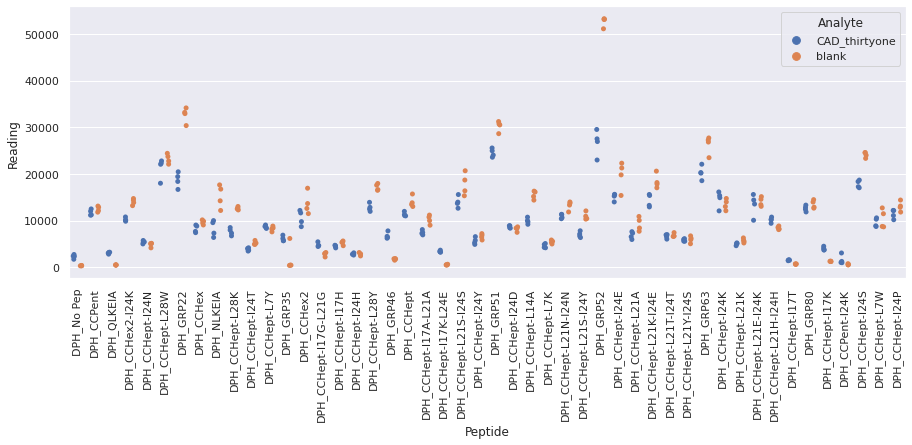

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyseven_repeat_1.xlsx
Drawing scatter plot of data spread for CAD_thirtyseven_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

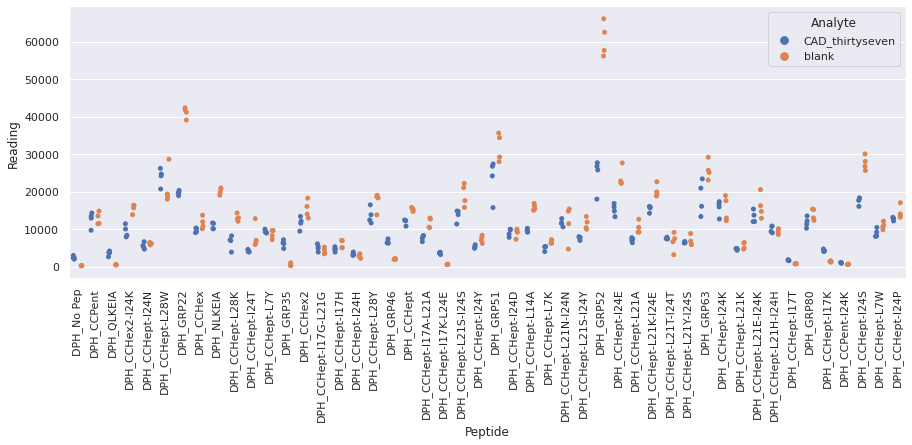

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtysix_repeat_1.xlsx
Drawing scatter plot of data spread for CAD_thirtysix_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

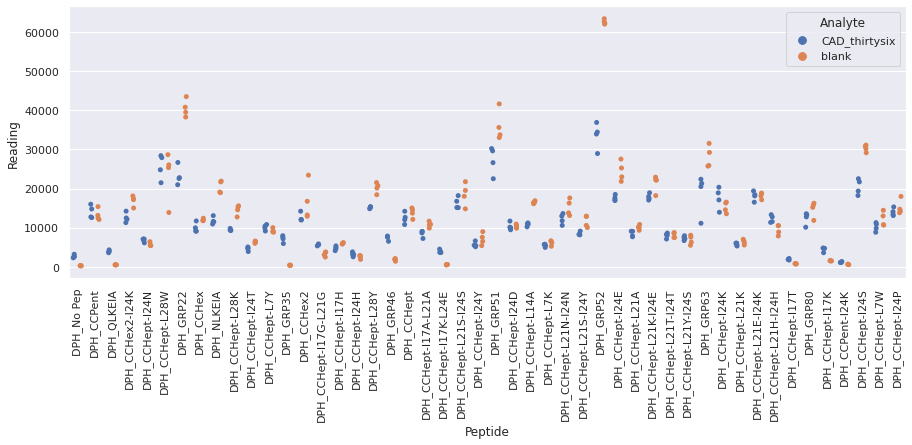

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtythree_repeat_1.xlsx
Drawing scatter plot of data spread for CAD_thirtythree_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

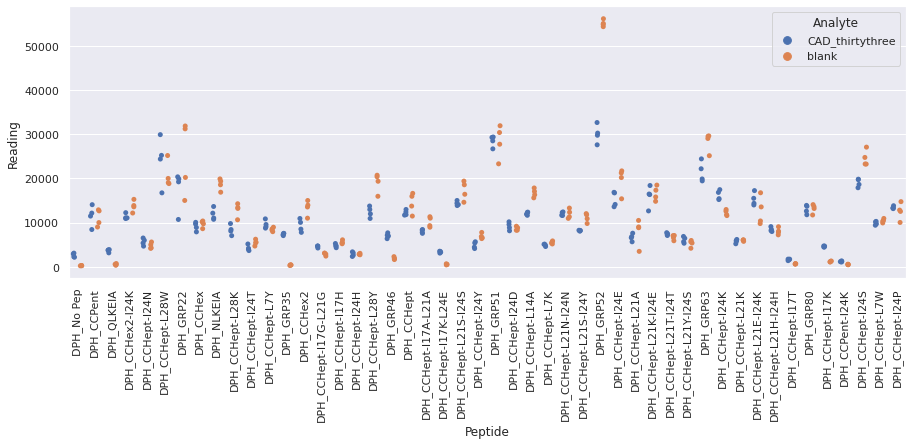

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtytwo_repeat_1.xlsx
Drawing scatter plot of data spread for CAD_thirtytwo_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

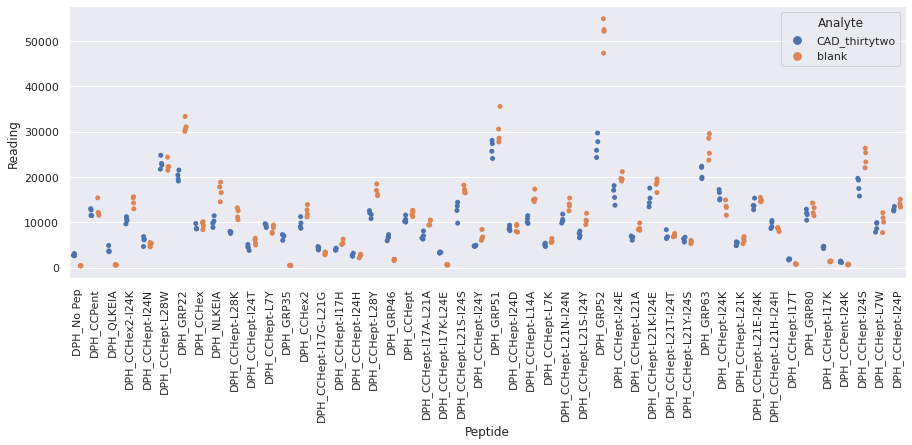

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_twentynine_repeat_1.xlsx
Drawing scatter plot of data spread for CAD_twentynine_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

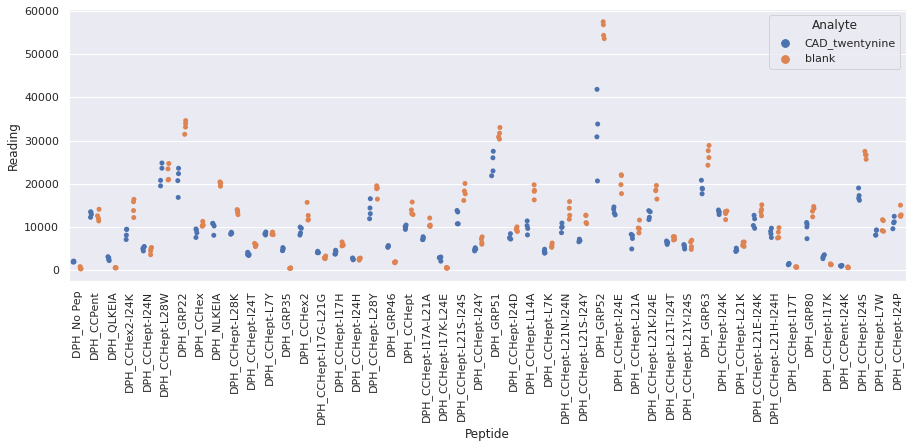

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_eighteen_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_eighteen_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

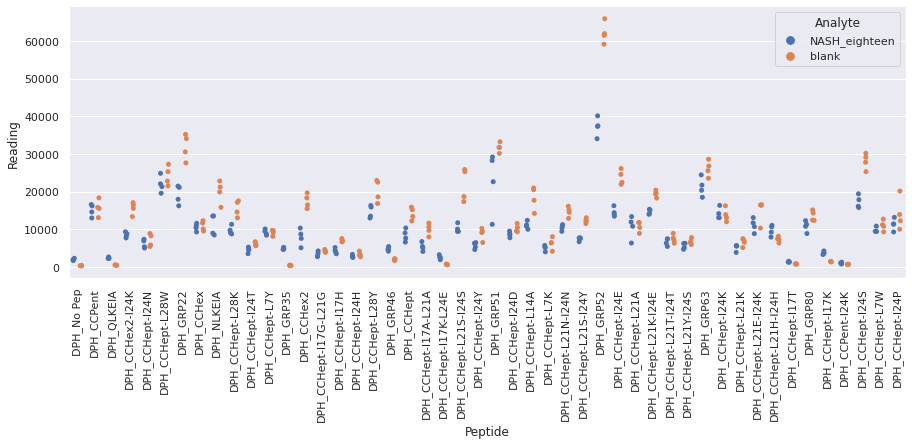

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_fifteen_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_fifteen_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

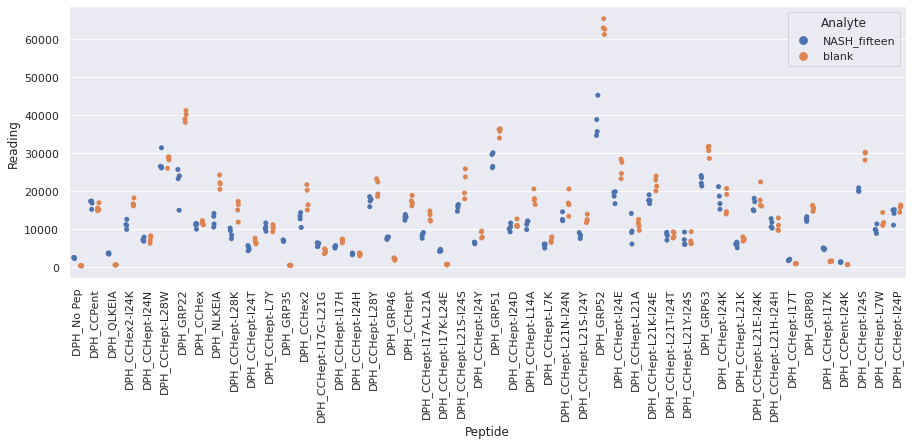

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_nineteen_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_nineteen_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

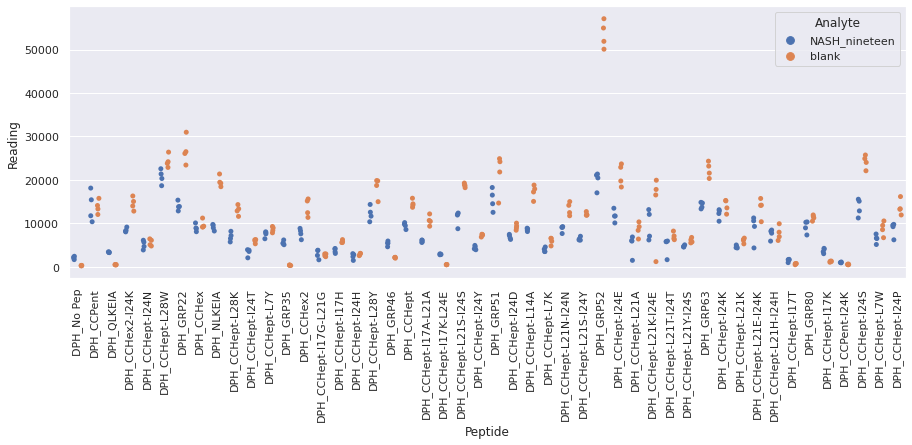

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_seventeen_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_seventeen_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

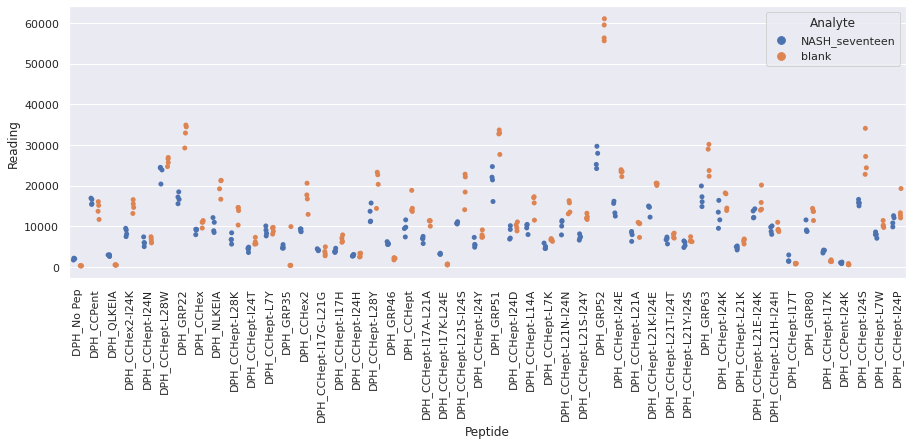

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_sixteen_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_sixteen_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

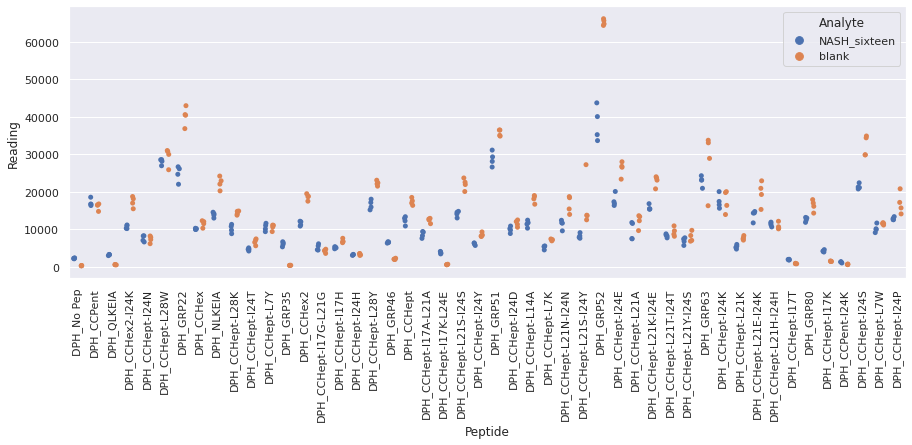

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twenty_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_twenty_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

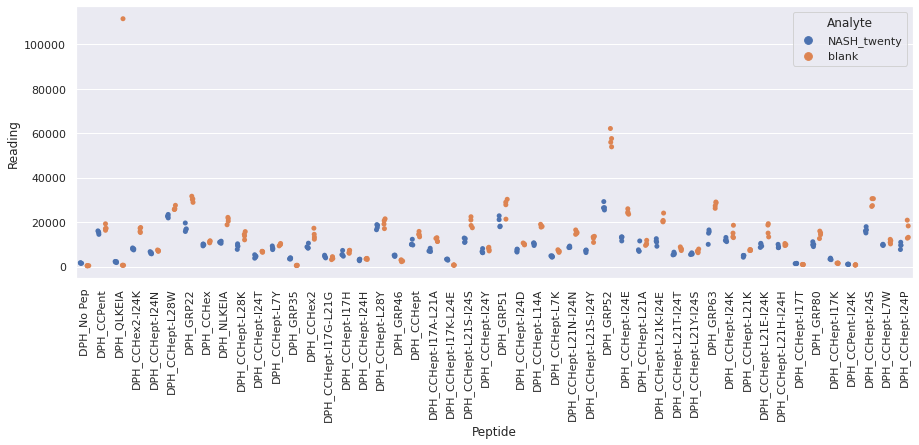

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyeight_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_twentyeight_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

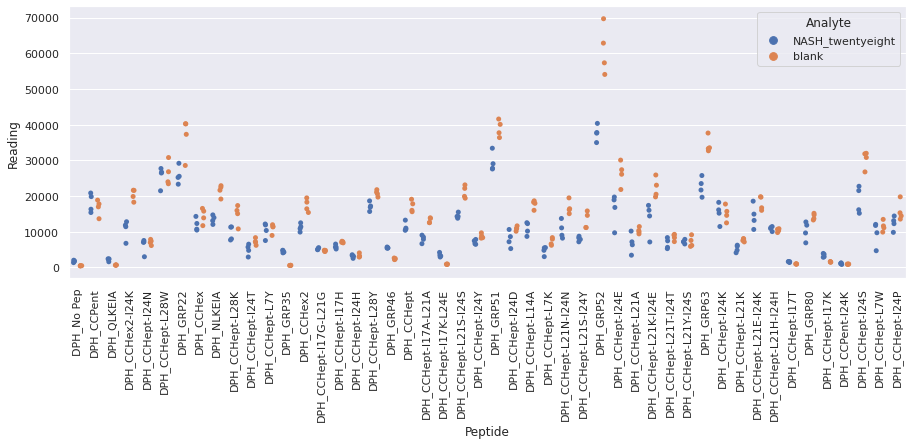

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfive_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_twentyfive_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

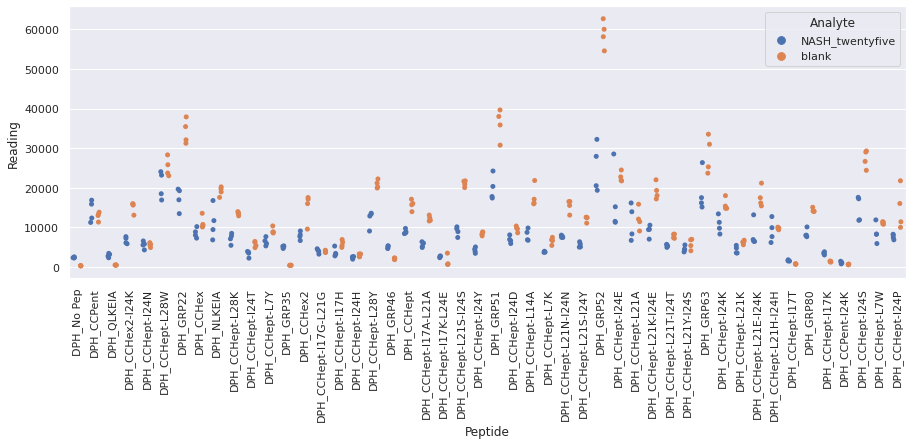

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfour_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_twentyfour_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

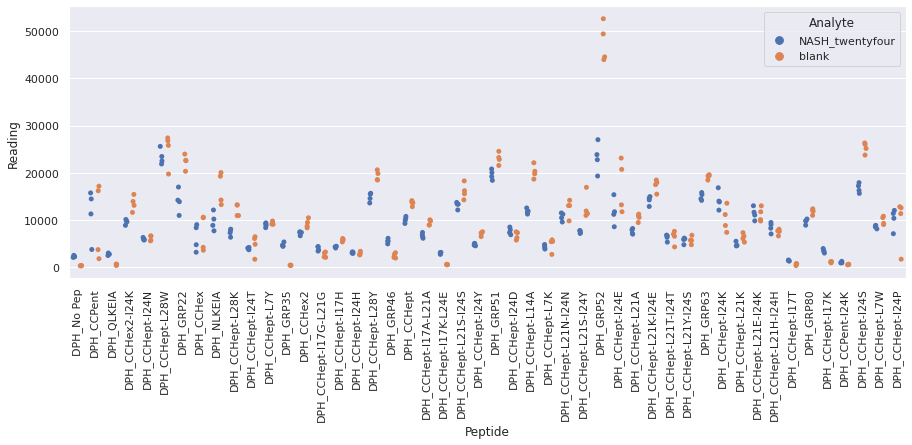

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyone_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_twentyone_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

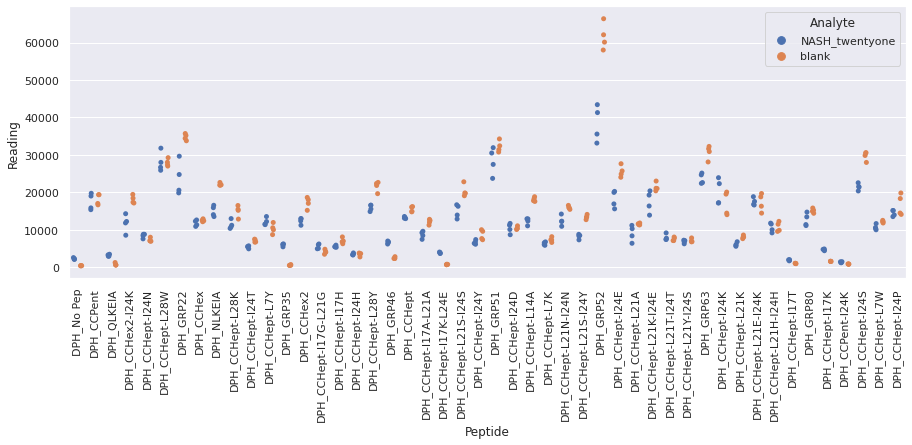

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyseven_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_twentyseven_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

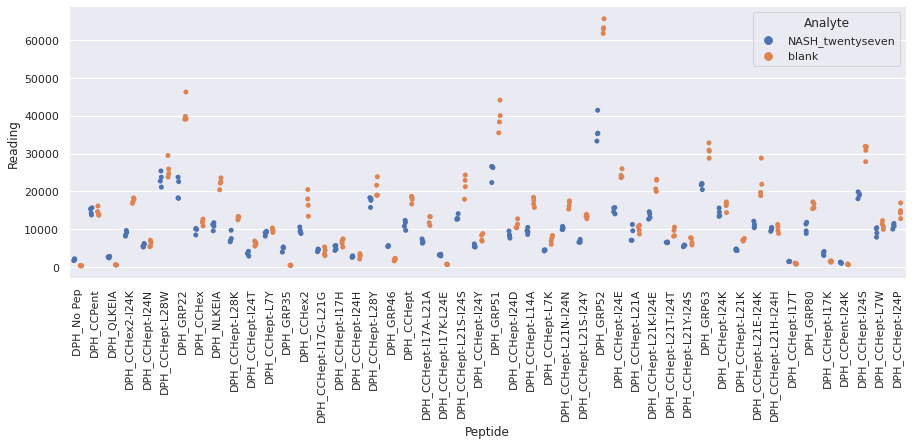

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentysix_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_twentysix_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

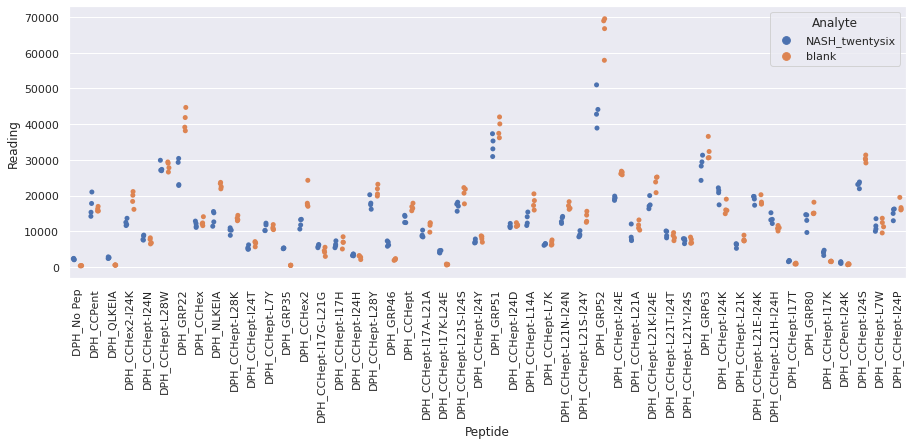

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentythree_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_twentythree_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

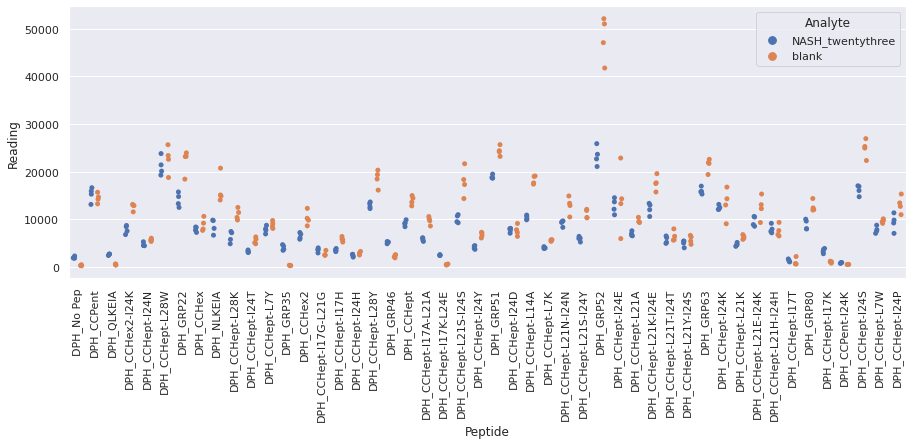

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentytwo_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_twentytwo_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

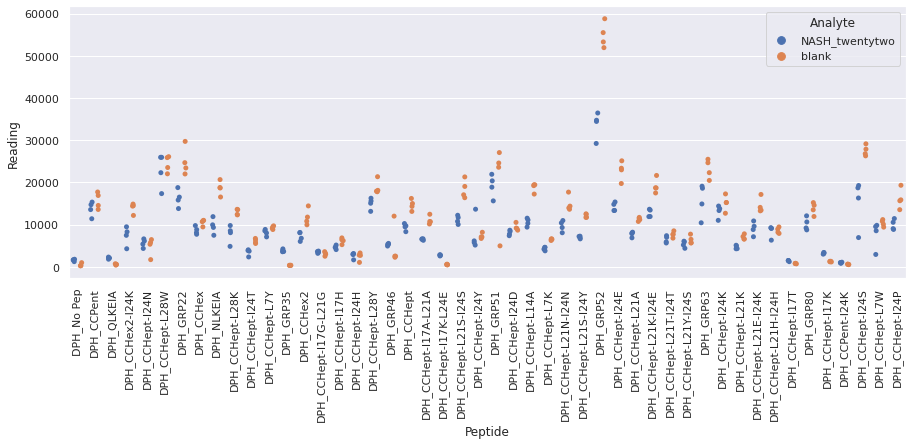

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eight_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_eight_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

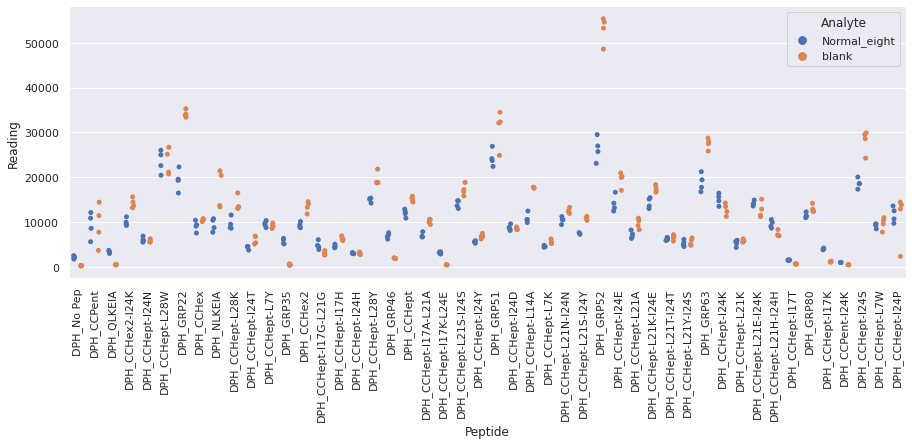

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eleven_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_eleven_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

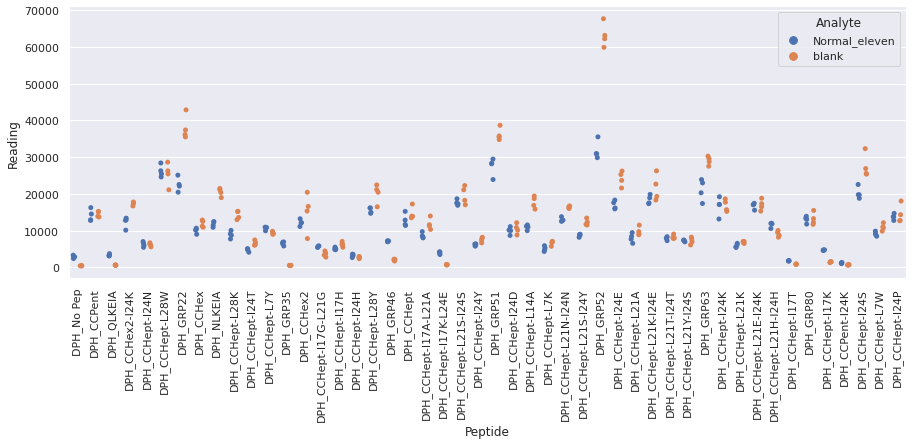

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_five_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_five_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

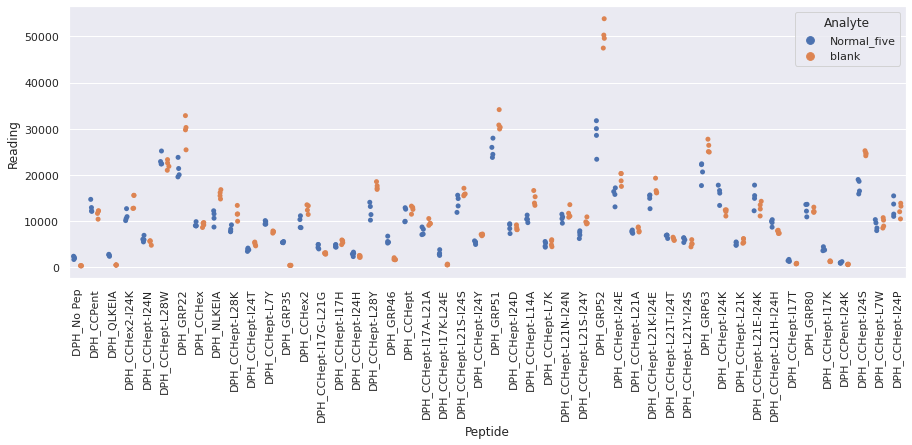

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_four_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_four_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

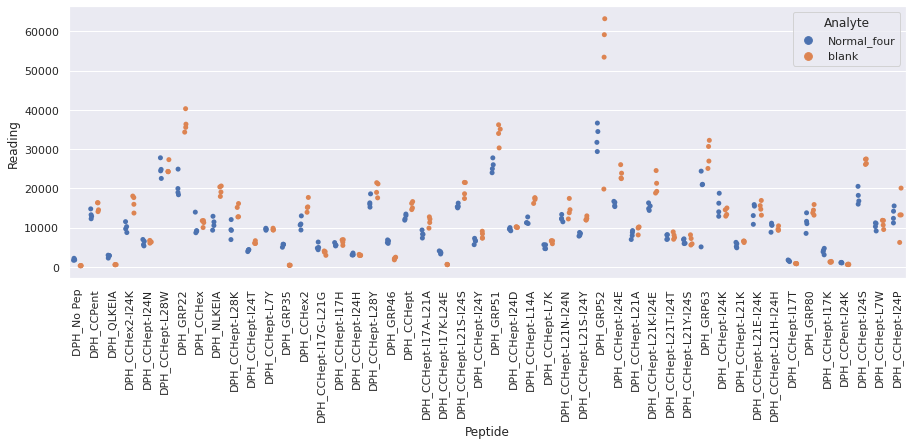

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_fourteen_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_fourteen_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

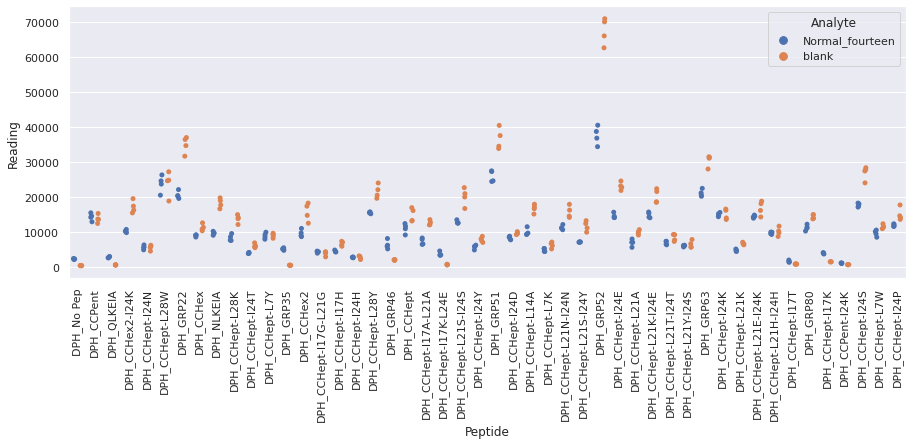

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_nine_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_nine_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

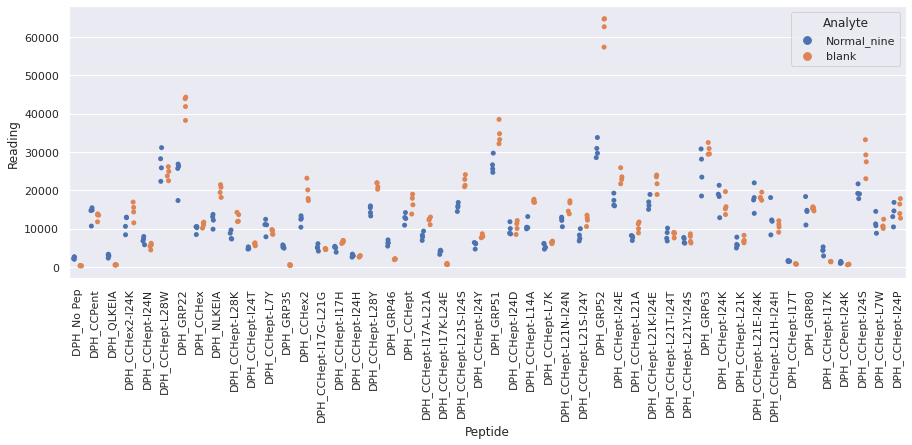

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_one_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_one_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

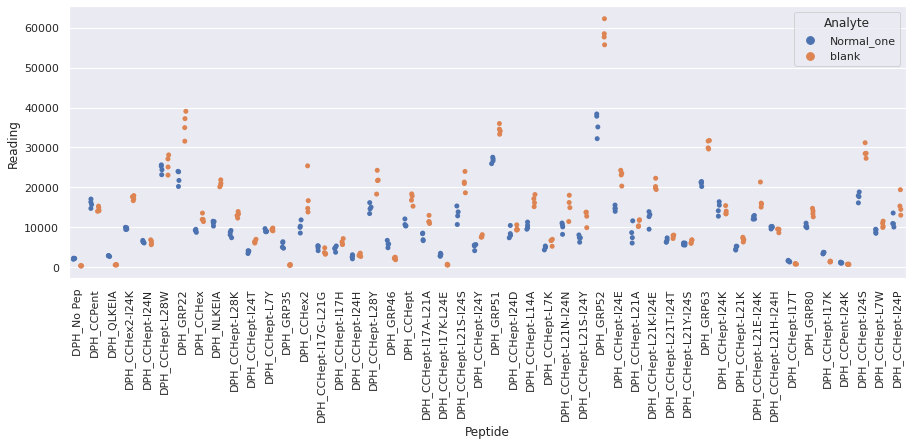

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_seven_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_seven_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

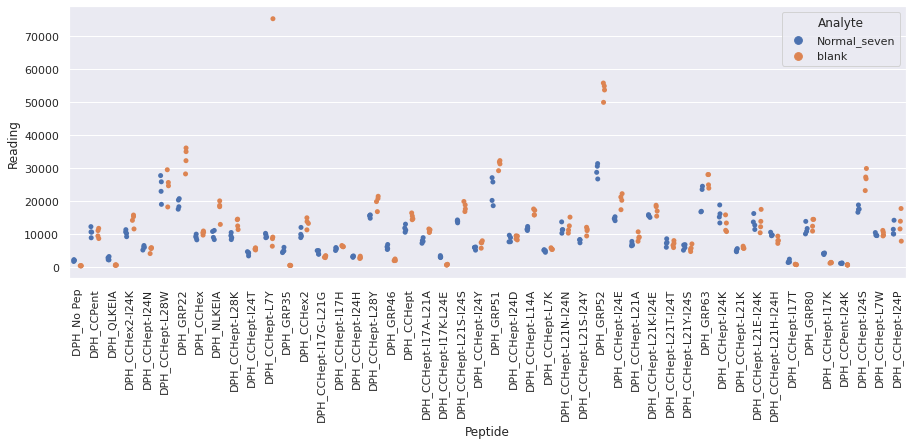

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_six_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_six_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

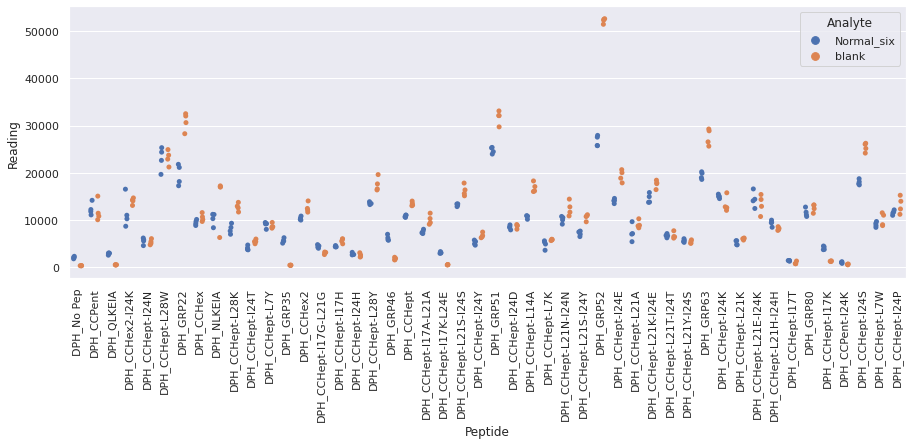

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_ten_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_ten_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

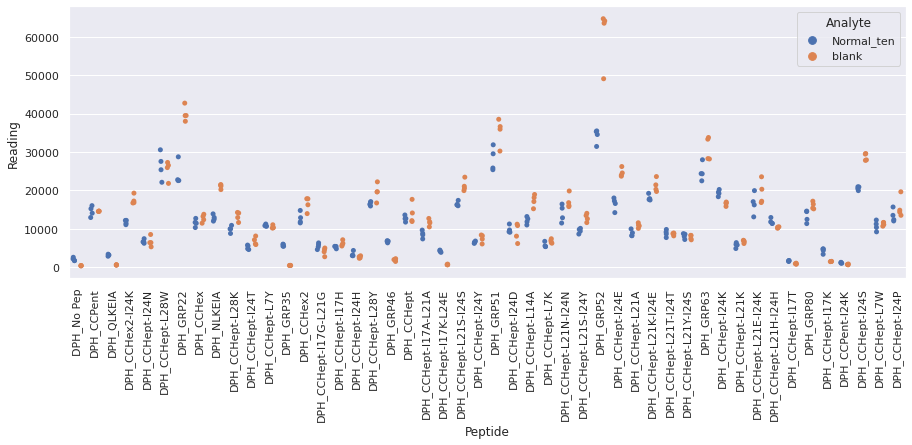

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_thirteen_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_thirteen_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

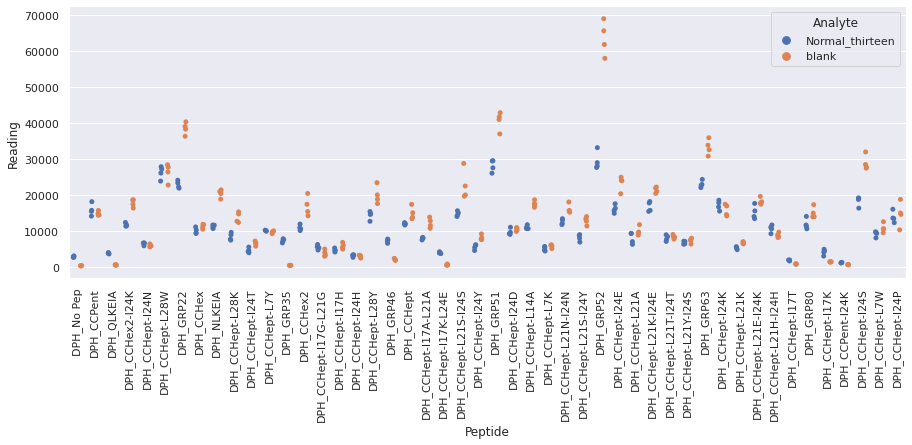

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_three_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_three_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

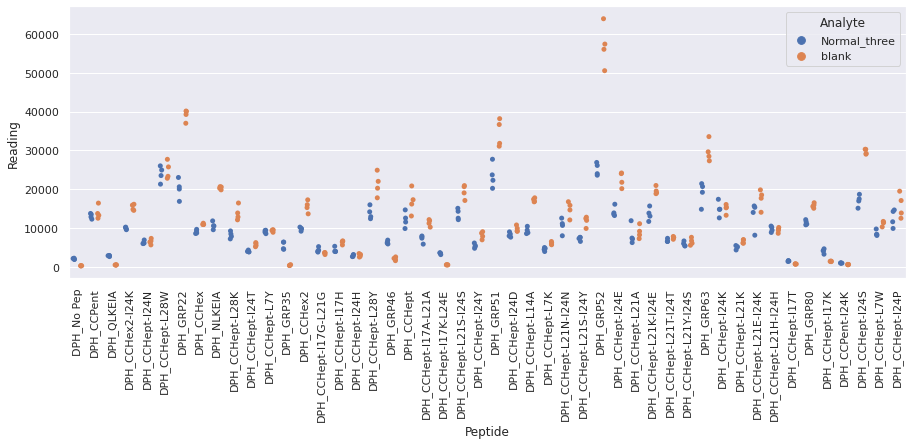

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_twelve_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_twelve_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

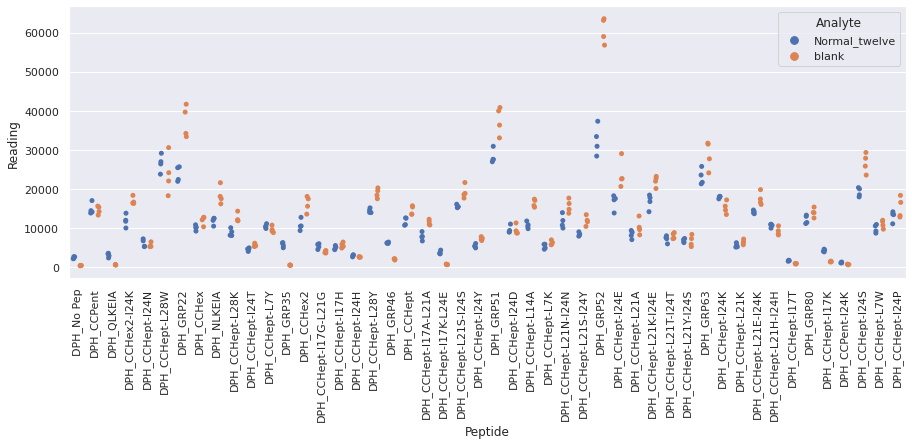

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_two_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_two_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

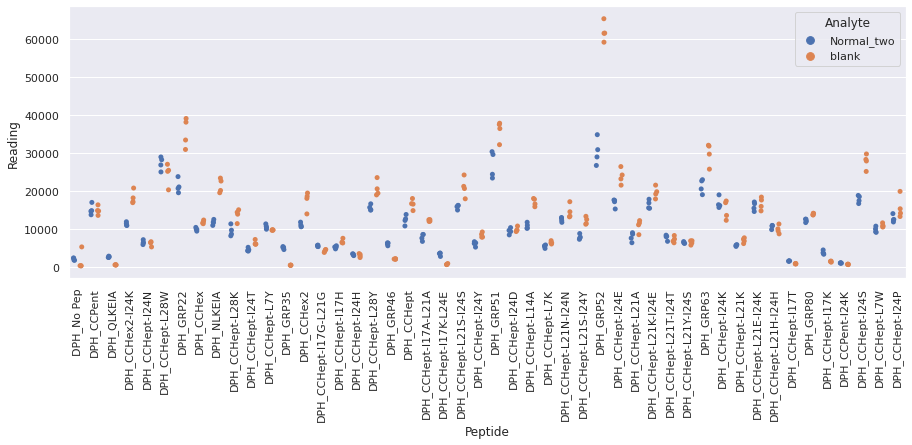

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_forty_repeat_2.xlsx
Drawing scatter plot of data spread for CAD_forty_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

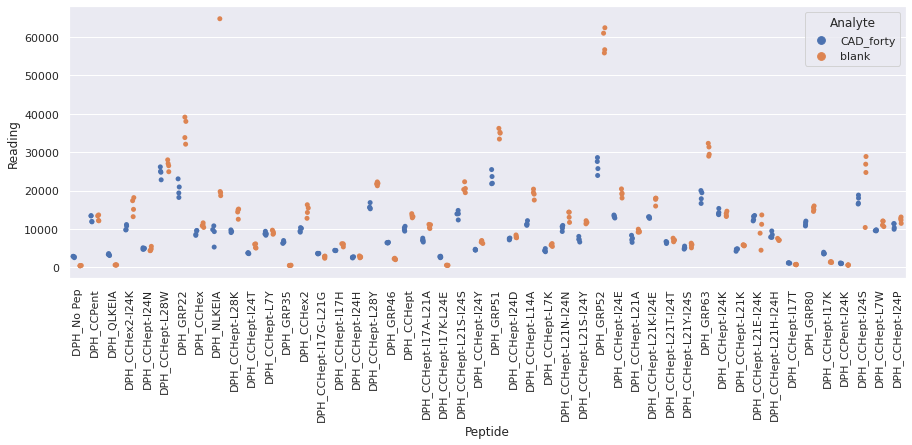

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortyone_repeat_2.xlsx
Drawing scatter plot of data spread for CAD_fortyone_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

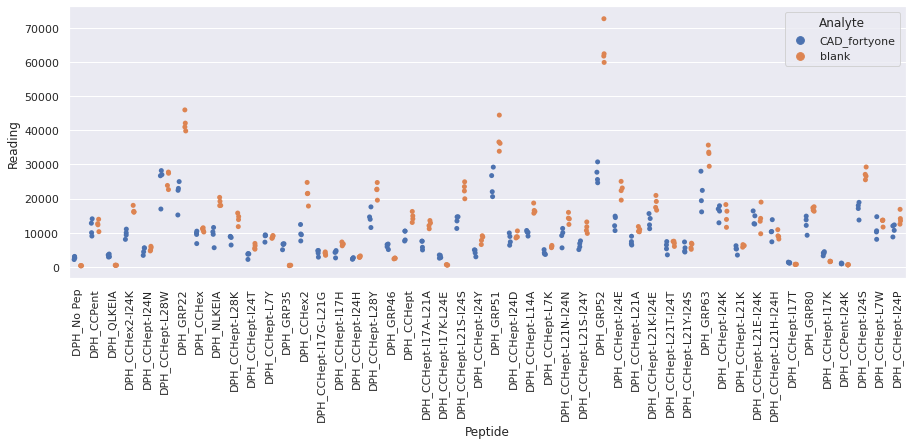

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortytwo_repeat_2.xlsx
Drawing scatter plot of data spread for CAD_fortytwo_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

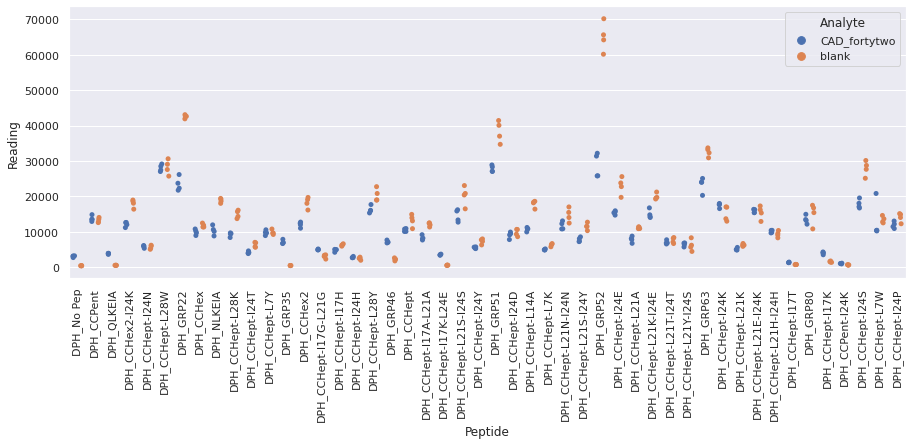

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirty_repeat_2.xlsx
Drawing scatter plot of data spread for CAD_thirty_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

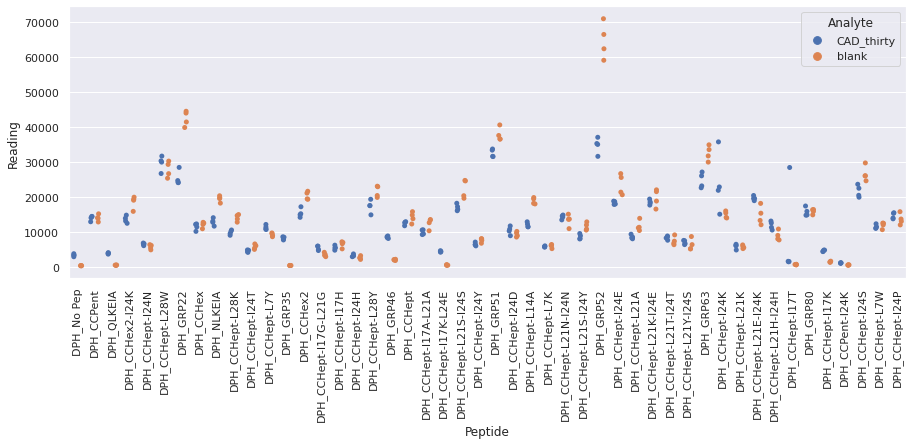

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyeight_repeat_2.xlsx
Drawing scatter plot of data spread for CAD_thirtyeight_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

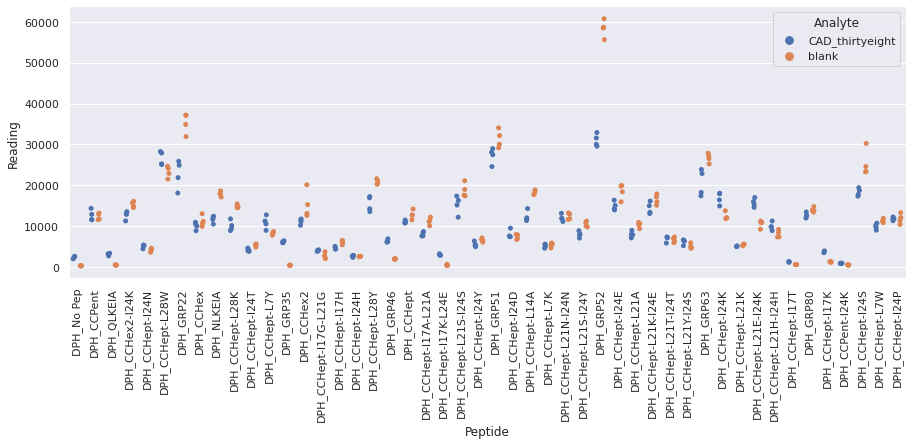

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfive_repeat_2.xlsx
Drawing scatter plot of data spread for CAD_thirtyfive_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

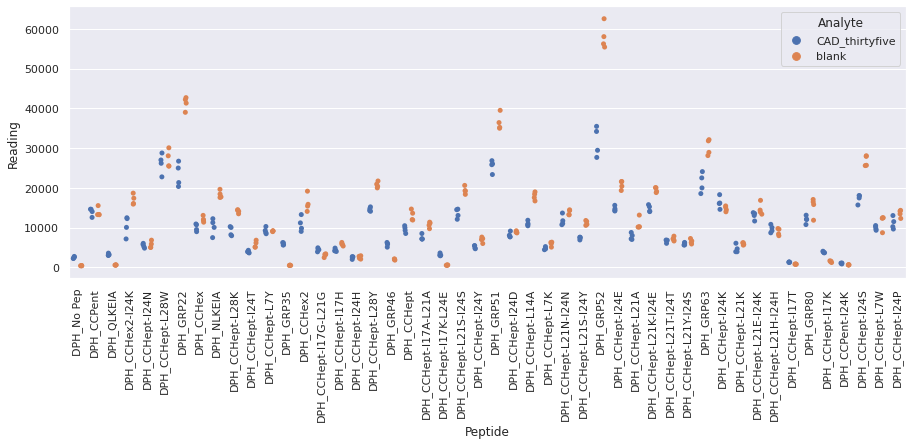

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfour_repeat_2.xlsx
Drawing scatter plot of data spread for CAD_thirtyfour_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

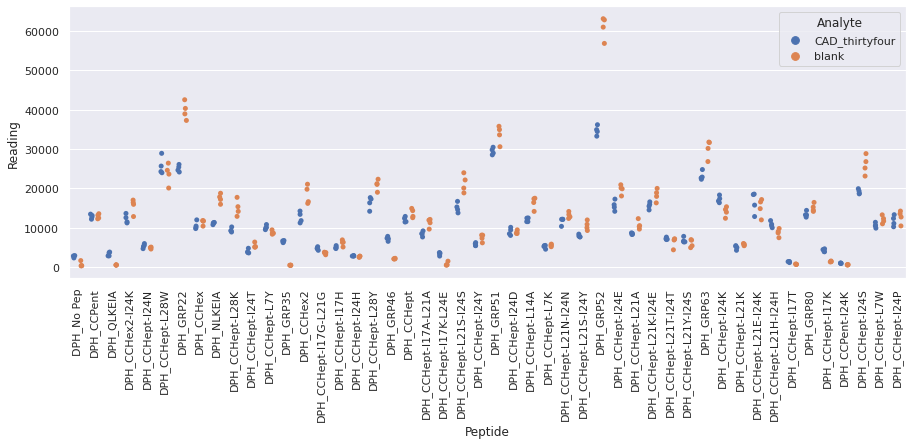

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtynine_repeat_2.xlsx
Drawing scatter plot of data spread for CAD_thirtynine_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

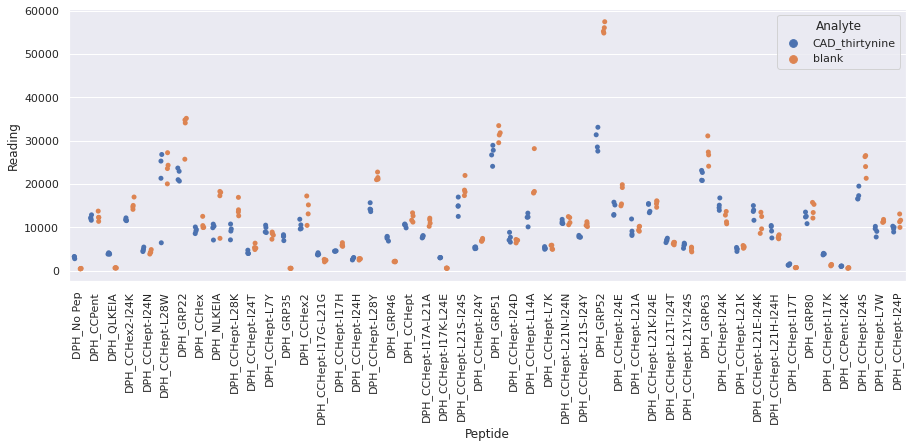

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyone_repeat_2.xlsx
Drawing scatter plot of data spread for CAD_thirtyone_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

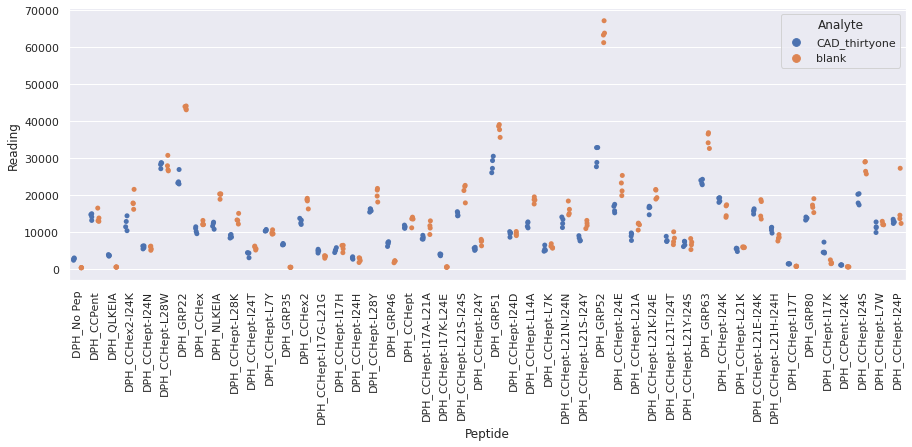

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyseven_repeat_2.xlsx
Drawing scatter plot of data spread for CAD_thirtyseven_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

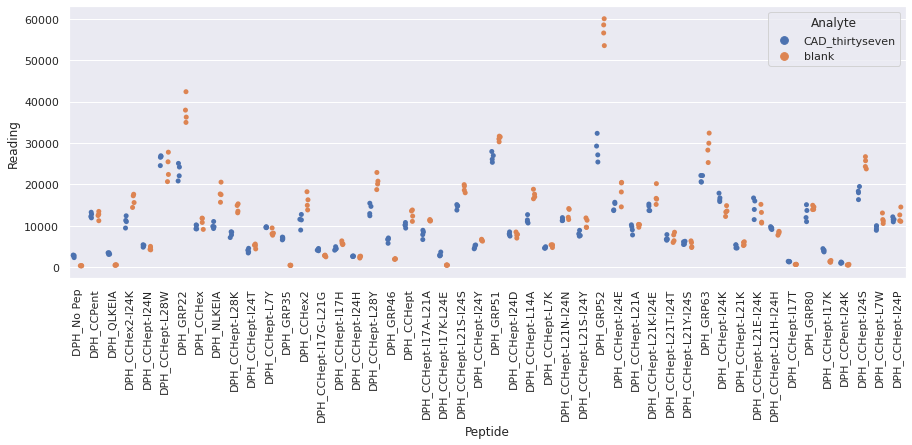

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtysix_repeat_2.xlsx
Drawing scatter plot of data spread for CAD_thirtysix_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

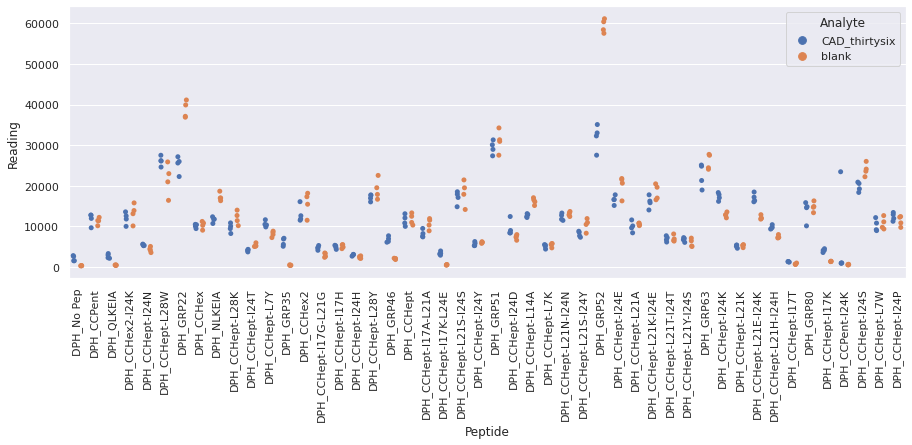

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtythree_repeat_2.xlsx
Drawing scatter plot of data spread for CAD_thirtythree_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

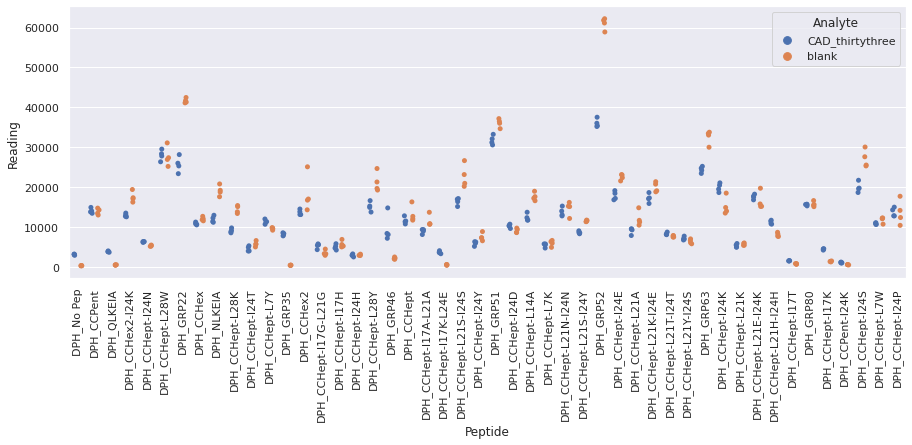

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtytwo_repeat_2.xlsx
Drawing scatter plot of data spread for CAD_thirtytwo_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

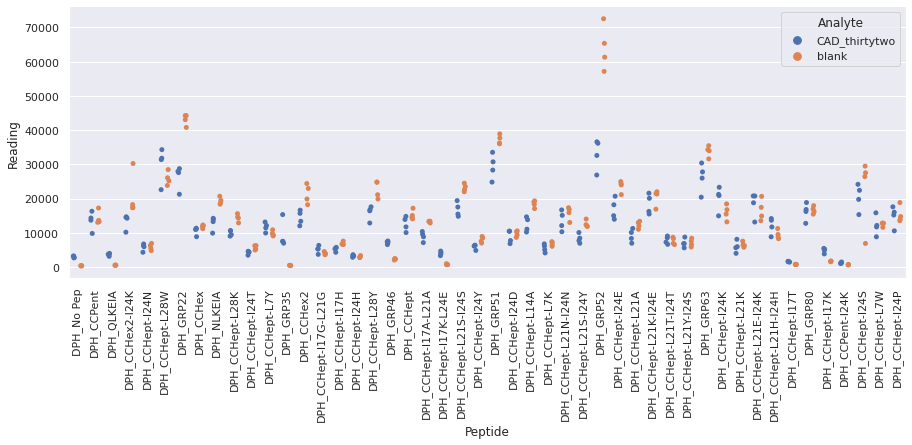

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_twentynine_repeat_2.xlsx
Drawing scatter plot of data spread for CAD_twentynine_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

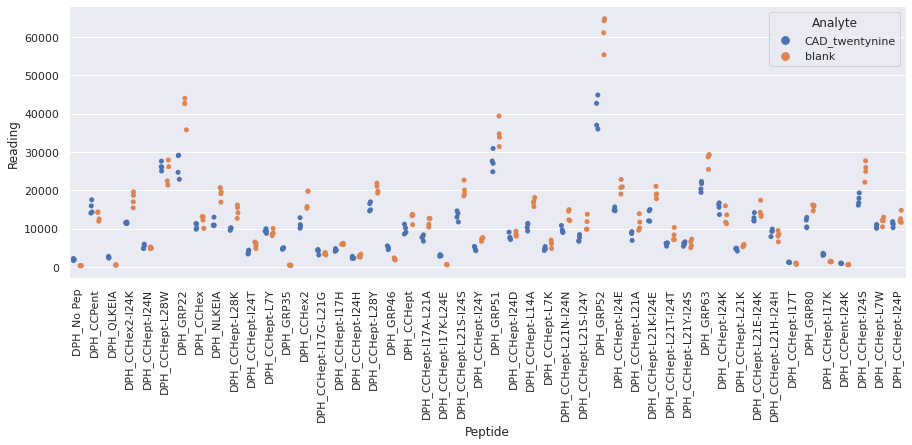

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_eighteen_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_eighteen_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

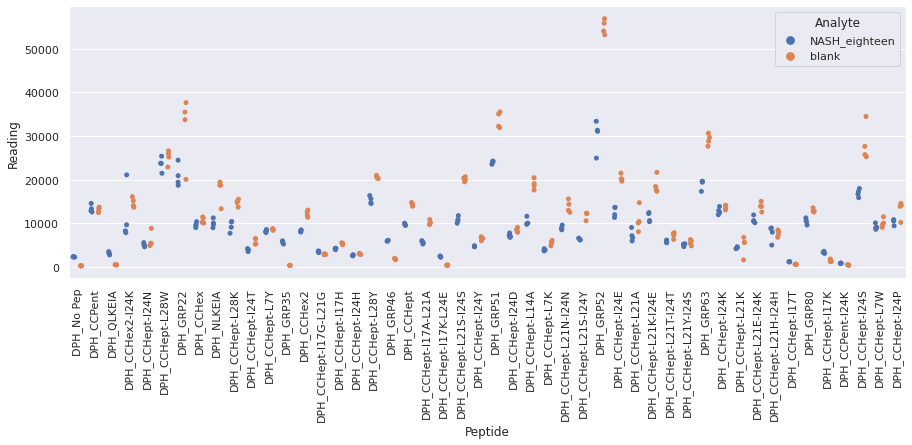

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_fifteen_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_fifteen_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

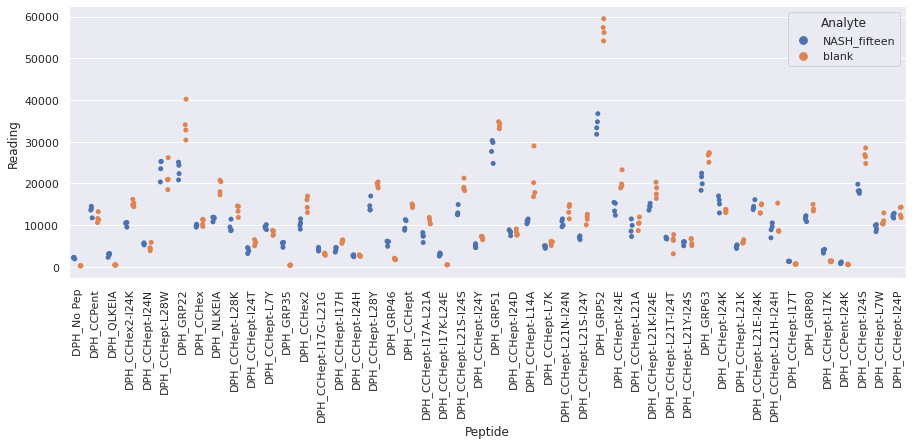

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_nineteen_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_nineteen_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

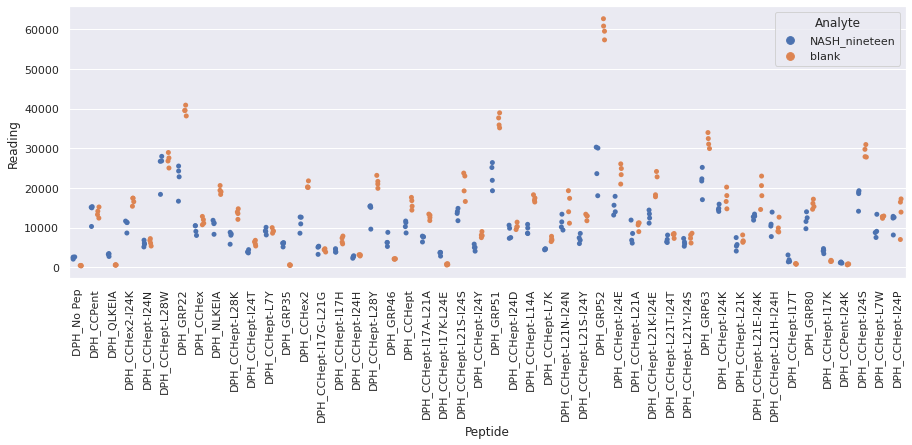

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_seventeen_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_seventeen_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

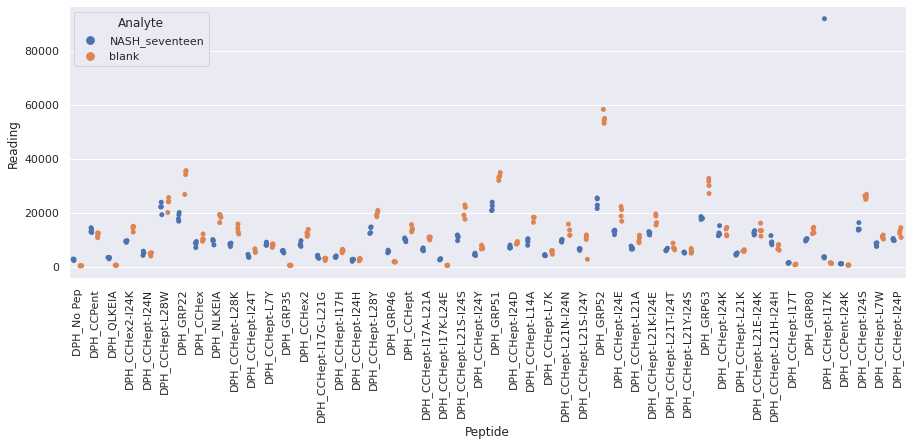

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_sixteen_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_sixteen_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

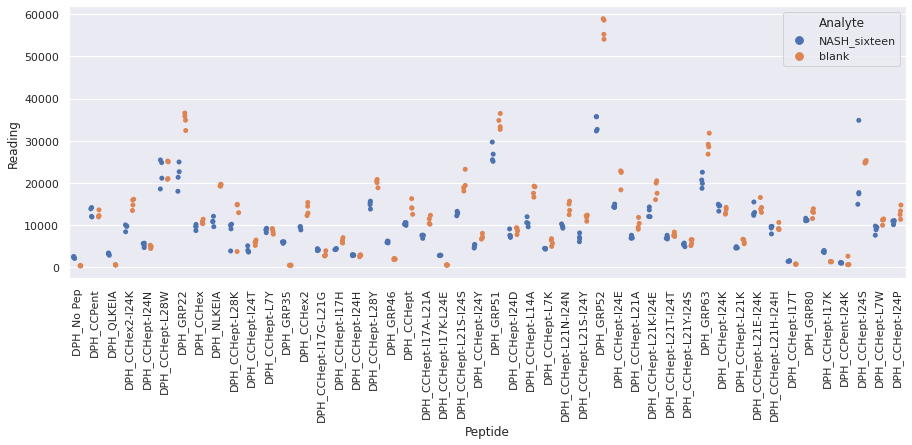

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twenty_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_twenty_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

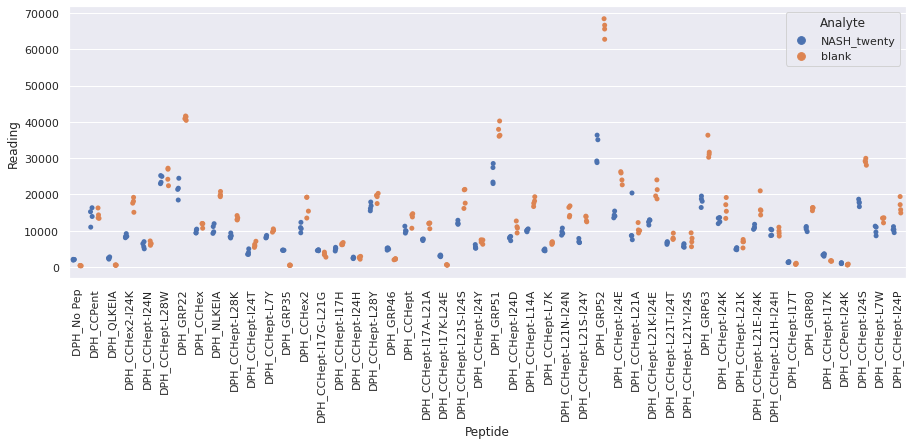

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyeight_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_twentyeight_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

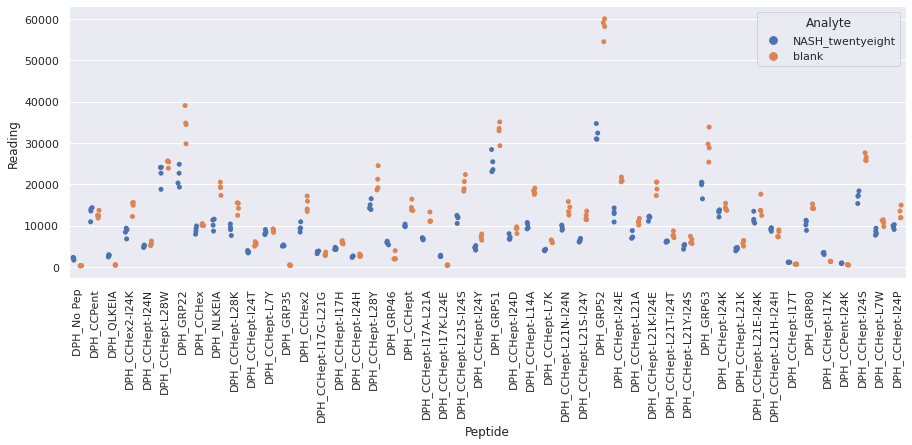

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfive_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_twentyfive_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

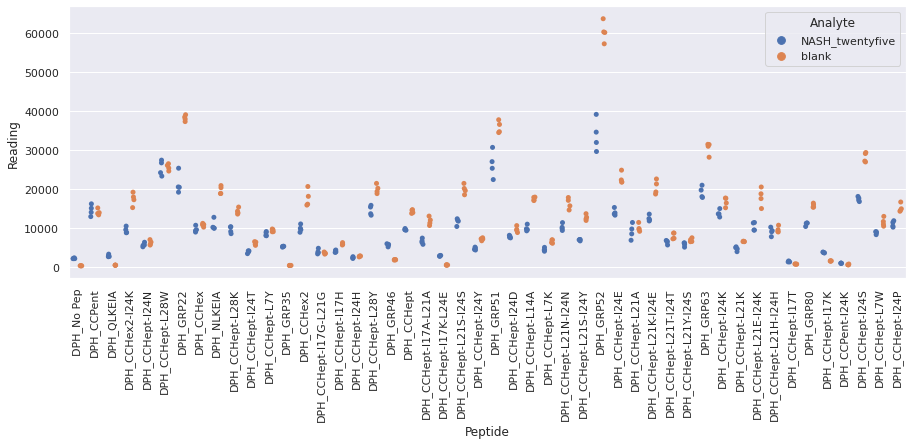

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfour_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_twentyfour_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

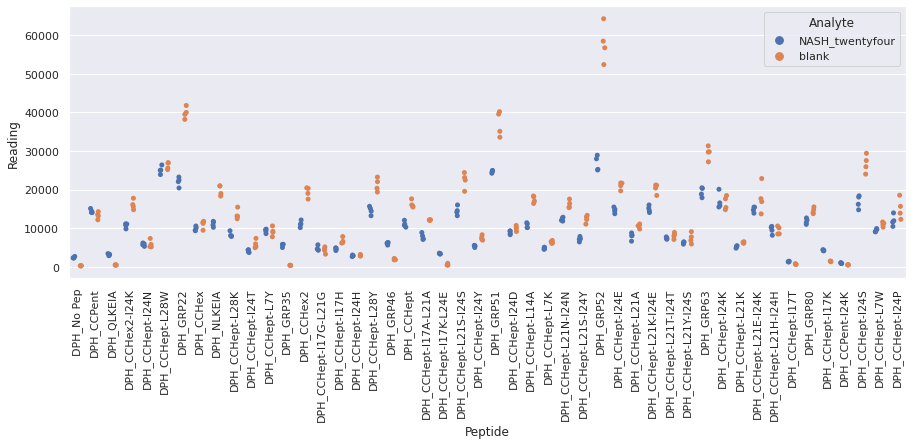

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyone_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_twentyone_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

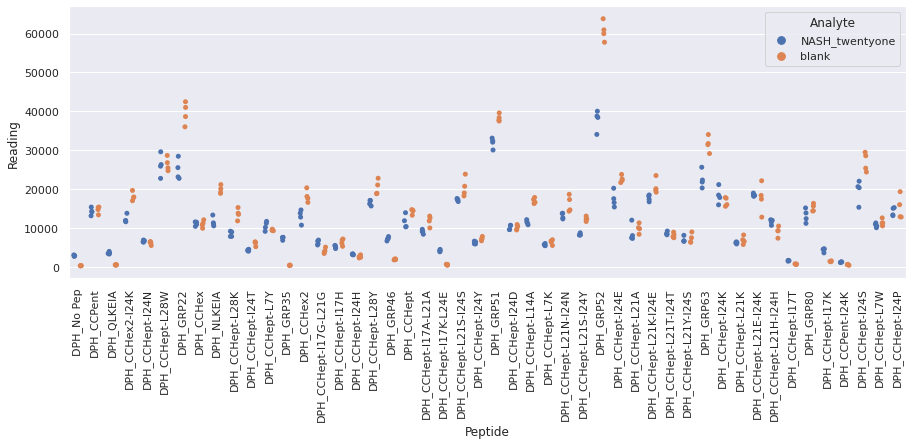

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyseven_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_twentyseven_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

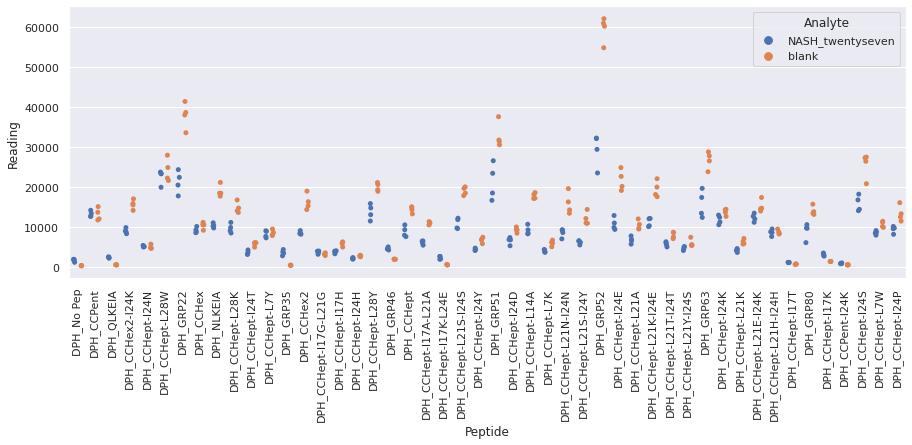

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentysix_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_twentysix_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

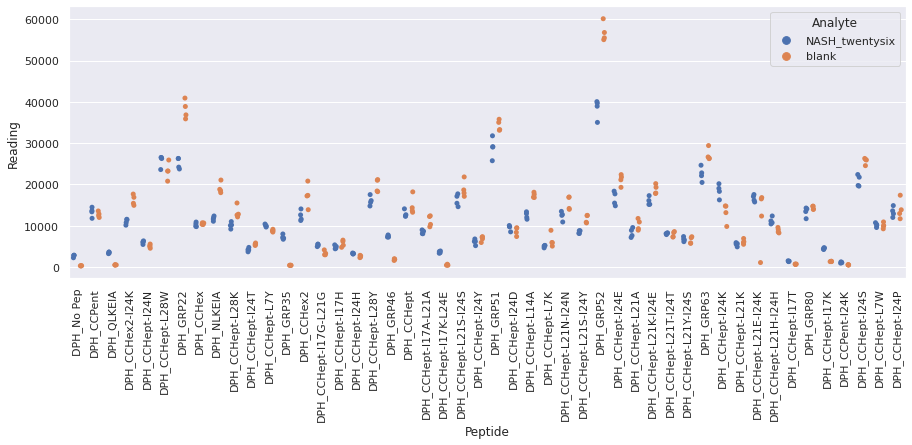

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentythree_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_twentythree_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

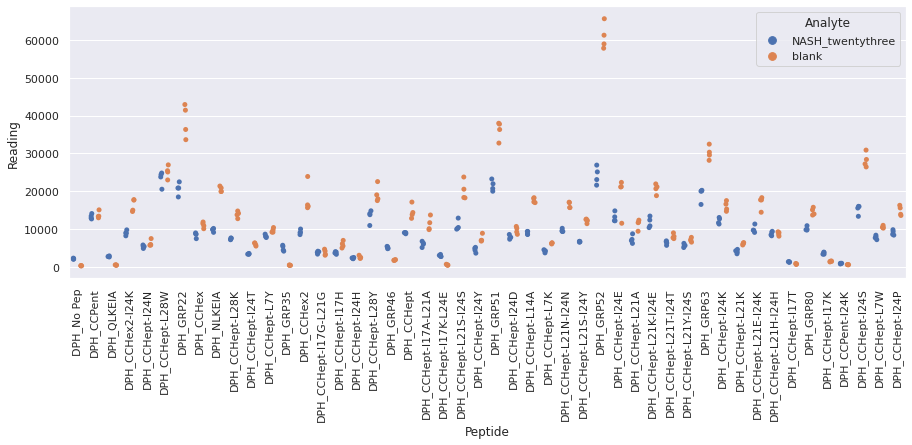

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentytwo_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_twentytwo_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

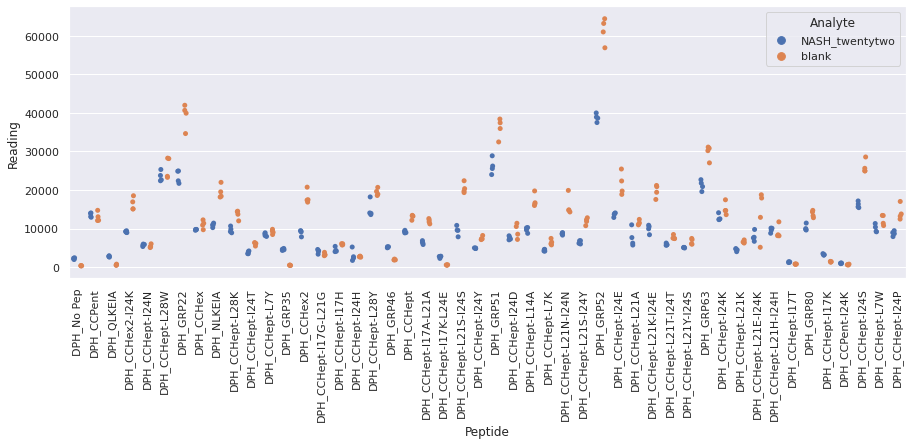

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eight_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_eight_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

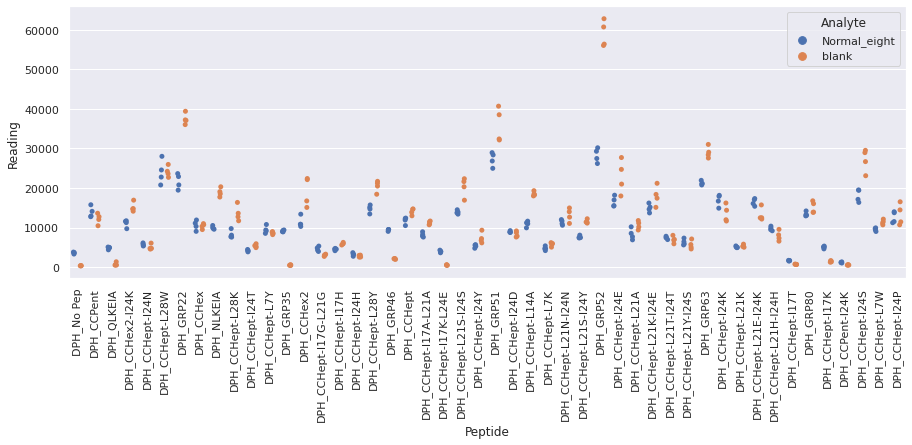

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eleven_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_eleven_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

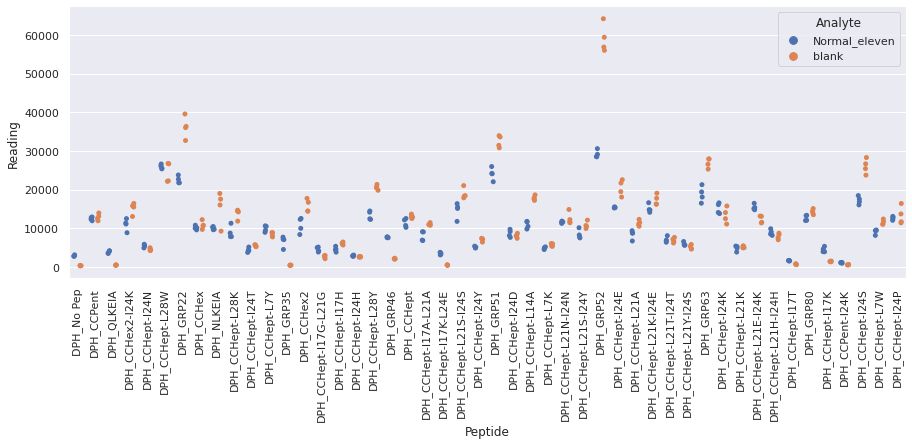

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_five_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_five_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

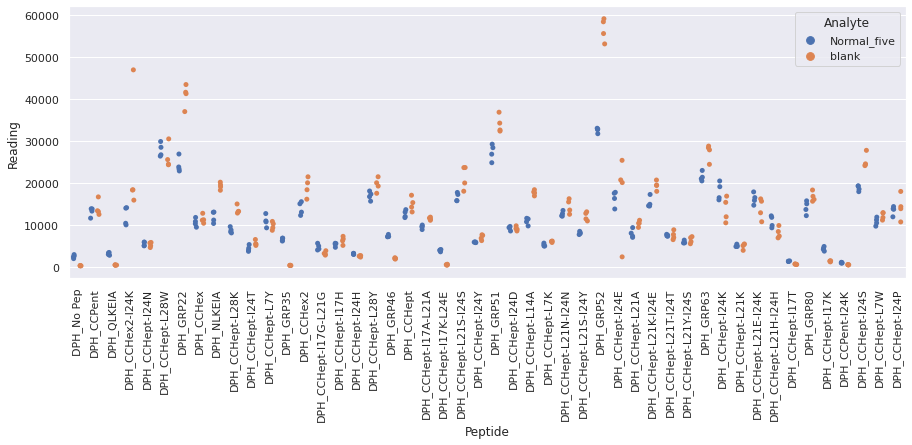

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_four_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_four_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

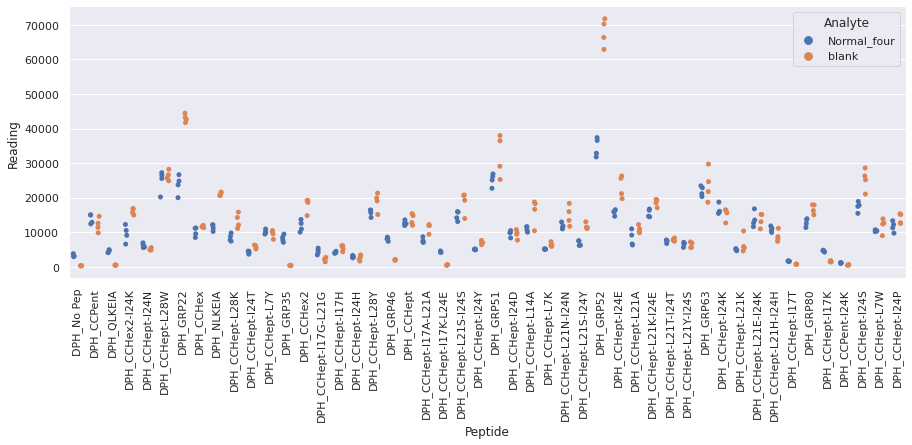

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_fourteen_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_fourteen_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

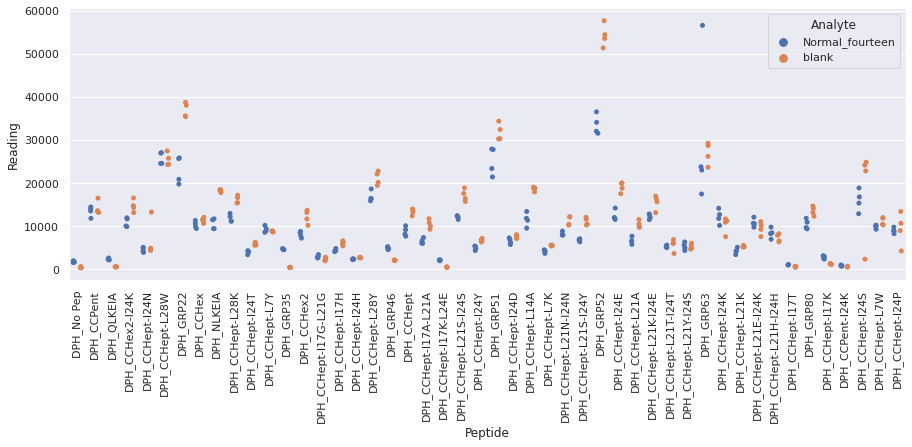

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_nine_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_nine_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

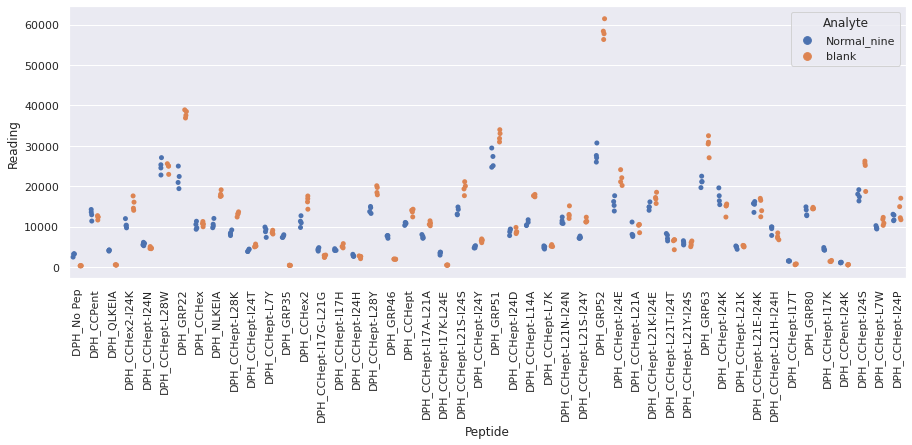

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_one_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_one_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

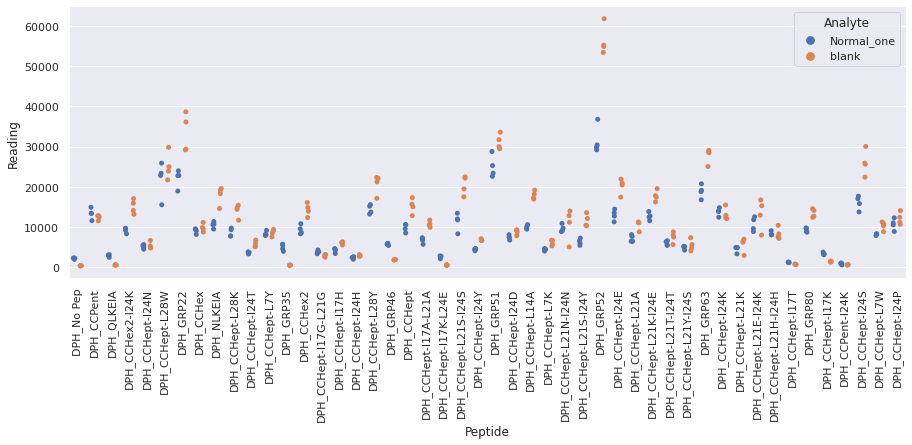

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_seven_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_seven_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

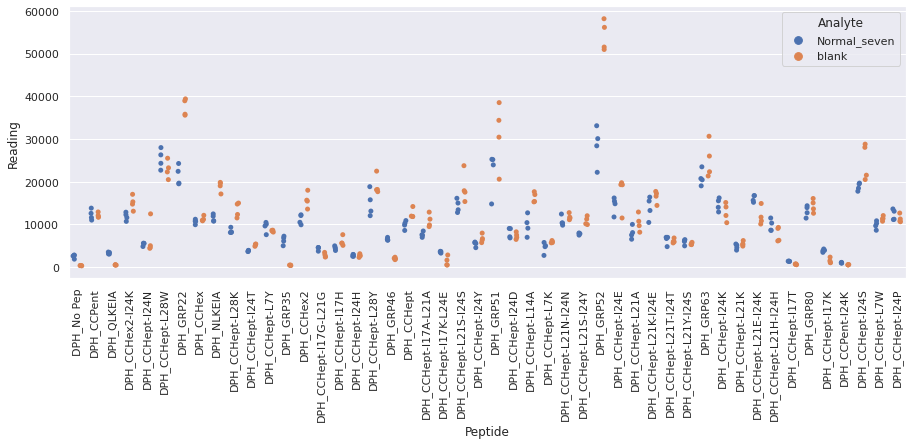

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_six_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_six_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

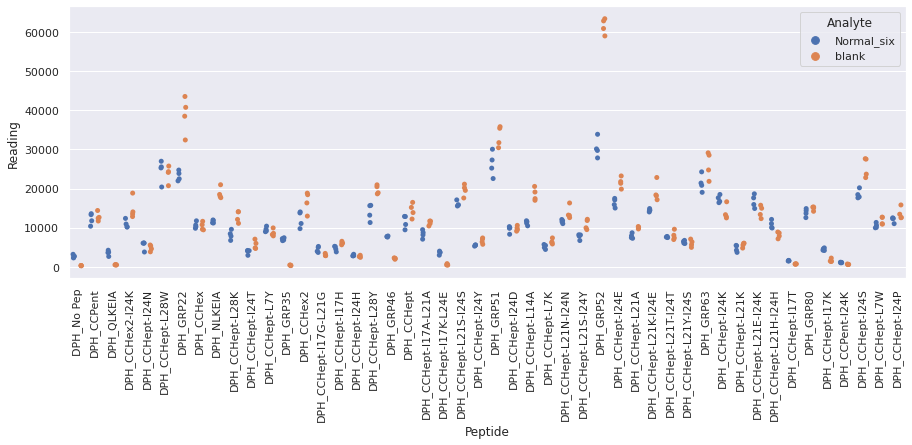

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_ten_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_ten_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

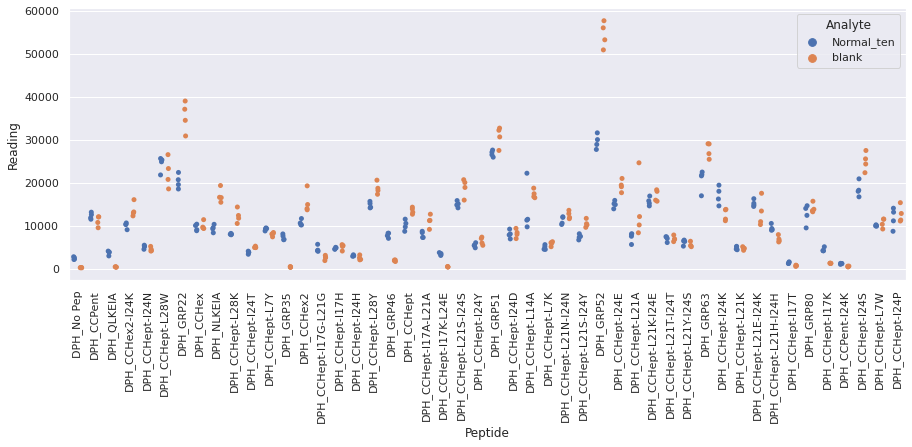

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_thirteen_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_thirteen_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

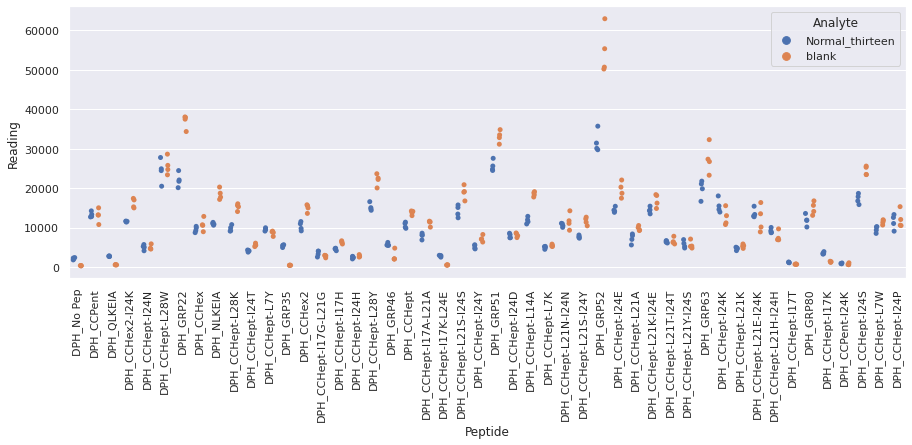

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_three_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_three_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

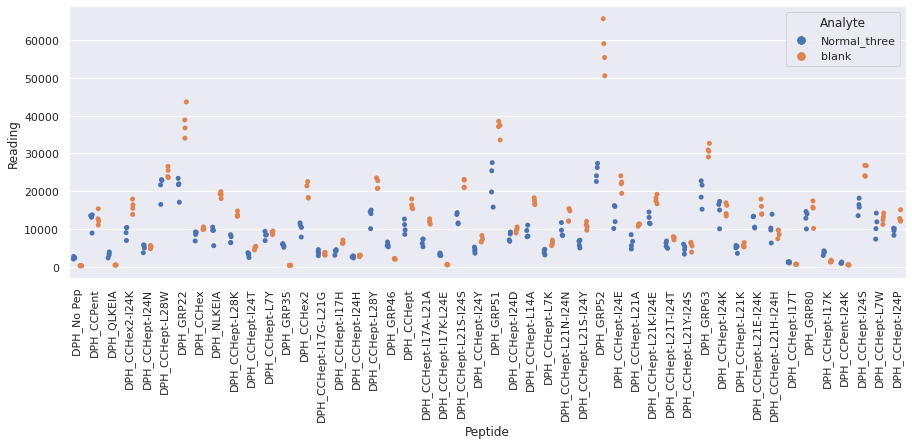

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_twelve_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_twelve_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

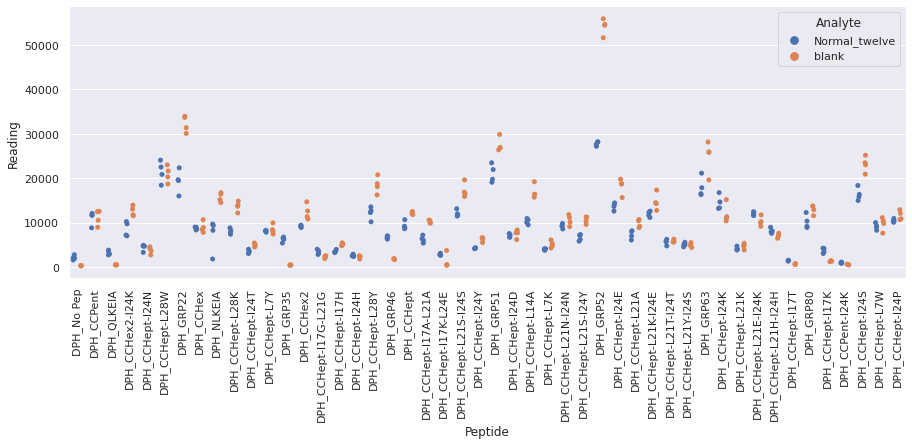

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_two_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_two_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

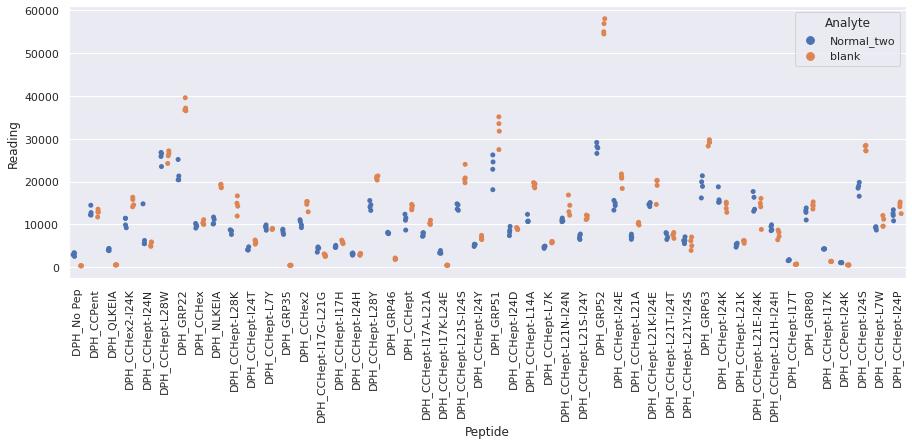

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_forty_repeat_3.xlsx
Drawing scatter plot of data spread for CAD_forty_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

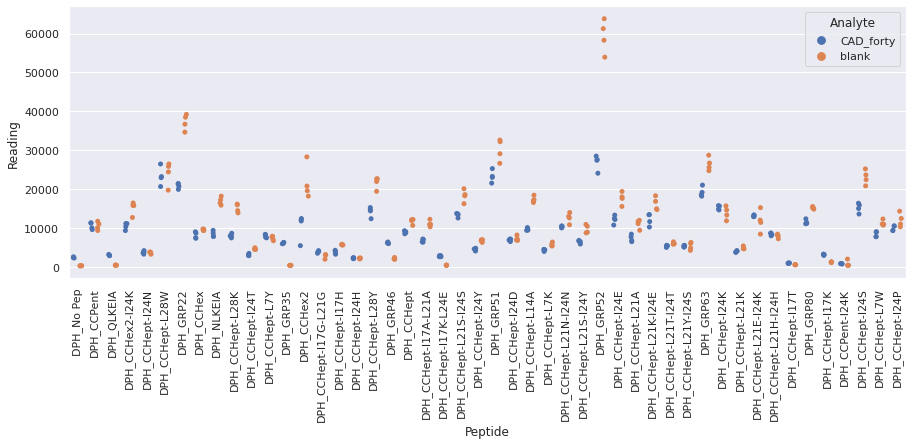

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortyone_repeat_3.xlsx
Drawing scatter plot of data spread for CAD_fortyone_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

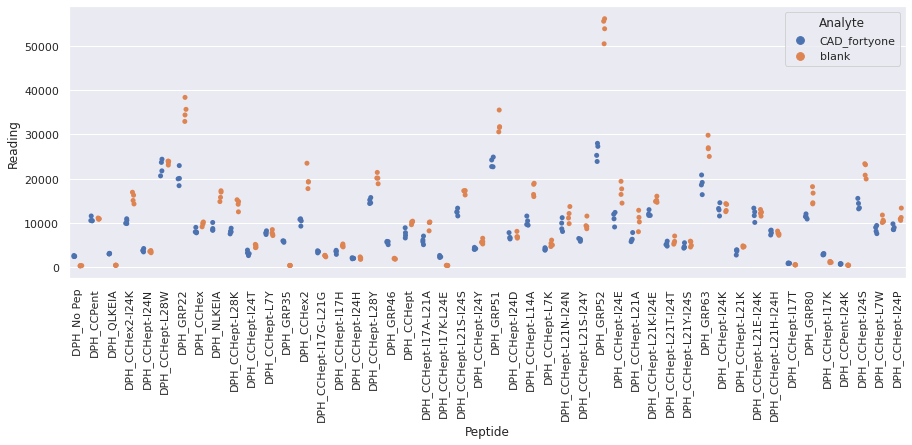

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortytwo_repeat_3.xlsx
Drawing scatter plot of data spread for CAD_fortytwo_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

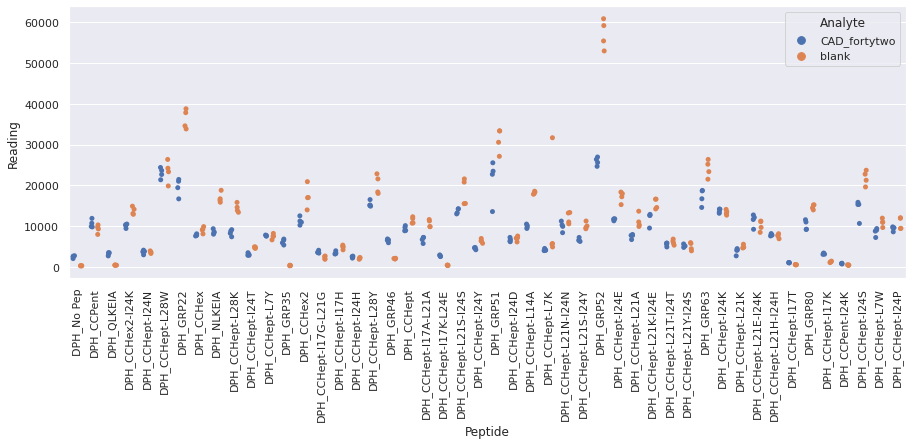

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirty_repeat_3.xlsx
Drawing scatter plot of data spread for CAD_thirty_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

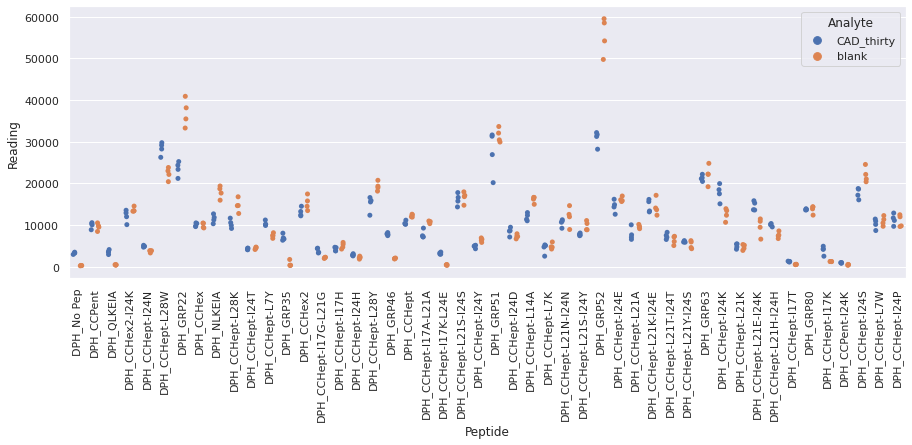

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyeight_repeat_3.xlsx
Drawing scatter plot of data spread for CAD_thirtyeight_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

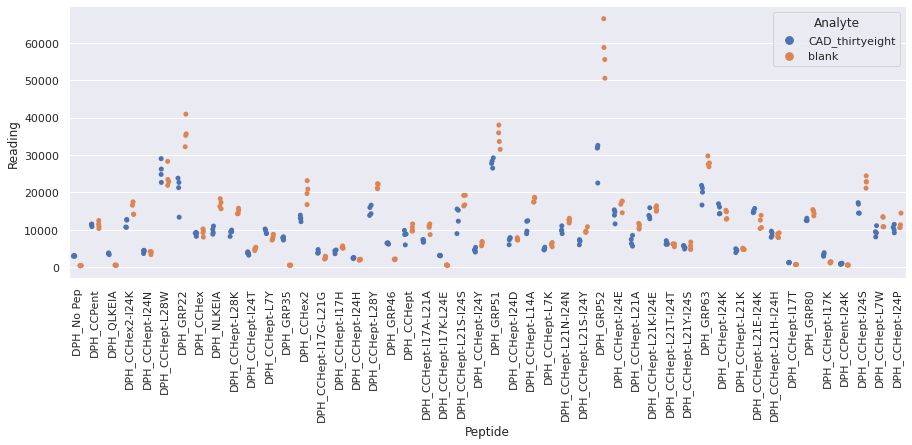

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfive_repeat_3.xlsx
Drawing scatter plot of data spread for CAD_thirtyfive_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

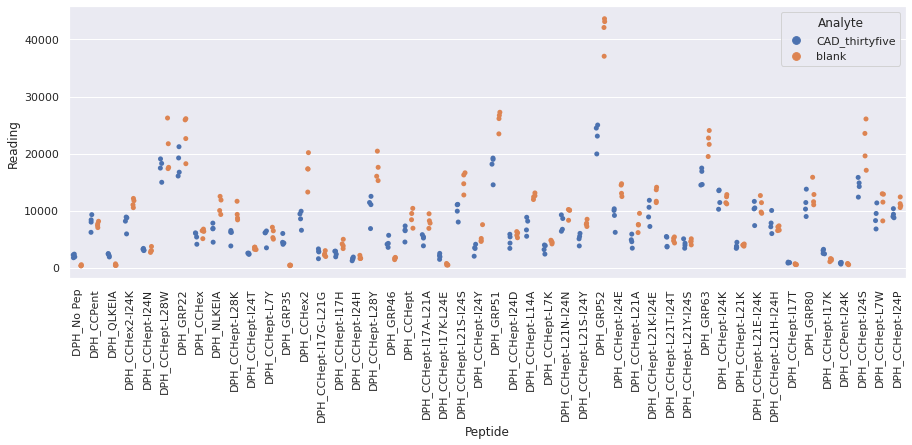

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfour_repeat_3.xlsx
Drawing scatter plot of data spread for CAD_thirtyfour_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

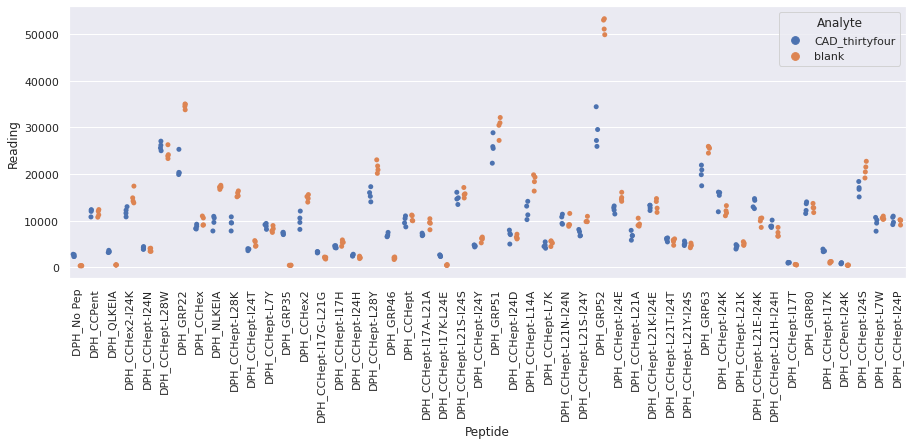

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtynine_repeat_3.xlsx
Drawing scatter plot of data spread for CAD_thirtynine_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

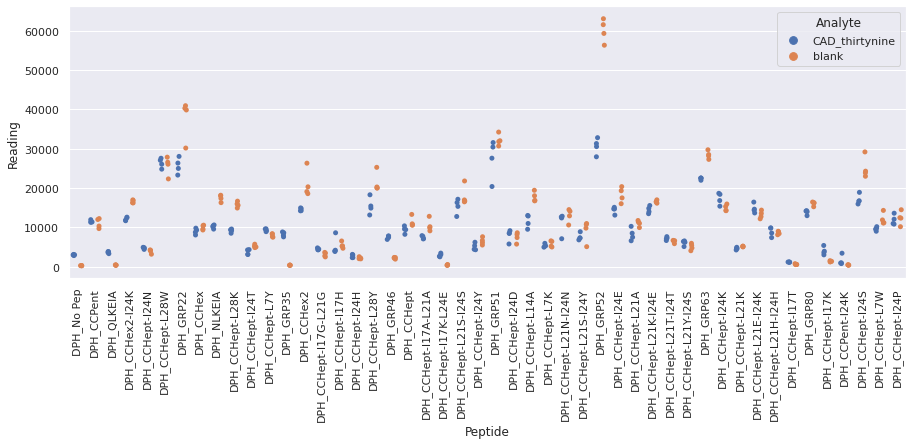

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyone_repeat_3.xlsx
Drawing scatter plot of data spread for CAD_thirtyone_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

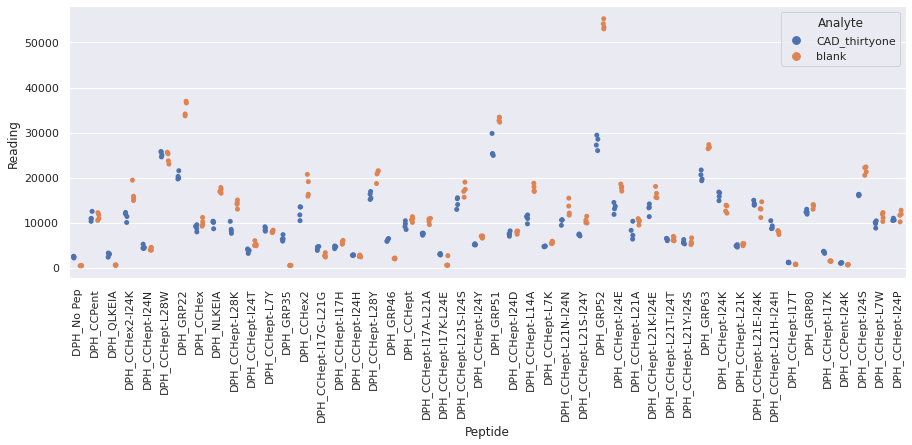

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyseven_repeat_3.xlsx
Drawing scatter plot of data spread for CAD_thirtyseven_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

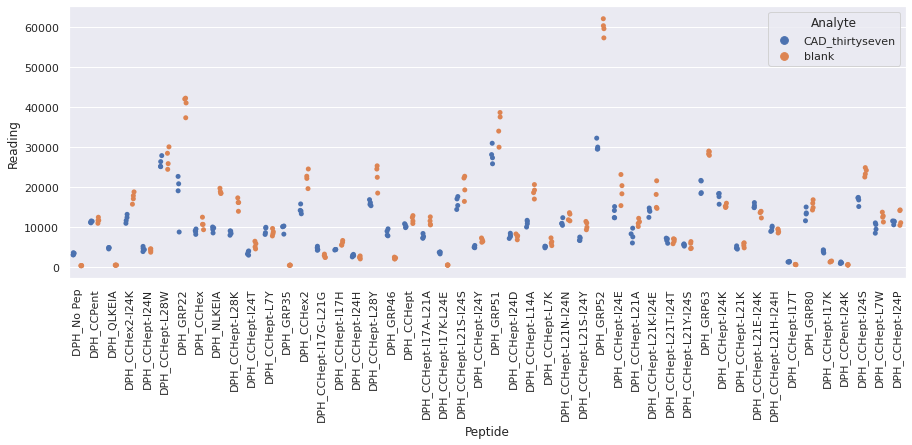

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtysix_repeat_3.xlsx
Drawing scatter plot of data spread for CAD_thirtysix_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

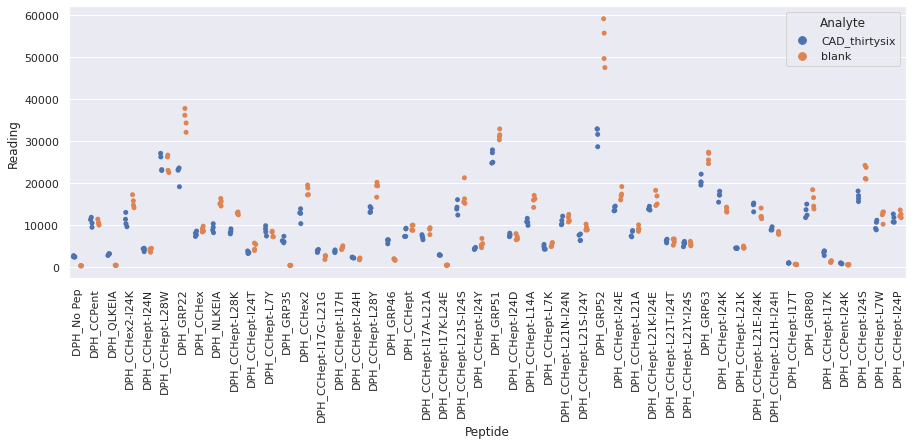

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtythree_repeat_3.xlsx
Drawing scatter plot of data spread for CAD_thirtythree_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

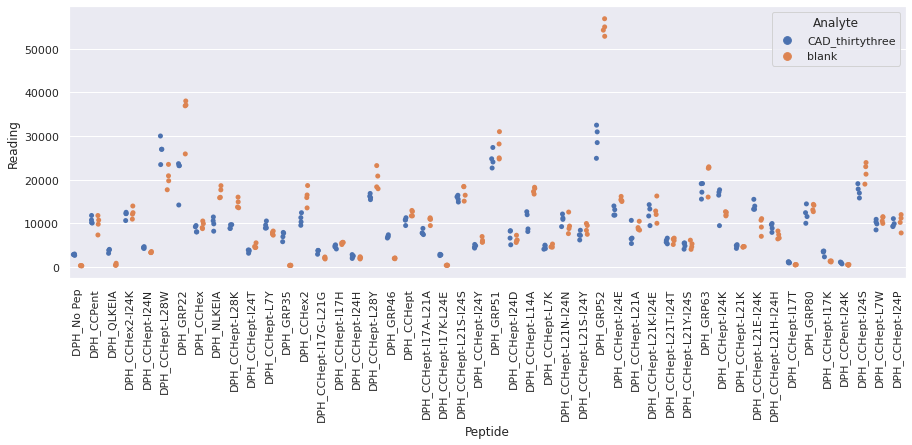

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtytwo_repeat_3.xlsx
Drawing scatter plot of data spread for CAD_thirtytwo_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

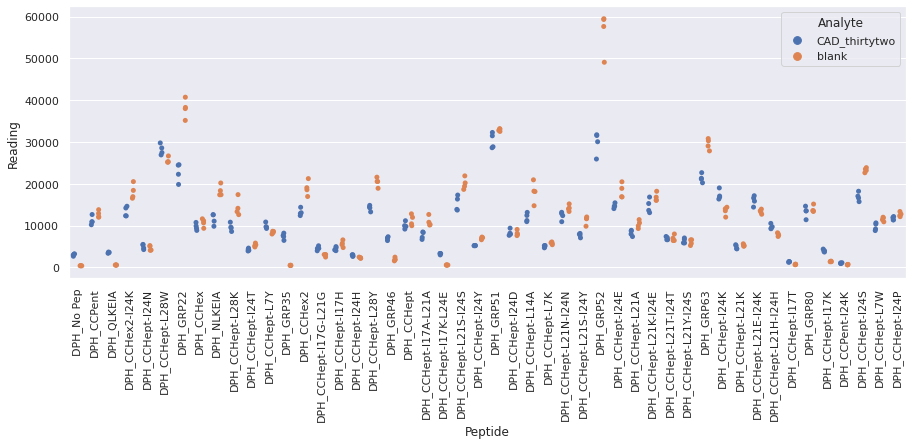

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_twentynine_repeat_3.xlsx
Drawing scatter plot of data spread for CAD_twentynine_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

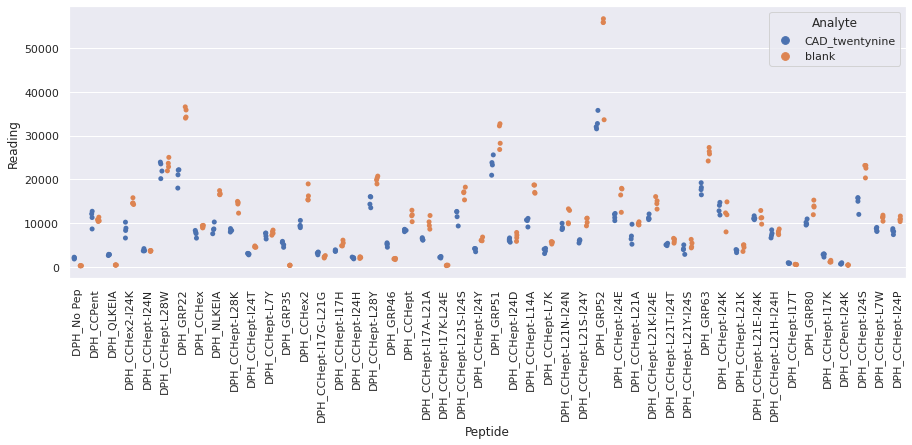

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_eighteen_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_eighteen_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

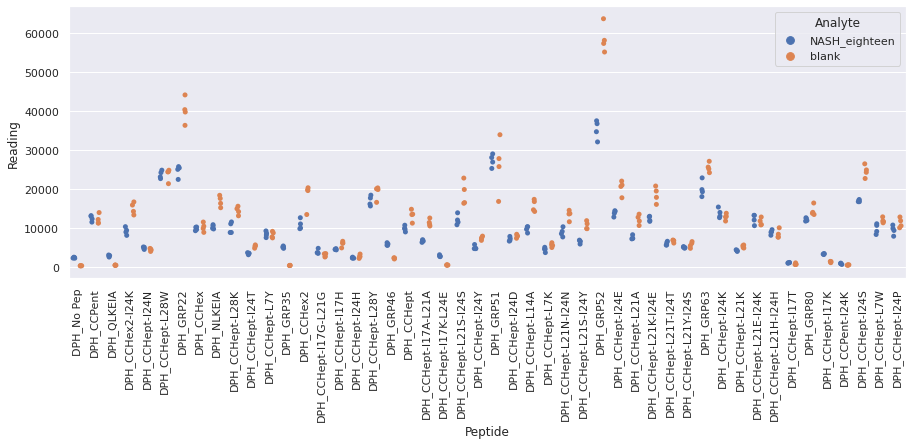

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_fifteen_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_fifteen_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

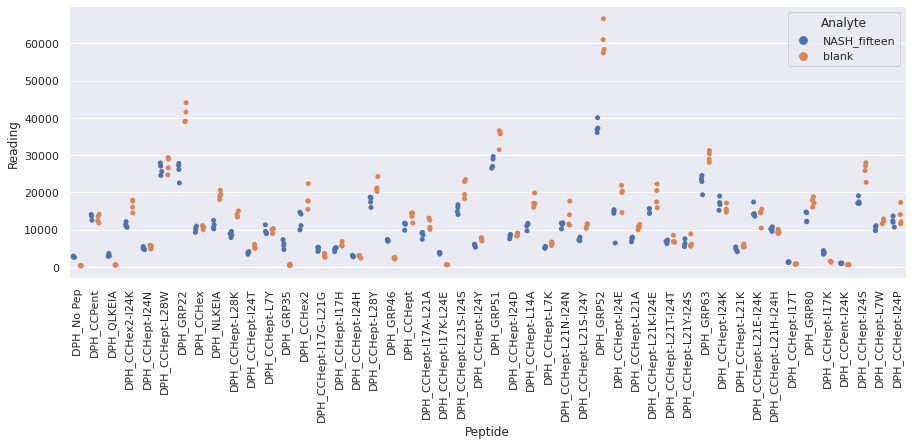

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_nineteen_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_nineteen_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

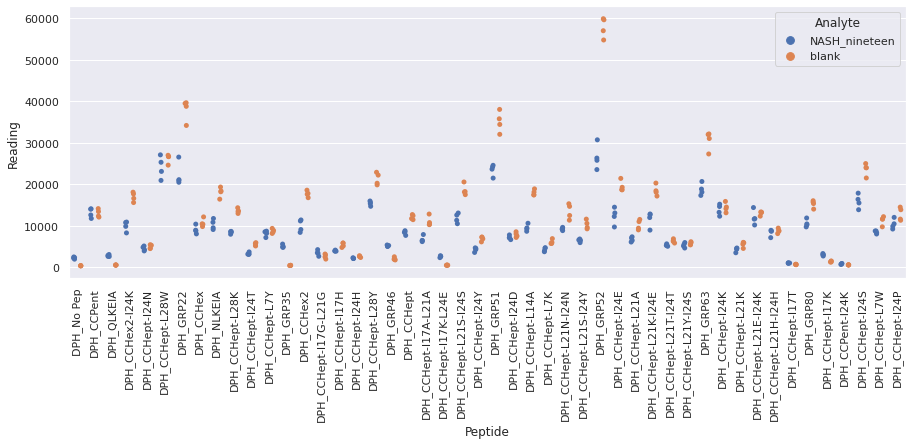

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_seventeen_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_seventeen_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

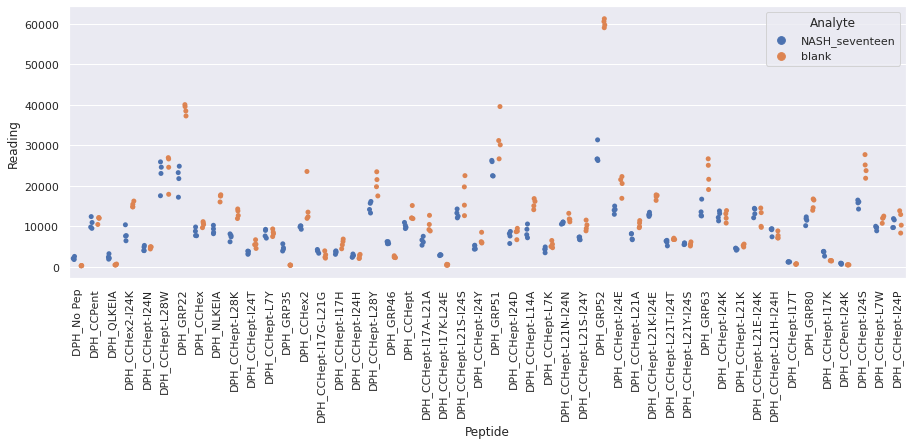

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_sixteen_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_sixteen_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

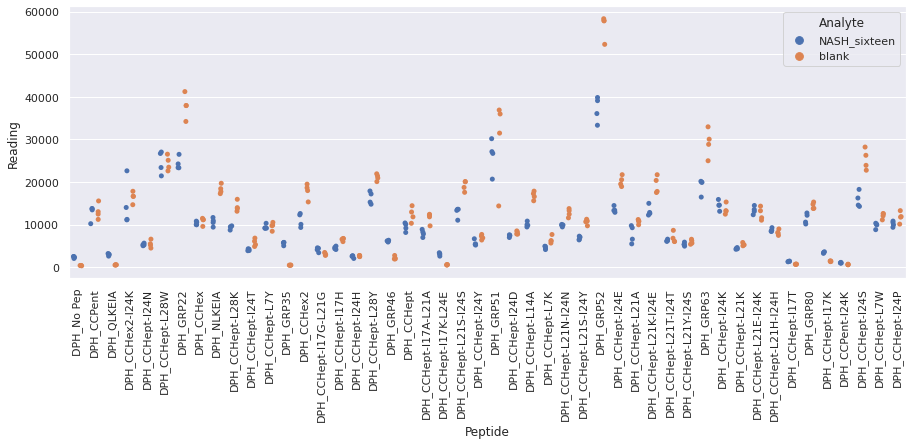

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twenty_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_twenty_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

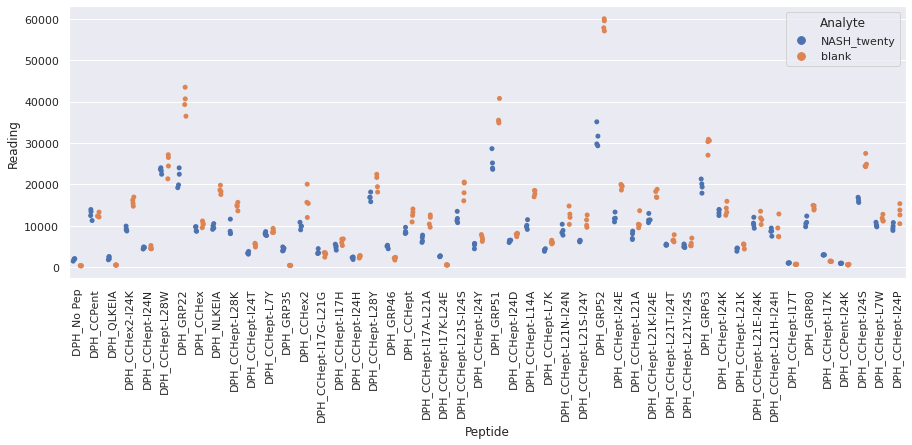

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyeight_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_twentyeight_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

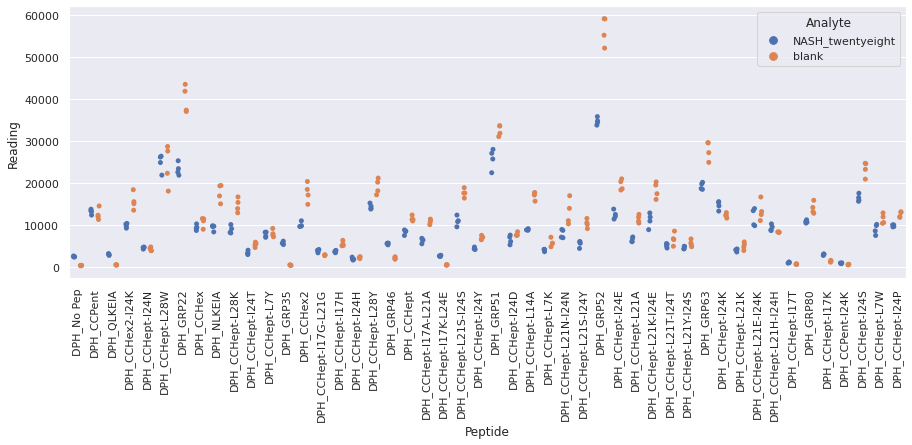

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfive_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_twentyfive_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

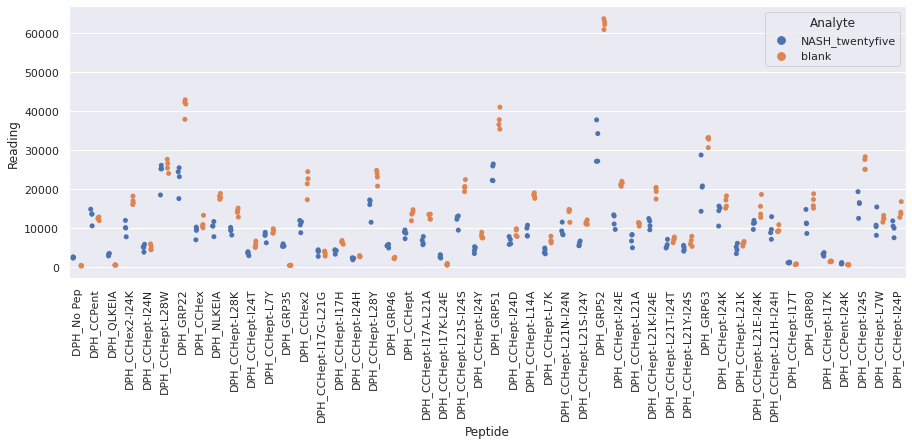

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfour_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_twentyfour_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

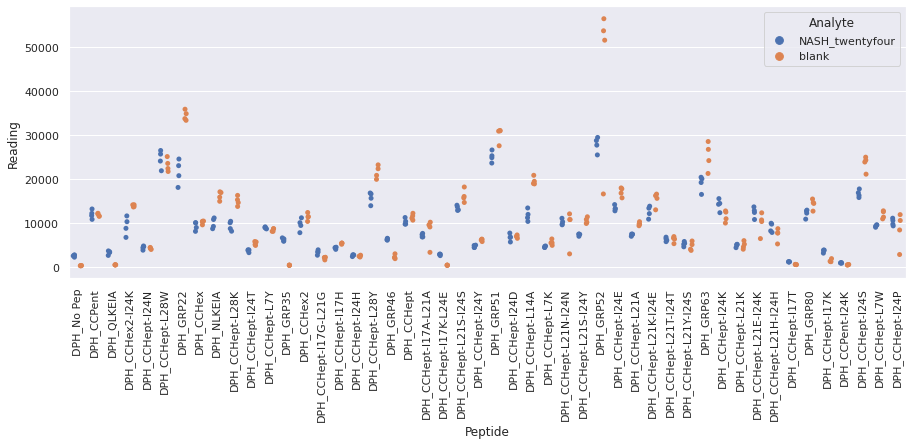

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyone_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_twentyone_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

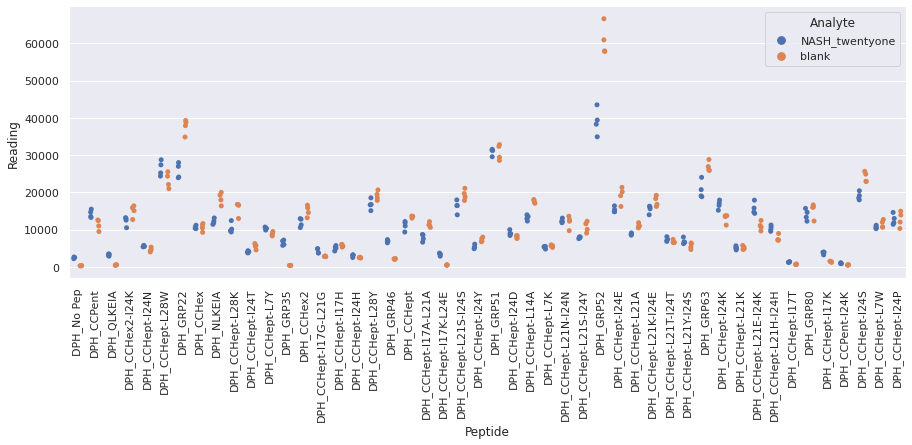

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyseven_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_twentyseven_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

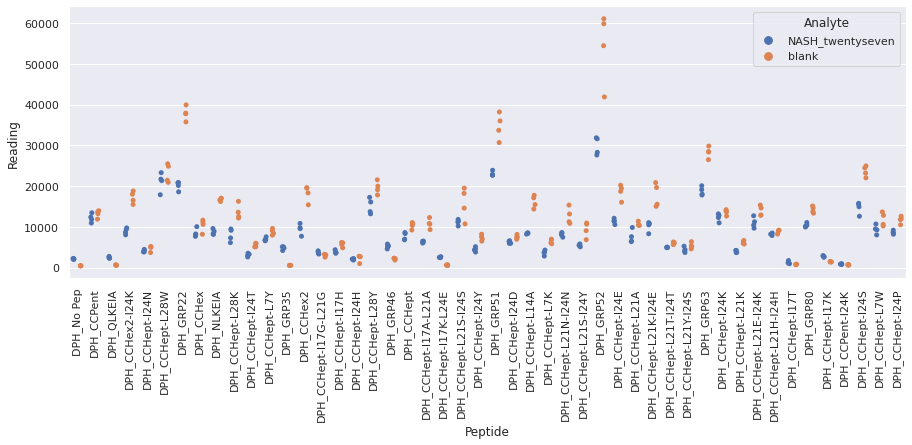

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentysix_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_twentysix_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

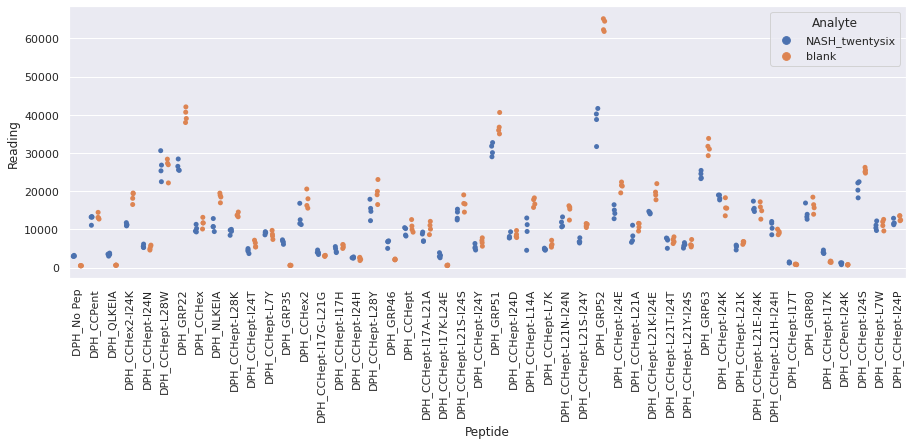

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentythree_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_twentythree_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

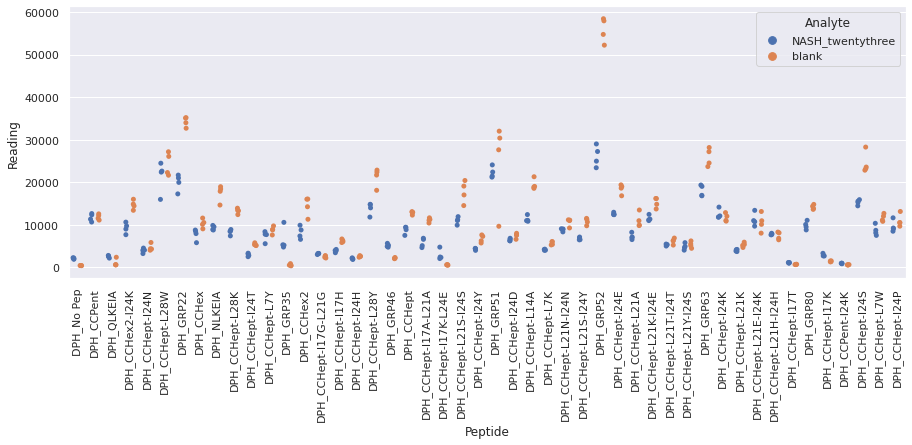

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentytwo_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_twentytwo_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

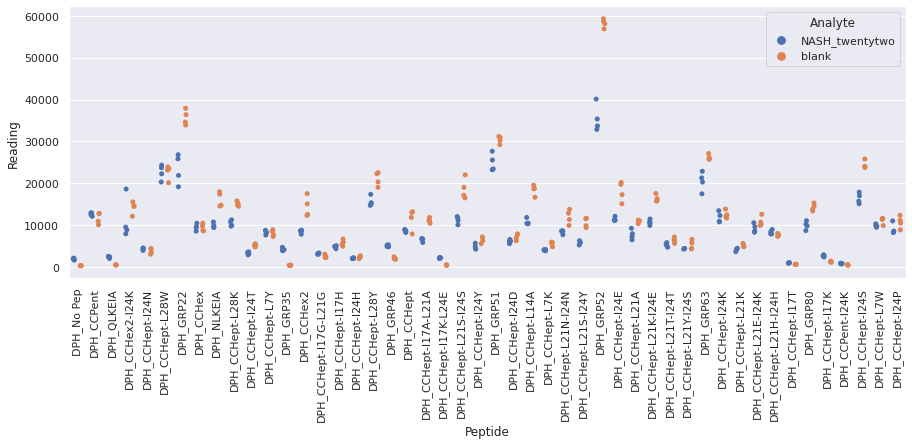

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eight_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_eight_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

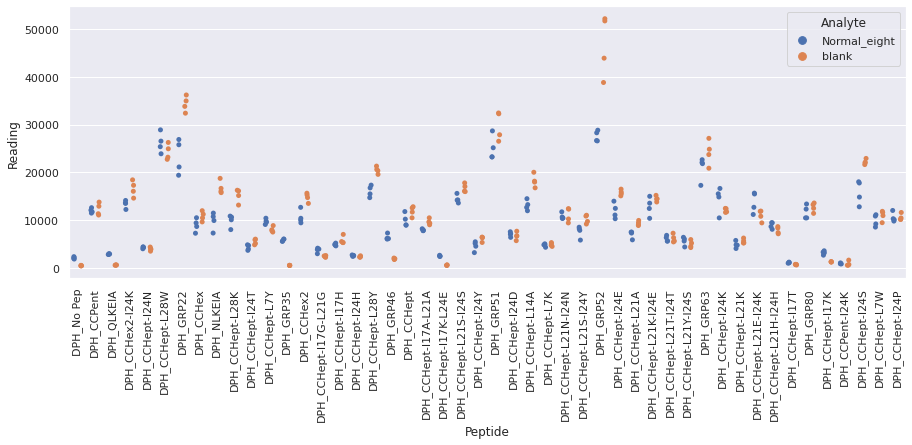

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eleven_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_eleven_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

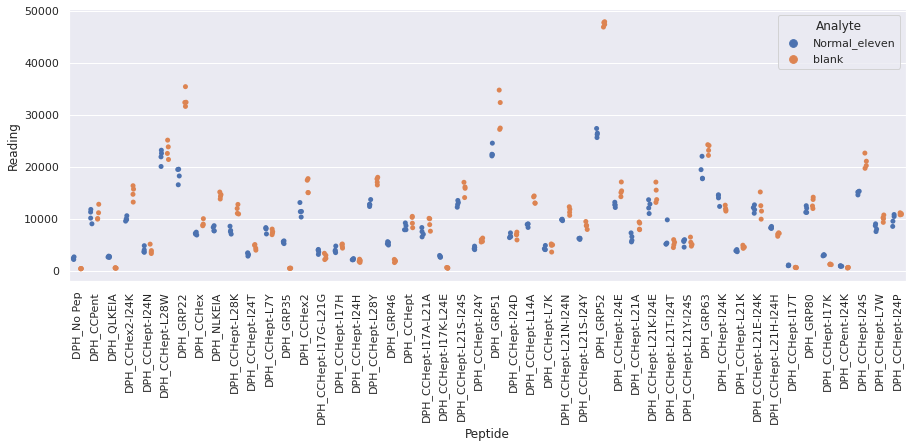

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_five_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_five_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

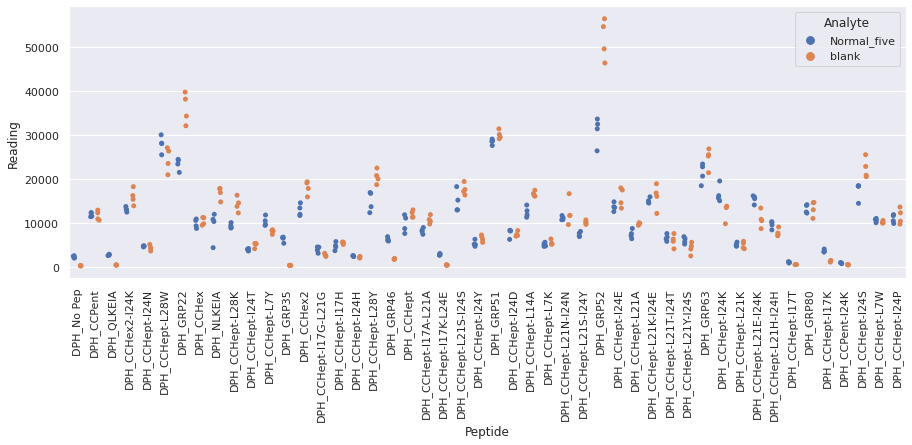

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_four_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_four_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

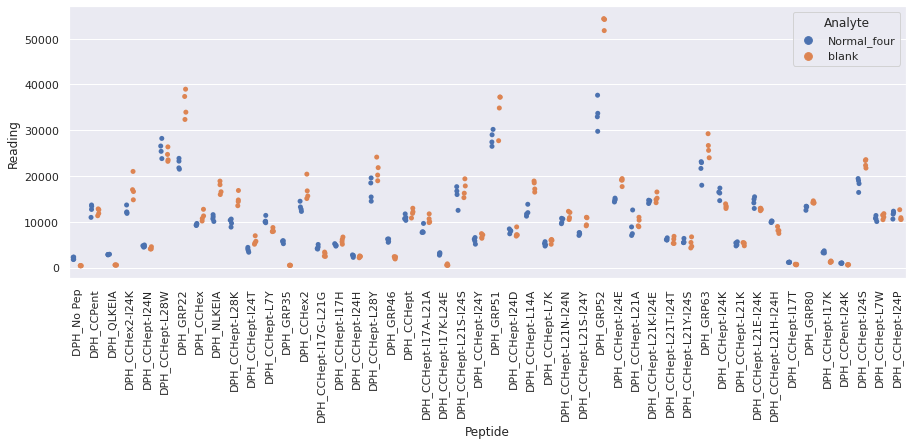

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_fourteen_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_fourteen_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

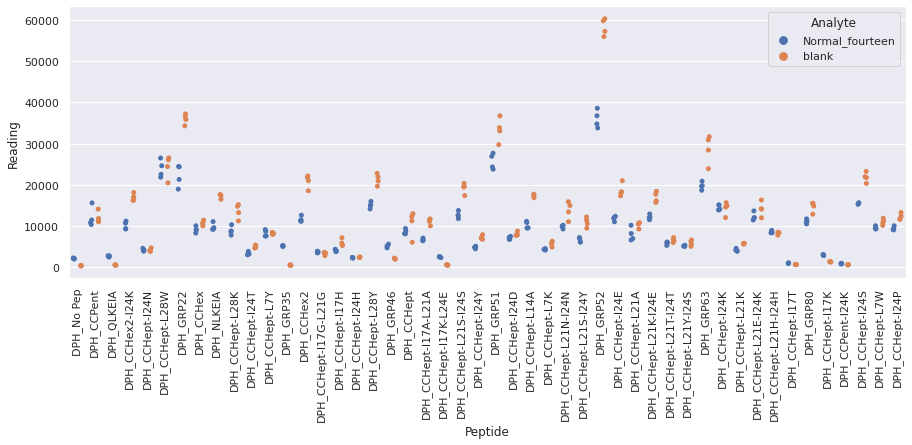

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_nine_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_nine_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

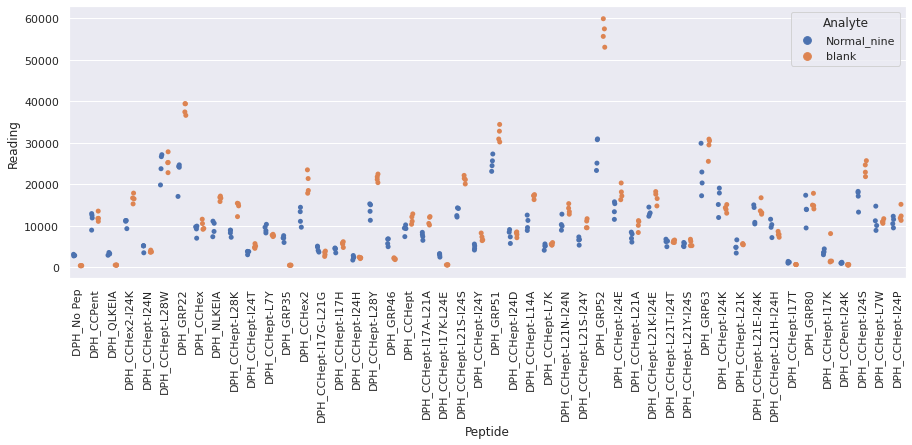

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_one_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_one_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

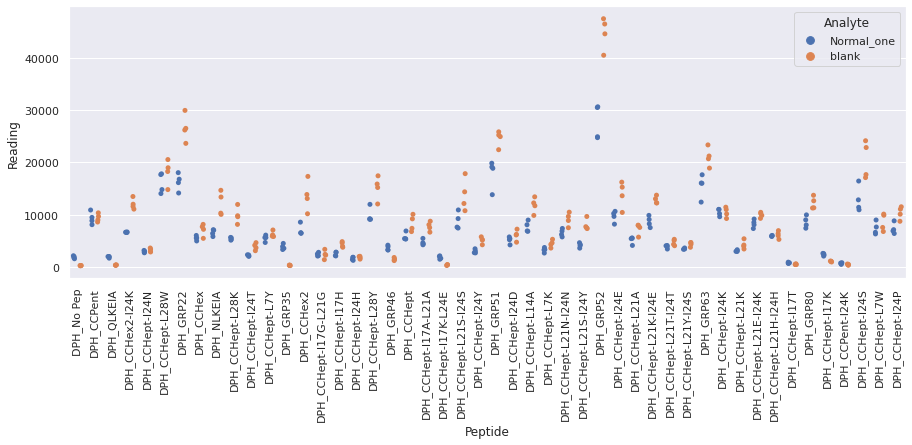

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_seven_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_seven_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

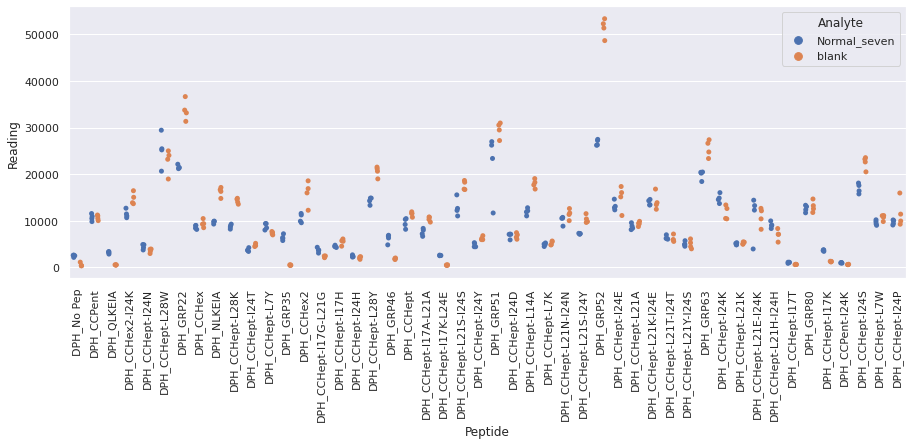

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_six_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_six_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

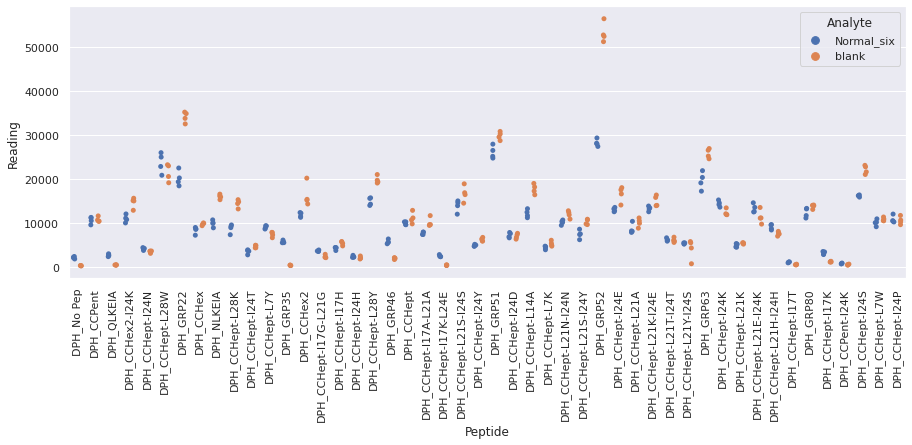

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_ten_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_ten_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

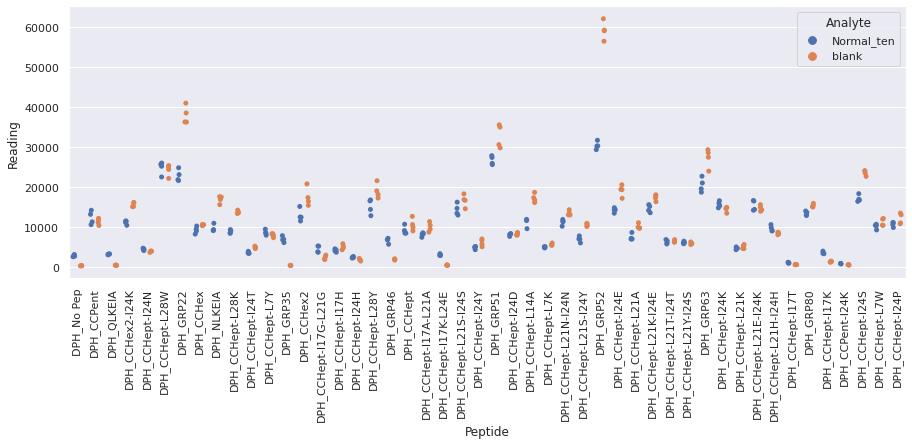

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_thirteen_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_thirteen_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

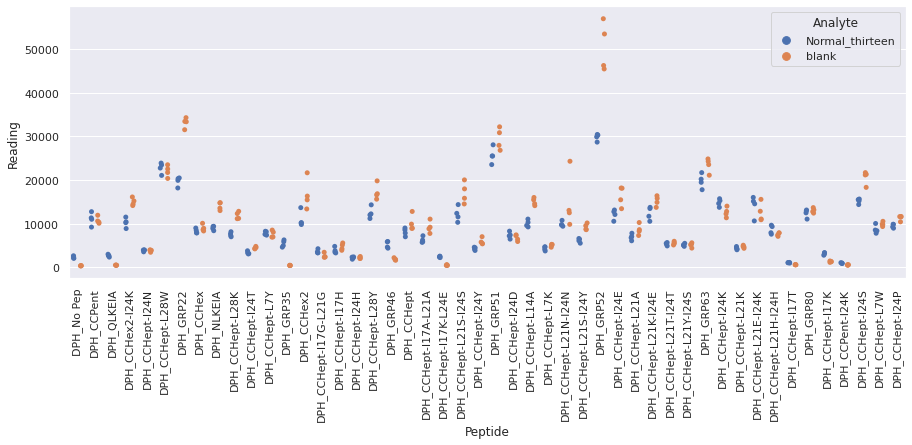

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_three_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_three_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

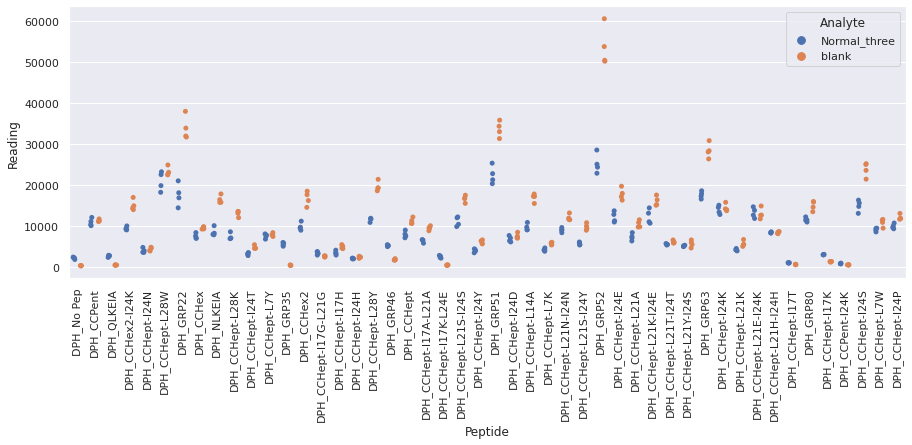

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_twelve_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_twelve_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

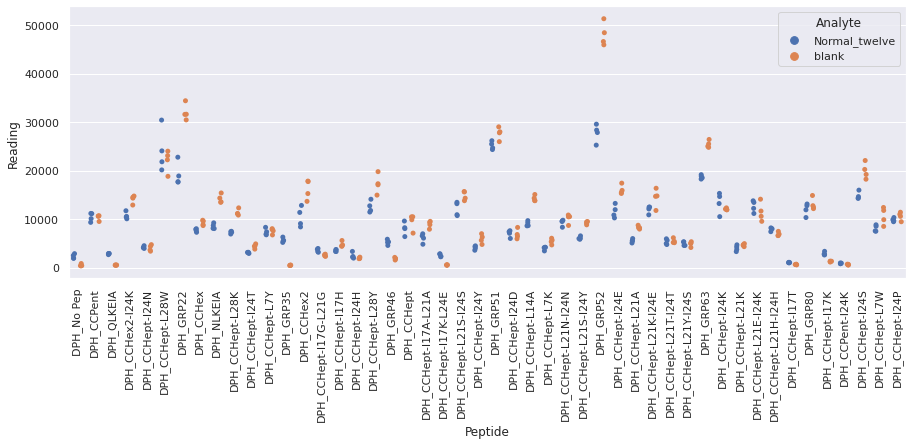

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_two_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_two_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

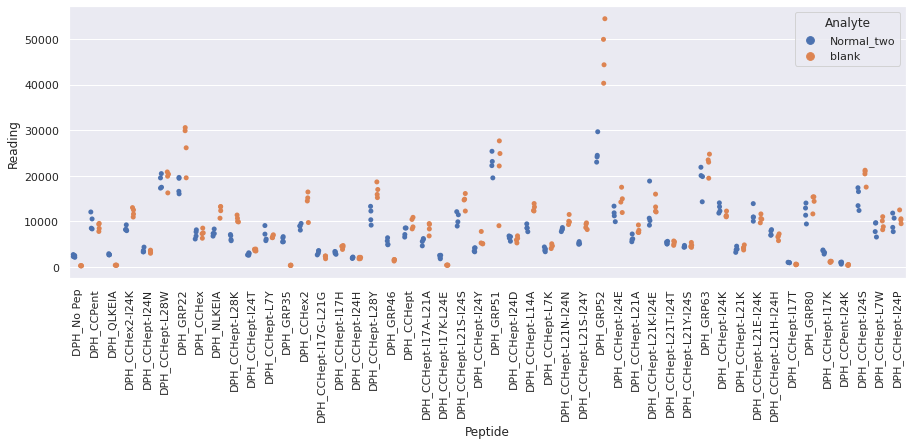

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_forty_repeat_4.xlsx
Drawing scatter plot of data spread for CAD_forty_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

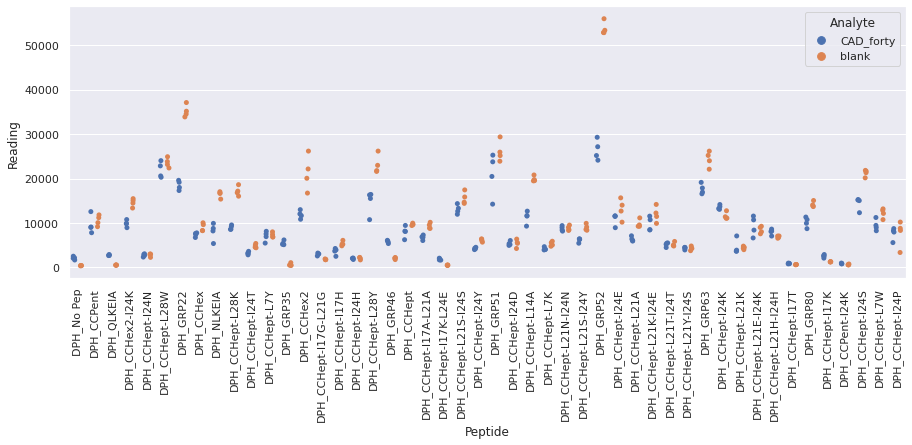

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortyone_repeat_4.xlsx
Drawing scatter plot of data spread for CAD_fortyone_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

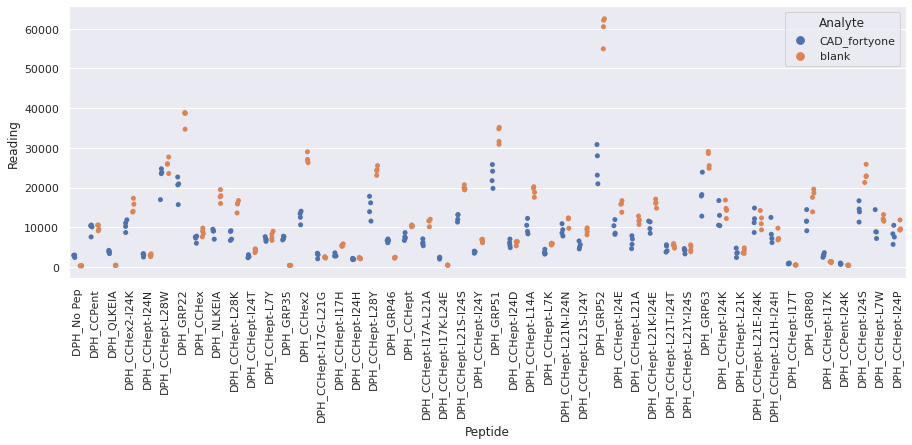

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortytwo_repeat_4.xlsx
Drawing scatter plot of data spread for CAD_fortytwo_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

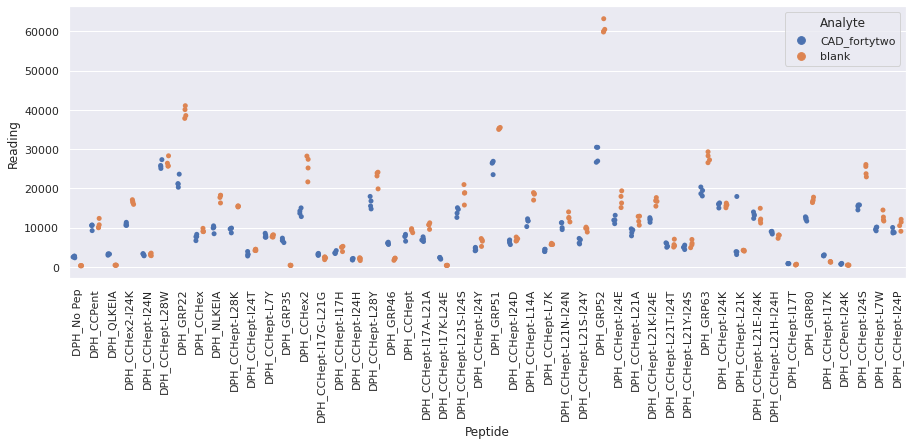

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirty_repeat_4.xlsx
Drawing scatter plot of data spread for CAD_thirty_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

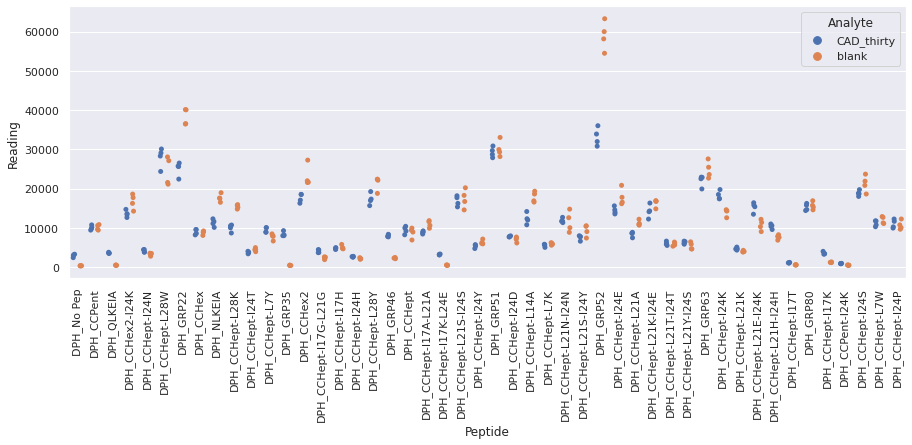

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyeight_repeat_4.xlsx
Drawing scatter plot of data spread for CAD_thirtyeight_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

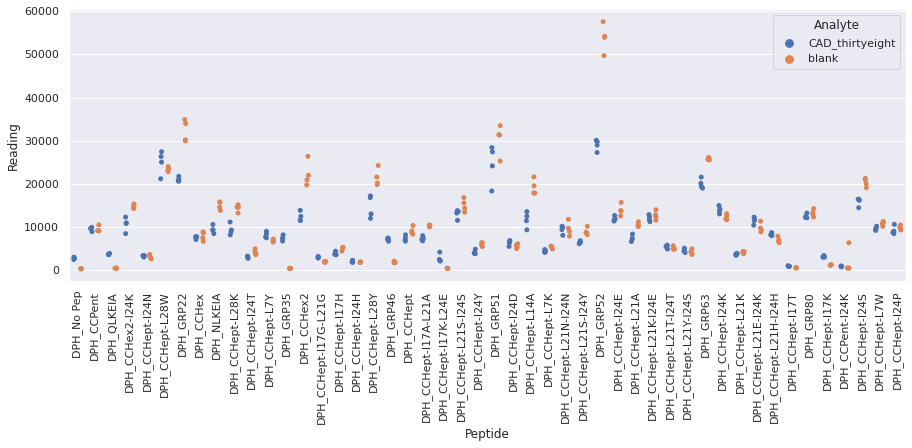

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfive_repeat_4.xlsx
Drawing scatter plot of data spread for CAD_thirtyfive_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

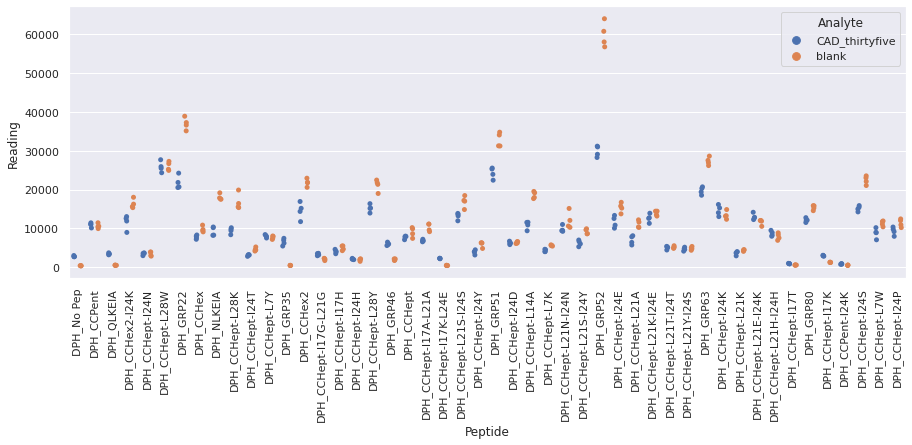

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfour_repeat_4.xlsx
Drawing scatter plot of data spread for CAD_thirtyfour_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

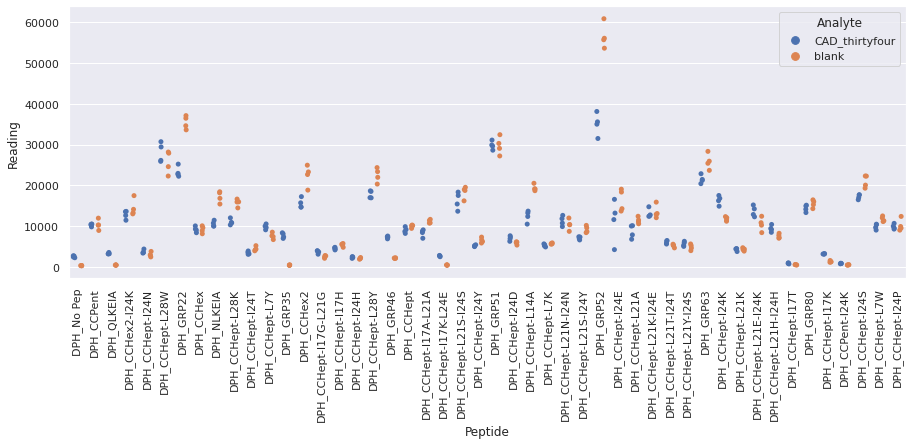

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtynine_repeat_4.xlsx
Drawing scatter plot of data spread for CAD_thirtynine_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

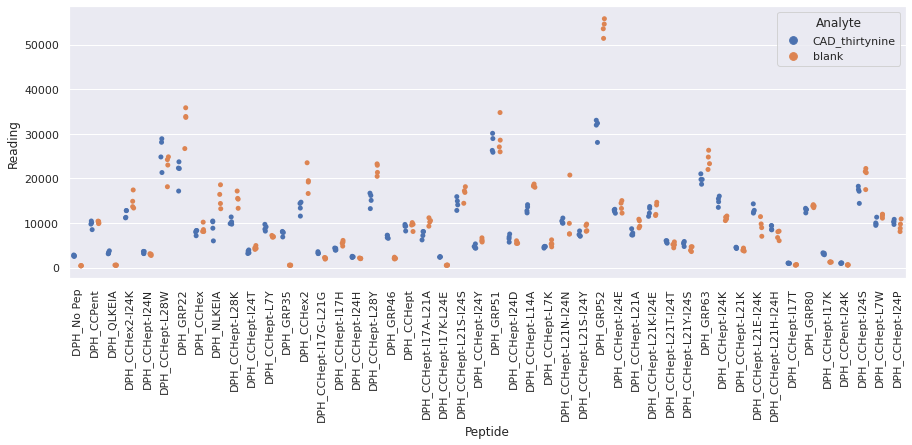

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyone_repeat_4.xlsx
Drawing scatter plot of data spread for CAD_thirtyone_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

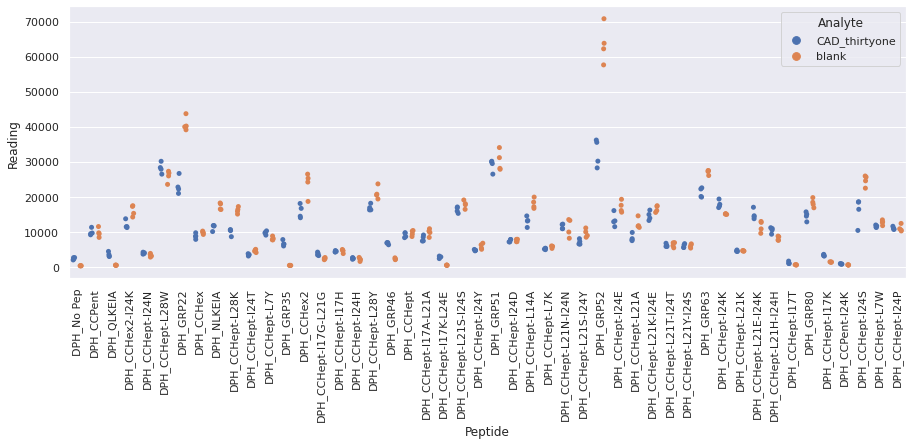

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyseven_repeat_4.xlsx
Drawing scatter plot of data spread for CAD_thirtyseven_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

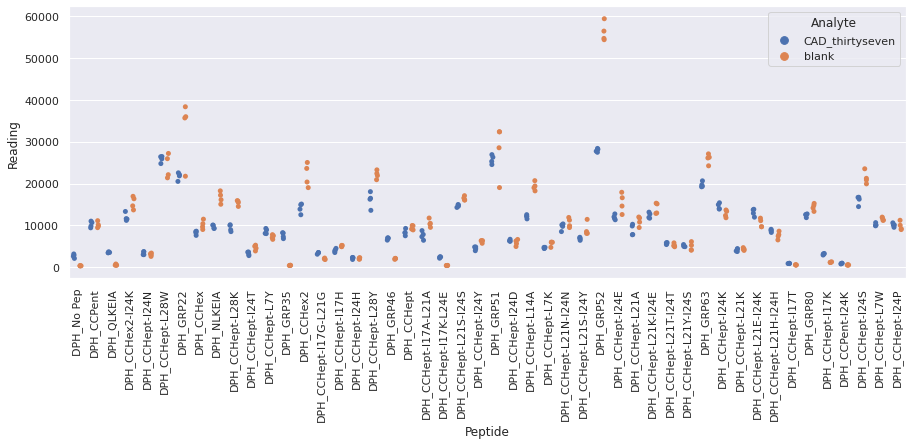

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtysix_repeat_4.xlsx
Drawing scatter plot of data spread for CAD_thirtysix_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

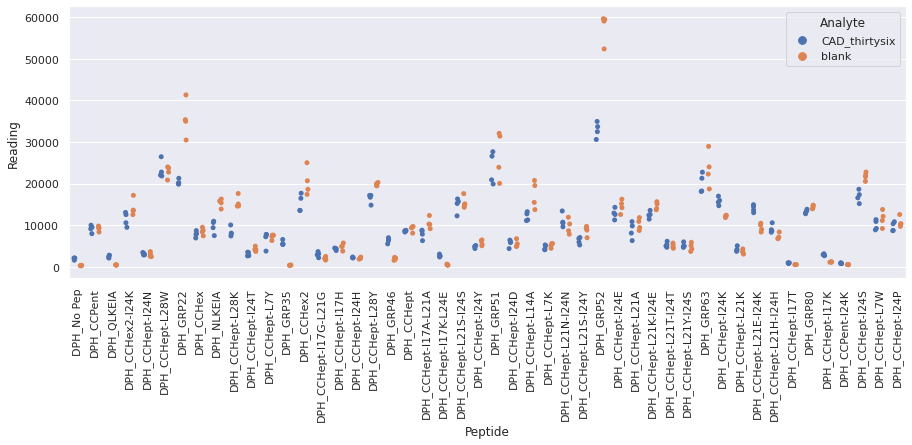

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtythree_repeat_4.xlsx
Drawing scatter plot of data spread for CAD_thirtythree_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

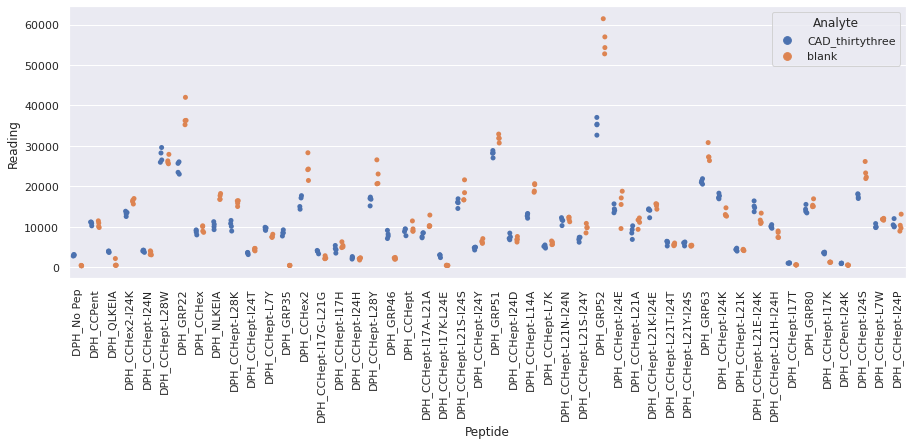

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtytwo_repeat_4.xlsx
Drawing scatter plot of data spread for CAD_thirtytwo_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

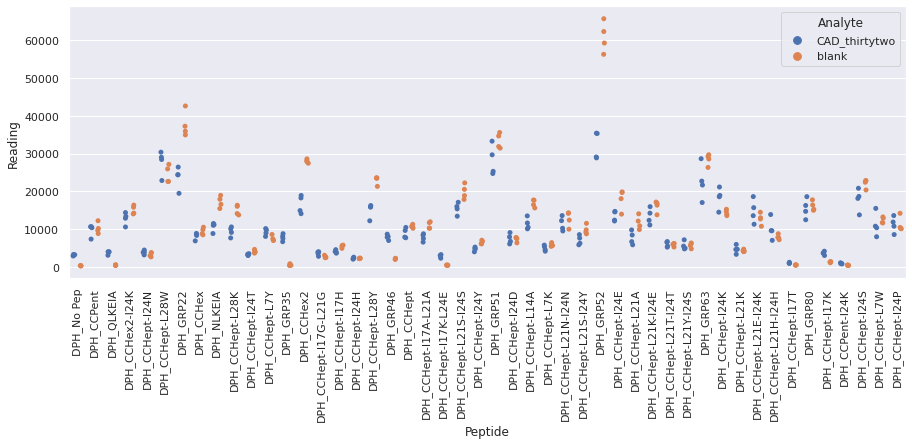

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_twentynine_repeat_4.xlsx
Drawing scatter plot of data spread for CAD_twentynine_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

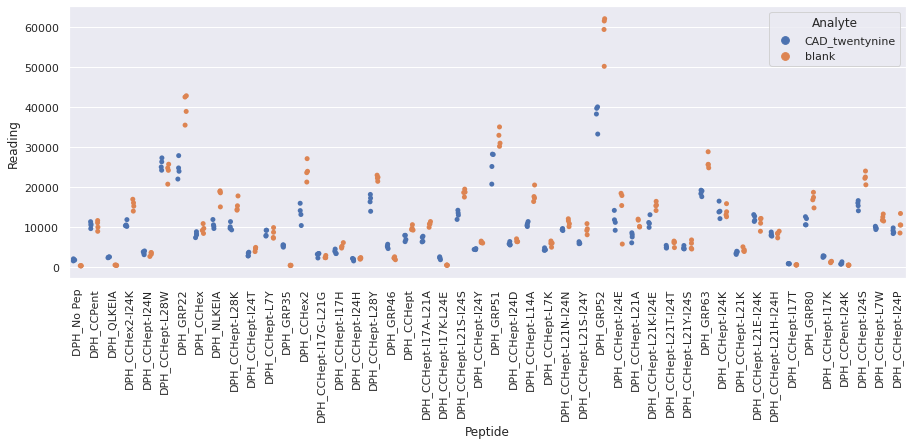

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_eighteen_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_eighteen_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

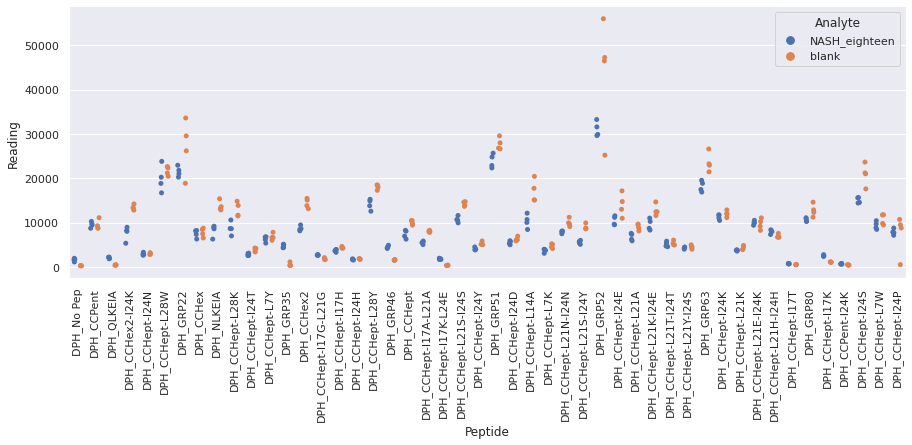

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_fifteen_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_fifteen_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

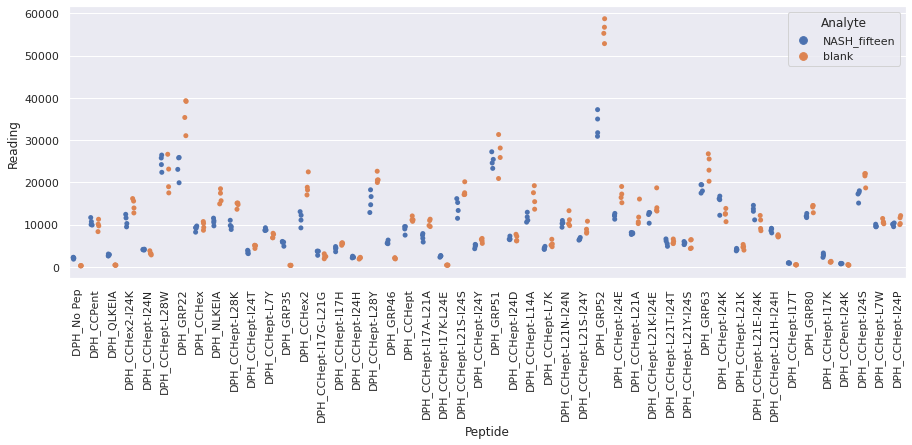

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_nineteen_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_nineteen_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

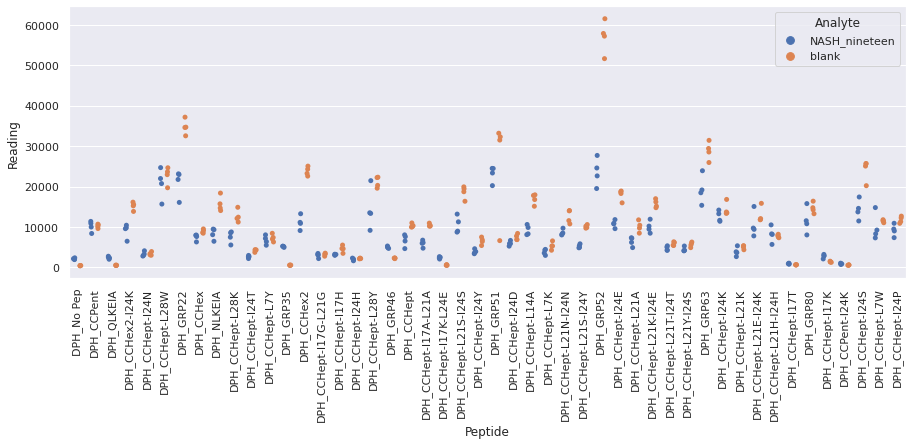

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_seventeen_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_seventeen_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

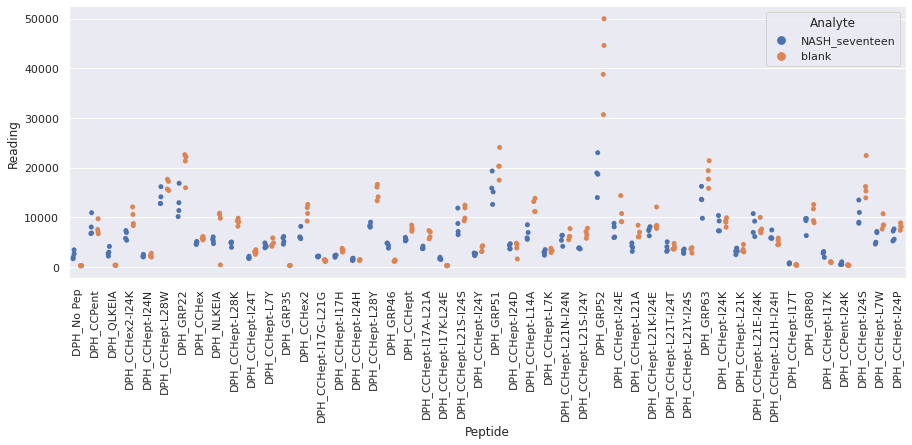

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_sixteen_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_sixteen_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

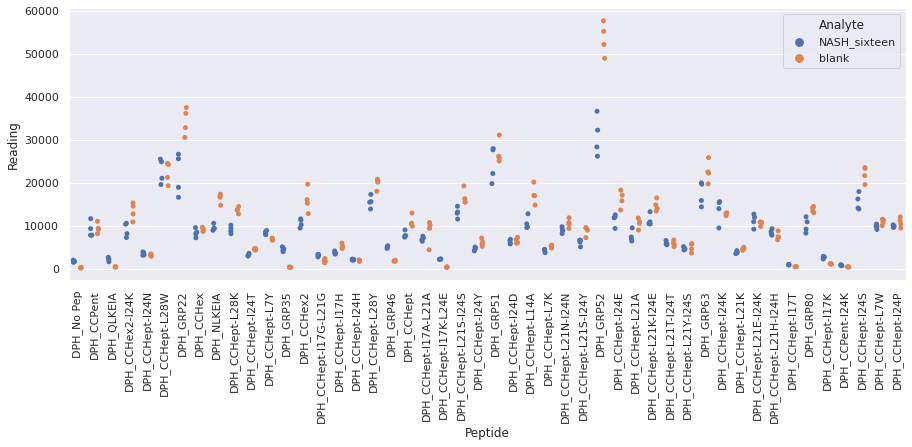

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twenty_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_twenty_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

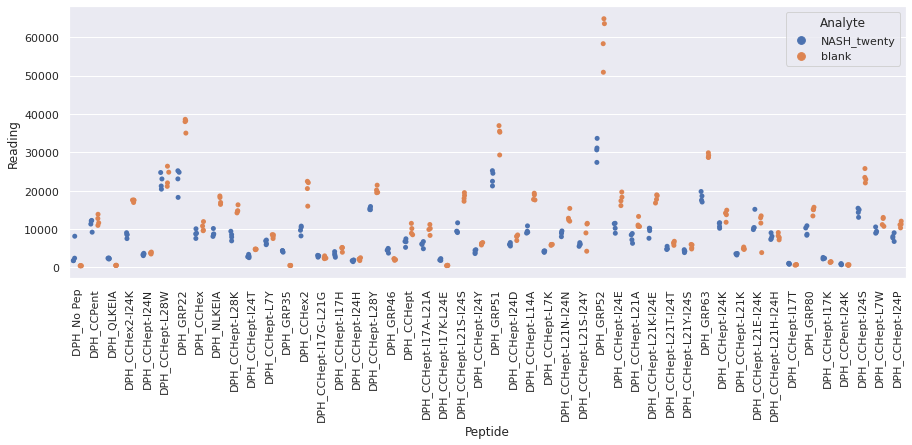

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyeight_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_twentyeight_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

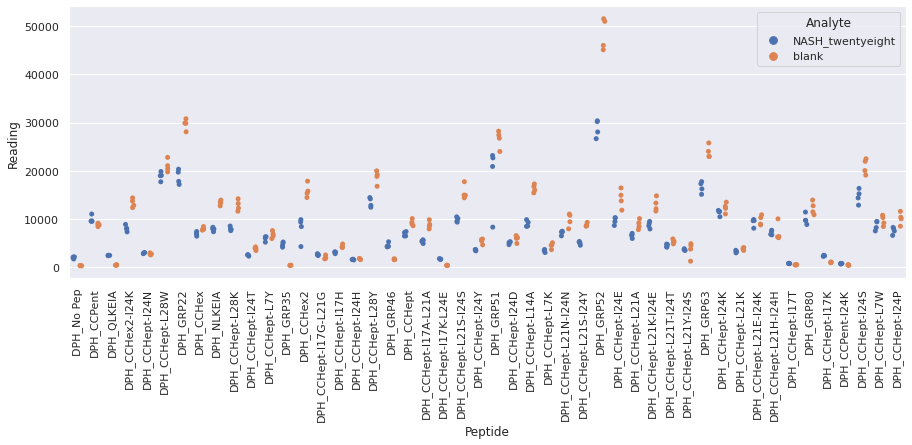

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfive_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_twentyfive_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

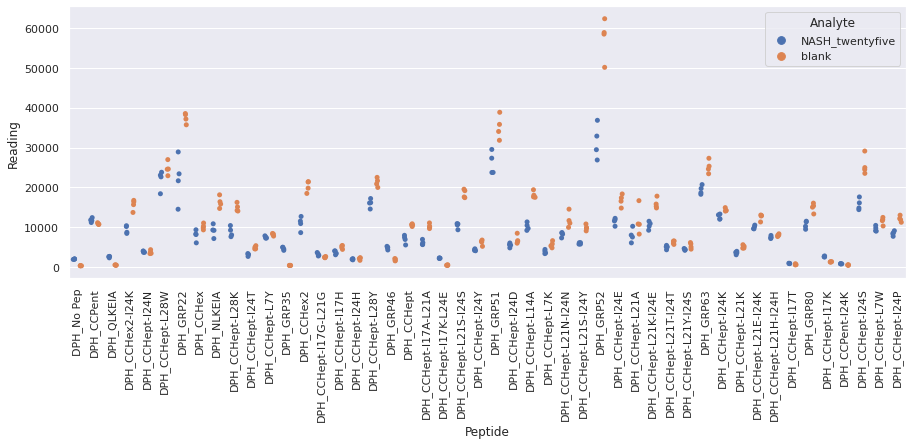

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfour_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_twentyfour_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

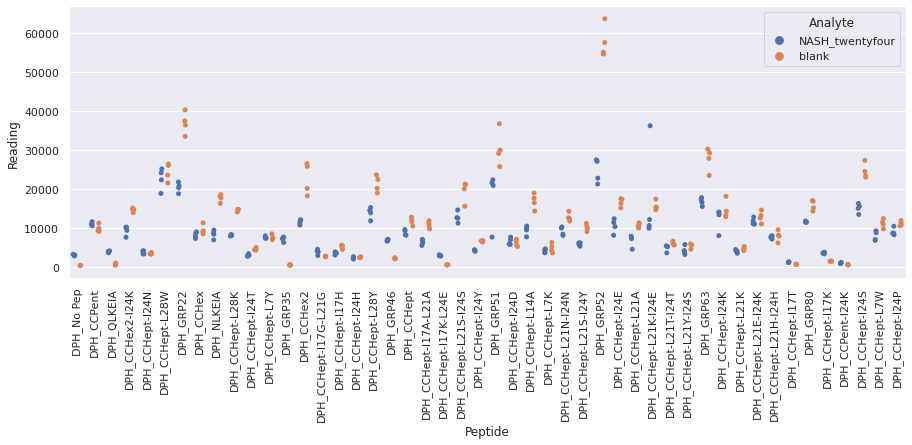

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyone_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_twentyone_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

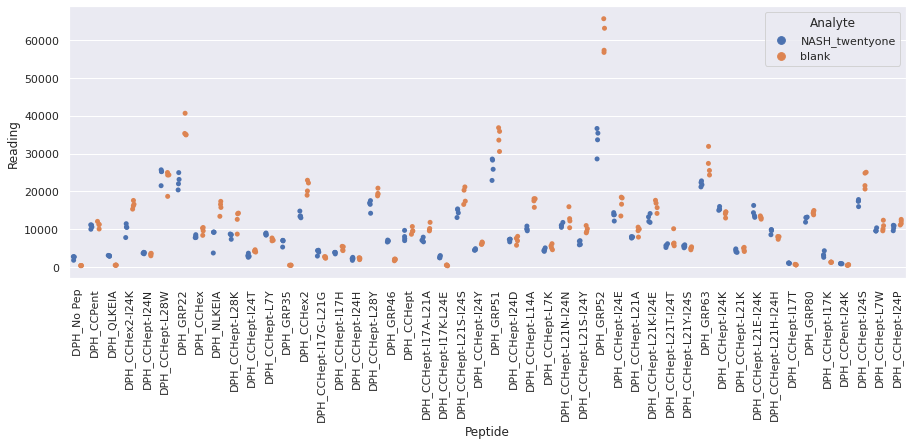

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyseven_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_twentyseven_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

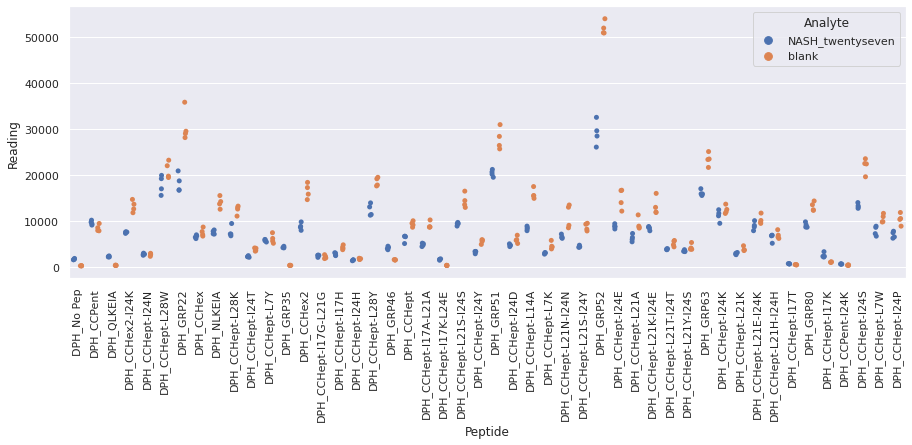

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentysix_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_twentysix_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

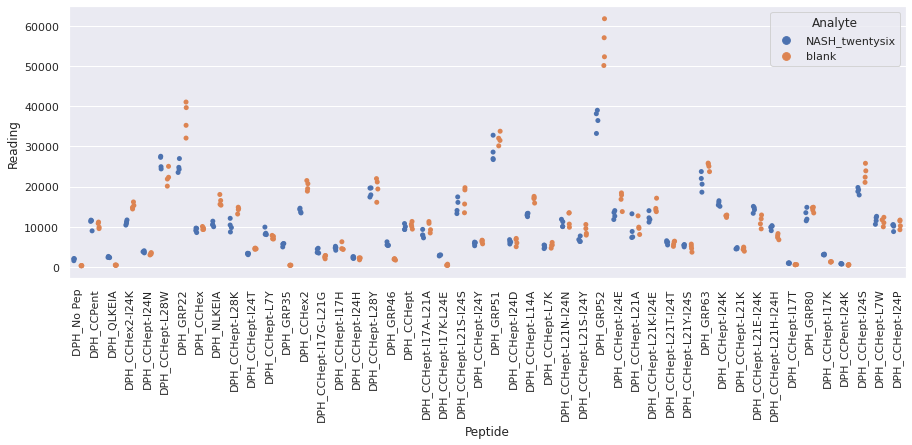

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentythree_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_twentythree_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

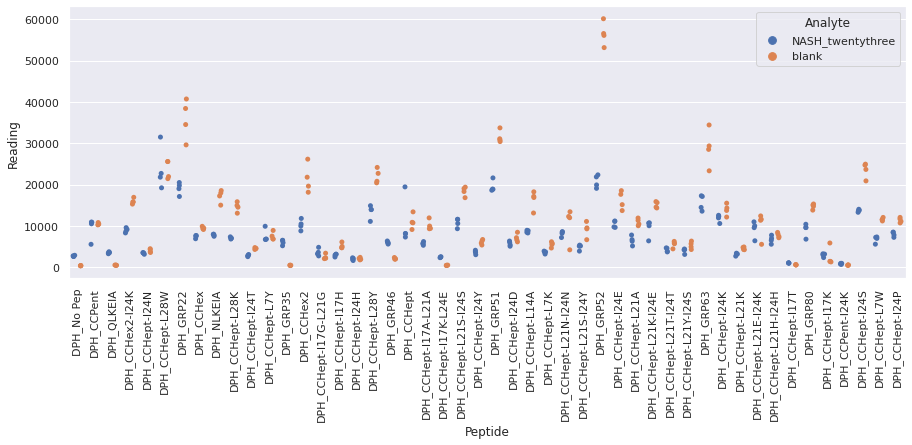

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentytwo_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_twentytwo_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

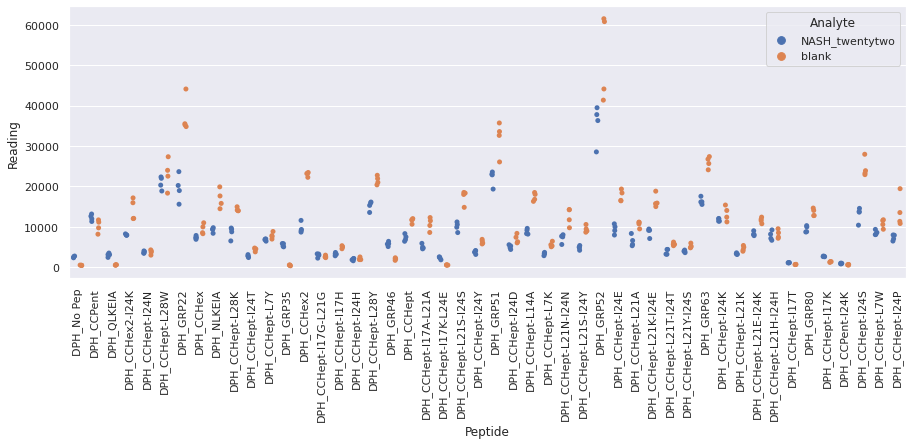

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eight_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_eight_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

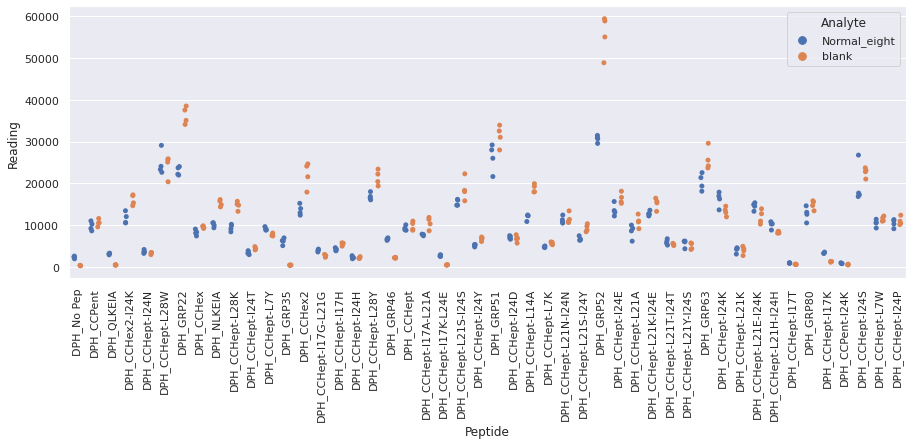

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eleven_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_eleven_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

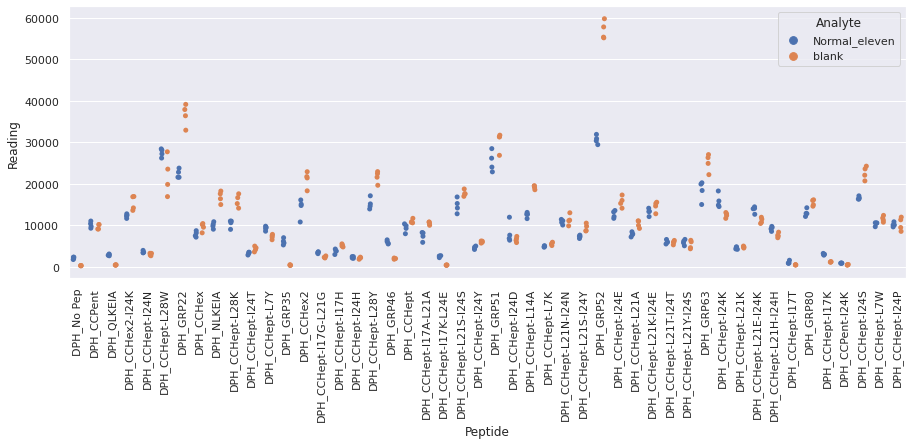

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_five_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_five_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

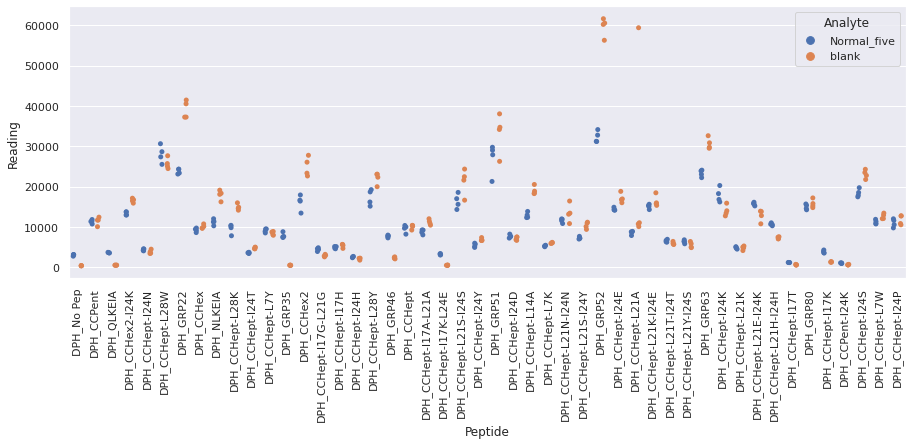

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_four_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_four_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

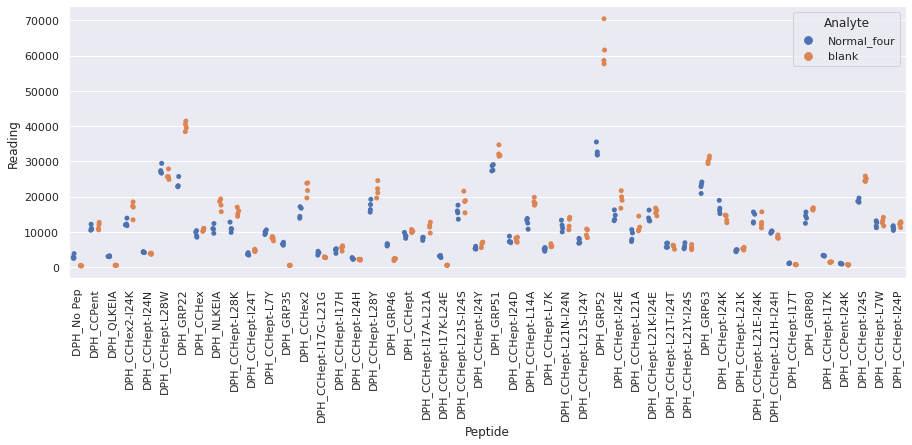

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_fourteen_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_fourteen_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

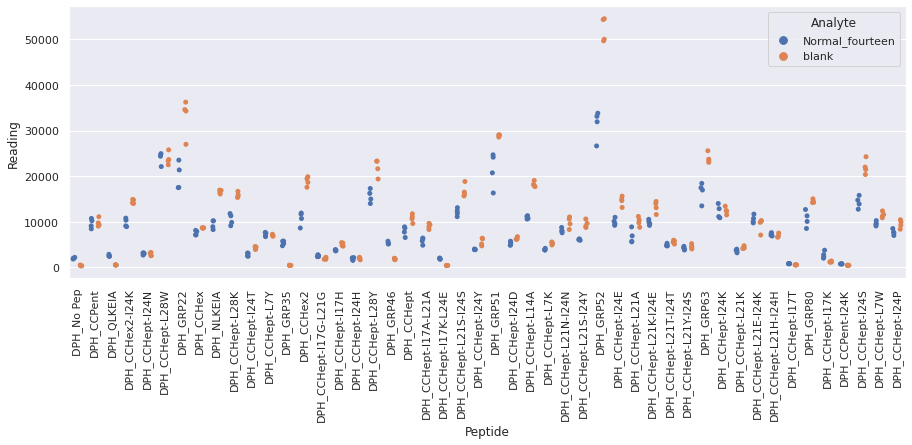

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_nine_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_nine_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

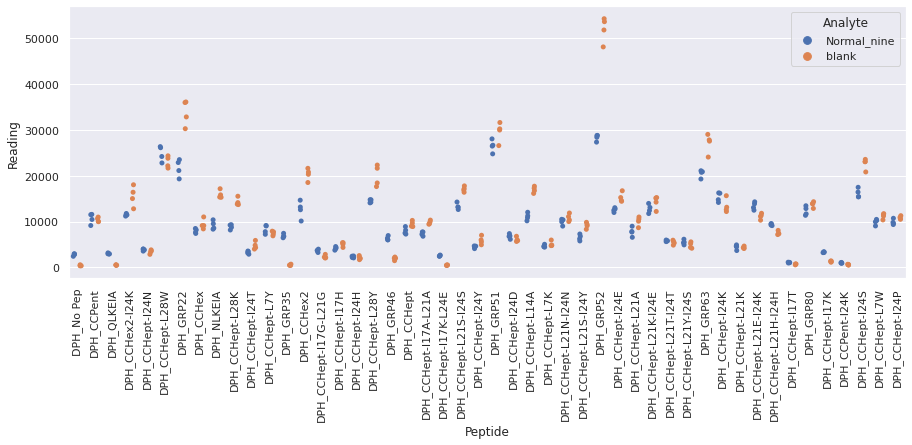

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_one_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_one_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

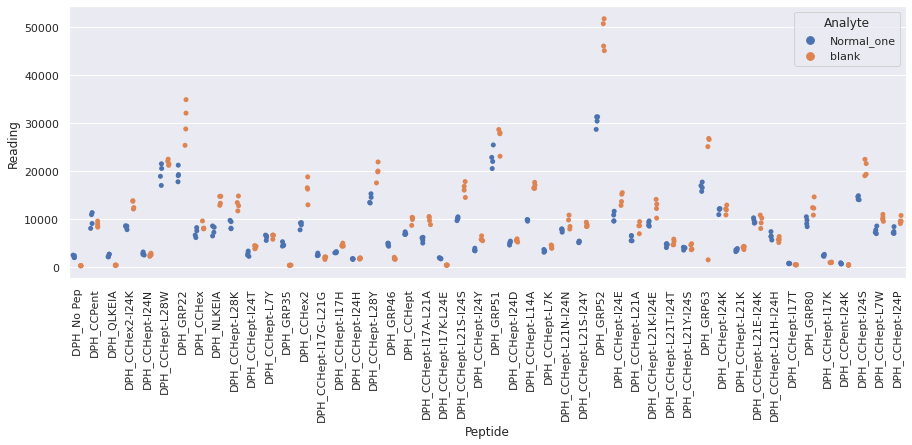

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_seven_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_seven_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

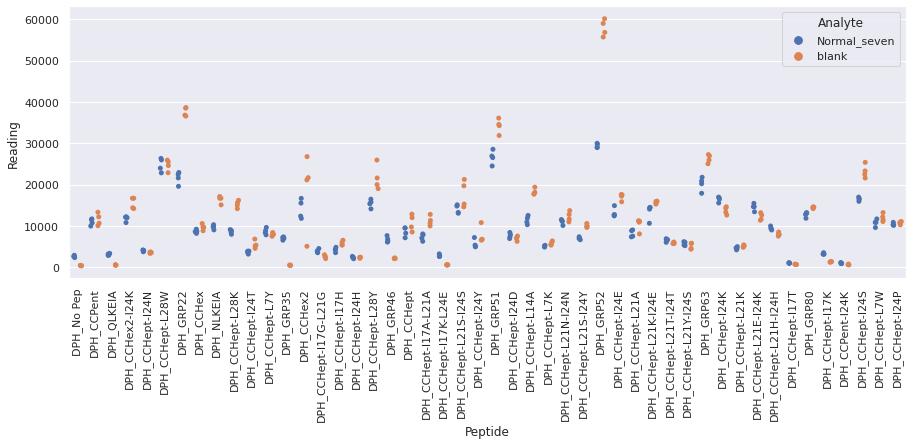

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_six_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_six_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

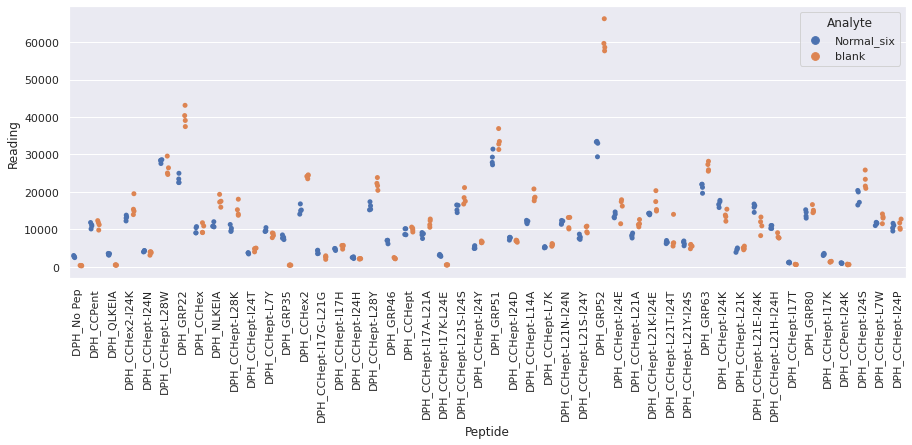

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_ten_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_ten_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

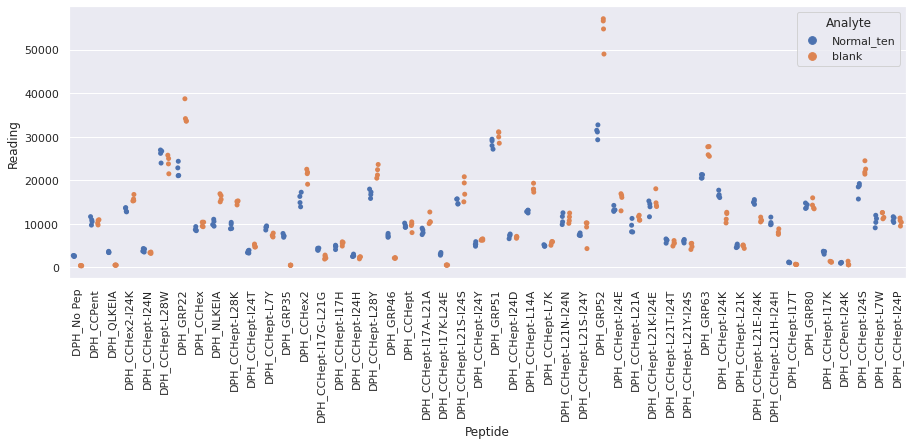

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_thirteen_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_thirteen_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

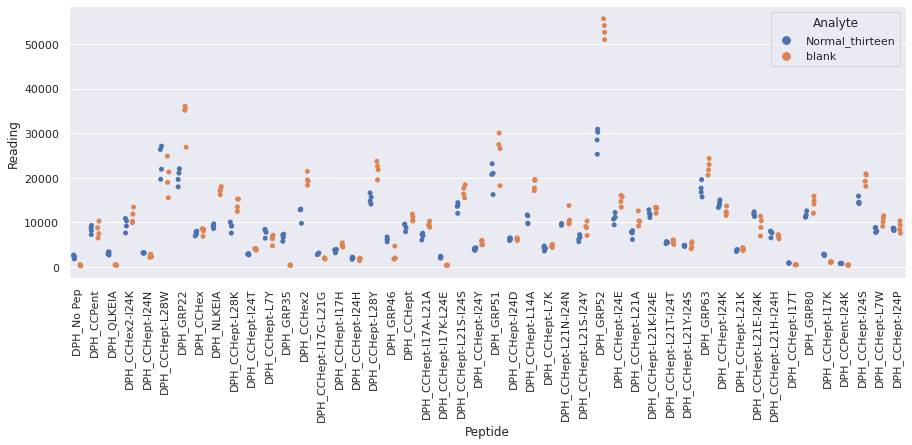

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_three_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_three_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

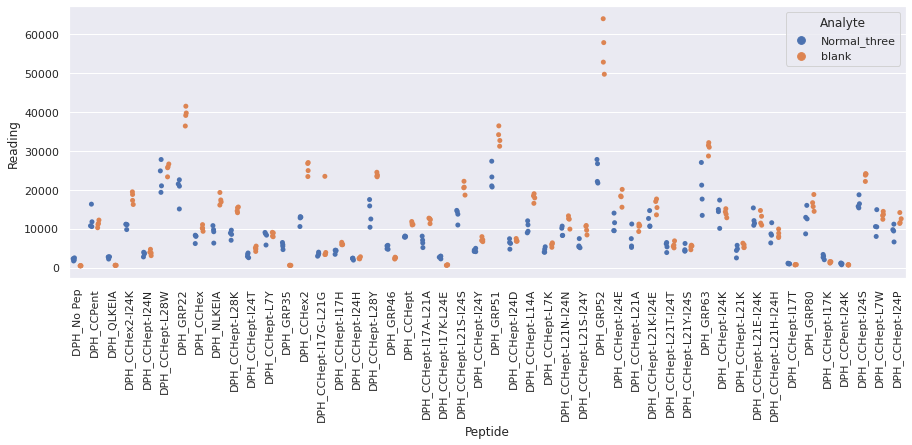

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_twelve_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_twelve_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

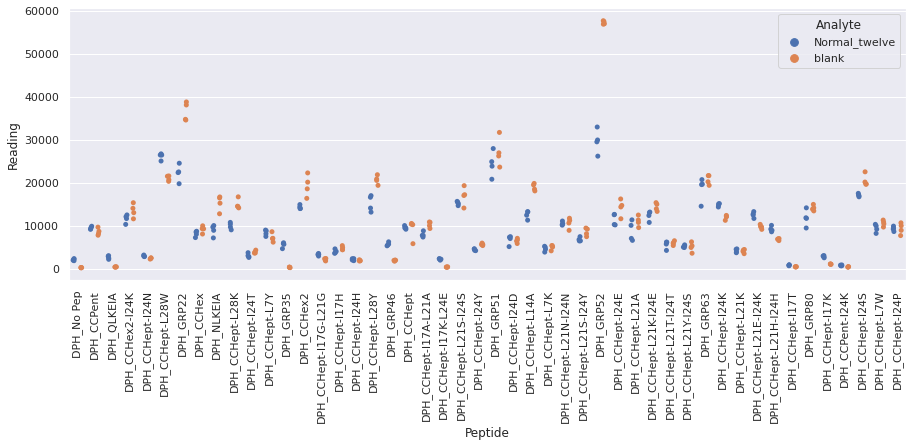

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_two_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_two_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

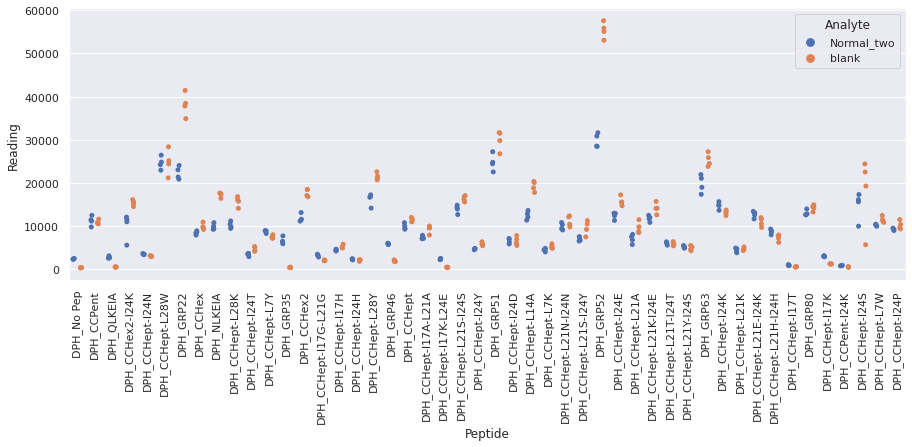

 WARNING - median fluorescence of (CAD_forty + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_forty_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_forty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_forty_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_forty + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_forty_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_fo

<Figure size 720x720 with 0 Axes>

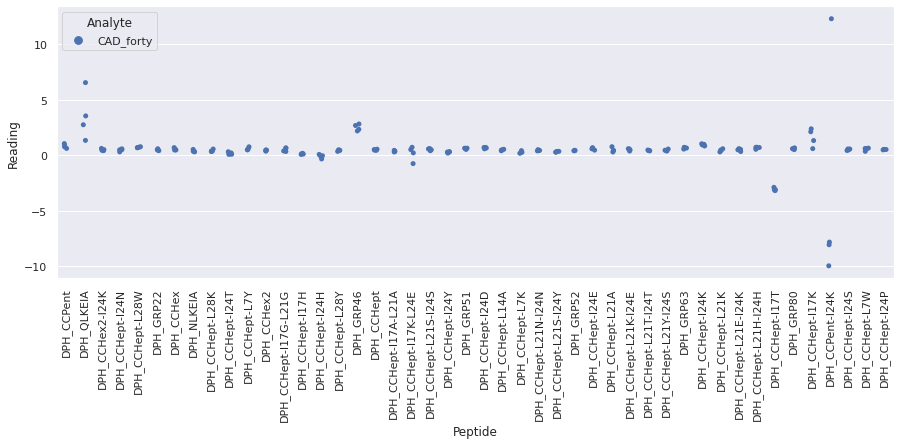

 WARNING - median fluorescence of (CAD_fortyone + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortyone_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_fortyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortyone_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_fortyone + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortyone_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plo

<Figure size 720x720 with 0 Axes>

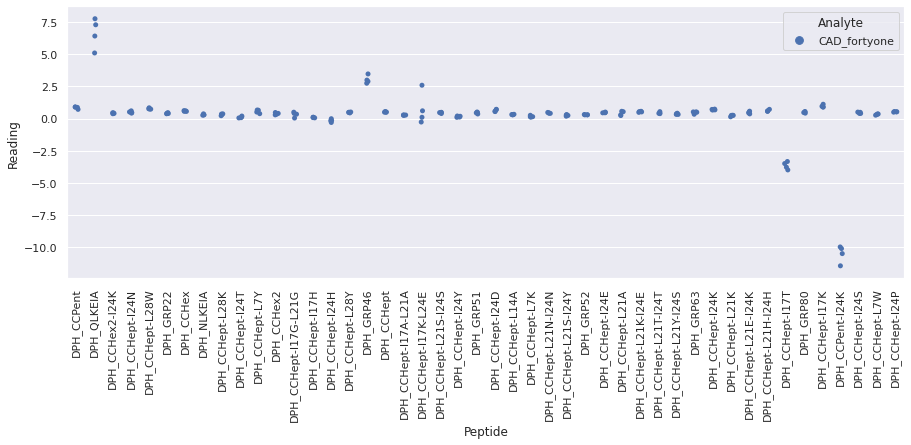

 WARNING - median fluorescence of (CAD_fortytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortytwo_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_fortytwo + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortytwo_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_fortytwo_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

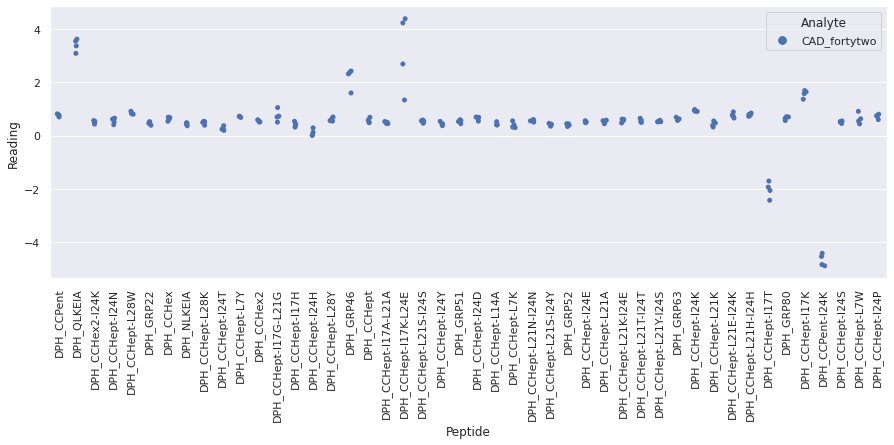

 WARNING - median fluorescence of (CAD_thirty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirty_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirty + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirty_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_thirty_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

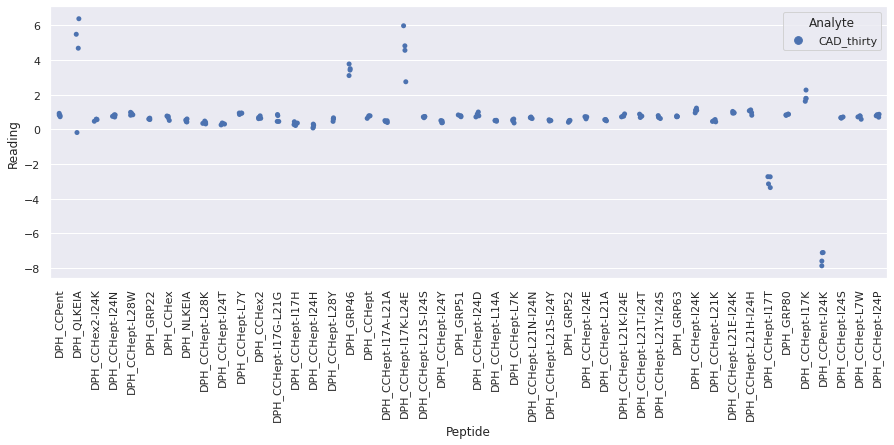

 WARNING - median fluorescence of (CAD_thirtyeight + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyeight_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyeight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyeight_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyeight + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyeight_repeat_1.xlsx. Analysis will continue but please CHECK YOUR

<Figure size 720x720 with 0 Axes>

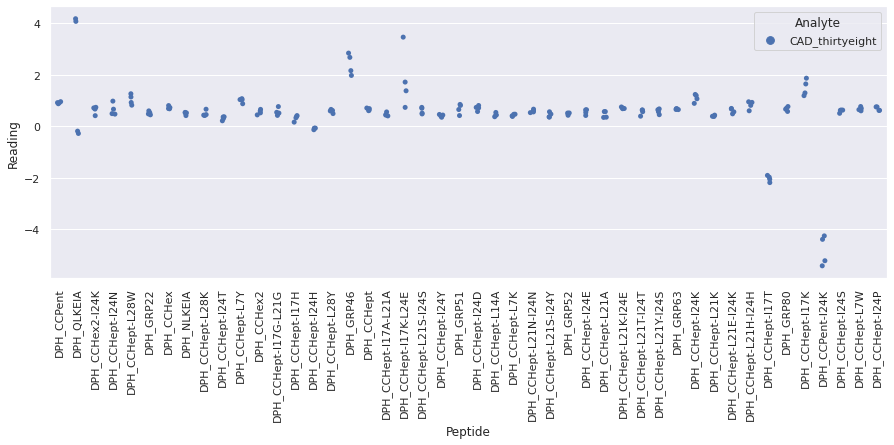

 WARNING - median fluorescence of (CAD_thirtyfive + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfive_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyfive + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfive_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_thirtyfive_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

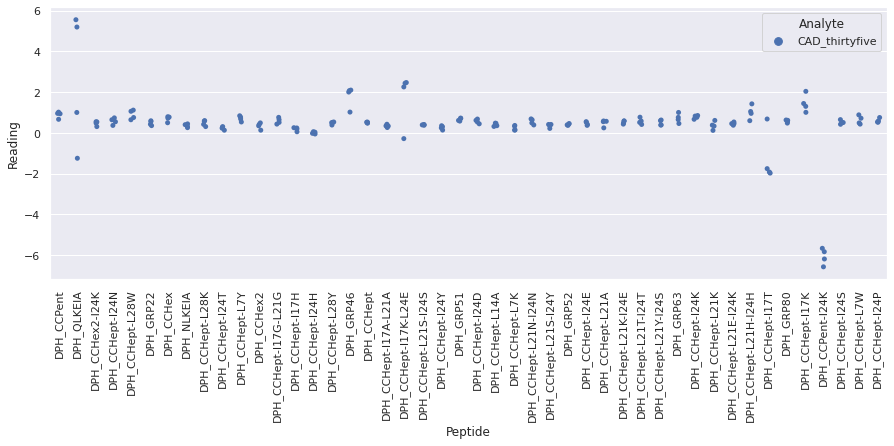

 WARNING - median fluorescence of (CAD_thirtyfour + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfour_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyfour + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfour_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_thirtyfour_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

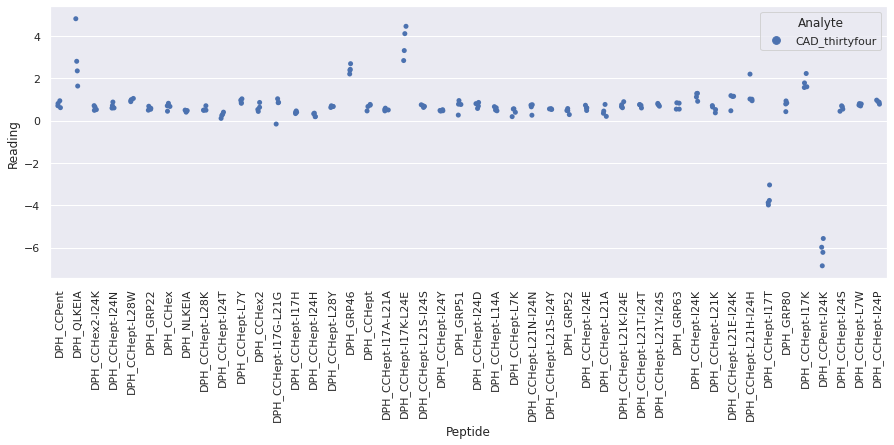

 WARNING - median fluorescence of (CAD_thirtynine + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtynine_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtynine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtynine_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtynine + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtynine_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
D

<Figure size 720x720 with 0 Axes>

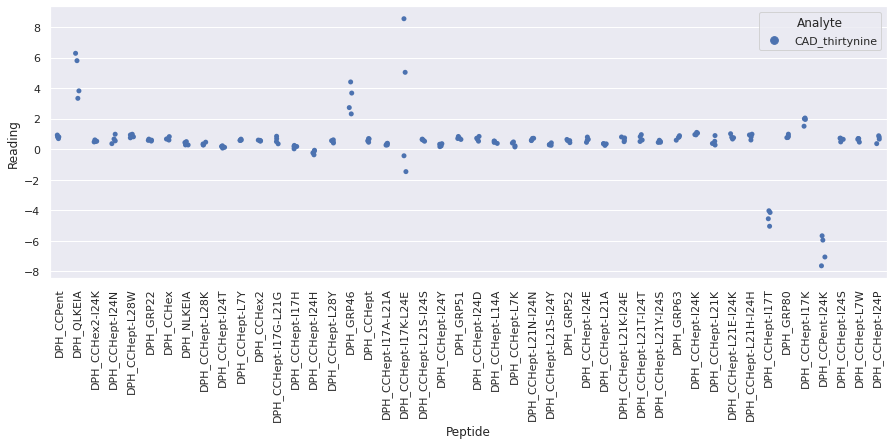

 WARNING - median fluorescence of (CAD_thirtyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyone_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyone + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyone_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_thirtyone_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

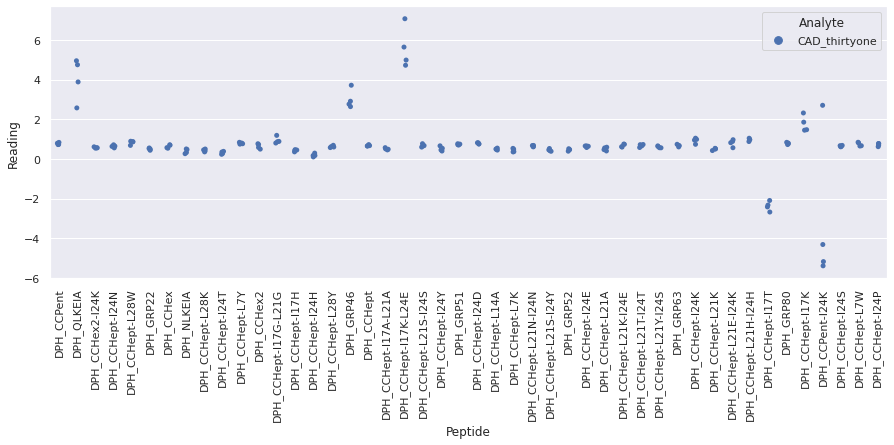

 WARNING - median fluorescence of (CAD_thirtyseven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyseven_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyseven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyseven_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_thirtyseven_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

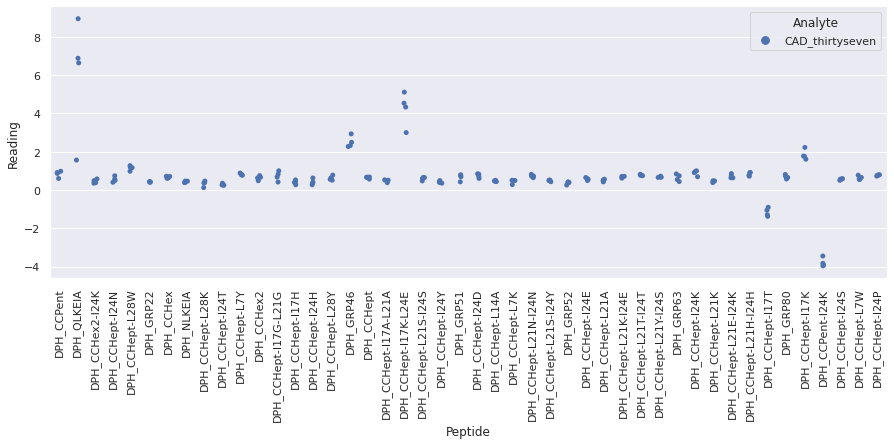

 WARNING - median fluorescence of (CAD_thirtysix + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtysix_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtysix + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtysix_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_thirtysix_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

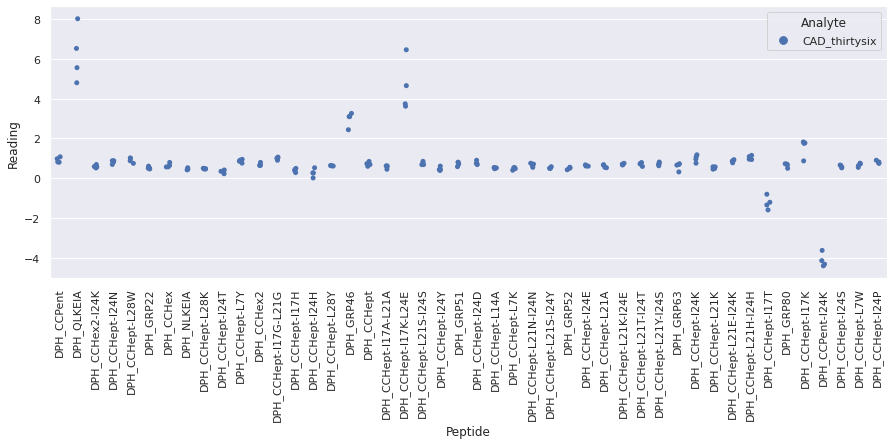

 WARNING - median fluorescence of (CAD_thirtythree + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtythree_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtythree + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtythree_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_thirtythree_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

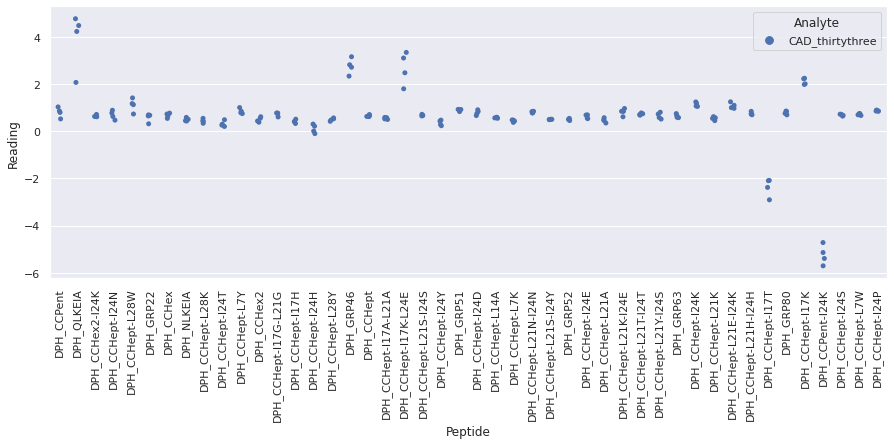

 WARNING - median fluorescence of (CAD_thirtytwo + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtytwo_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtytwo_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtytwo + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtytwo_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing sc

<Figure size 720x720 with 0 Axes>

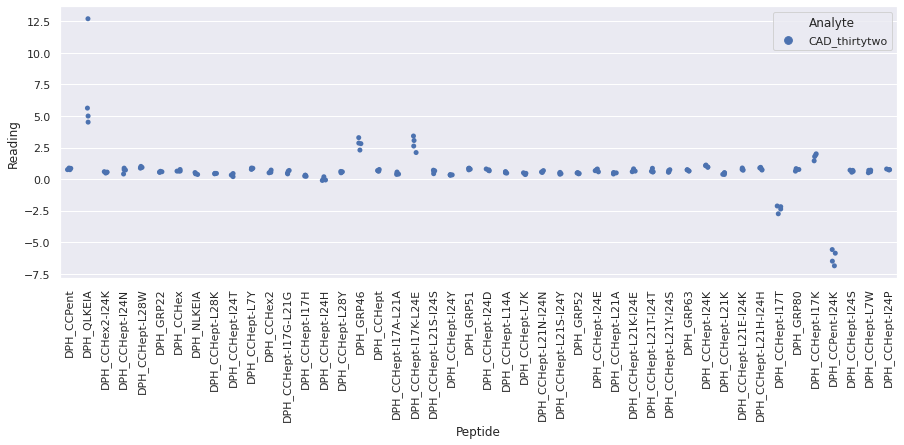

 WARNING - median fluorescence of (CAD_twentynine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_twentynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_twentynine_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_twentynine + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_twentynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_twentynine_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_twentynine_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

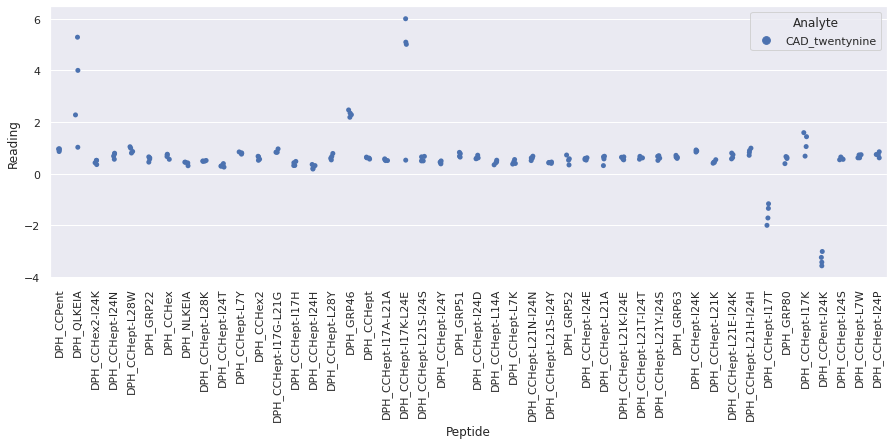

 WARNING - median fluorescence of (NASH_eighteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_eighteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_eighteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_eighteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_eighteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_eighteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_eighteen_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

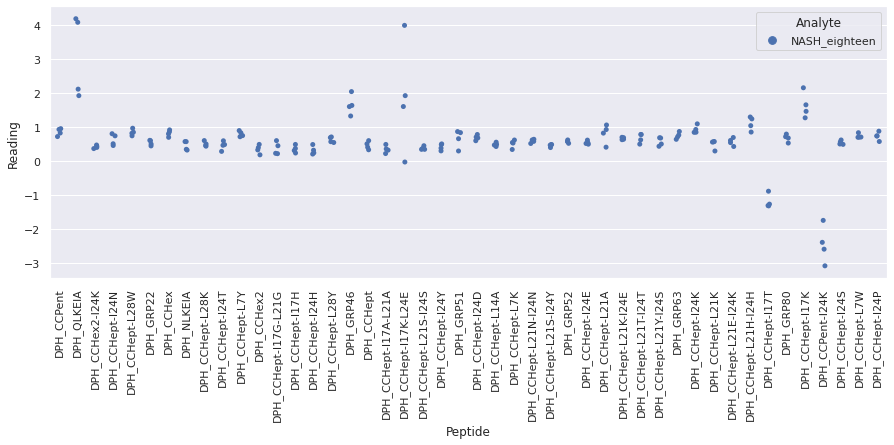

 WARNING - median fluorescence of (NASH_fifteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_fifteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_fifteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_fifteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_fifteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_fifteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_fifteen_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

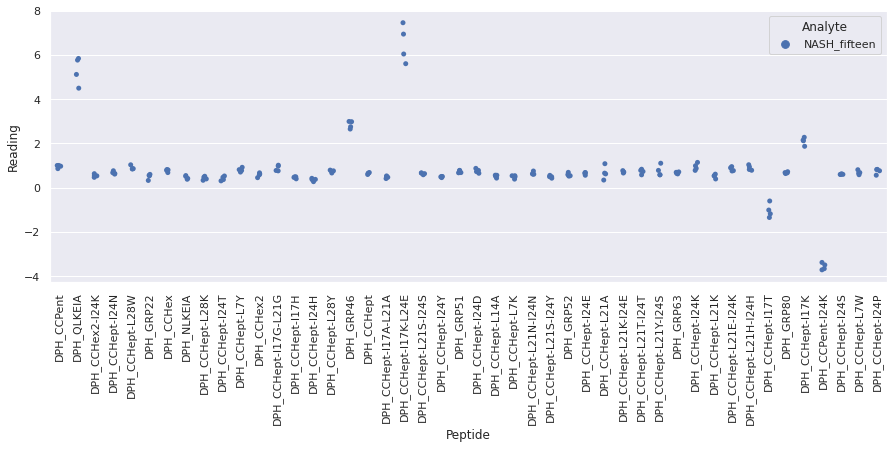

 WARNING - median fluorescence of (NASH_nineteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_nineteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_nineteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_nineteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_nineteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_nineteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_nineteen_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

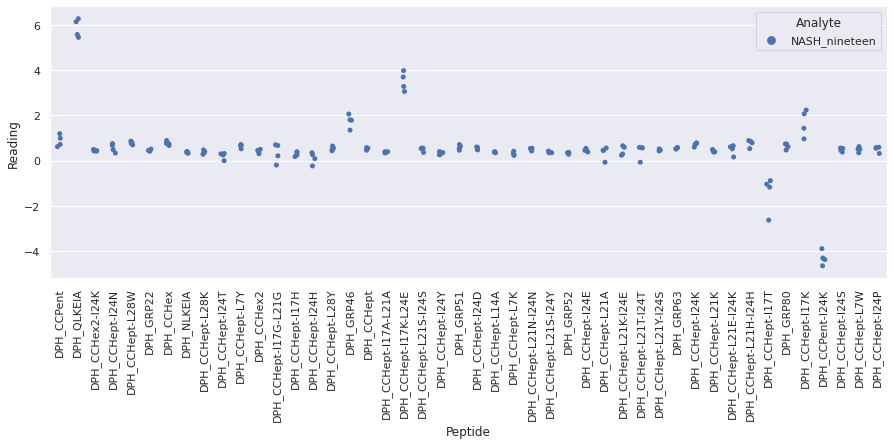

 WARNING - median fluorescence of (NASH_seventeen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_seventeen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_seventeen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_seventeen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_seventeen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_seventeen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_seventeen_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

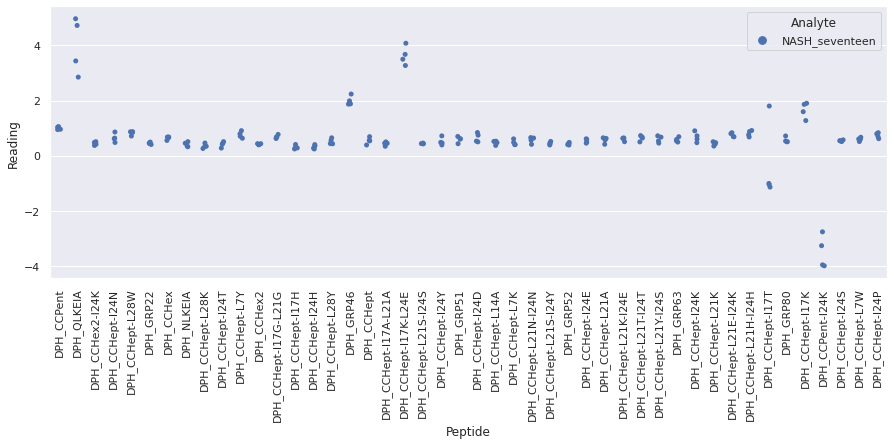

 WARNING - median fluorescence of (NASH_sixteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_sixteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_sixteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_sixteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_sixteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_sixteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_sixteen_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

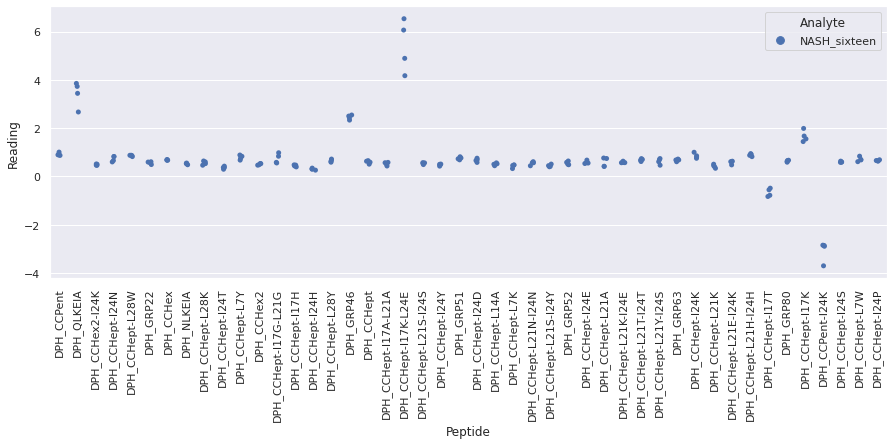

 WARNING - median fluorescence of (NASH_twenty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twenty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twenty_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twenty + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twenty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twenty_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twenty_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

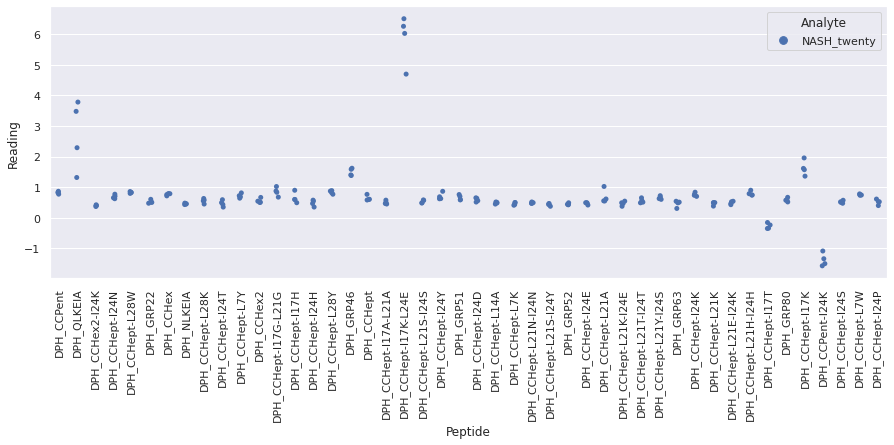

 WARNING - median fluorescence of (NASH_twentyeight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyeight_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyeight + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyeight_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyeight_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

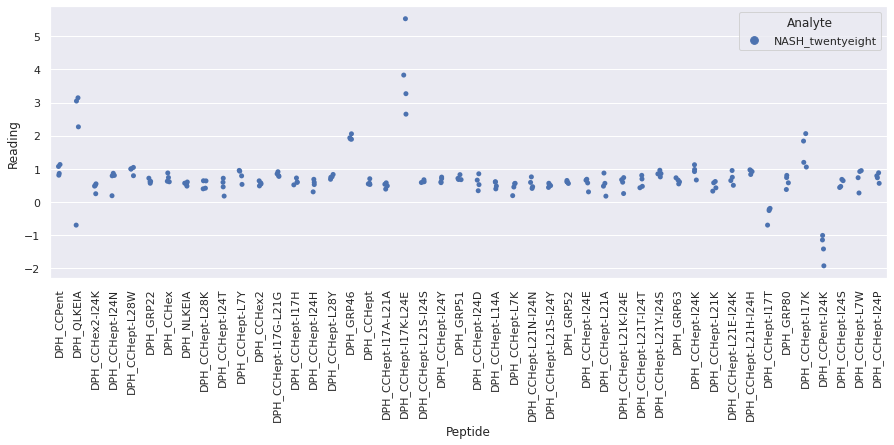

 WARNING - median fluorescence of (NASH_twentyfive + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfive_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfive + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfive_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyfive_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

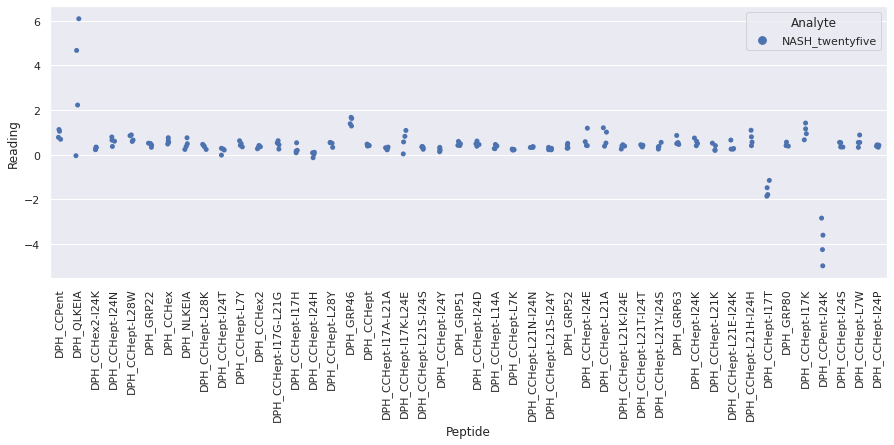

 WARNING - median fluorescence of (NASH_twentyfour + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfour_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfour + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfour_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyfour_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

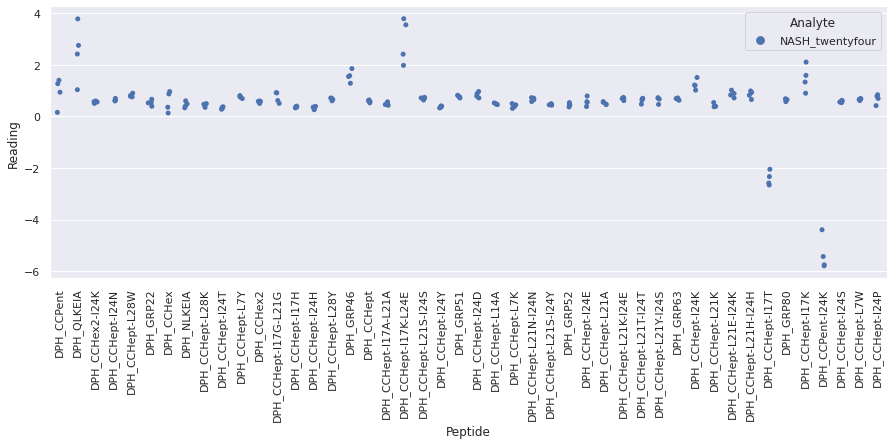

 WARNING - median fluorescence of (NASH_twentyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyone_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyone + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyone_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyone_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

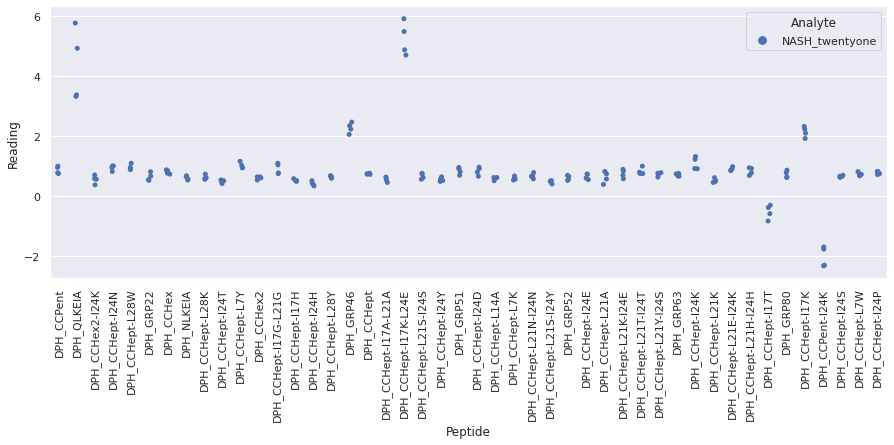

 WARNING - median fluorescence of (NASH_twentyseven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyseven_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyseven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyseven_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyseven_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

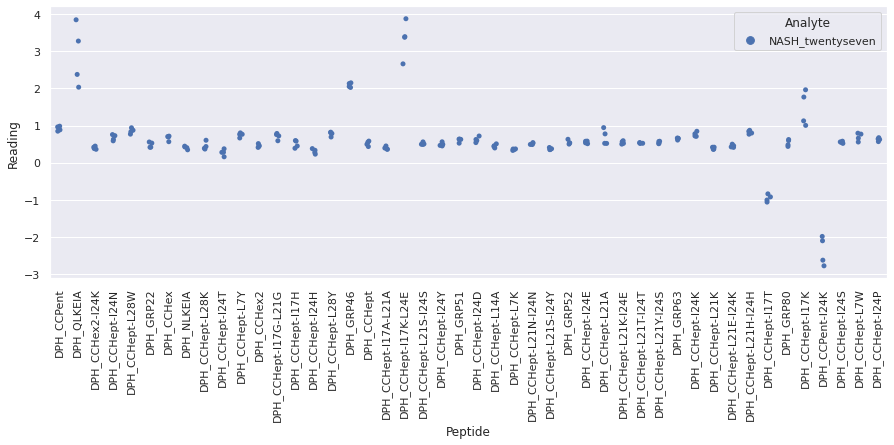

 WARNING - median fluorescence of (NASH_twentysix + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentysix_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentysix + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentysix_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentysix_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

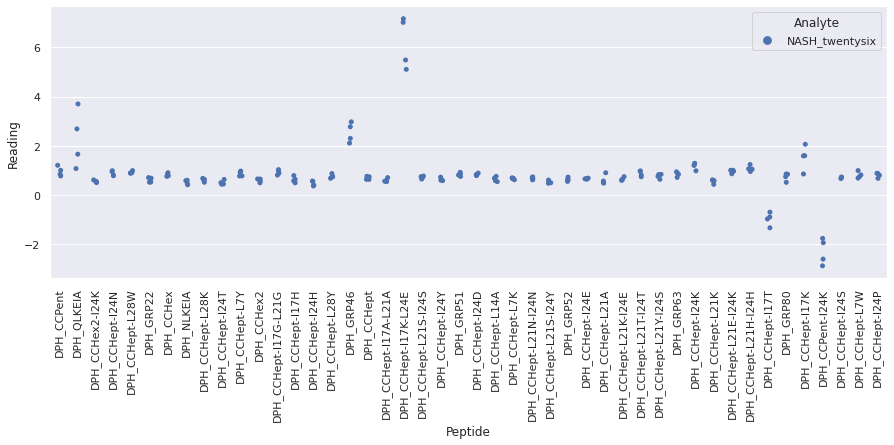

 WARNING - median fluorescence of (NASH_twentythree + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentythree_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentythree + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentythree_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentythree_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

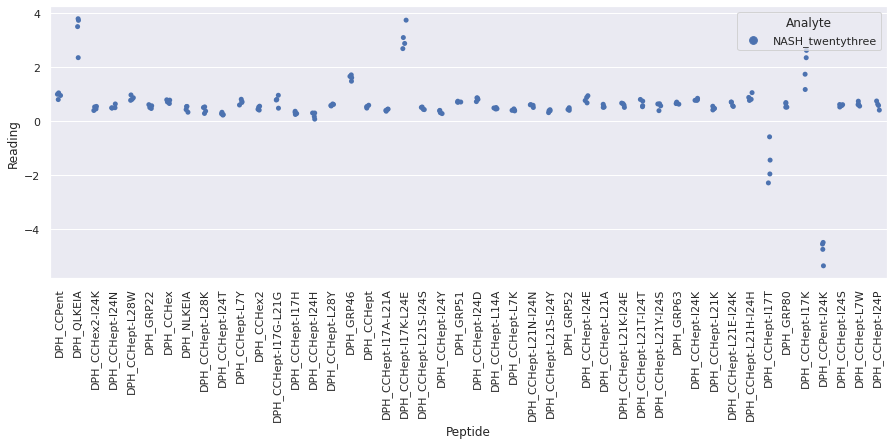

 WARNING - median fluorescence of (NASH_twentytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentytwo_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentytwo + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentytwo_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentytwo_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

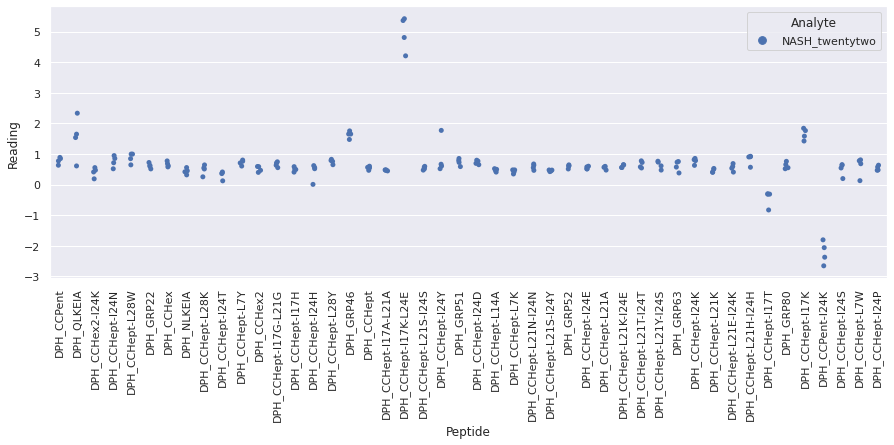

 WARNING - median fluorescence of (Normal_eight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_eight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eight_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eight + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_eight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eight_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_eight_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

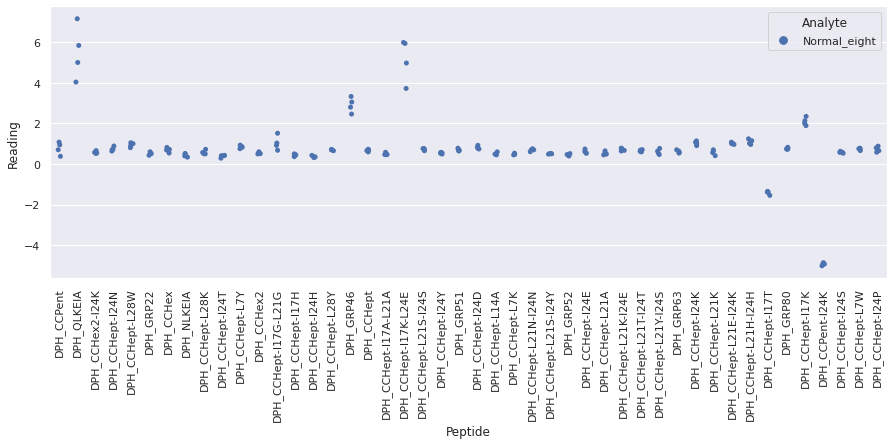

 WARNING - median fluorescence of (Normal_eleven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_eleven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eleven_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eleven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_eleven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eleven_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_eleven_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

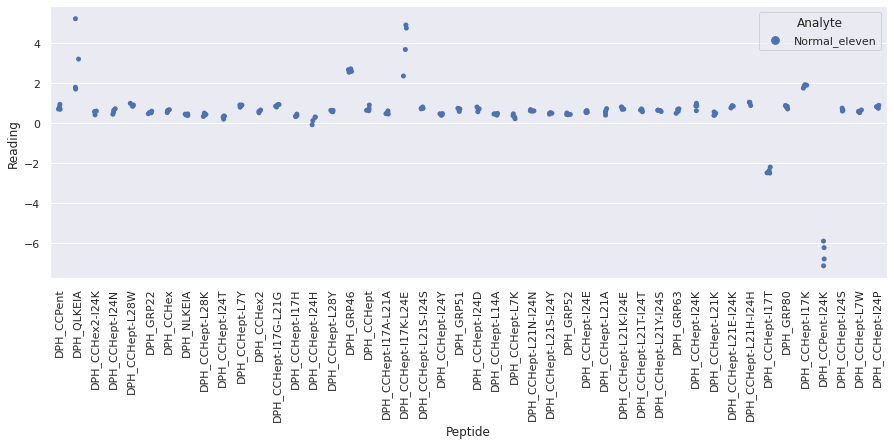

 WARNING - median fluorescence of (Normal_five + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_five + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_five_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_five + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_five + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_five_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_five_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

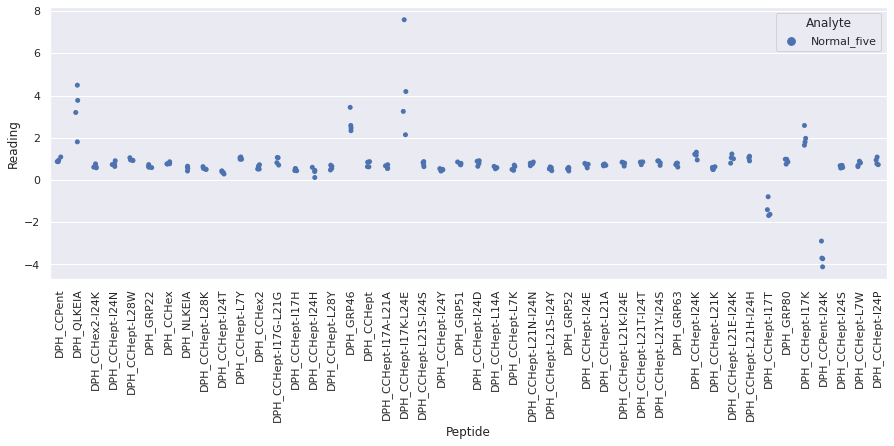

 WARNING - median fluorescence of (Normal_four + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_four + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_four_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_four + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_four + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_four_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_four_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

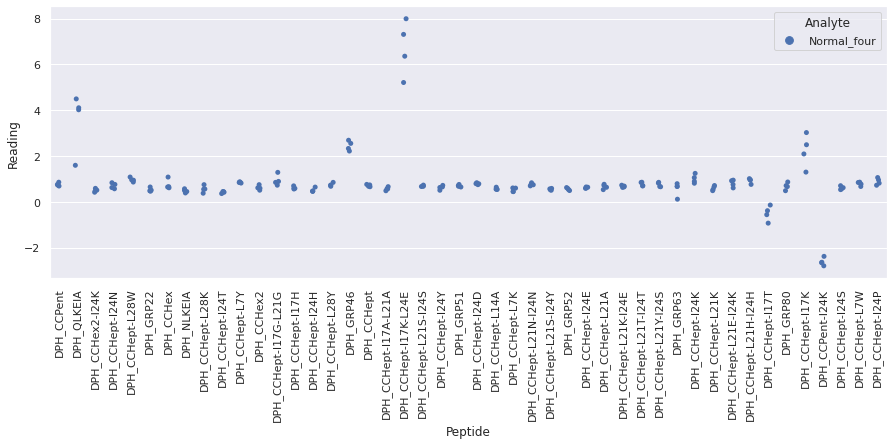

 WARNING - median fluorescence of (Normal_fourteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_fourteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_fourteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fourteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_fourteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_fourteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fourteen_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

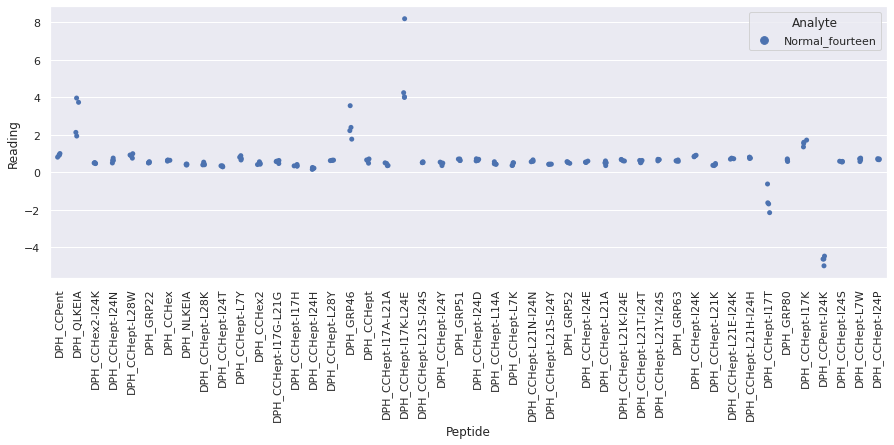

 WARNING - median fluorescence of (Normal_nine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_nine_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_nine + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_nine_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_nine_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

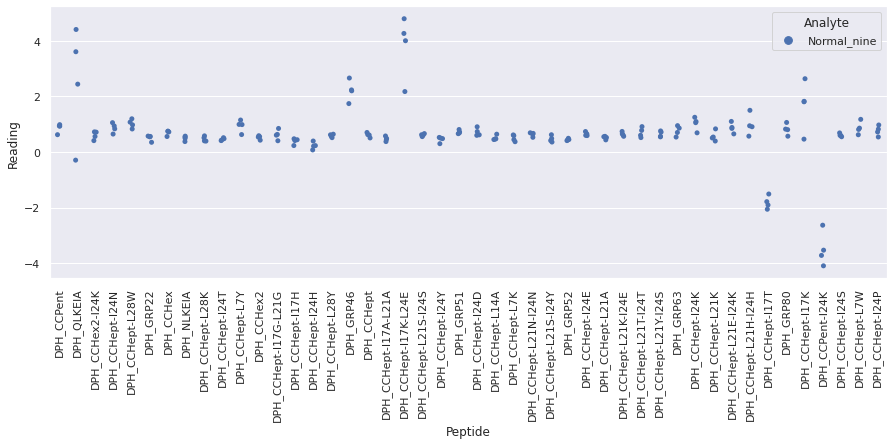

 WARNING - median fluorescence of (Normal_one + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_one + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_one_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_one + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_one + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_one_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_one_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

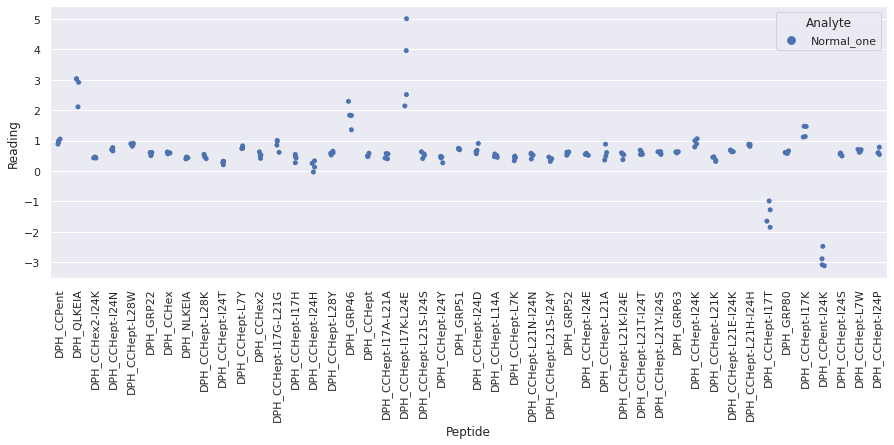

 WARNING - median fluorescence of (Normal_seven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_seven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_seven_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_seven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_seven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_seven_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_seven_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

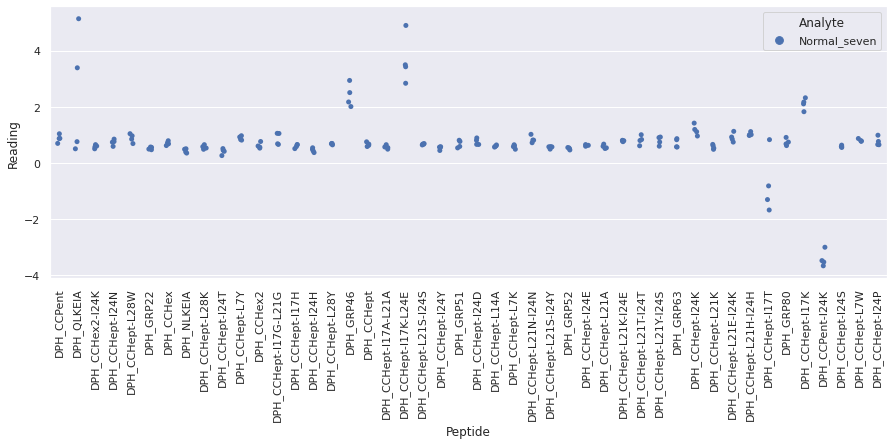

 WARNING - median fluorescence of (Normal_six + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_six + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_six_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_six + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_six + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_six_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_six_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

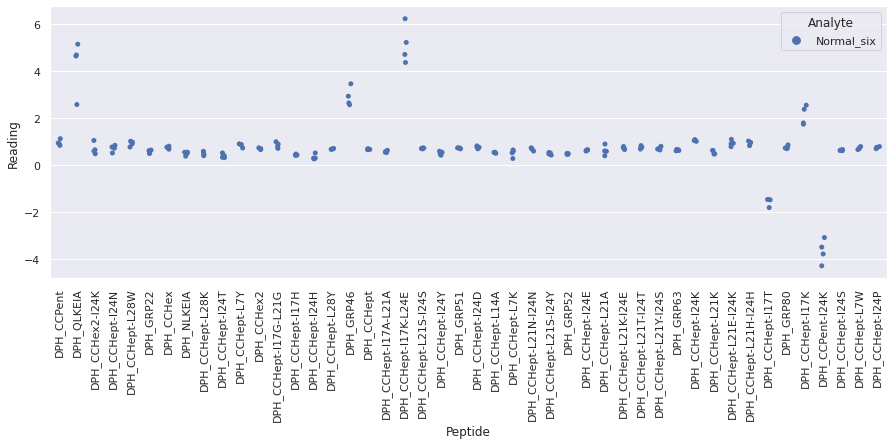

 WARNING - median fluorescence of (Normal_ten + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_ten + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_ten_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_ten + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_ten + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_ten_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_ten_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

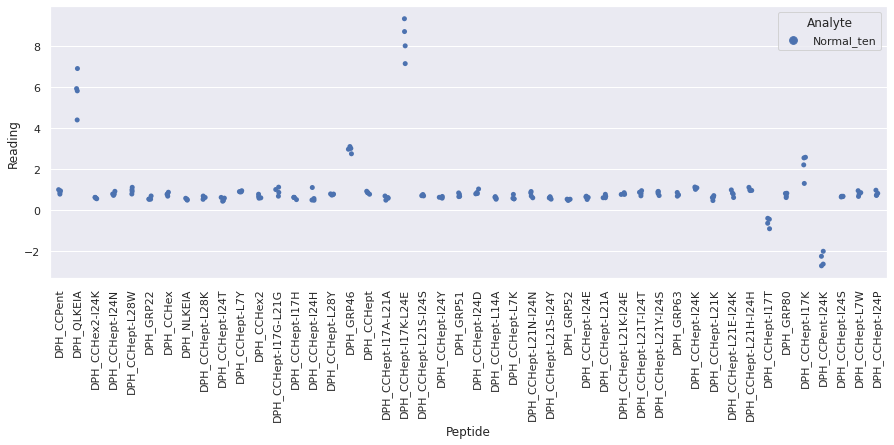

 WARNING - median fluorescence of (Normal_thirteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_thirteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_thirteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirteen_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

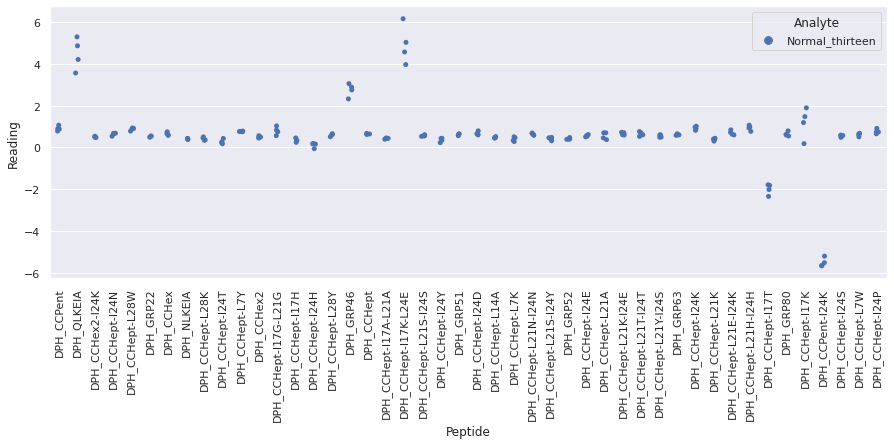

 WARNING - median fluorescence of (Normal_three + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_three + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_three_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_three + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_three + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_three_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_three_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

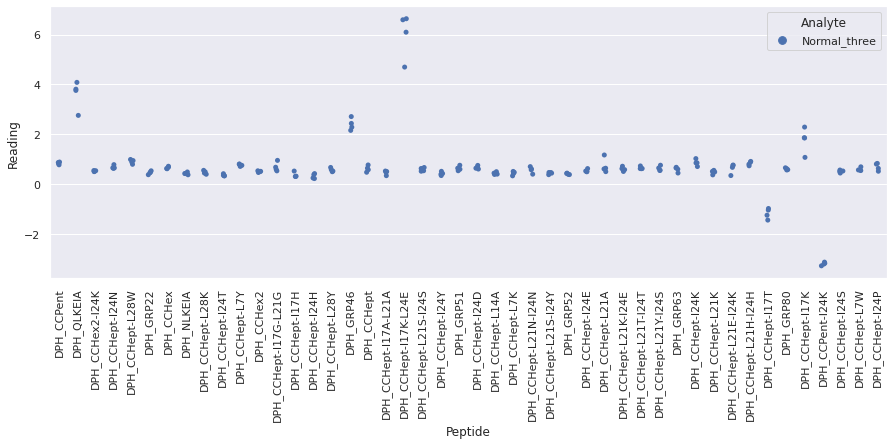

 WARNING - median fluorescence of (Normal_twelve + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_twelve + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_twelve_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_twelve + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_twelve + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_twelve_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twelve_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

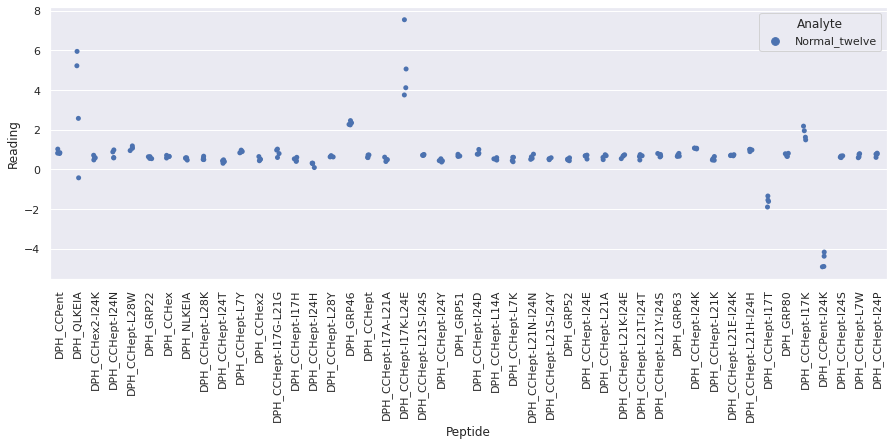

 WARNING - median fluorescence of (Normal_two + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_two + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_two_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_two + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_two + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_two_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_two_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

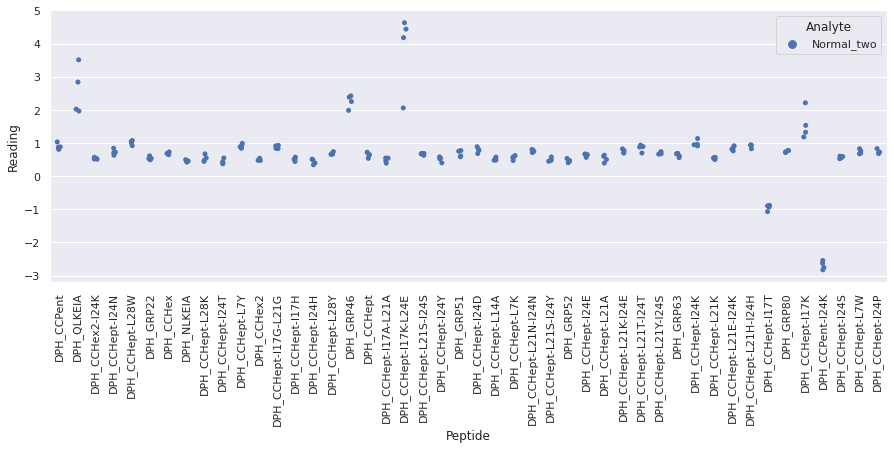

 WARNING - median fluorescence of (CAD_forty + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_forty_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_forty + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (CAD_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_forty_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_forty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_forty_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_fo

<Figure size 720x720 with 0 Axes>

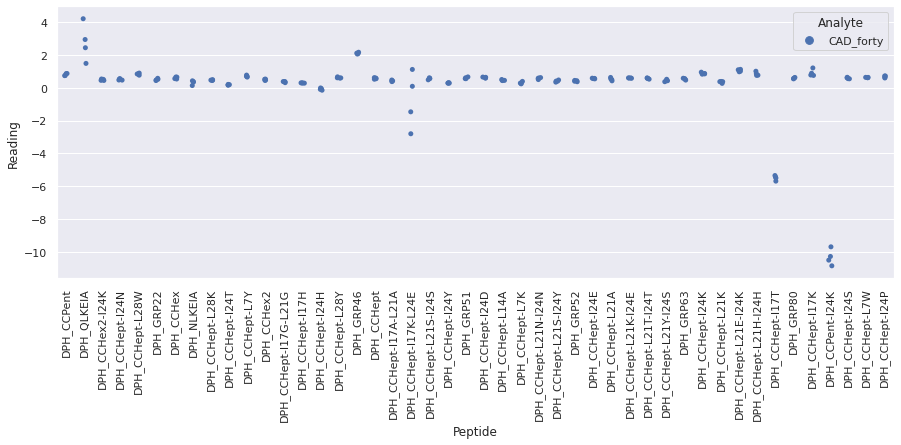

 WARNING - median fluorescence of (CAD_fortyone + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortyone_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_fortyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortyone_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_fortyone + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortyone_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plo

<Figure size 720x720 with 0 Axes>

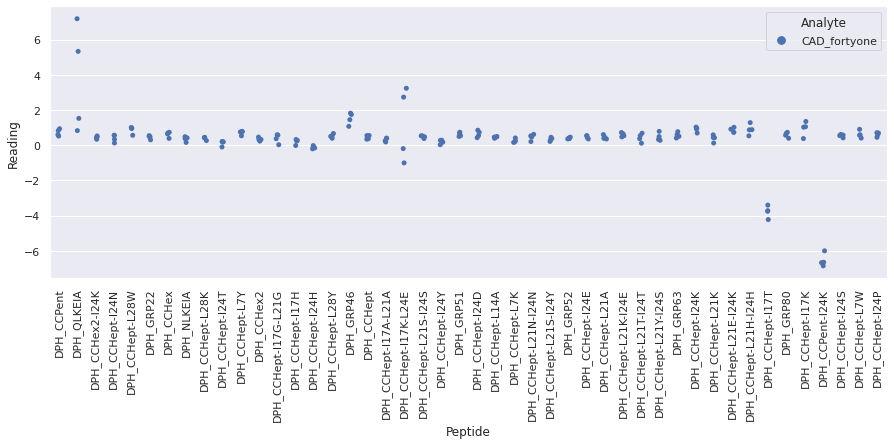

 WARNING - median fluorescence of (CAD_fortytwo + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortytwo_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_fortytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortytwo_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_fortytwo + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortytwo_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plo

<Figure size 720x720 with 0 Axes>

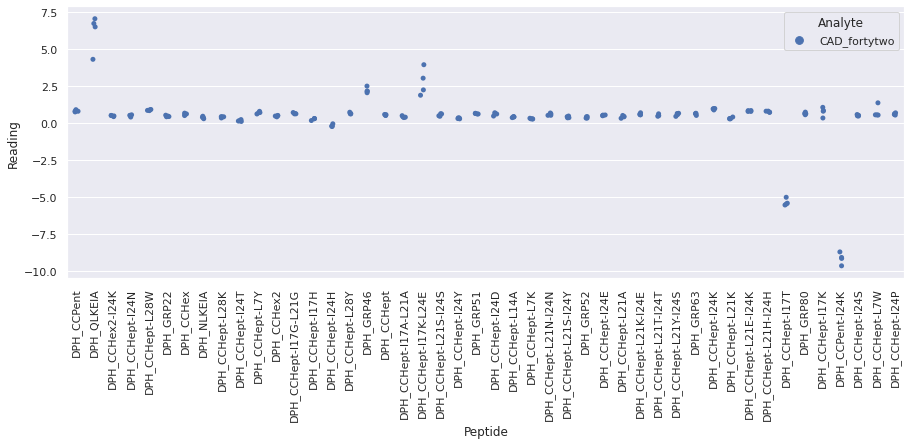

 WARNING - median fluorescence of (CAD_thirty + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirty_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirty_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirty + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirty_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread f

<Figure size 720x720 with 0 Axes>

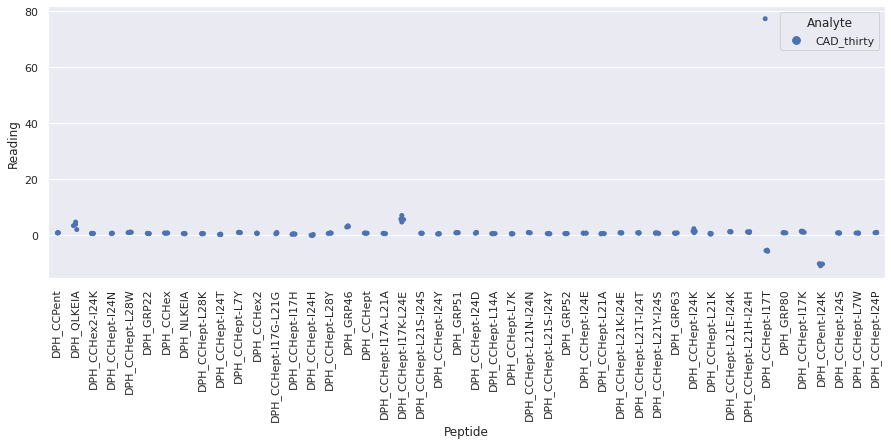

 WARNING - median fluorescence of (CAD_thirtyeight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyeight_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyeight + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyeight_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_thirtyeight_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

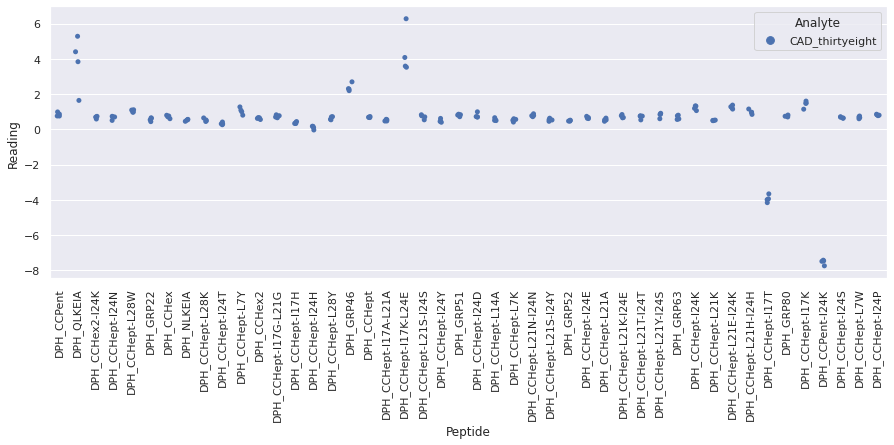

 WARNING - median fluorescence of (CAD_thirtyfive + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfive_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyfive + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfive_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_thirtyfive_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

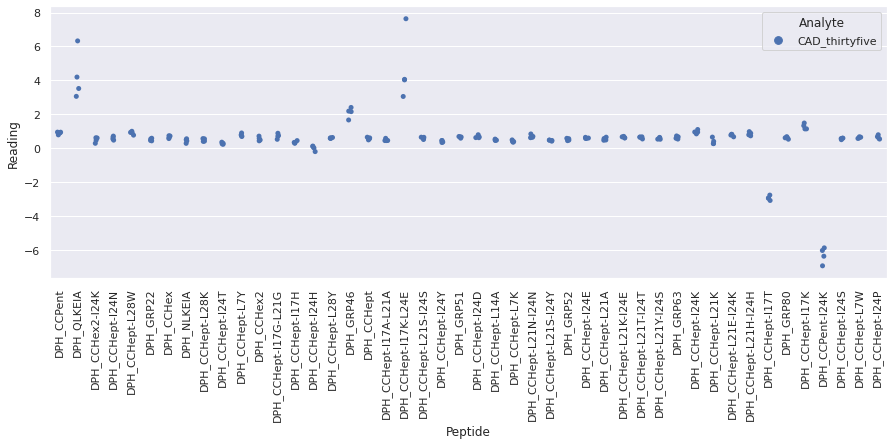

 WARNING - median fluorescence of (CAD_thirtyfour + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfour_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyfour + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfour_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_thirtyfour_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

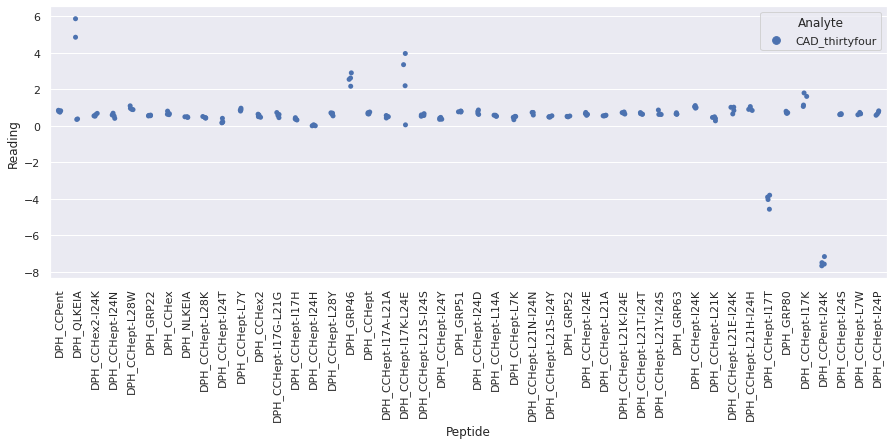

 WARNING - median fluorescence of (CAD_thirtynine + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtynine_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtynine + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (CAD_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtynine_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtynine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtynine_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DAT

<Figure size 720x720 with 0 Axes>

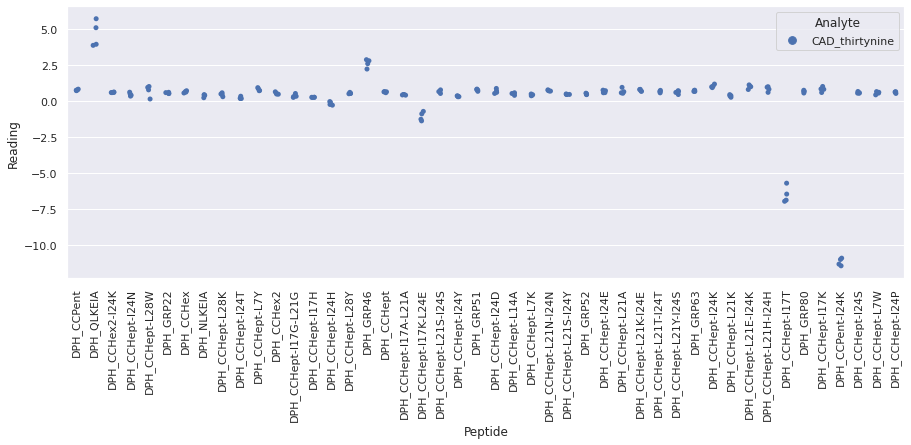

 WARNING - median fluorescence of (CAD_thirtyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyone_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyone + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyone_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_thirtyone_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

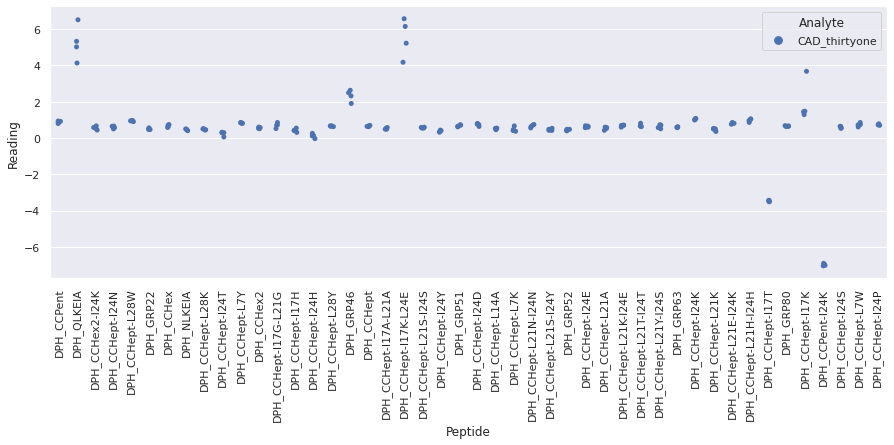

 WARNING - median fluorescence of (CAD_thirtyseven + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyseven_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyseven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyseven_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyseven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyseven_repeat_2.xlsx. Analysis will continue but please CHECK YOUR

<Figure size 720x720 with 0 Axes>

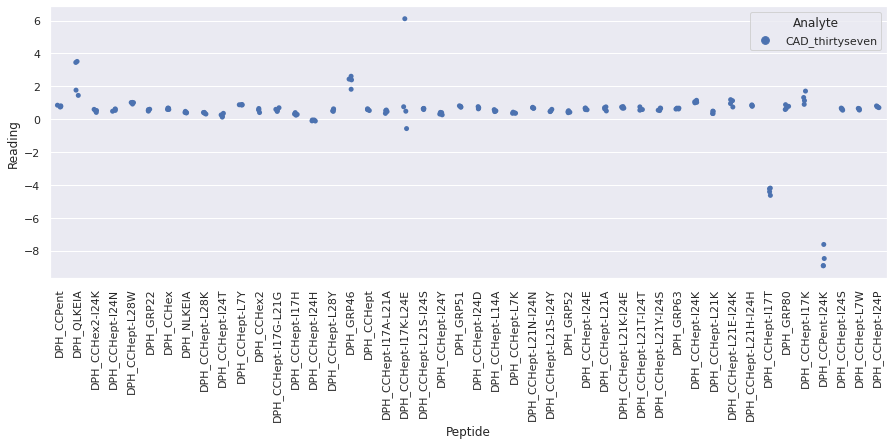

 WARNING - median fluorescence of (CAD_thirtysix + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtysix_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtysix + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtysix_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_thirtysix_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

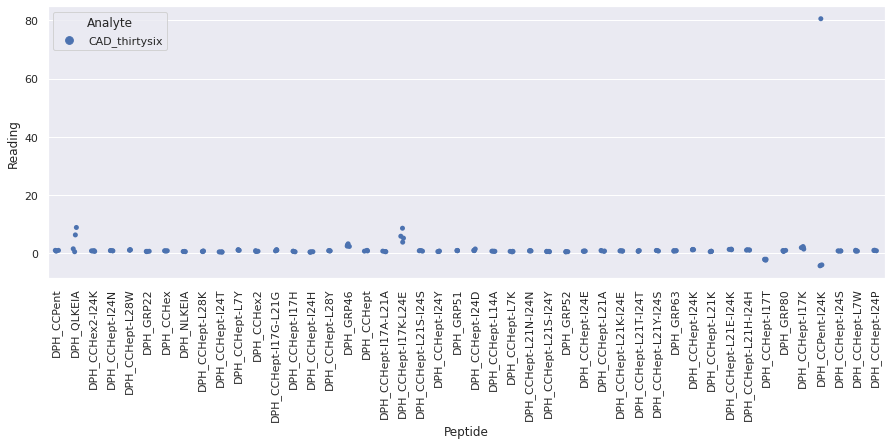

 WARNING - median fluorescence of (CAD_thirtythree + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtythree_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtythree + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtythree_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtythree + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtythree_repeat_2.xlsx. Analysis will continue but please CHECK YOUR

<Figure size 720x720 with 0 Axes>

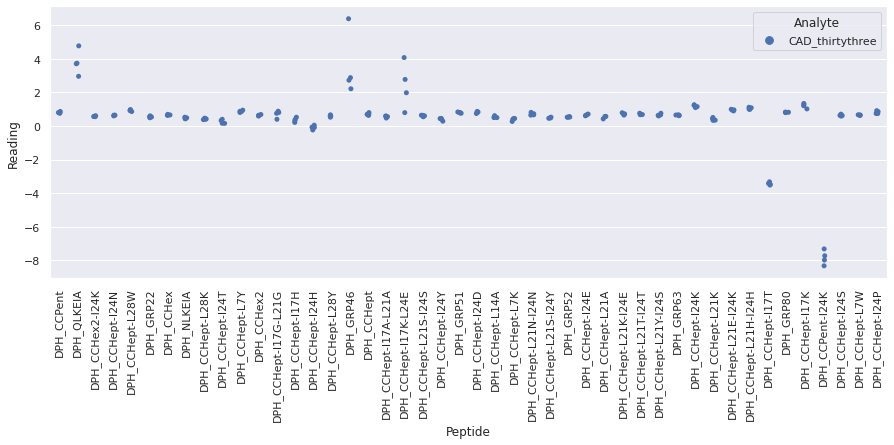

 WARNING - median fluorescence of (CAD_thirtytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtytwo_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtytwo + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtytwo_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_thirtytwo_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

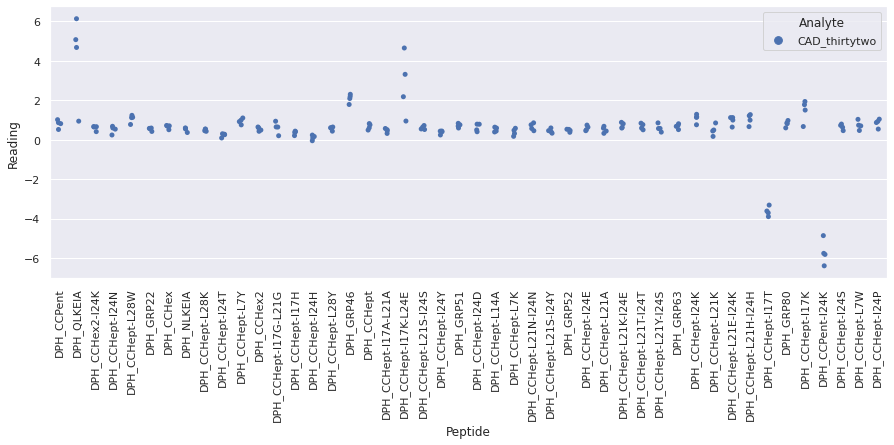

 WARNING - median fluorescence of (CAD_twentynine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_twentynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_twentynine_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_twentynine + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_twentynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_twentynine_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_twentynine_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

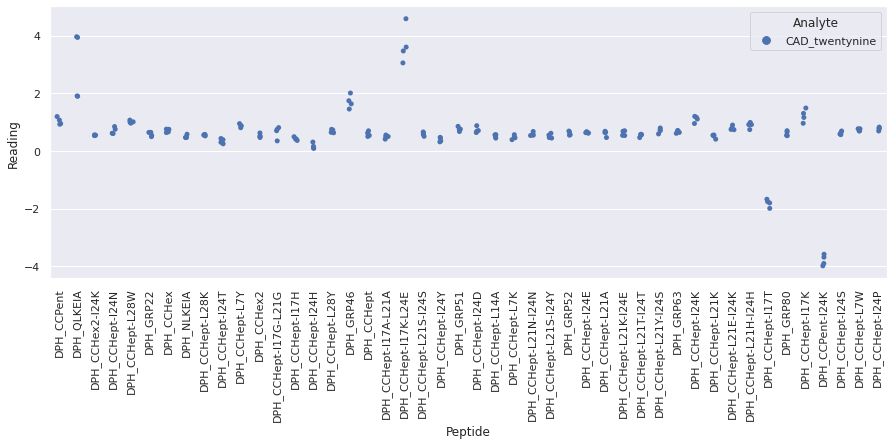

 WARNING - median fluorescence of (NASH_eighteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_eighteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_eighteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_eighteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_eighteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_eighteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_eighteen_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

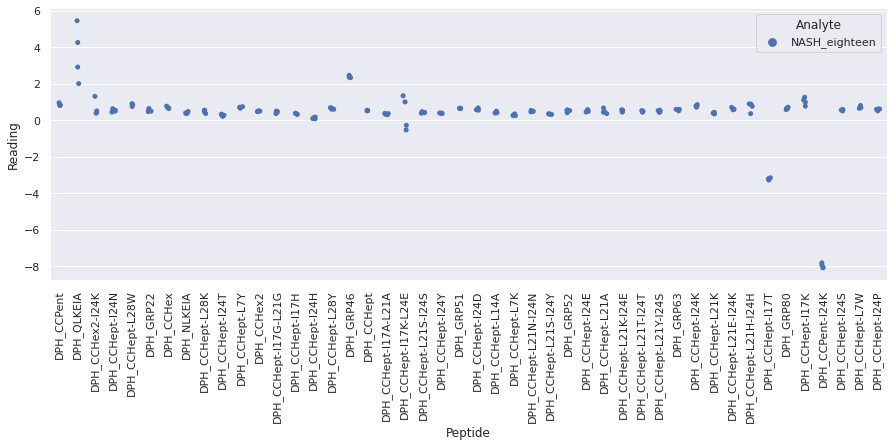

 WARNING - median fluorescence of (NASH_fifteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_fifteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_fifteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_fifteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_fifteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_fifteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_fifteen_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

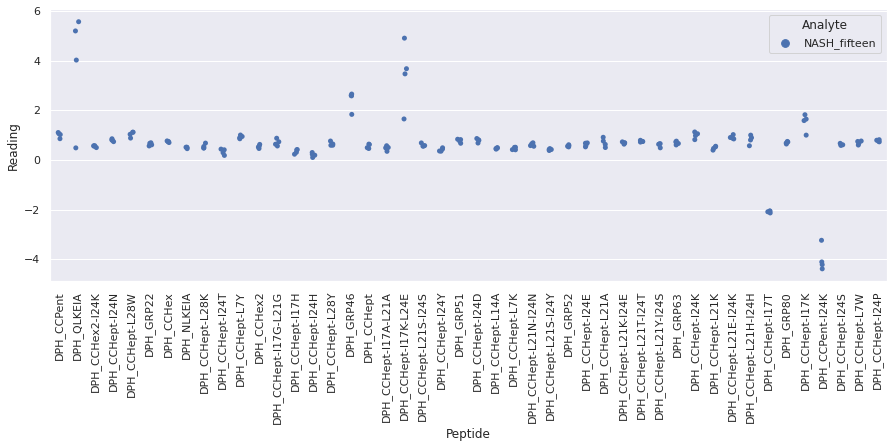

 WARNING - median fluorescence of (NASH_nineteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_nineteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_nineteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_nineteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_nineteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_nineteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_nineteen_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

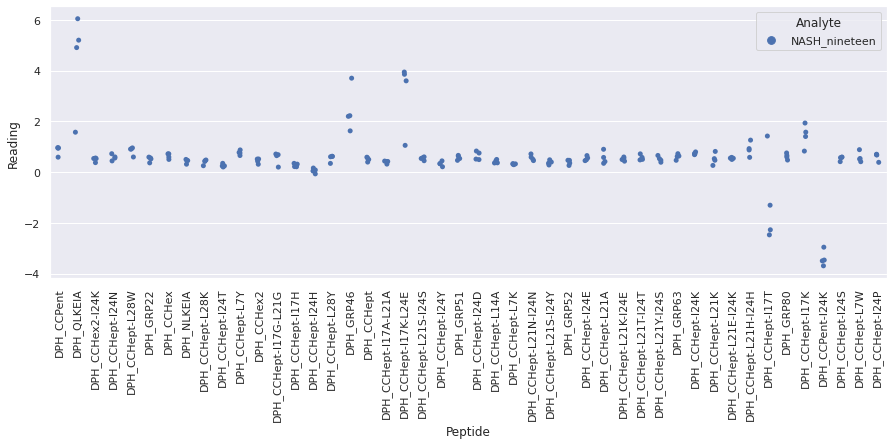

 WARNING - median fluorescence of (NASH_seventeen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_seventeen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_seventeen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_seventeen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_seventeen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_seventeen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_seventeen_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

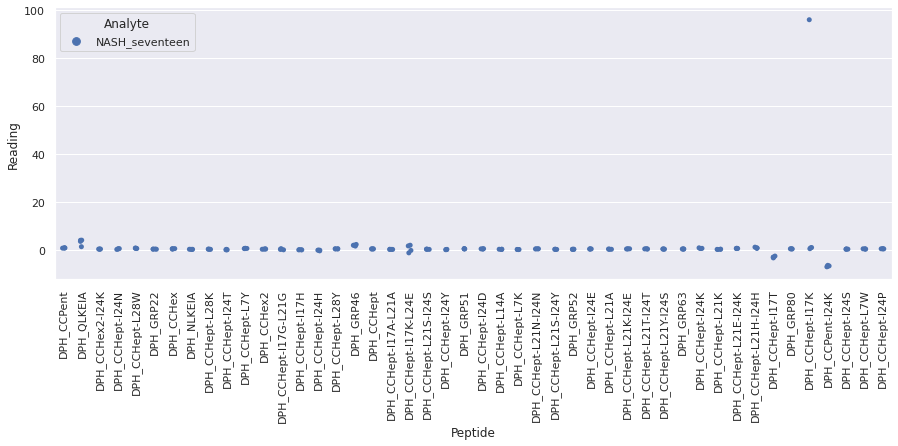

 WARNING - median fluorescence of (NASH_sixteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_sixteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_sixteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_sixteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_sixteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_sixteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_sixteen_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

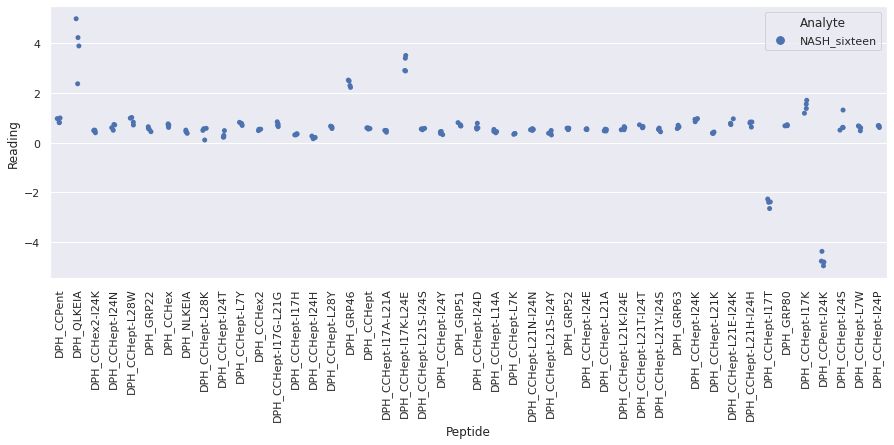

 WARNING - median fluorescence of (NASH_twenty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twenty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twenty_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twenty + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twenty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twenty_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twenty_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

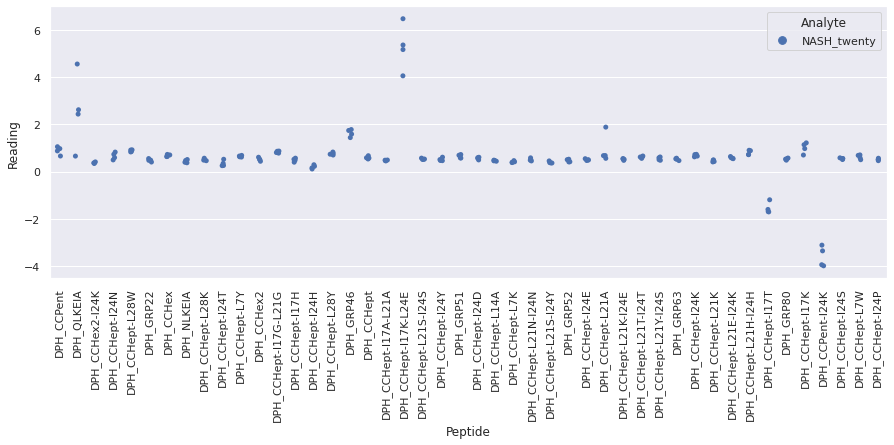

 WARNING - median fluorescence of (NASH_twentyeight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyeight_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyeight + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyeight_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyeight_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

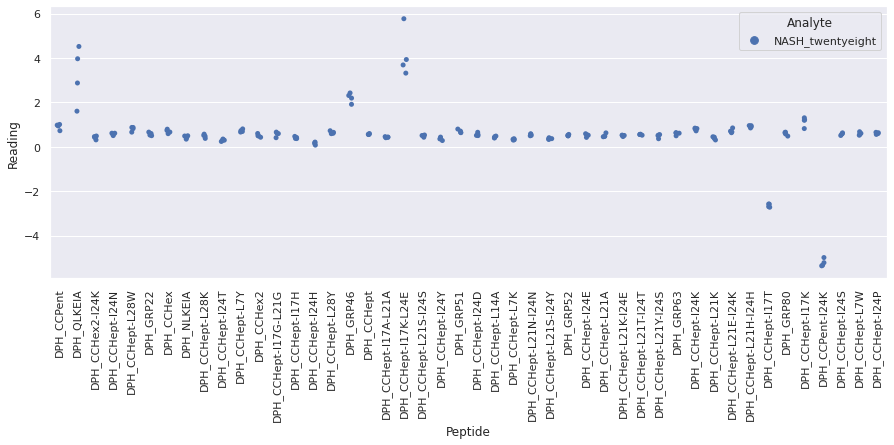

 WARNING - median fluorescence of (NASH_twentyfive + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfive_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfive + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfive_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyfive_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

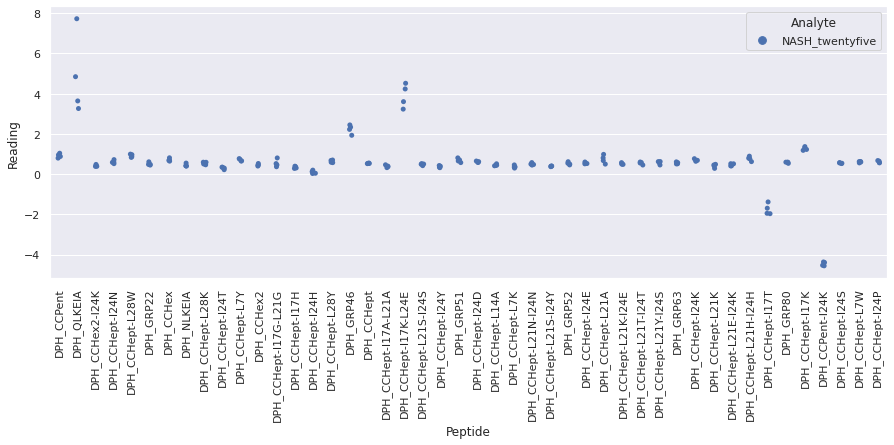

 WARNING - median fluorescence of (NASH_twentyfour + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfour_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfour + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfour_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyfour_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

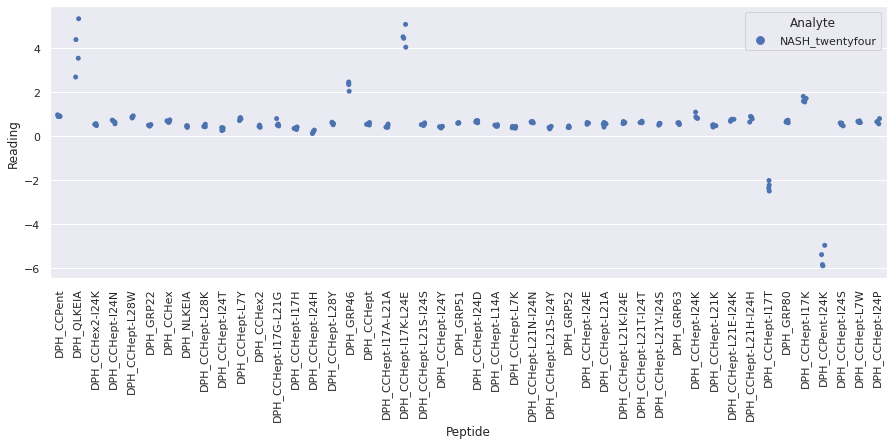

 WARNING - median fluorescence of (NASH_twentyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyone_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyone + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyone_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyone_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

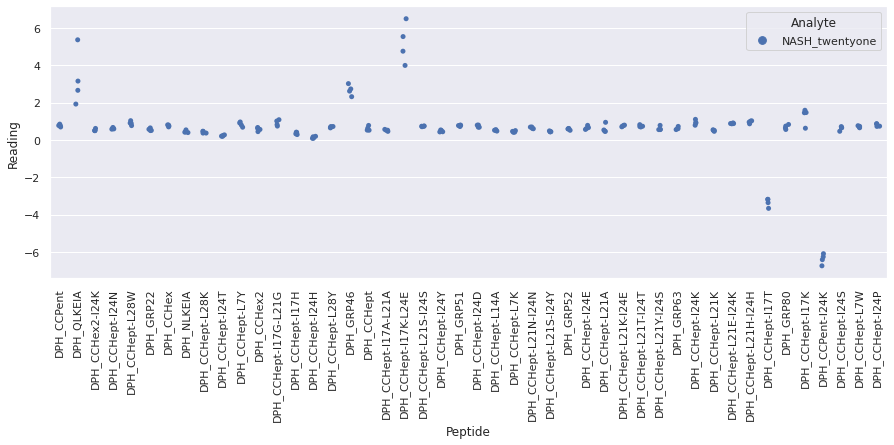

 WARNING - median fluorescence of (NASH_twentyseven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyseven_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyseven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyseven_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyseven_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

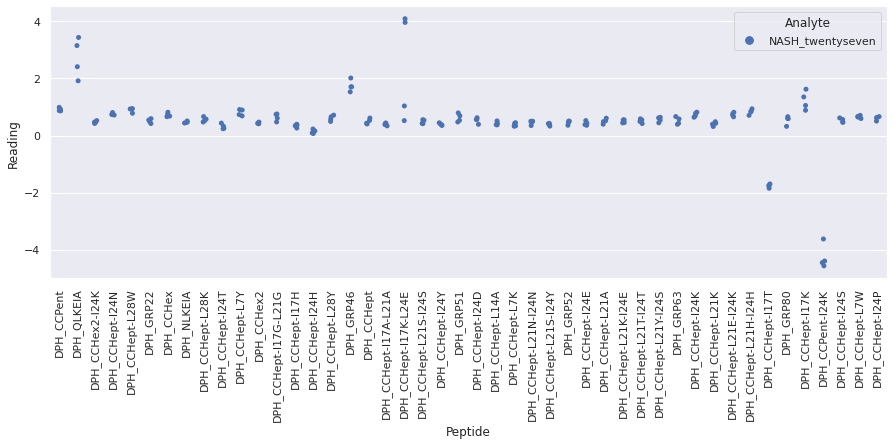

 WARNING - median fluorescence of (NASH_twentysix + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentysix_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentysix + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentysix_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentysix_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

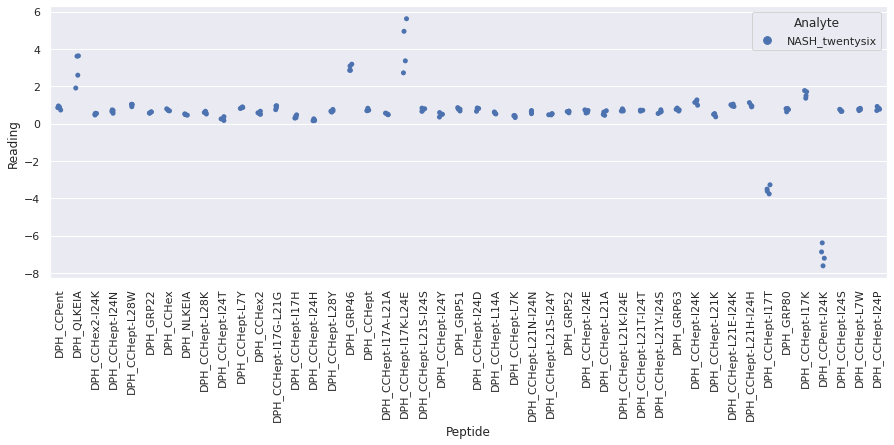

 WARNING - median fluorescence of (NASH_twentythree + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentythree_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentythree + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentythree_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentythree_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

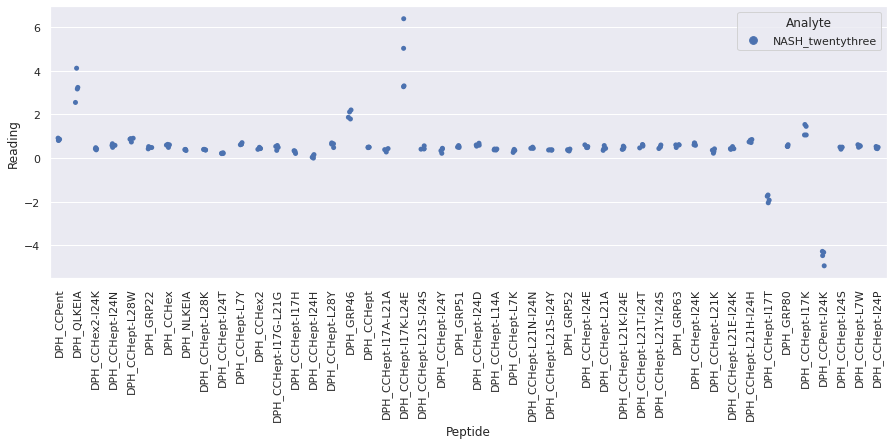

 WARNING - median fluorescence of (NASH_twentytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentytwo_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentytwo + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentytwo_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentytwo_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

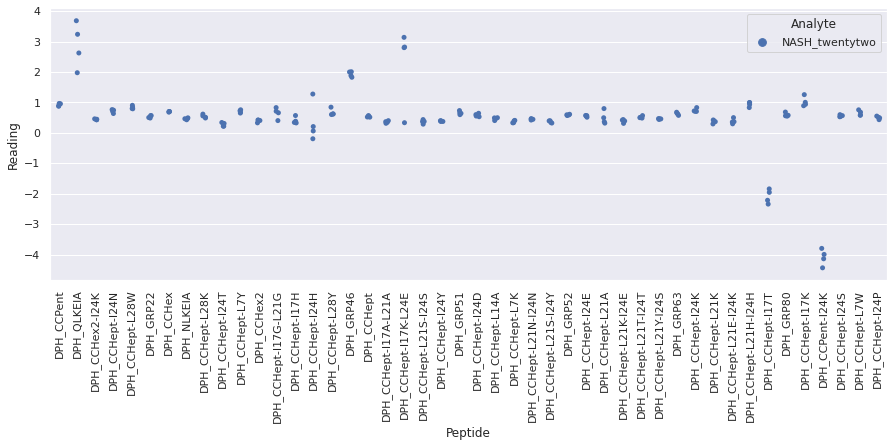

 WARNING - median fluorescence of (Normal_eight + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_eight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eight_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_eight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eight_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eight + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_eight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eight_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plo

<Figure size 720x720 with 0 Axes>

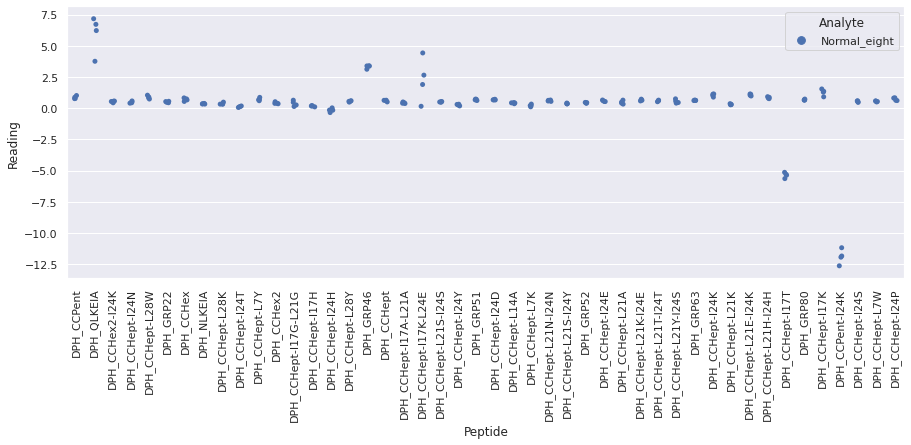

 WARNING - median fluorescence of (Normal_eleven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_eleven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eleven_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eleven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_eleven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eleven_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_eleven_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

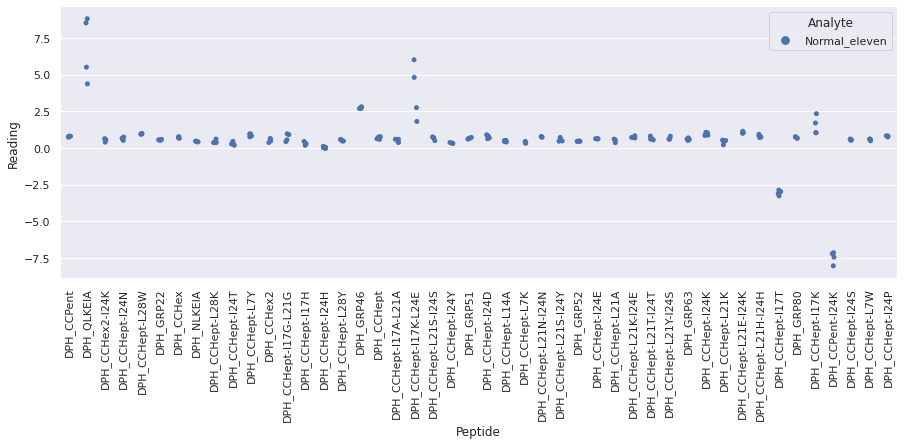

 WARNING - median fluorescence of (Normal_five + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_five + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_five_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_five + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_five + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_five_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_five_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

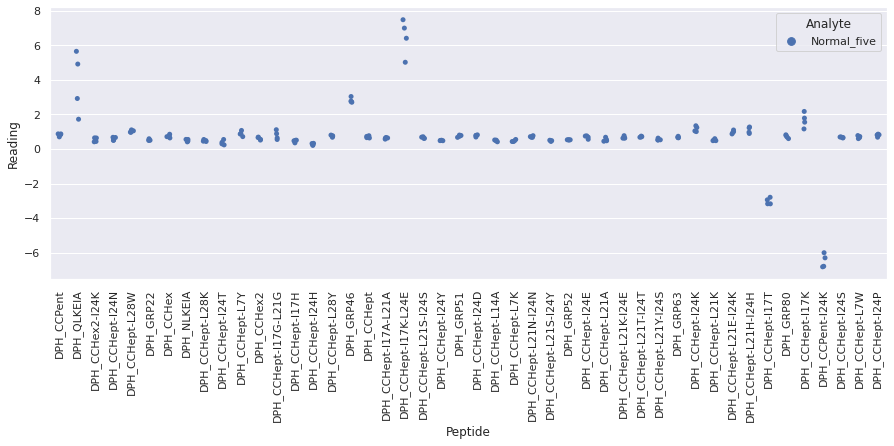

 WARNING - median fluorescence of (Normal_four + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_four + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_four_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_four + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_four + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_four_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_four + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_four + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_four_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data

<Figure size 720x720 with 0 Axes>

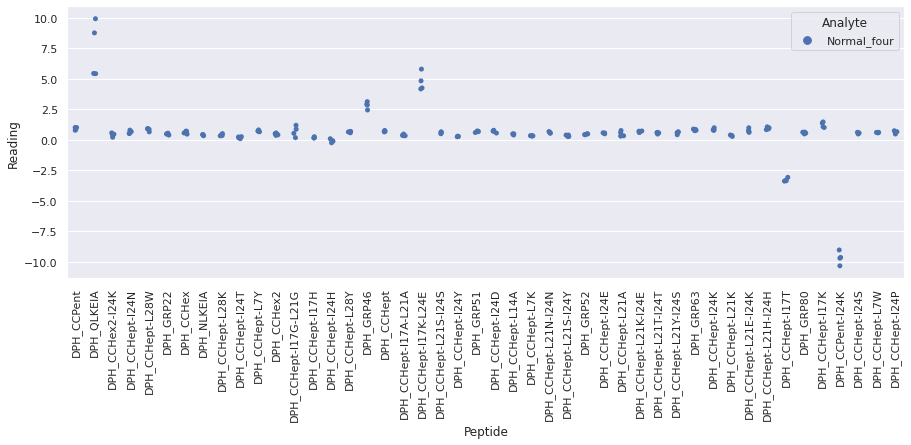

 WARNING - median fluorescence of (Normal_fourteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_fourteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_fourteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fourteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_fourteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_fourteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fourteen_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

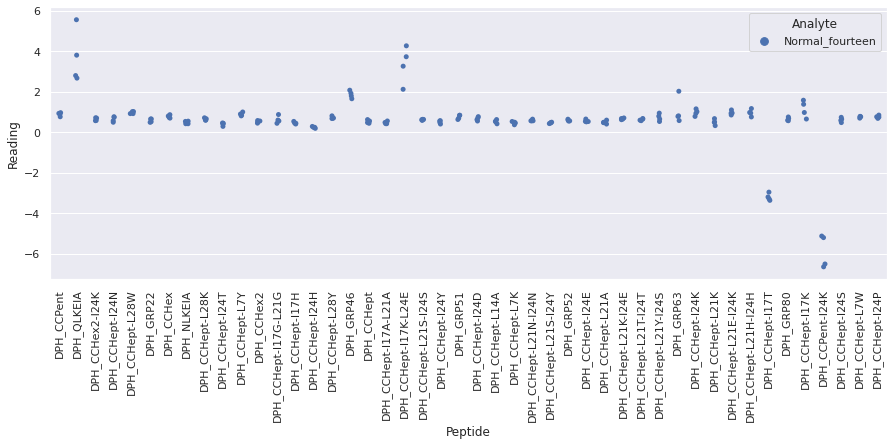

 WARNING - median fluorescence of (Normal_nine + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_nine_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_nine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_nine_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_nine + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_nine_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data

<Figure size 720x720 with 0 Axes>

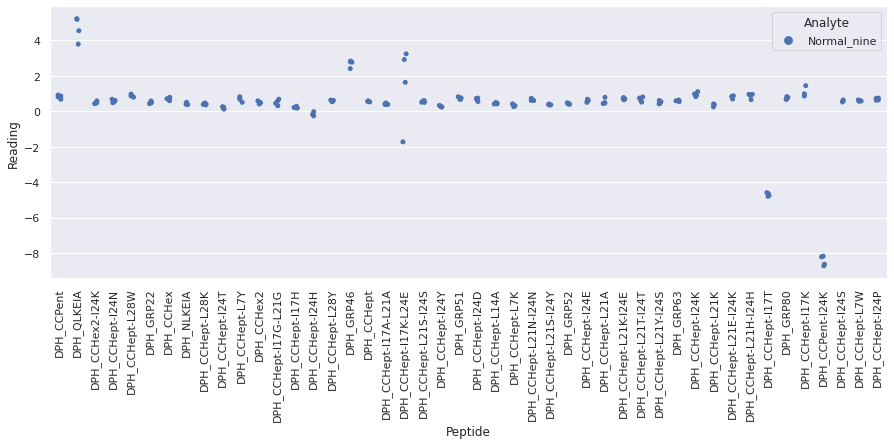

 WARNING - median fluorescence of (Normal_one + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_one + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_one_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_one + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_one + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_one_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_one_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

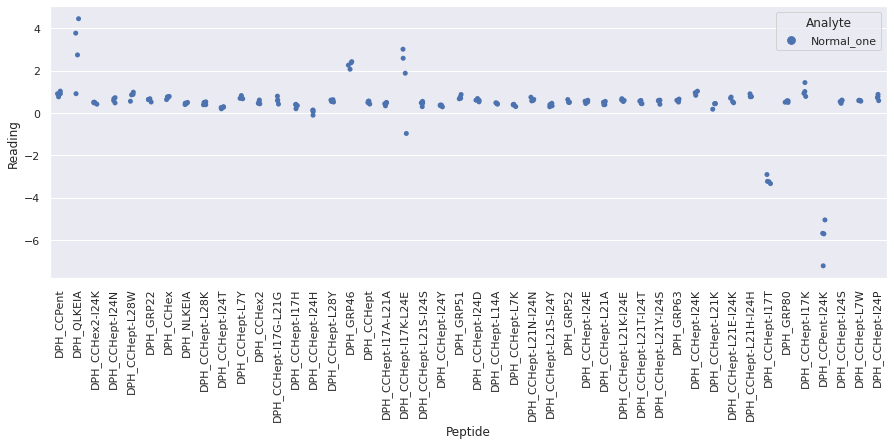

 WARNING - median fluorescence of (Normal_seven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_seven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_seven_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_seven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_seven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_seven_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_seven_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

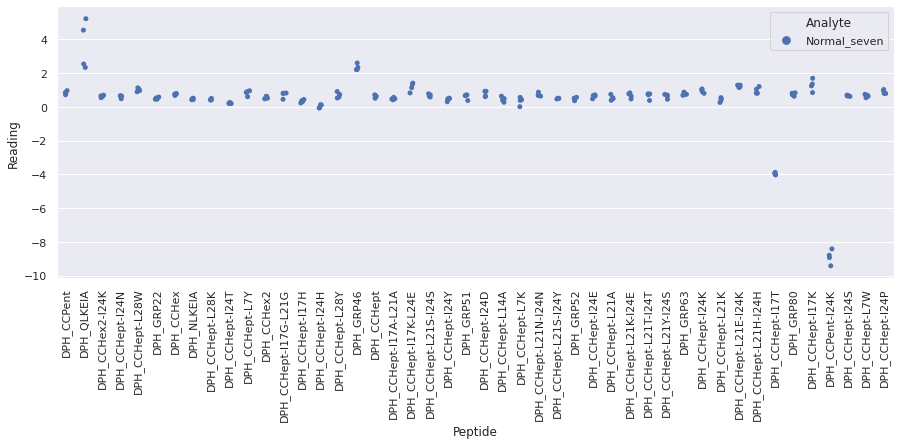

 WARNING - median fluorescence of (Normal_six + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_six + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_six_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_six + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_six + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_six_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_six_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

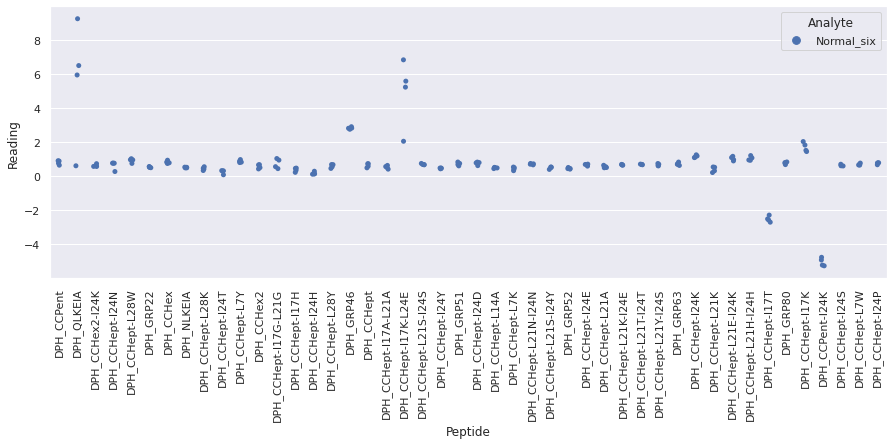

 WARNING - median fluorescence of (Normal_ten + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_ten + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_ten_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_ten + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_ten + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_ten_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_ten_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

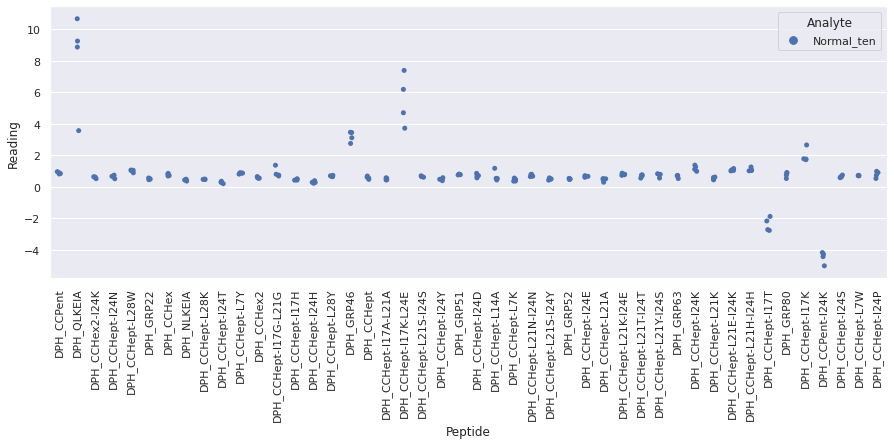

 WARNING - median fluorescence of (Normal_thirteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_thirteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_thirteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirteen_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

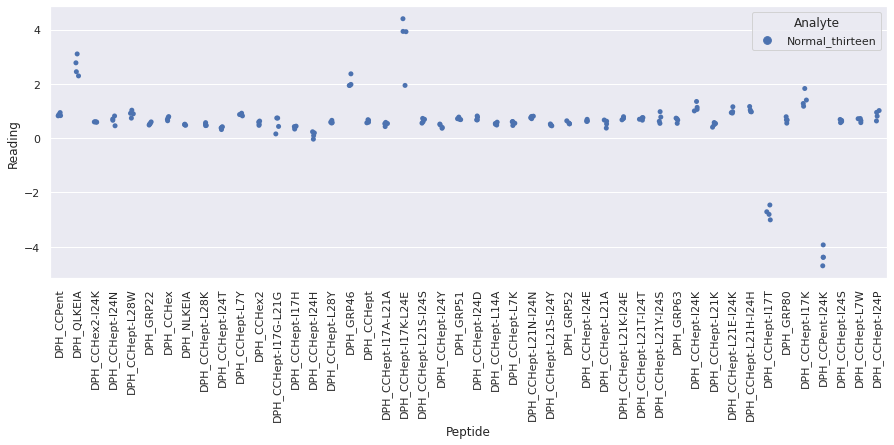

 WARNING - median fluorescence of (Normal_three + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_three + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_three_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_three + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_three + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_three_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_three_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

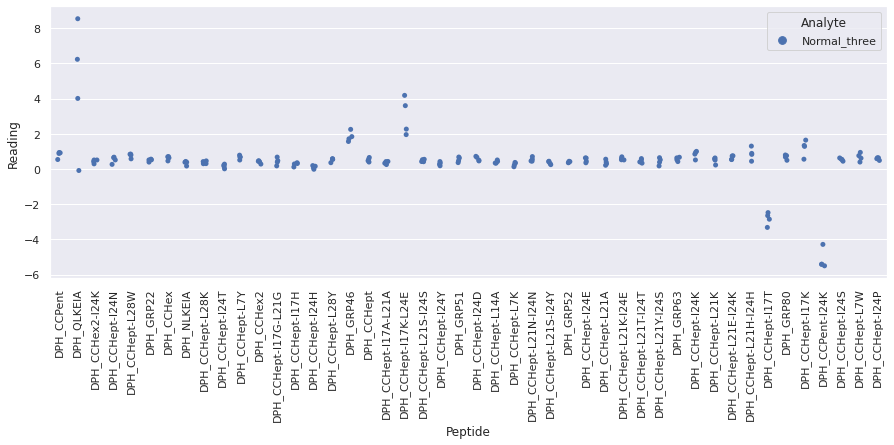

 WARNING - median fluorescence of (Normal_twelve + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_twelve + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_twelve_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_twelve + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_twelve + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_twelve_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twelve_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

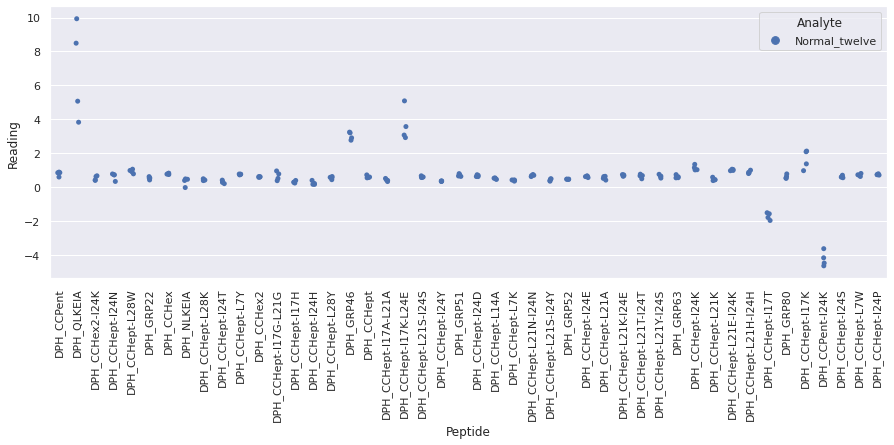

 WARNING - median fluorescence of (Normal_two + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_two + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_two_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_two + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_two + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_two_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_two_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

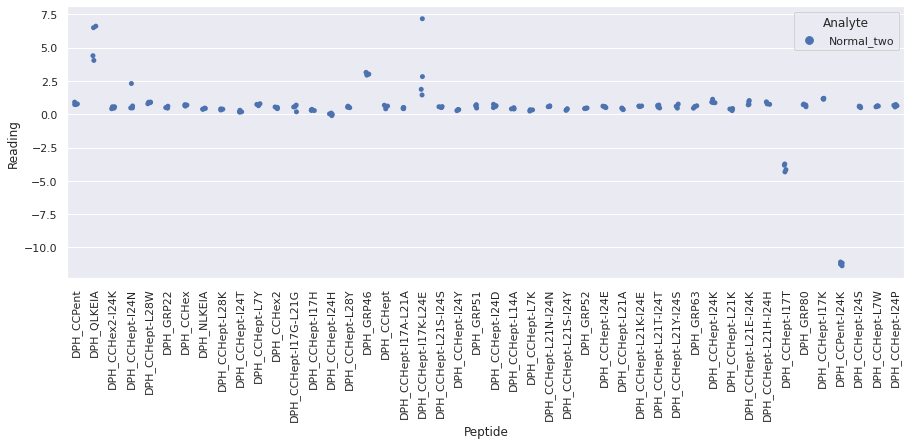

 WARNING - median fluorescence of (CAD_forty + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_forty_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_forty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_forty_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_forty + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_forty_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_fo

<Figure size 720x720 with 0 Axes>

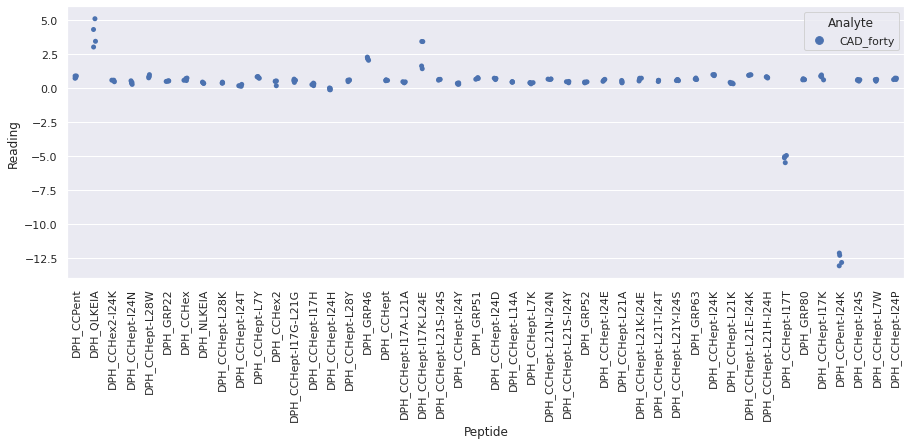

 WARNING - median fluorescence of (CAD_fortyone + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortyone_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_fortyone + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (CAD_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortyone_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_fortyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortyone_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - med

<Figure size 720x720 with 0 Axes>

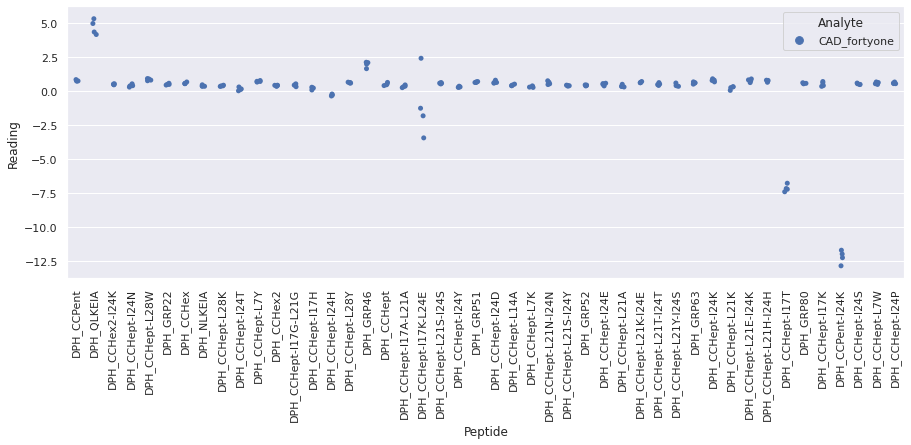

 WARNING - median fluorescence of (CAD_fortytwo + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortytwo_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_fortytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortytwo_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_fortytwo + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortytwo_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plo

<Figure size 720x720 with 0 Axes>

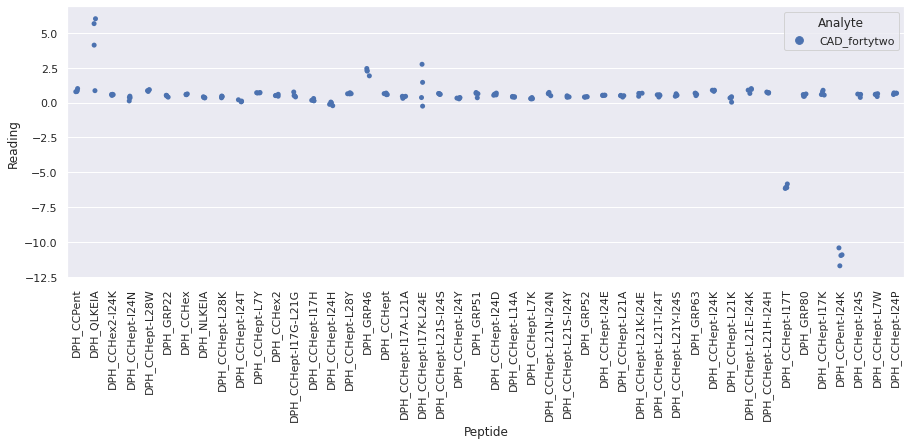

 WARNING - median fluorescence of (CAD_thirty + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirty_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirty + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (CAD_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirty_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirty_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence o

<Figure size 720x720 with 0 Axes>

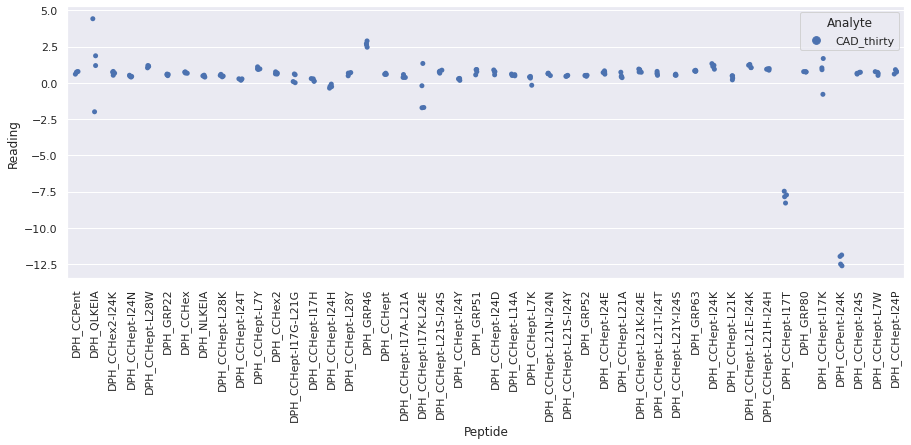

 WARNING - median fluorescence of (CAD_thirtyeight + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyeight_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyeight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyeight_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyeight + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyeight_repeat_3.xlsx. Analysis will continue but please CHECK YOUR

<Figure size 720x720 with 0 Axes>

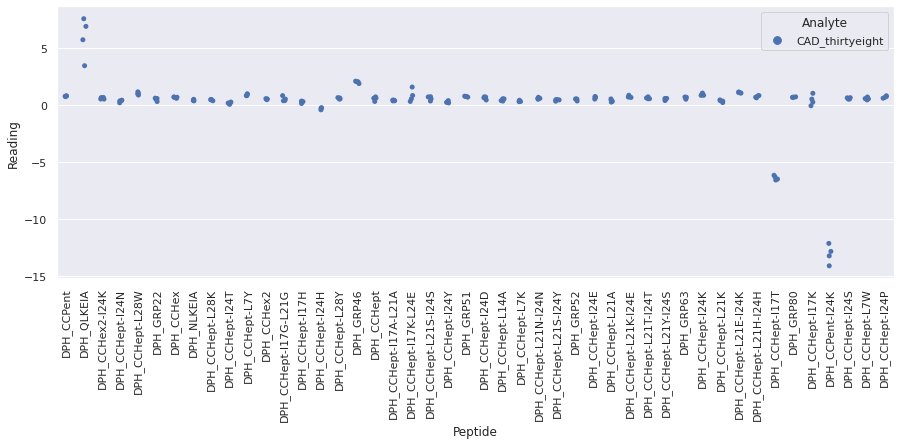

 WARNING - median fluorescence of (CAD_thirtyfive + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirtyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfive_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyfive + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (CAD_thirtyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfive_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyfive + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfive_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DAT

<Figure size 720x720 with 0 Axes>

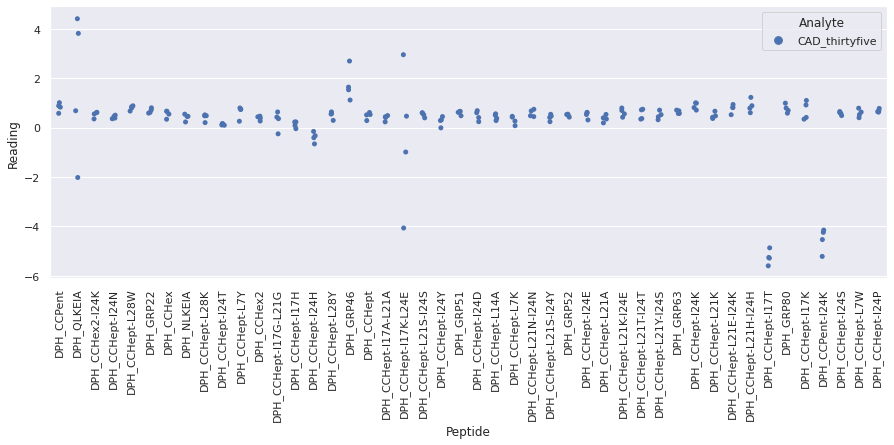

 WARNING - median fluorescence of (CAD_thirtyfour + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (CAD_thirtyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfour_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyfour + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfour_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyfour + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfour_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DAT

<Figure size 720x720 with 0 Axes>

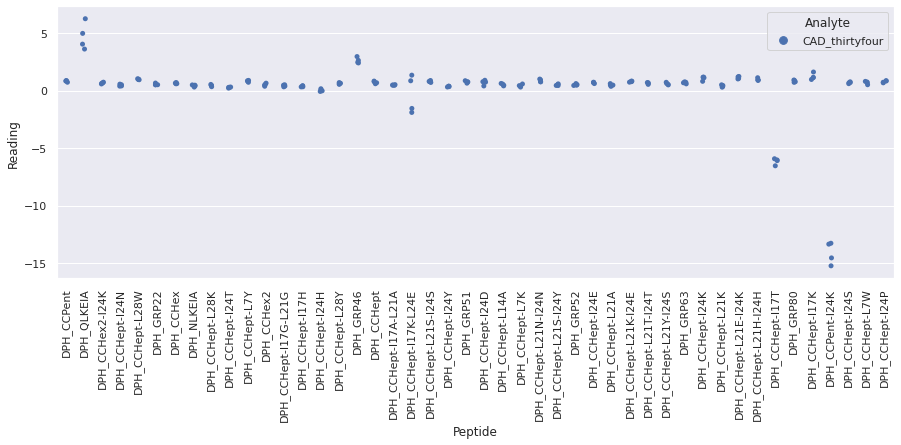

 WARNING - median fluorescence of (CAD_thirtynine + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtynine_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtynine + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (CAD_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtynine_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtynine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtynine_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DAT

<Figure size 720x720 with 0 Axes>

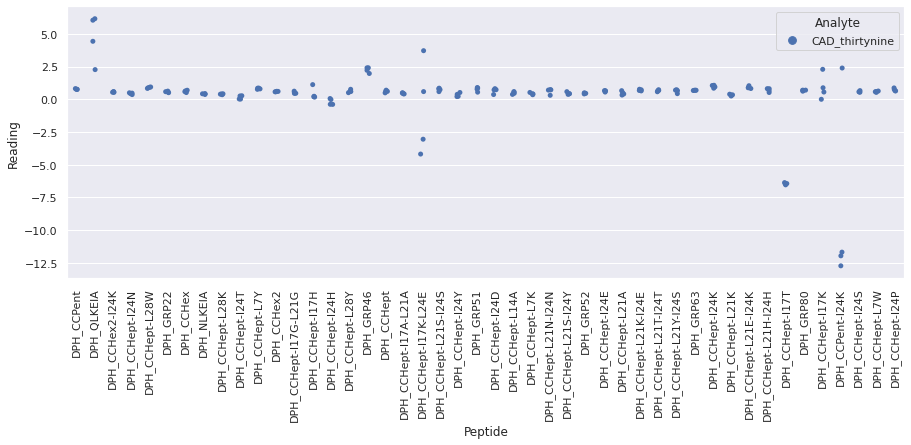

 WARNING - median fluorescence of (CAD_thirtyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyone_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyone + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyone_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_thirtyone_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

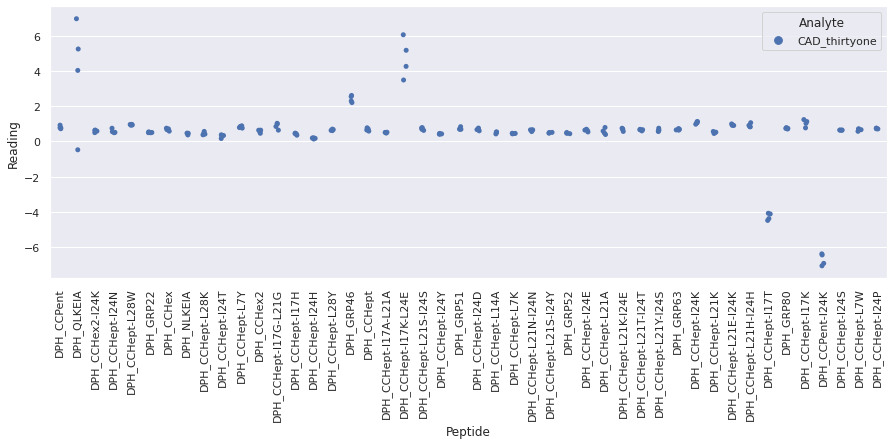

 WARNING - median fluorescence of (CAD_thirtyseven + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyseven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyseven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyseven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyseven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyseven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR

<Figure size 720x720 with 0 Axes>

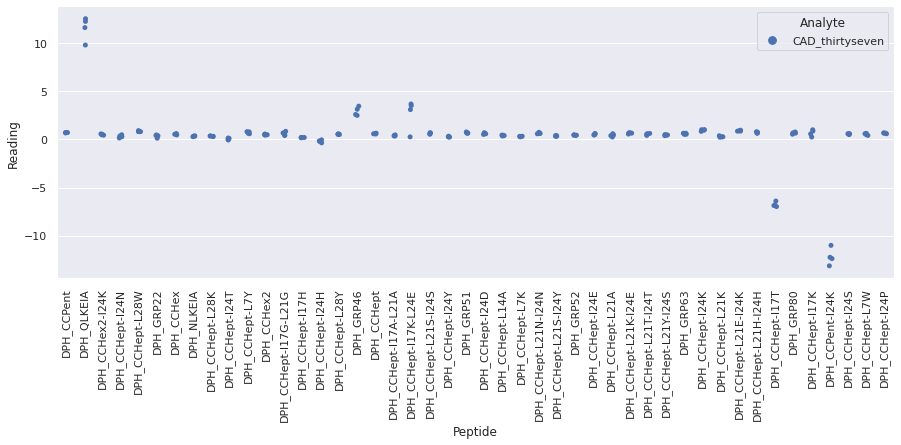

 WARNING - median fluorescence of (CAD_thirtysix + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirtysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtysix_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtysix + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtysix_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtysix + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtysix_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing sc

<Figure size 720x720 with 0 Axes>

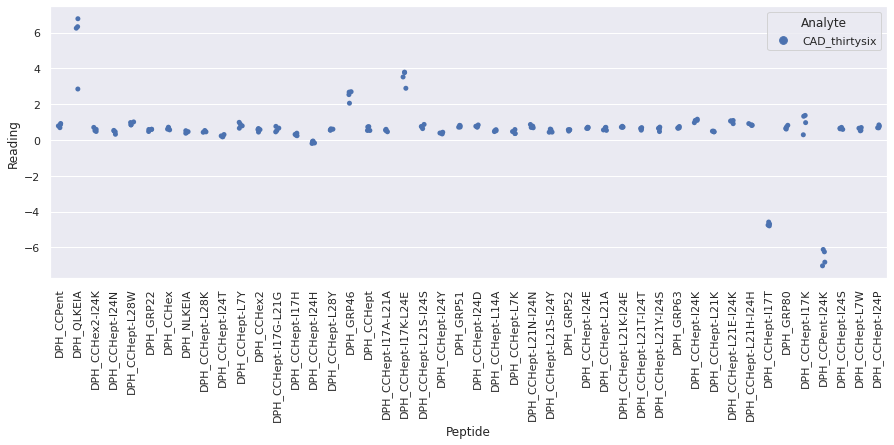

 WARNING - median fluorescence of (CAD_thirtythree + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtythree_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtythree + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (CAD_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtythree_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtythree + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtythree_repeat_3.xlsx. Analysis will continue but please CHECK

<Figure size 720x720 with 0 Axes>

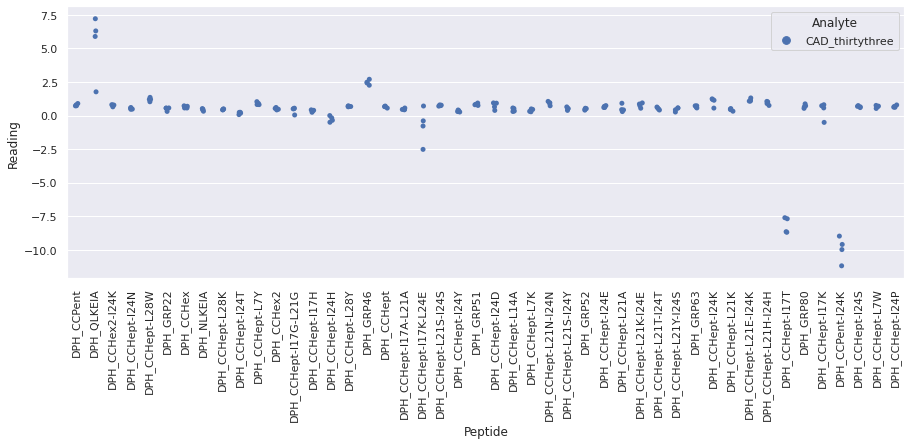

 WARNING - median fluorescence of (CAD_thirtytwo + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtytwo_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtytwo_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtytwo + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtytwo_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing sc

<Figure size 720x720 with 0 Axes>

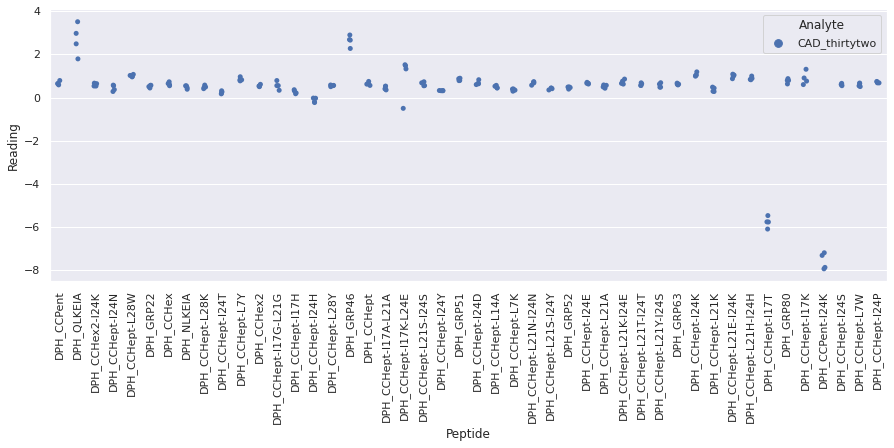

 WARNING - median fluorescence of (CAD_twentynine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_twentynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_twentynine_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_twentynine + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_twentynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_twentynine_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_twentynine_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

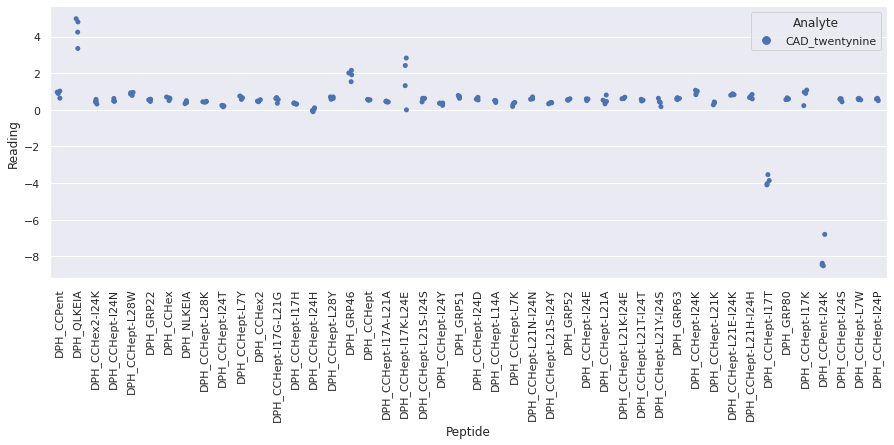

 WARNING - median fluorescence of (NASH_eighteen + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_eighteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_eighteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_eighteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_eighteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_eighteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_eighteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_eighteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_eighteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing sc

<Figure size 720x720 with 0 Axes>

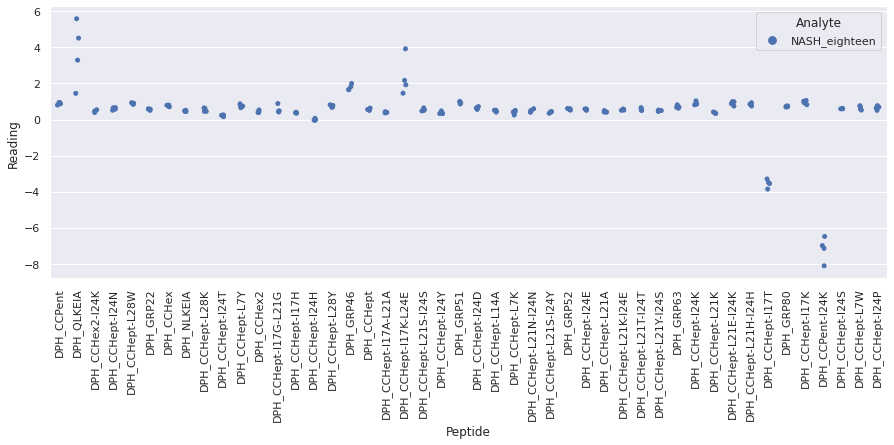

 WARNING - median fluorescence of (NASH_fifteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_fifteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_fifteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_fifteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_fifteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_fifteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_fifteen_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

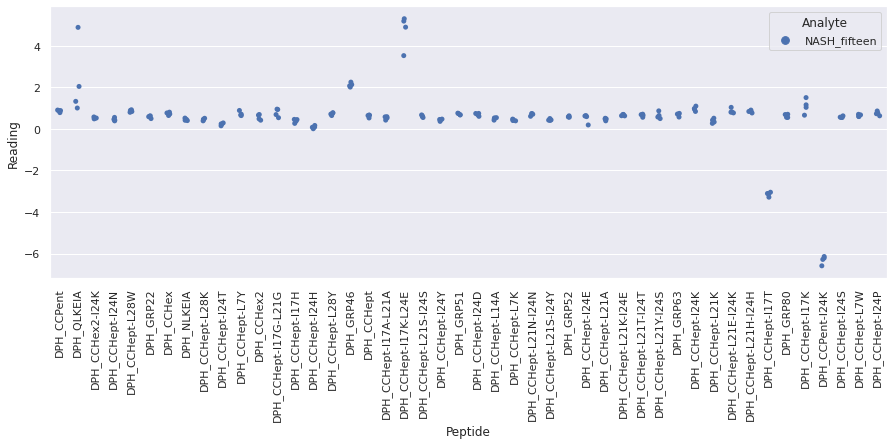

 WARNING - median fluorescence of (NASH_nineteen + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_nineteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_nineteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_nineteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_nineteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_nineteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_nineteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_nineteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_nineteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing sc

<Figure size 720x720 with 0 Axes>

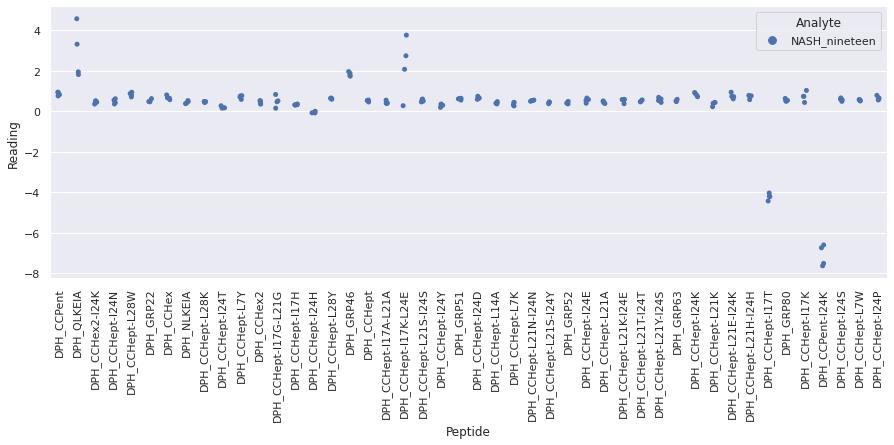

 WARNING - median fluorescence of (NASH_seventeen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_seventeen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_seventeen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_seventeen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_seventeen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_seventeen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_seventeen_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

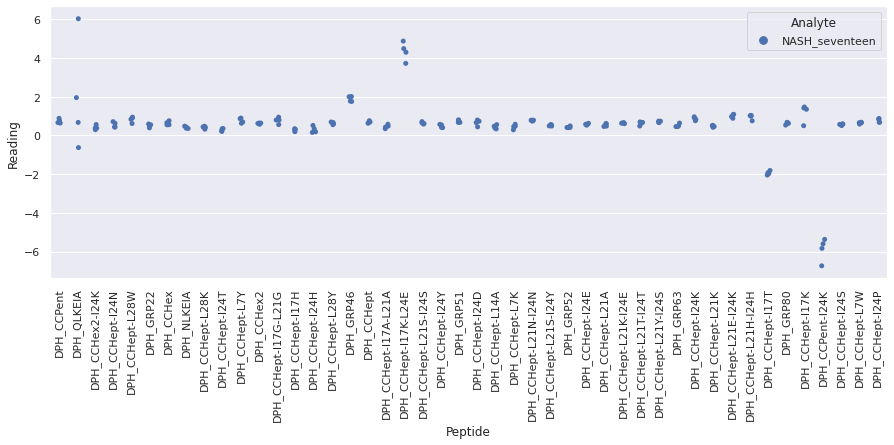

 WARNING - median fluorescence of (NASH_sixteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_sixteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_sixteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_sixteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_sixteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_sixteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_sixteen_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

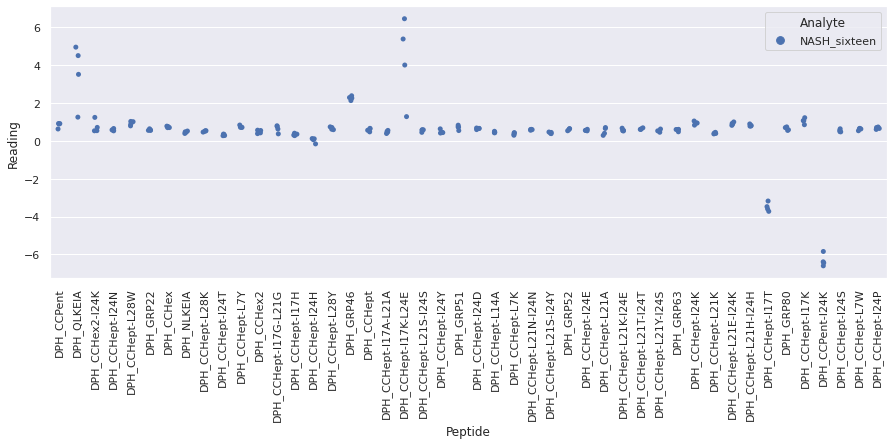

 WARNING - median fluorescence of (NASH_twenty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twenty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twenty_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twenty + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twenty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twenty_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twenty_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

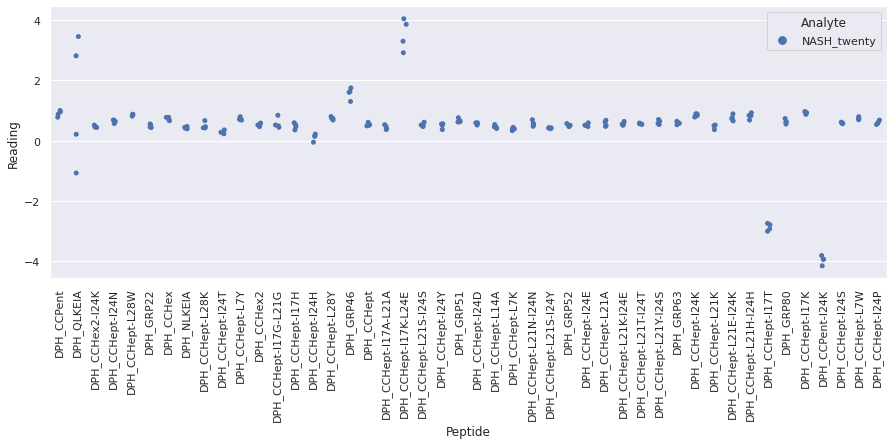

 WARNING - median fluorescence of (NASH_twentyeight + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyeight_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyeight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyeight_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyeight + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyeight_repeat_3.xlsx. Analysis will continue but please C

<Figure size 720x720 with 0 Axes>

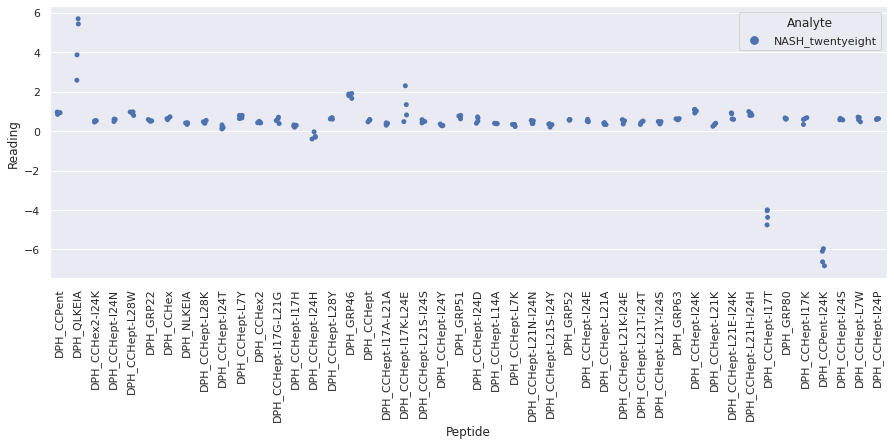

 WARNING - median fluorescence of (NASH_twentyfive + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfive_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfive + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfive_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfive + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfive_repeat_3.xlsx. Analysis will continue but please CHECK YOUR

<Figure size 720x720 with 0 Axes>

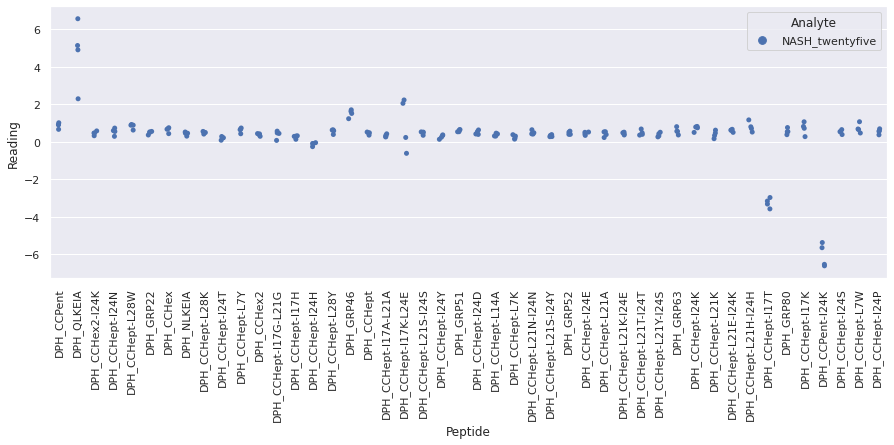

 WARNING - median fluorescence of (NASH_twentyfour + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfour_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfour + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfour_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyfour_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

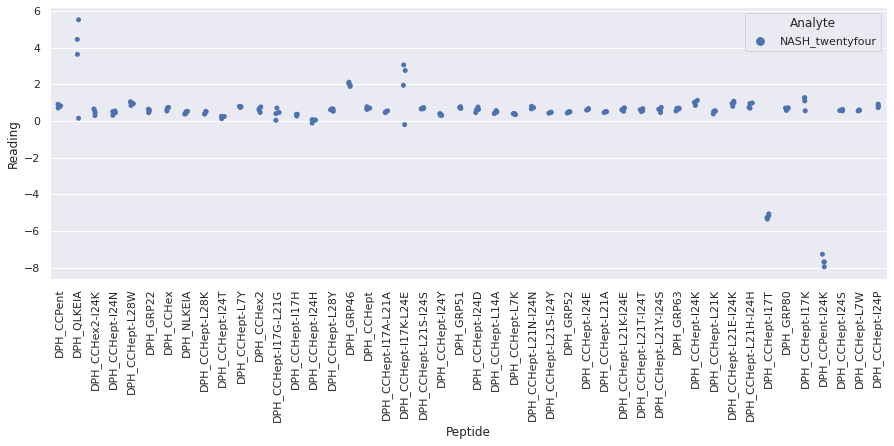

 WARNING - median fluorescence of (NASH_twentyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyone_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyone + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyone_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyone_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

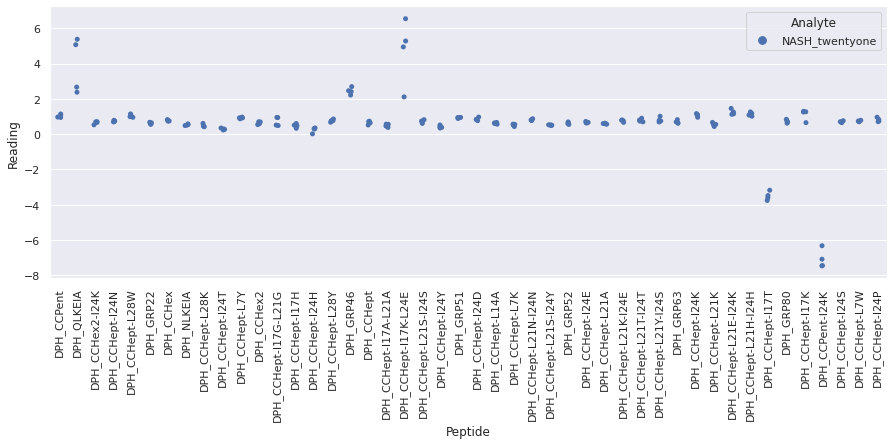

 WARNING - median fluorescence of (NASH_twentyseven + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyseven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyseven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyseven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyseven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyseven_repeat_3.xlsx. Analysis will continue but please C

<Figure size 720x720 with 0 Axes>

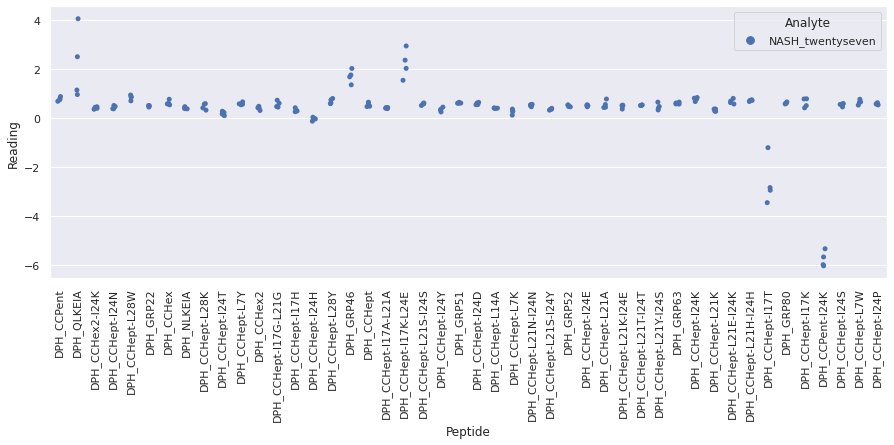

 WARNING - median fluorescence of (NASH_twentysix + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentysix_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentysix + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentysix_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentysix + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentysix_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
D

<Figure size 720x720 with 0 Axes>

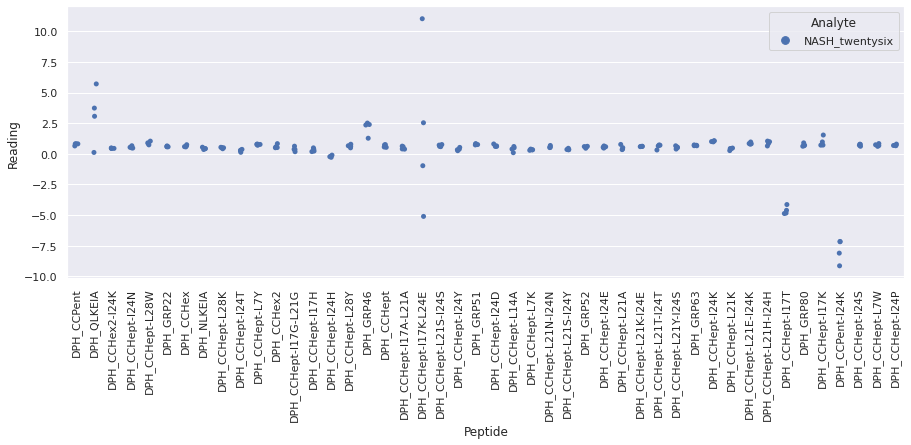

 WARNING - median fluorescence of (NASH_twentythree + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentythree_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentythree + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentythree_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentythree + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentythree_repeat_3.xlsx. Analysis will continue but please C

<Figure size 720x720 with 0 Axes>

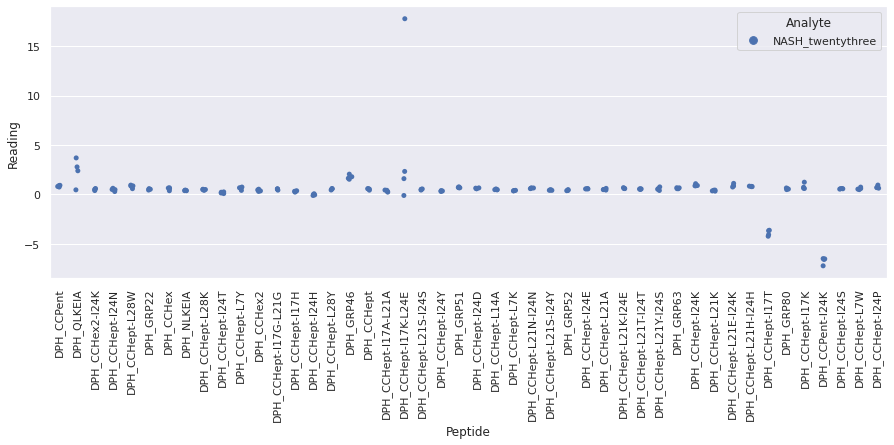

 WARNING - median fluorescence of (NASH_twentytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentytwo_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentytwo + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentytwo_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentytwo_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

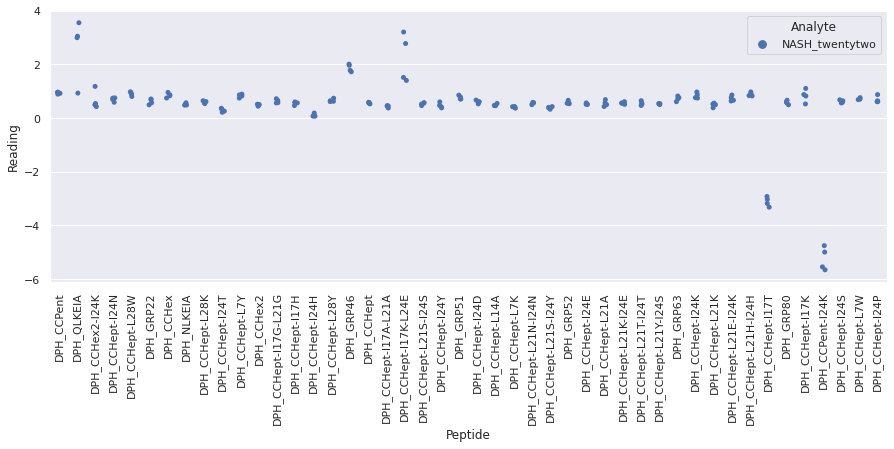

 WARNING - median fluorescence of (Normal_eight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_eight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eight_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eight + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_eight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eight_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_eight_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

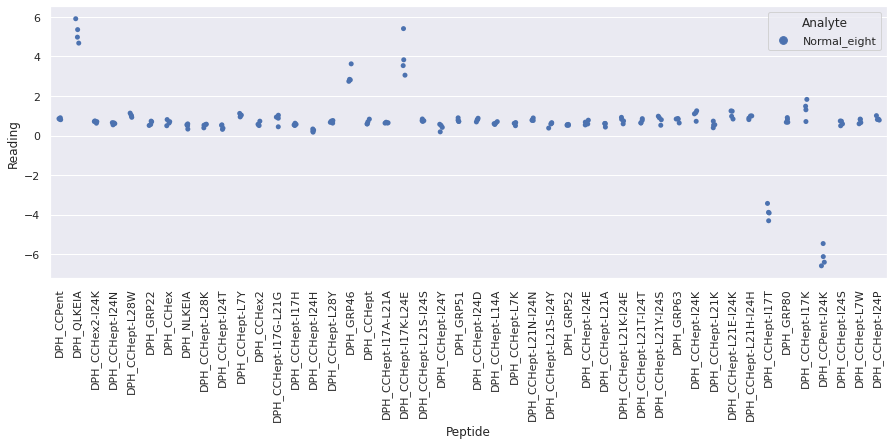

 WARNING - median fluorescence of (Normal_eleven + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_eleven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eleven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eleven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_eleven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eleven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eleven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_eleven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eleven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing sc

<Figure size 720x720 with 0 Axes>

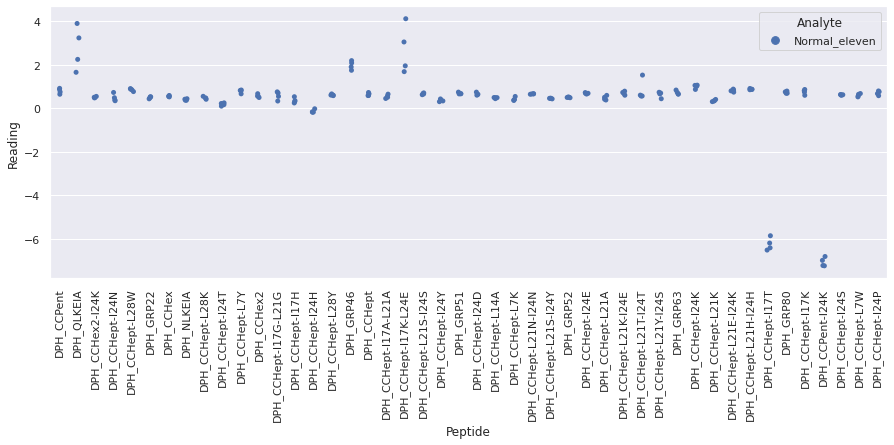

 WARNING - median fluorescence of (Normal_five + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_five + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_five_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_five + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_five + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_five_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_five_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

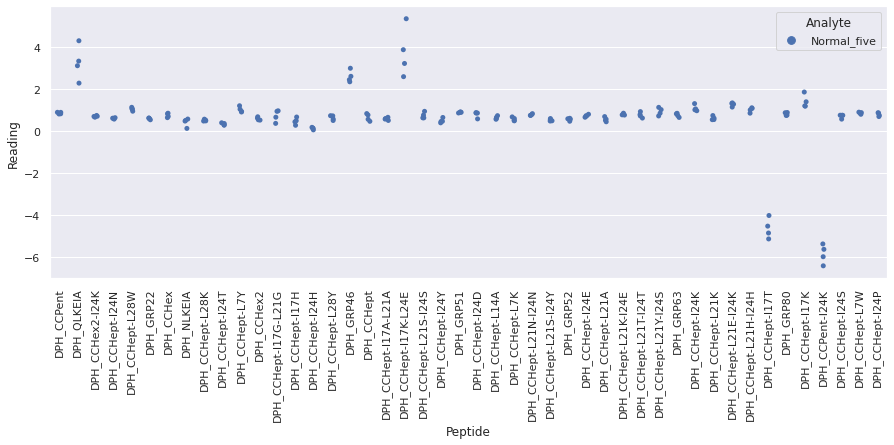

 WARNING - median fluorescence of (Normal_four + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_four + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_four_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_four + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_four + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_four_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_four_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

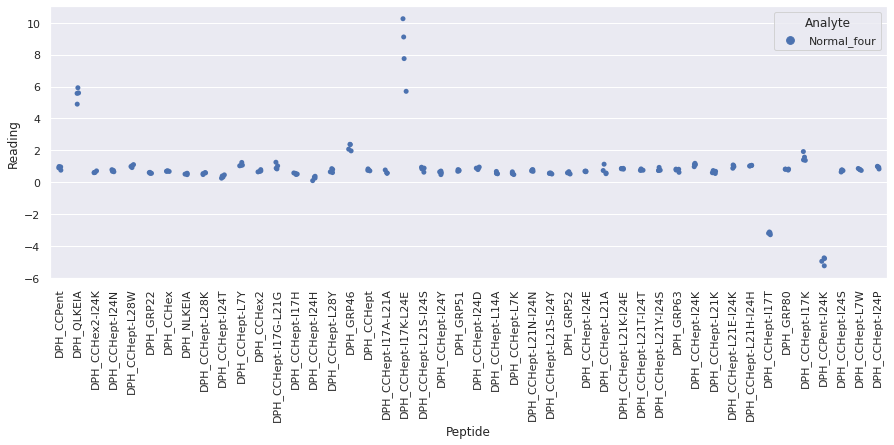

 WARNING - median fluorescence of (Normal_fourteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_fourteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_fourteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fourteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_fourteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_fourteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fourteen_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

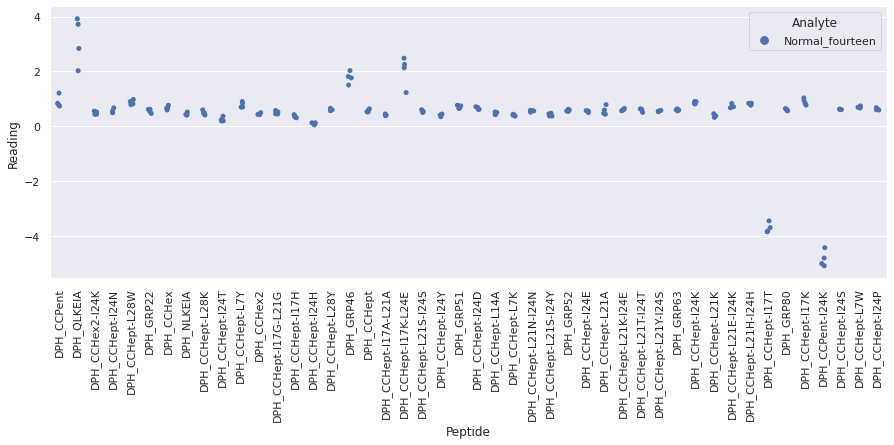

 WARNING - median fluorescence of (Normal_nine + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_nine_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_nine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_nine_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_nine + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_nine_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data

<Figure size 720x720 with 0 Axes>

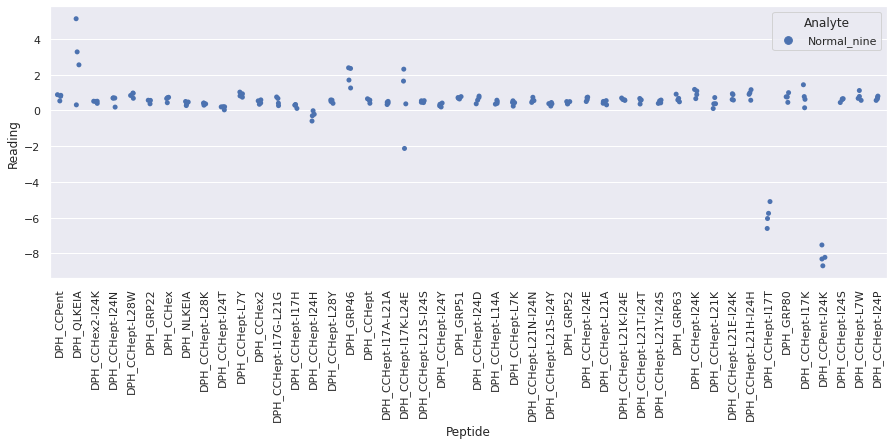

 WARNING - median fluorescence of (Normal_one + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_one + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_one_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_one + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_one + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_one_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_one + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_one + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_one_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence o

<Figure size 720x720 with 0 Axes>

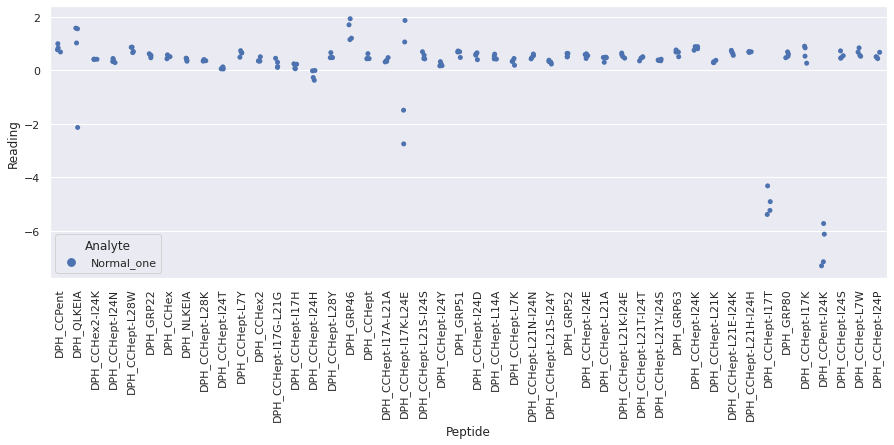

 WARNING - median fluorescence of (Normal_seven + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_seven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_seven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_seven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_seven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_seven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_seven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_seven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_seven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plo

<Figure size 720x720 with 0 Axes>

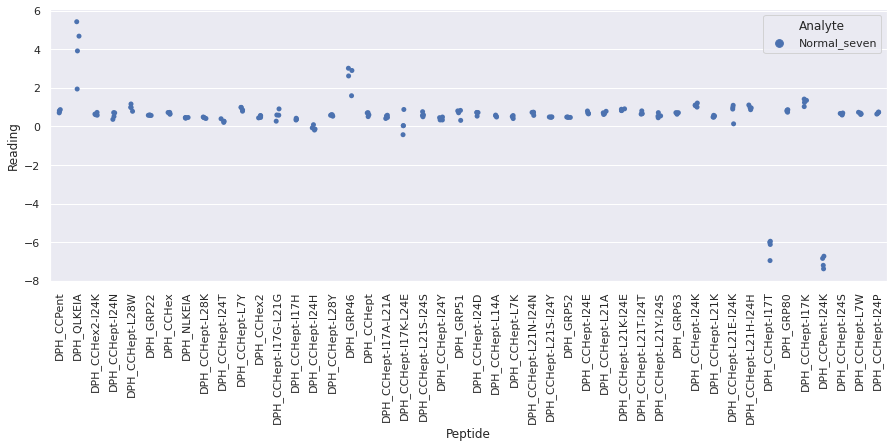

 WARNING - median fluorescence of (Normal_six + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_six + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_six_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_six + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_six + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_six_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_six_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

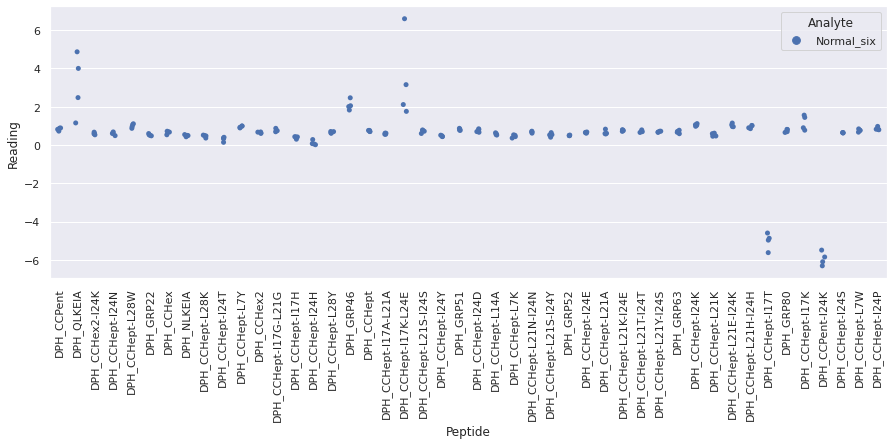

 WARNING - median fluorescence of (Normal_ten + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_ten + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_ten_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_ten + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_ten + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_ten_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_ten + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_ten + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_ten_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread f

<Figure size 720x720 with 0 Axes>

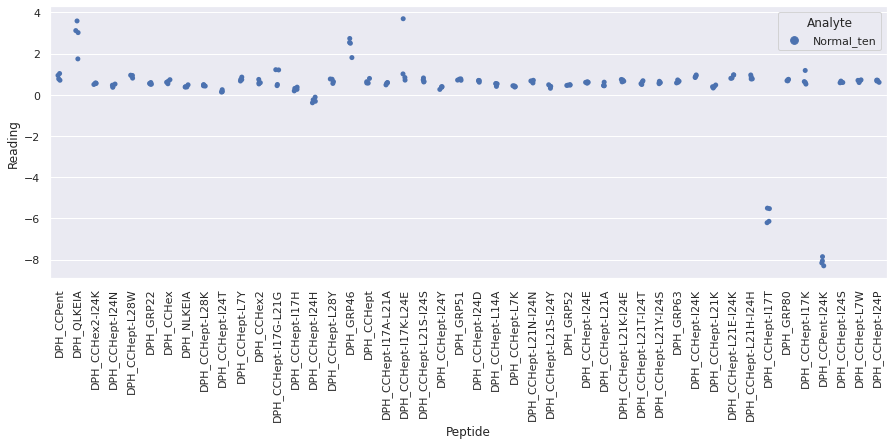

 WARNING - median fluorescence of (Normal_thirteen + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_thirteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_thirteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_thirteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR

<Figure size 720x720 with 0 Axes>

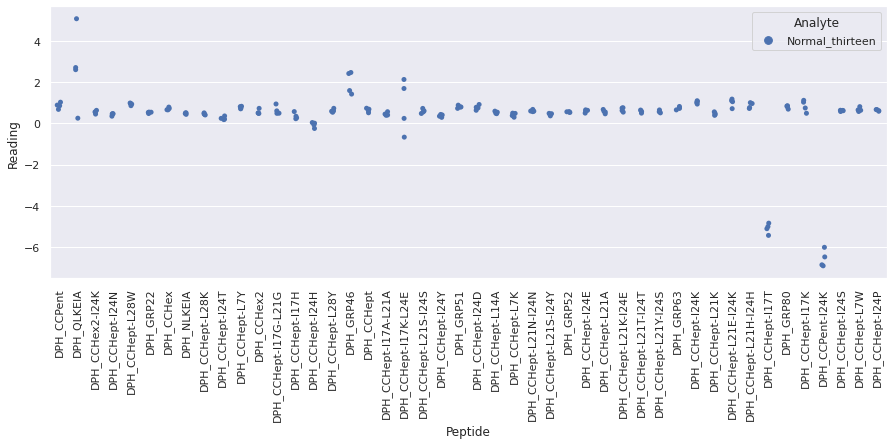

 WARNING - median fluorescence of (Normal_three + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_three + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_three_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_three + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_three + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_three_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_three + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_three + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_three_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plo

<Figure size 720x720 with 0 Axes>

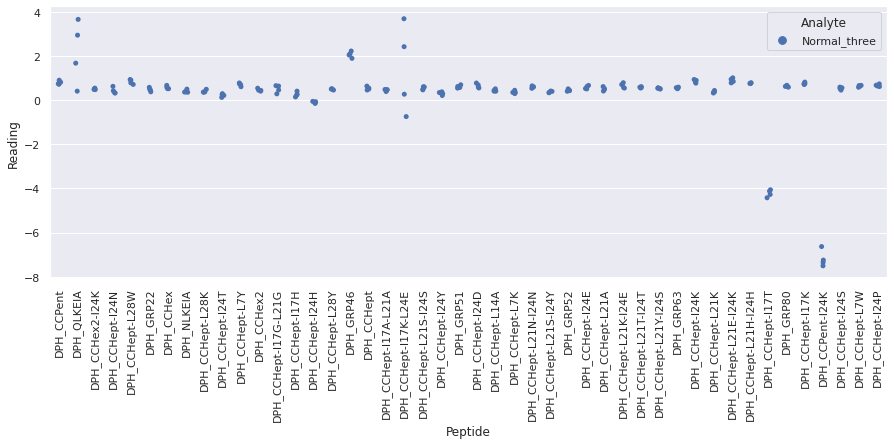

 WARNING - median fluorescence of (Normal_twelve + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_twelve + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_twelve_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_twelve + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_twelve + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_twelve_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_twelve + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_twelve + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_twelve_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing sc

<Figure size 720x720 with 0 Axes>

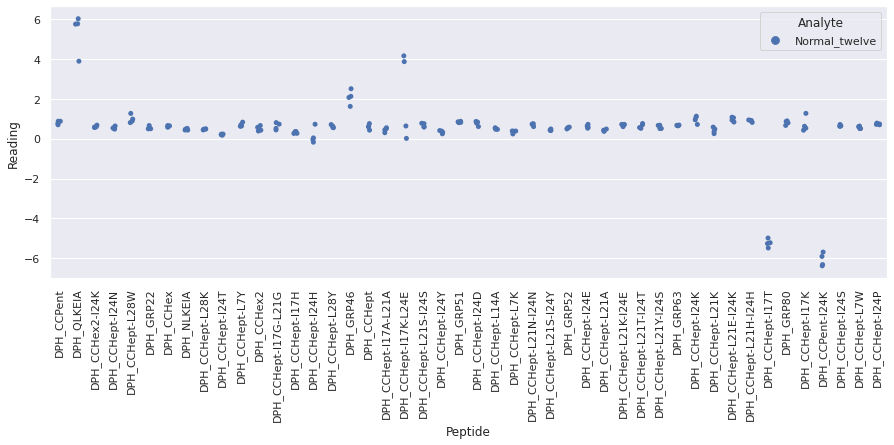

 WARNING - median fluorescence of (Normal_two + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_two + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_two_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_two + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_two + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_two_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_two + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_two + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_two_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence o

<Figure size 720x720 with 0 Axes>

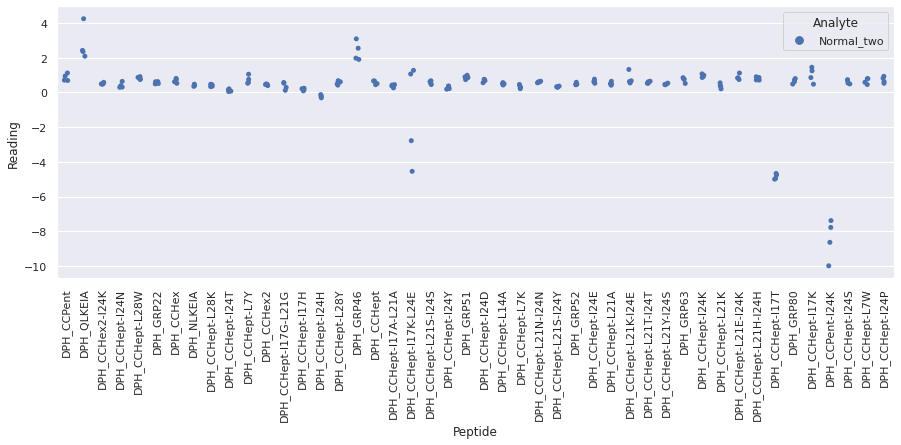

 WARNING - median fluorescence of (CAD_forty + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_forty_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_forty + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (CAD_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_forty_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_forty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_forty_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_fo

<Figure size 720x720 with 0 Axes>

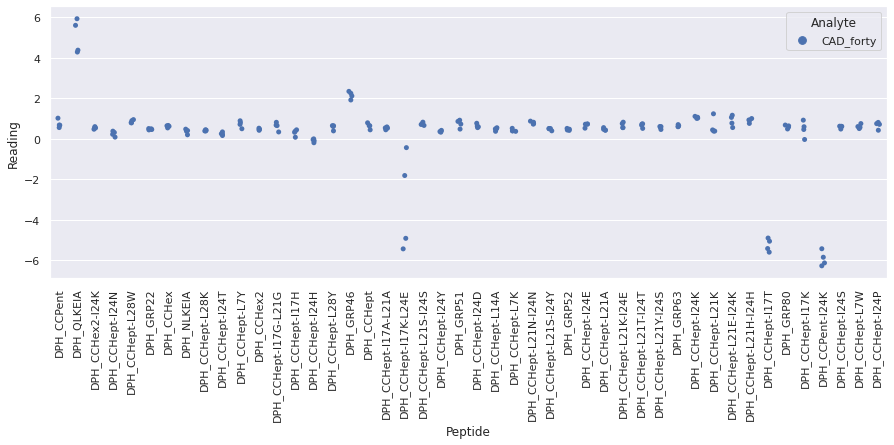

 WARNING - median fluorescence of (CAD_fortyone + DPH_CCHept-I24T + fluorophore) is less than fluorescence of (CAD_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortyone_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_fortyone + DPH_CCHept-I17H + fluorophore) is less than fluorescence of (CAD_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortyone_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_fortyone + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortyone_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median f

<Figure size 720x720 with 0 Axes>

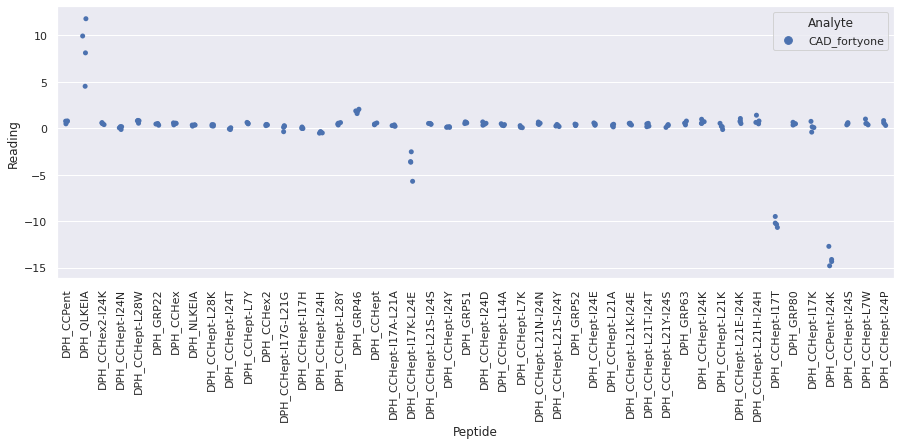

 WARNING - median fluorescence of (CAD_fortytwo + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortytwo_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_fortytwo + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (CAD_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortytwo_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_fortytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortytwo_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - med

<Figure size 720x720 with 0 Axes>

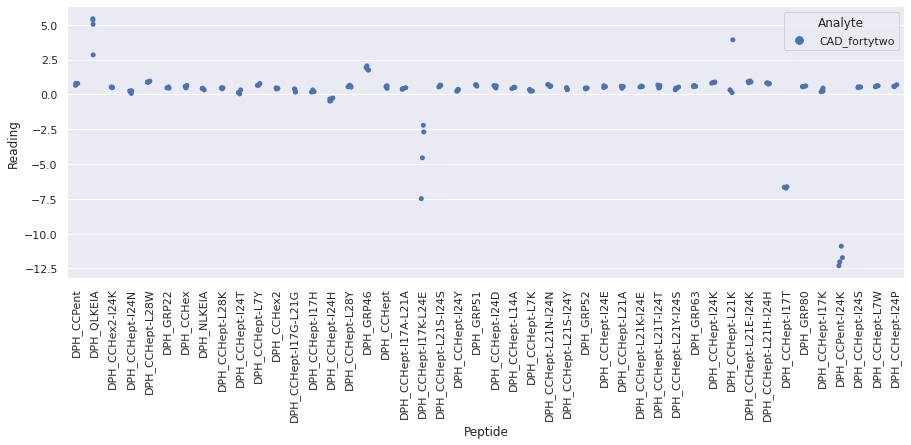

 WARNING - median fluorescence of (CAD_thirty + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirty_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirty_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirty + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirty_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread f

<Figure size 720x720 with 0 Axes>

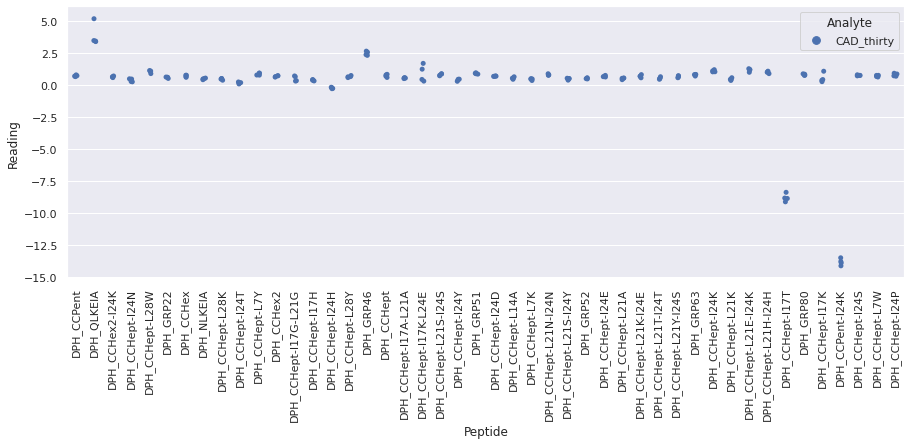

 WARNING - median fluorescence of (CAD_thirtyeight + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyeight_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyeight + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (CAD_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyeight_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyeight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyeight_repeat_4.xlsx. Analysis will continue but please CHECK

<Figure size 720x720 with 0 Axes>

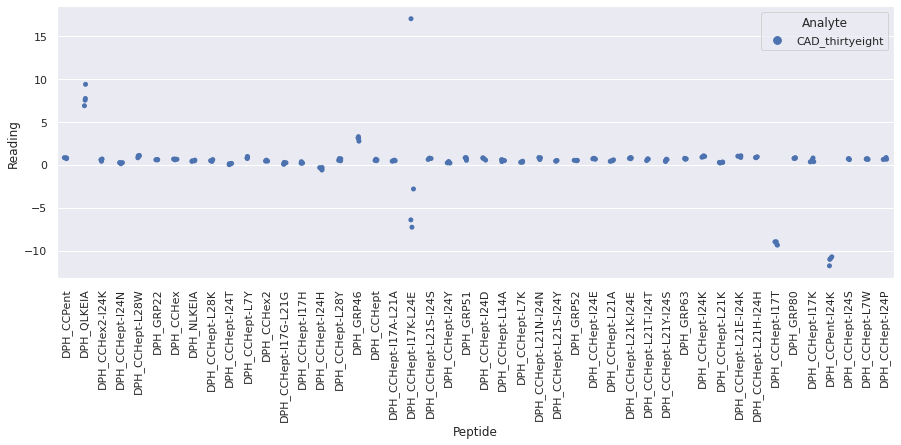

 WARNING - median fluorescence of (CAD_thirtyfive + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirtyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfive_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyfive + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (CAD_thirtyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfive_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyfive + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfive_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DAT

<Figure size 720x720 with 0 Axes>

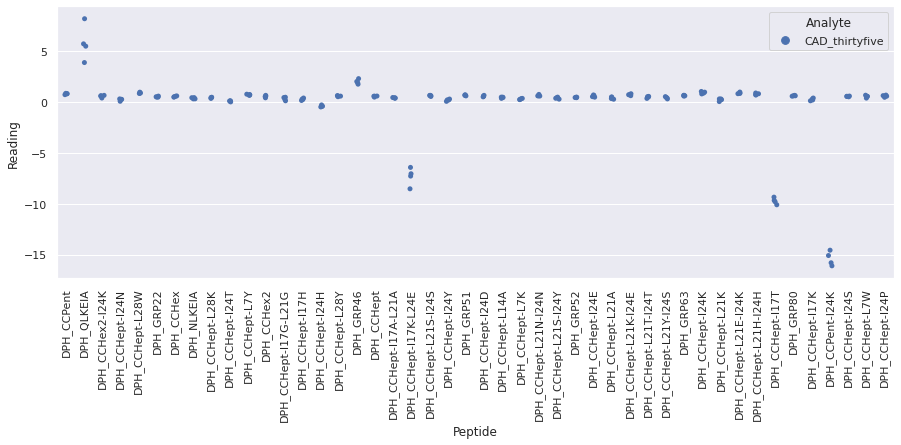

 WARNING - median fluorescence of (CAD_thirtyfour + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirtyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfour_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyfour + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfour_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyfour + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyfour_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
D

<Figure size 720x720 with 0 Axes>

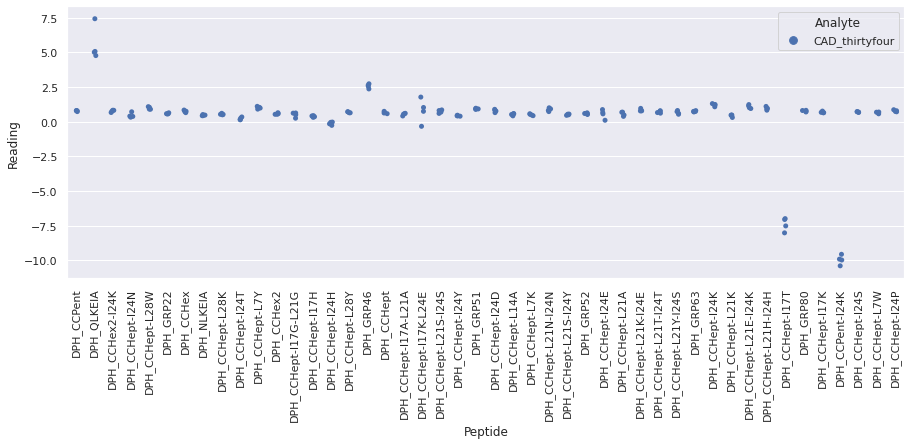

 WARNING - median fluorescence of (CAD_thirtynine + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtynine_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtynine + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (CAD_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtynine_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtynine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtynine_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DAT

<Figure size 720x720 with 0 Axes>

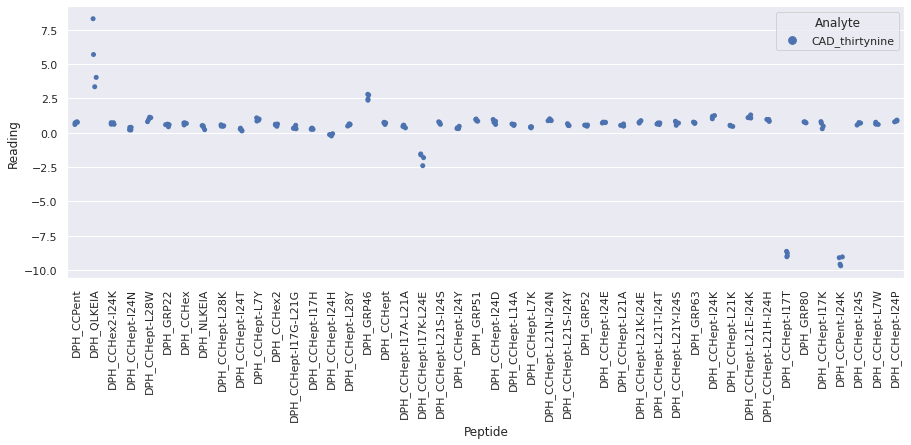

 WARNING - median fluorescence of (CAD_thirtyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyone_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyone + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyone_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_thirtyone_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

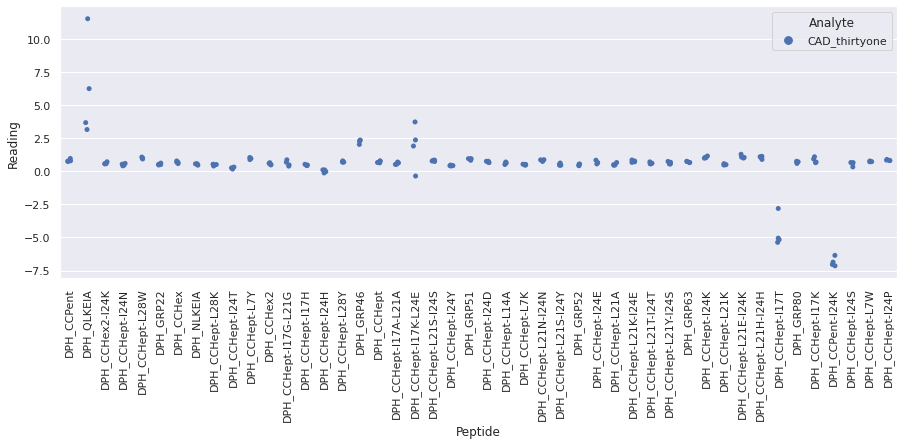

 WARNING - median fluorescence of (CAD_thirtyseven + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyseven_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyseven + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (CAD_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyseven_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtyseven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtyseven_repeat_4.xlsx. Analysis will continue but please CHECK

<Figure size 720x720 with 0 Axes>

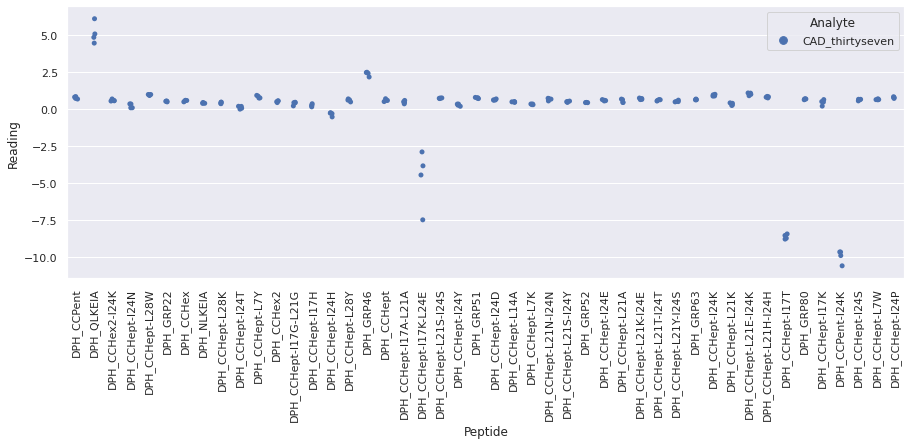

 WARNING - median fluorescence of (CAD_thirtysix + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtysix_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtysix + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_thirtysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtysix_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_thirtysix_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

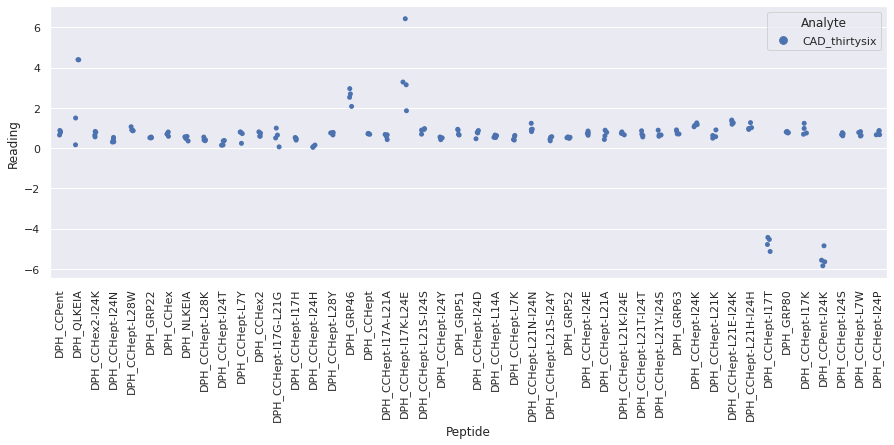

 WARNING - median fluorescence of (CAD_thirtythree + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtythree_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtythree + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (CAD_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtythree_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtythree + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtythree_repeat_4.xlsx. Analysis will continue but please CHECK

<Figure size 720x720 with 0 Axes>

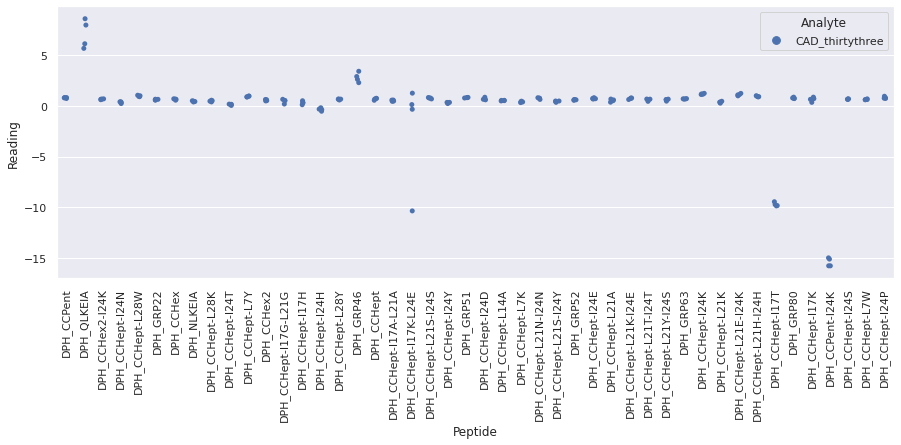

 WARNING - median fluorescence of (CAD_thirtytwo + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (CAD_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtytwo_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtytwo + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (CAD_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtytwo_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_thirtytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_thirtytwo_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARN

<Figure size 720x720 with 0 Axes>

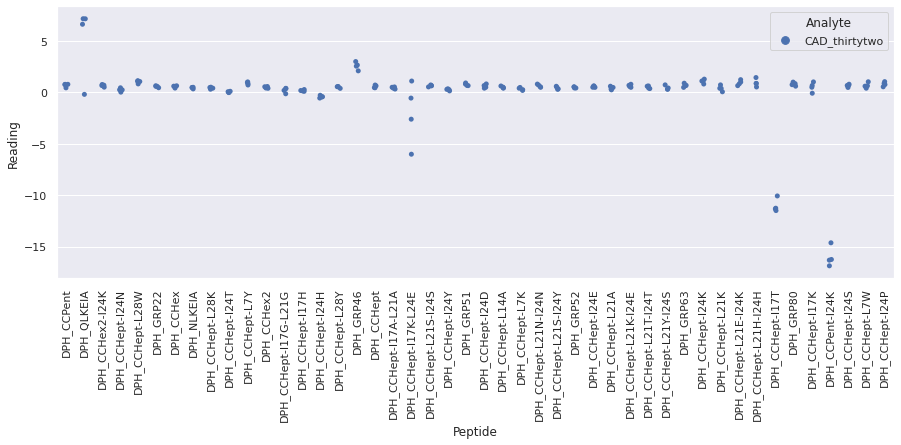

 WARNING - median fluorescence of (CAD_twentynine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (CAD_twentynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_twentynine_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (CAD_twentynine + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (CAD_twentynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_twentynine_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for CAD_twentynine_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

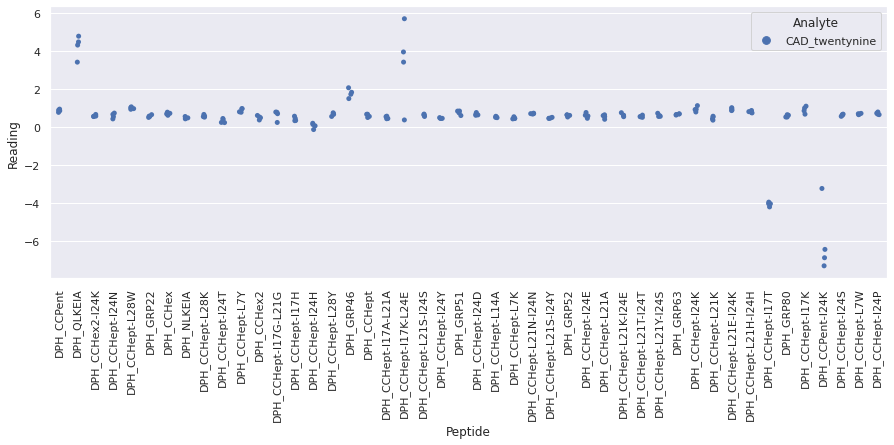

 WARNING - median fluorescence of (NASH_eighteen + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_eighteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_eighteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_eighteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_eighteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_eighteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_eighteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_eighteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_eighteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing sc

<Figure size 720x720 with 0 Axes>

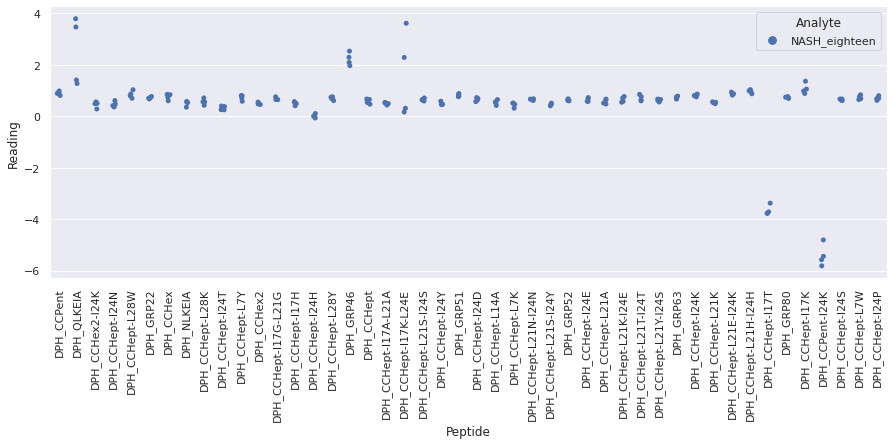

 WARNING - median fluorescence of (NASH_fifteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_fifteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_fifteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_fifteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_fifteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_fifteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_fifteen_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

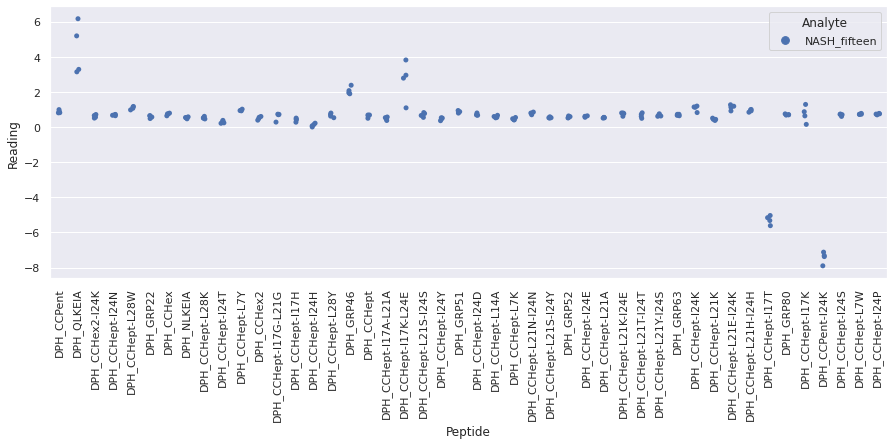

 WARNING - median fluorescence of (NASH_nineteen + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_nineteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_nineteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_nineteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_nineteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_nineteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_nineteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_nineteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_nineteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing sc

<Figure size 720x720 with 0 Axes>

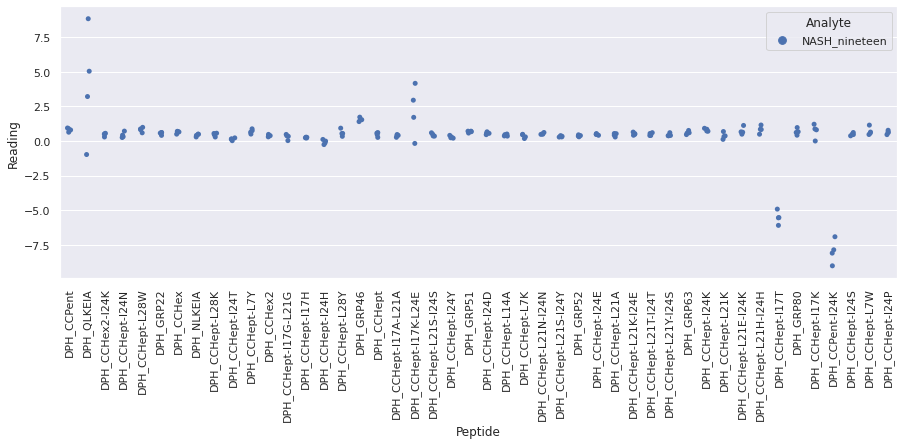

 WARNING - median fluorescence of (NASH_seventeen + DPH_CCHept-I24N + fluorophore) is less than fluorescence of (NASH_seventeen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_seventeen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_seventeen + DPH_CCHept-I24T + fluorophore) is less than fluorescence of (NASH_seventeen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_seventeen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_seventeen + DPH_CCHept-I17G-L21G + fluorophore) is less than fluorescence of (NASH_seventeen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_seventeen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DAT

<Figure size 720x720 with 0 Axes>

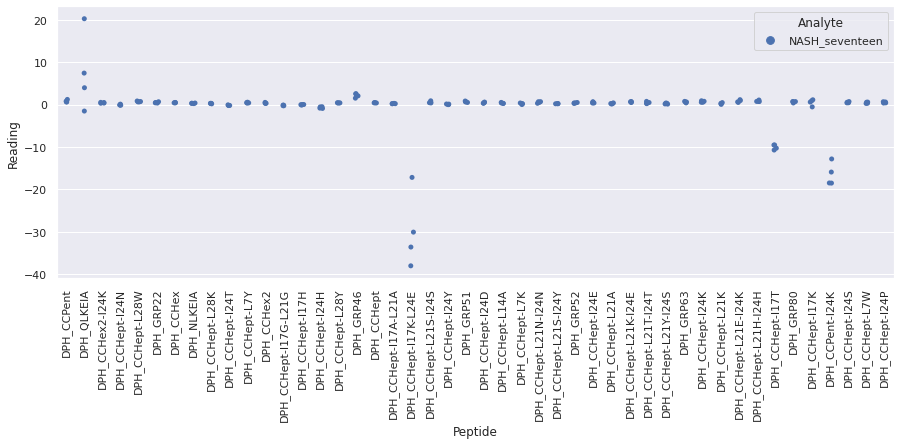

 WARNING - median fluorescence of (NASH_sixteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_sixteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_sixteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_sixteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_sixteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_sixteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_sixteen_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

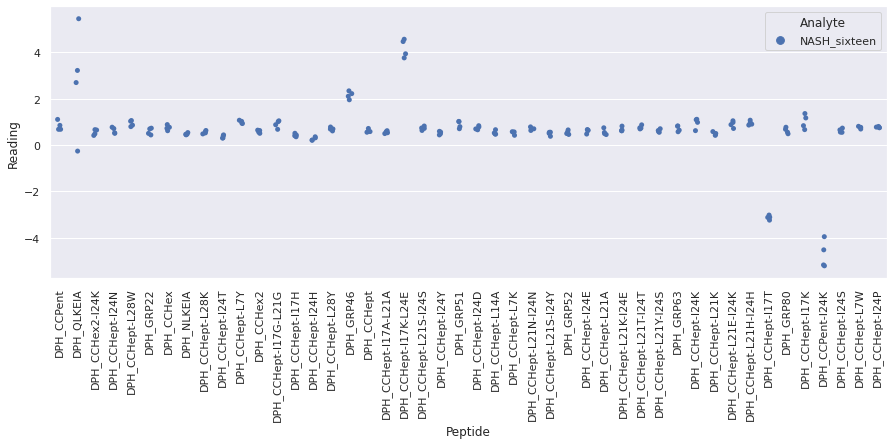

 WARNING - median fluorescence of (NASH_twenty + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twenty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twenty_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twenty + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (NASH_twenty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twenty_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twenty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twenty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twenty_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluor

<Figure size 720x720 with 0 Axes>

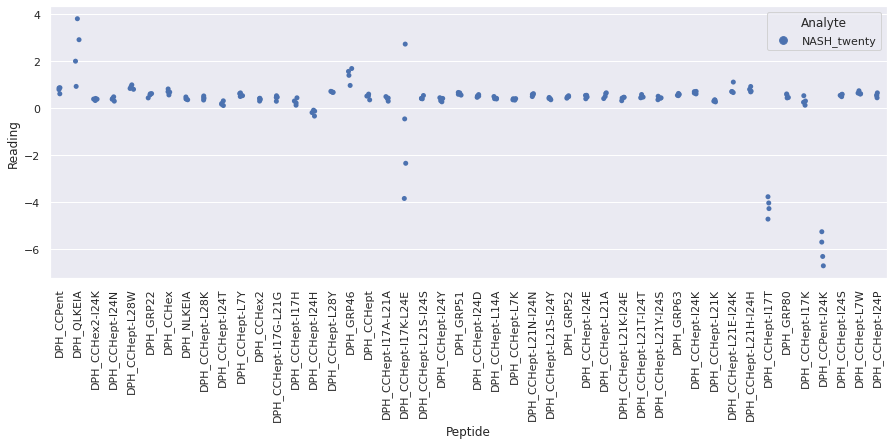

 WARNING - median fluorescence of (NASH_twentyeight + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyeight_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyeight + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (NASH_twentyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyeight_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyeight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyeight_repeat_4.xlsx. Analysis will continue but ple

<Figure size 720x720 with 0 Axes>

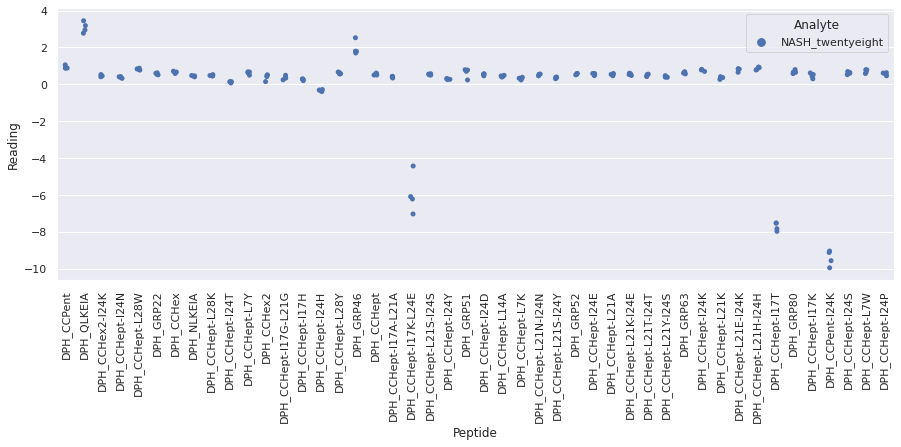

 WARNING - median fluorescence of (NASH_twentyfive + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfive_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfive + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfive_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfive + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfive_repeat_4.xlsx. Analysis will continue but please CHECK YOUR

<Figure size 720x720 with 0 Axes>

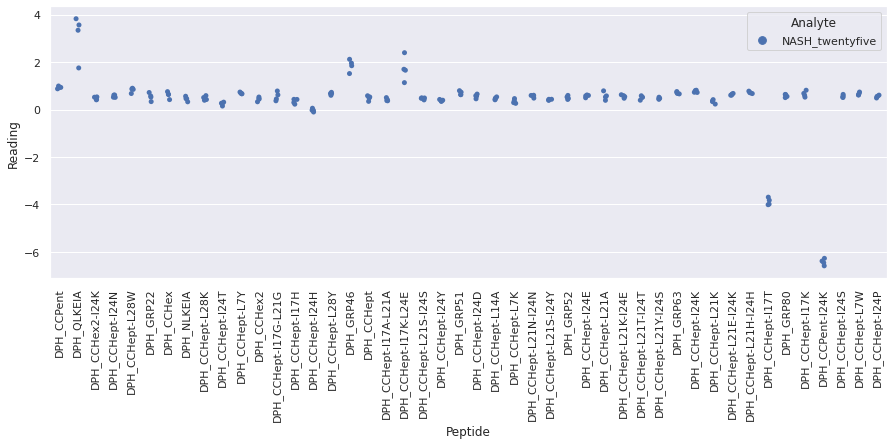

 WARNING - median fluorescence of (NASH_twentyfour + DPH_CCHept-I24T + fluorophore) is less than fluorescence of (NASH_twentyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfour_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfour + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfour_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfour + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (NASH_twentyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyfour_repeat_4.xlsx. Analysis will continue but please CHECK

<Figure size 720x720 with 0 Axes>

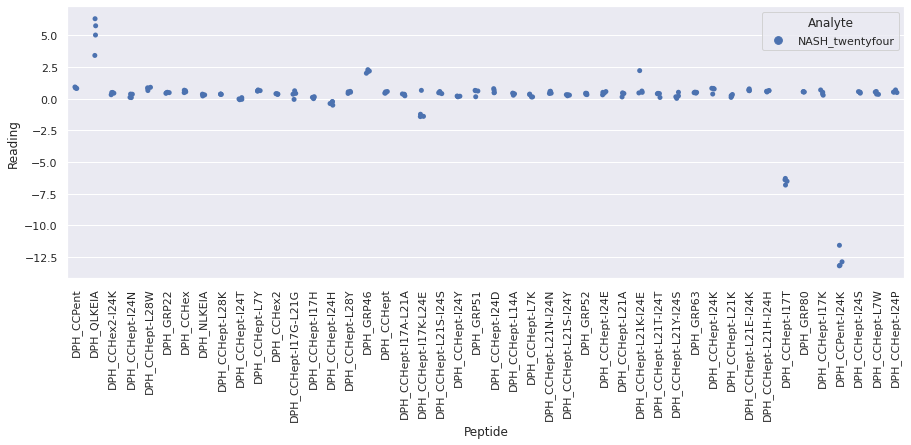

 WARNING - median fluorescence of (NASH_twentyone + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyone_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyone_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyone + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyone_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
D

<Figure size 720x720 with 0 Axes>

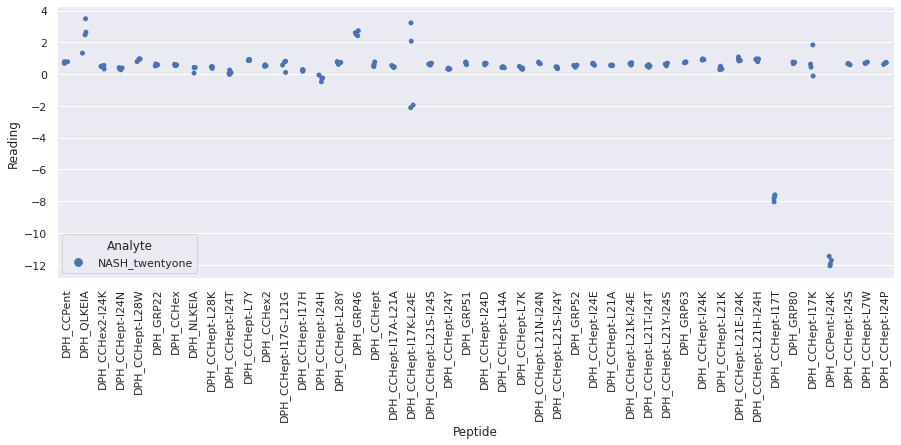

 WARNING - median fluorescence of (NASH_twentyseven + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyseven_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyseven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyseven_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyseven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentyseven_repeat_4.xlsx. Analysis will continue but please C

<Figure size 720x720 with 0 Axes>

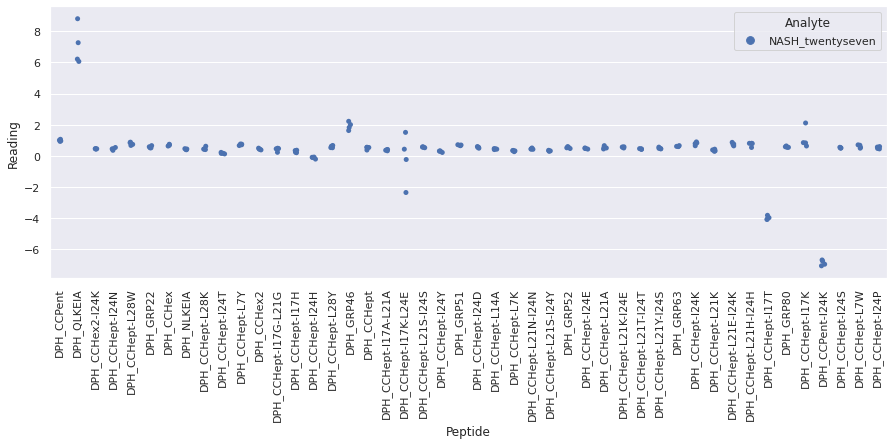

 WARNING - median fluorescence of (NASH_twentysix + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentysix_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentysix + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentysix_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentysix_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

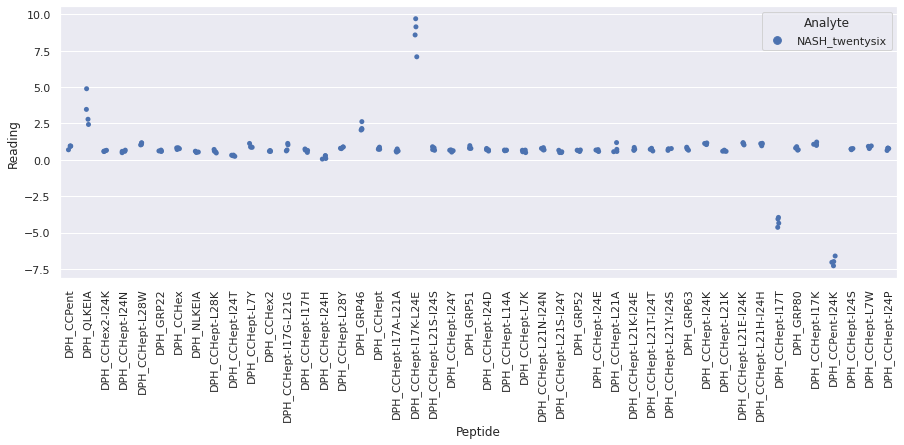

 WARNING - median fluorescence of (NASH_twentythree + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentythree_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentythree + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (NASH_twentythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentythree_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentythree + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentythree_repeat_4.xlsx. Analysis will continue but ple

<Figure size 720x720 with 0 Axes>

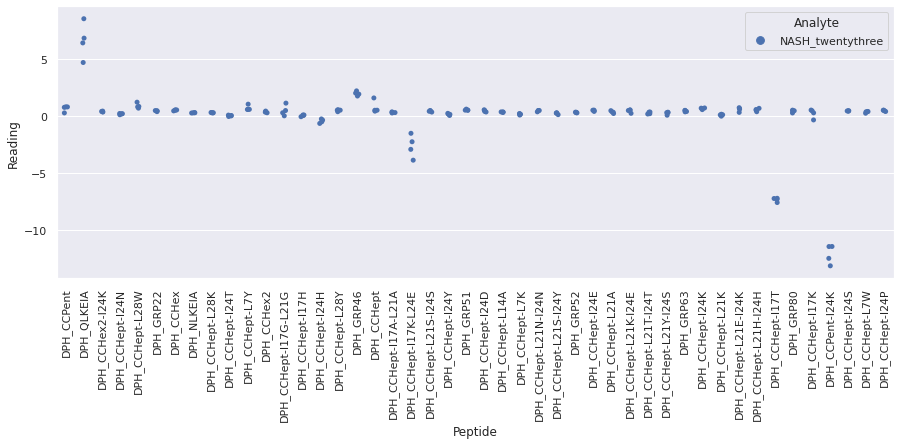

 WARNING - median fluorescence of (NASH_twentytwo + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentytwo_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentytwo + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (NASH_twentytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentytwo_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/NASH_twentytwo_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DAT

<Figure size 720x720 with 0 Axes>

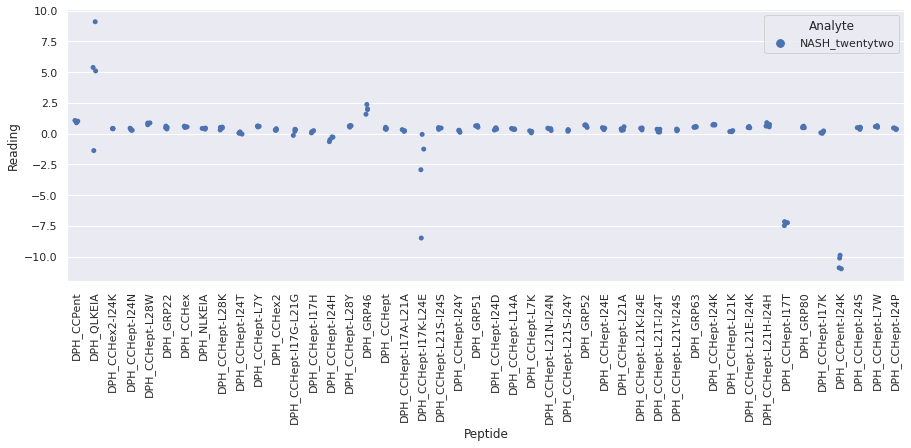

 WARNING - median fluorescence of (Normal_eight + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_eight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eight_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_eight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eight_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eight + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_eight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eight_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plo

<Figure size 720x720 with 0 Axes>

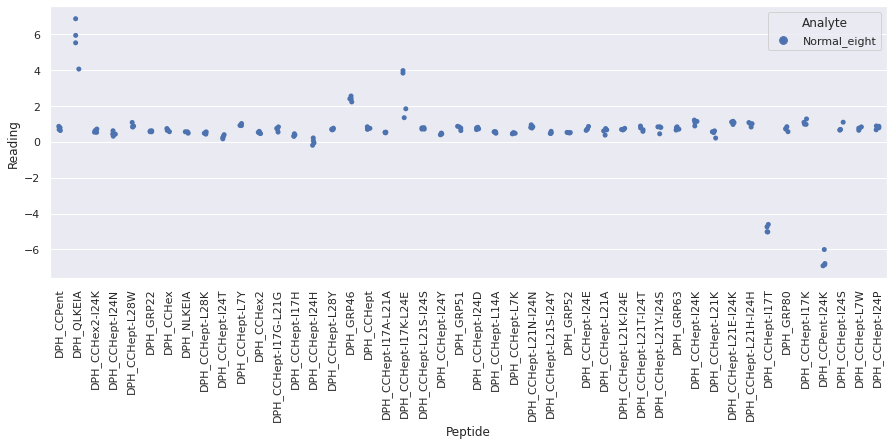

 WARNING - median fluorescence of (Normal_eleven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_eleven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eleven_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eleven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_eleven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_eleven_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_eleven_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

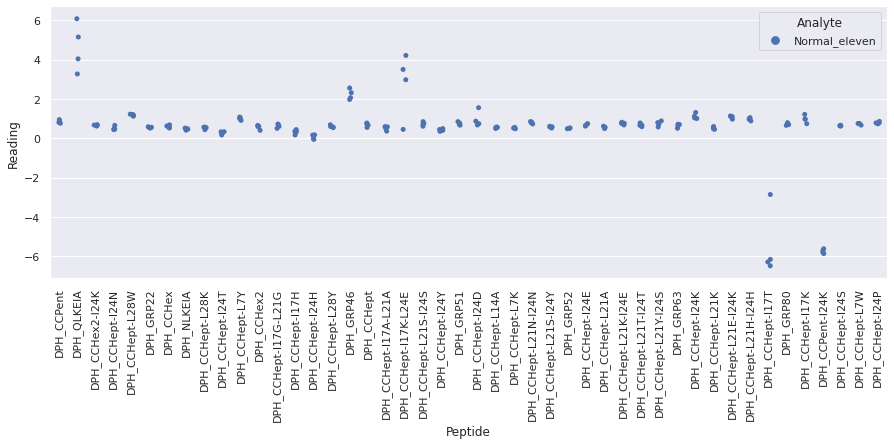

 WARNING - median fluorescence of (Normal_five + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_five + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_five_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_five + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_five + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_five_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_five + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_five + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_five_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data

<Figure size 720x720 with 0 Axes>

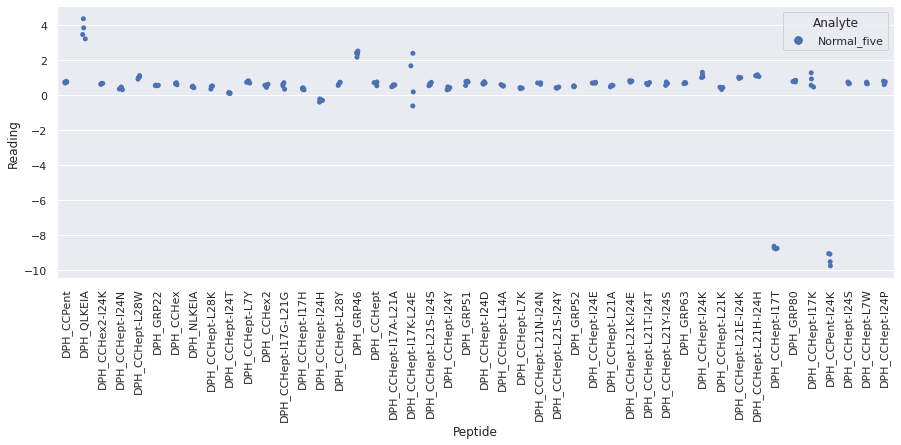

 WARNING - median fluorescence of (Normal_four + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_four + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_four_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_four + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_four + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_four_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_four + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_four + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_four_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data

<Figure size 720x720 with 0 Axes>

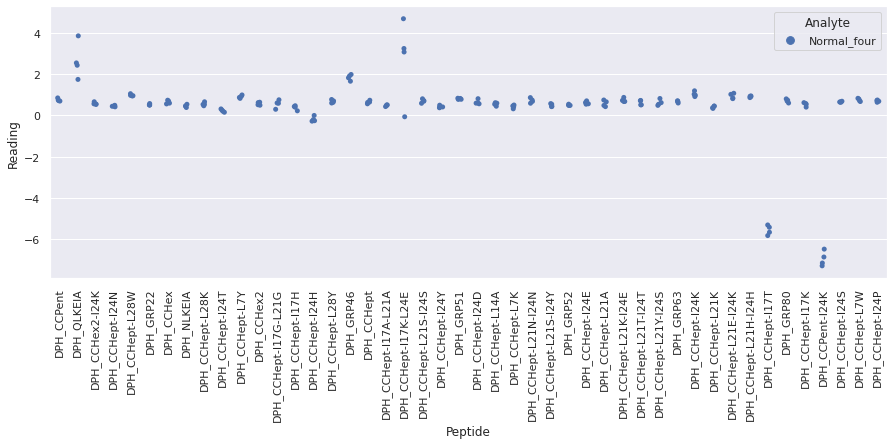

 WARNING - median fluorescence of (Normal_fourteen + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_fourteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_fourteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fourteen + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_fourteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_fourteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fourteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_fourteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_fourteen_repeat_4.xlsx. Analysis will continue but please CHECK

<Figure size 720x720 with 0 Axes>

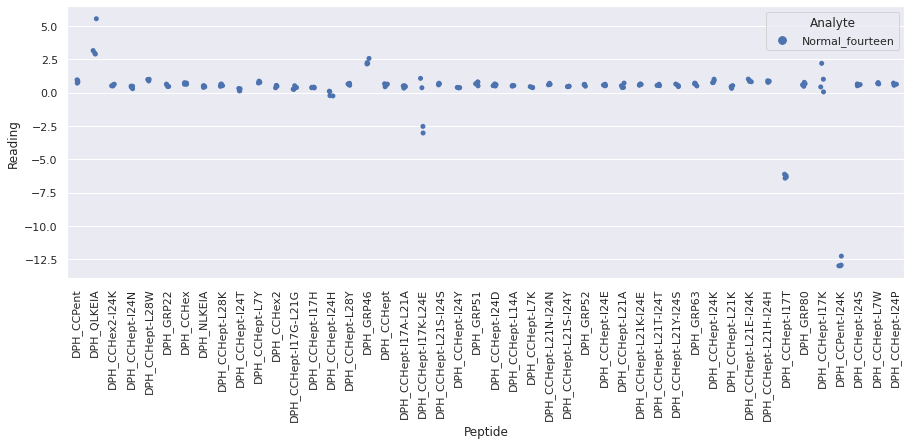

 WARNING - median fluorescence of (Normal_nine + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_nine_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_nine + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_nine_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_nine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_nine_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluor

<Figure size 720x720 with 0 Axes>

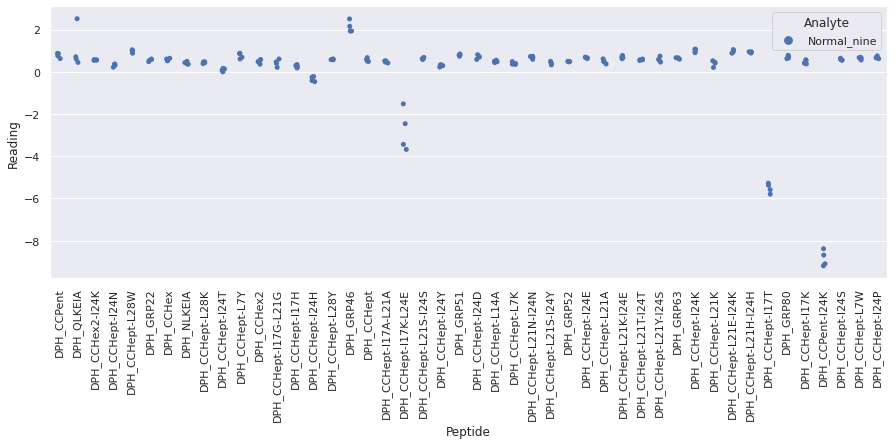

 WARNING - median fluorescence of (Normal_one + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_one + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_one_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_one + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_one + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_one_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_one + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_one + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_one_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence o

<Figure size 720x720 with 0 Axes>

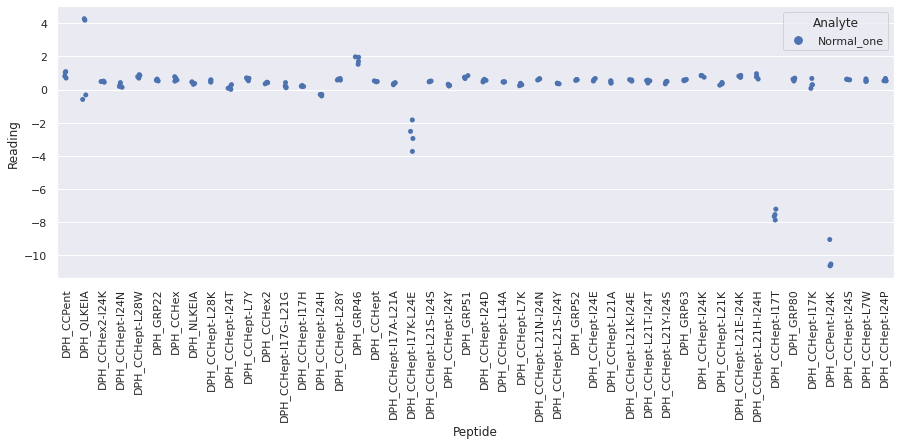

 WARNING - median fluorescence of (Normal_seven + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_seven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_seven_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_seven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_seven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_seven_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_seven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_seven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_seven_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plo

<Figure size 720x720 with 0 Axes>

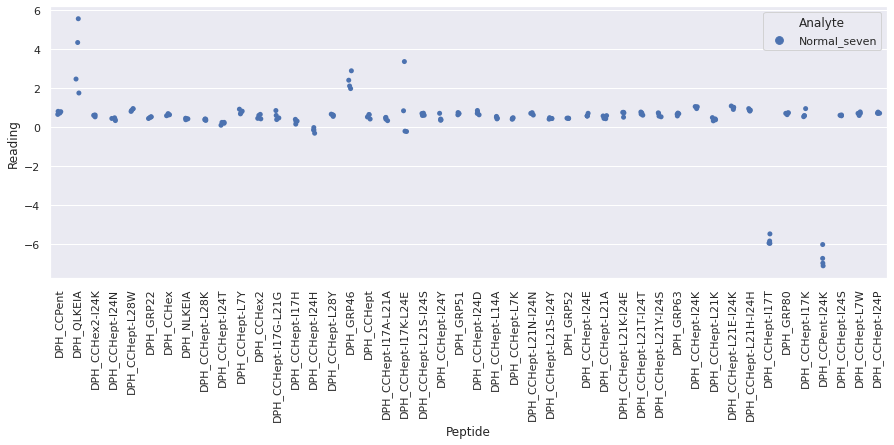

 WARNING - median fluorescence of (Normal_six + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_six + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_six_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_six + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_six + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_six_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_six + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_six + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_six_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread f

<Figure size 720x720 with 0 Axes>

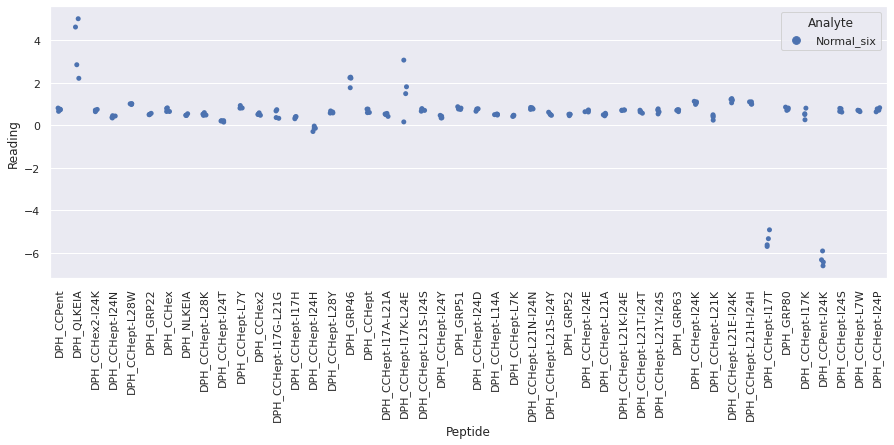

 WARNING - median fluorescence of (Normal_ten + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_ten + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_ten_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_ten + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_ten + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_ten_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_ten + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_ten + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_ten_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread f

<Figure size 720x720 with 0 Axes>

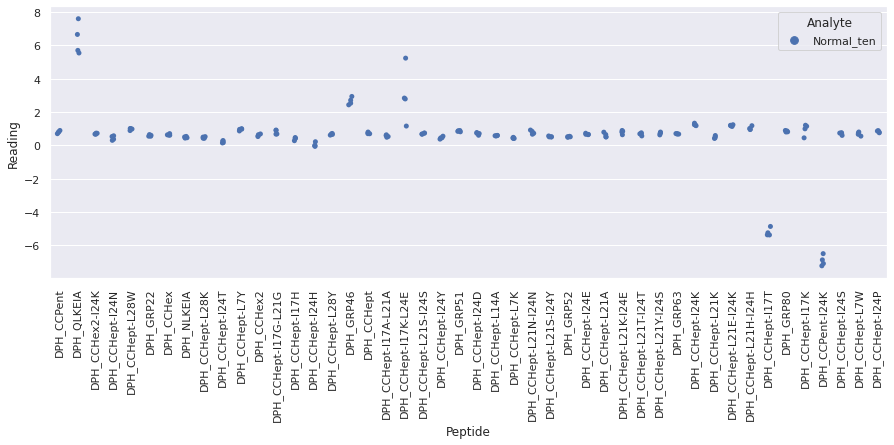

 WARNING - median fluorescence of (Normal_thirteen + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_thirteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirteen + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_thirteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_thirteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_thirteen_repeat_4.xlsx. Analysis will continue but please CHECK

<Figure size 720x720 with 0 Axes>

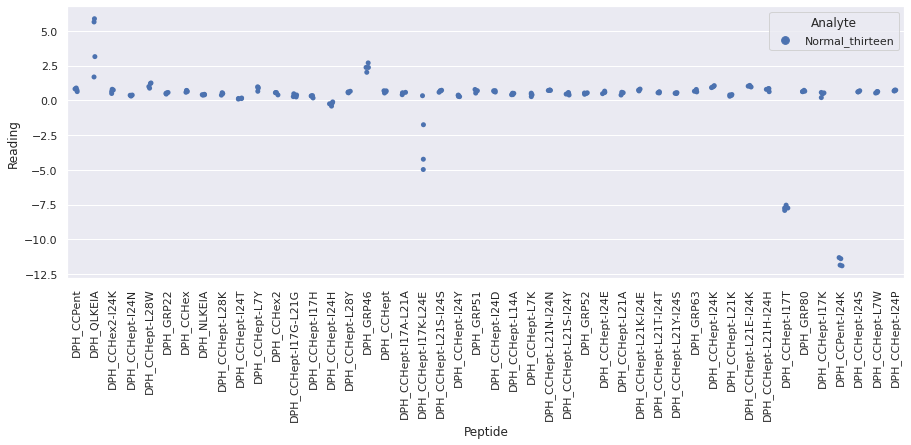

 WARNING - median fluorescence of (Normal_three + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_three + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_three_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_three + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_three + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_three_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_three_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

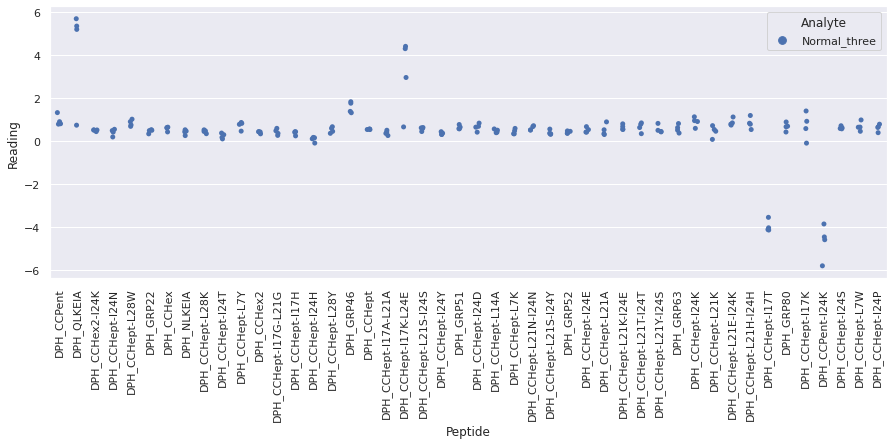

 WARNING - median fluorescence of (Normal_twelve + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_twelve + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_twelve_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_twelve + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_twelve + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_twelve_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twelve_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

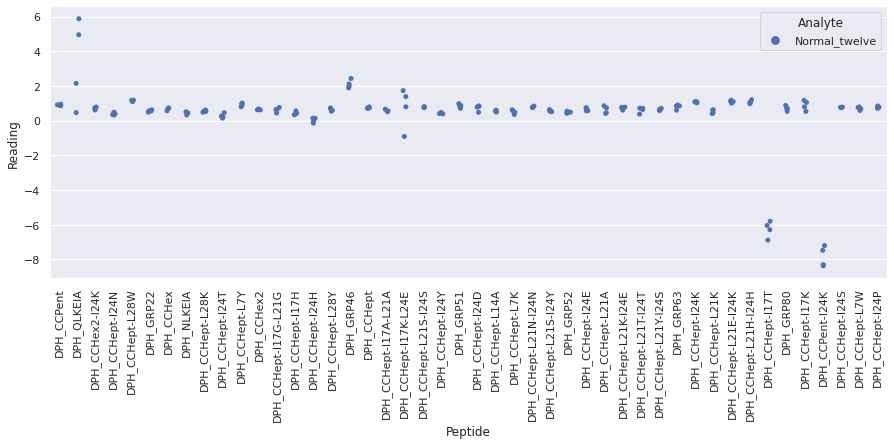

 WARNING - median fluorescence of (Normal_two + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_two + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_two_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_two + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_two + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_two_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_two + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_two + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/Normal_two_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread f

<Figure size 720x720 with 0 Axes>

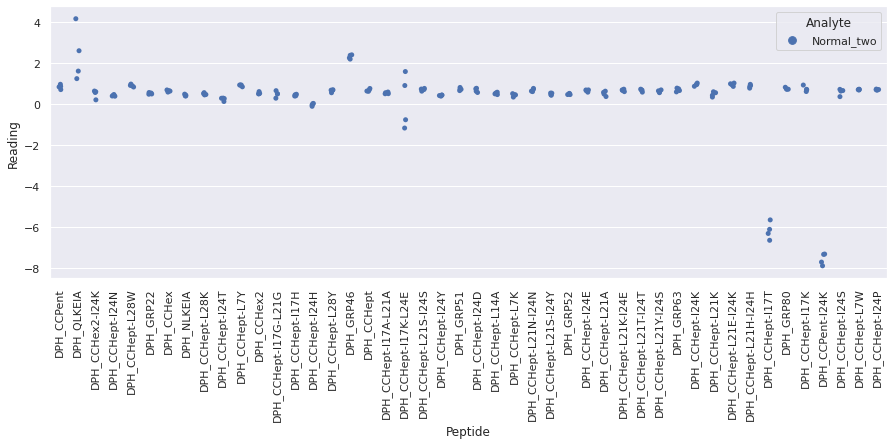



Outliers on the same plate:

/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_forty_repeat_1.xlsx: blank, DPH_CCPent-I24K, 598.0
/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_forty_repeat_1.xlsx: CAD_forty, DPH_CCPent-I24K, 4536.0
/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_forty_repeat_1.xlsx: CAD_forty, DPH_CCHept-L7W, 5731.0
/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortyone_repeat_1.xlsx: CAD_fortyone, DPH_GRP63, 13607.0
/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortyone_repeat_1.xlsx: CAD_fortyone, DPH_CCHept-L21K, 4077.0
/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_3_classes_split_patient/CAD_fortytwo_repeat_1.xlsx: blank, DPH_CCHept-L21A, 12525.0
/home/ks17361/ML_environment/BADASS/NASH_serum_dat

In [6]:
nash_fluor_data.xlsx_to_scaled_df(
    no_pep={'DPH': 'No Pep'}, scale_method='analyte_fluorophore', draw_plot=True, plot_dir_name='NASH'
)

At a glance:
- The serum samples are causing changes in fluorescence (e.g. compare to the sugar samples, where addition of analyte has little effect upon the fluorescence signal) - clearly there are components in the samples that are substantially affecting the interaction of DPH with the peptides.
- By eye there aren't any entire plates that are anomalous and hence should be discarded. There are individual outliers on several plates, however they will be discarded when the repeat readings are averaged by calculating the median.
- The serum samples themselves fluoresce at the same wavelength as DPH (excite at 350nm, measure at 450nm), hence the samples show pretty high background signal (compare the blue and orange dots for "DPH_No Pep" on the scatter plots for each plate). 
- There are several peptides that have little effect upon the fluorescence of DPH. Consequently, given the high background fluorescence of the analyte, the fluorescence of the sample with DPH and the peptide exceeds that of DPH and the peptide alone in these cases. The fact that the fluorescence increases in the presence of analyte is not on its own problematic, provided that the increase is consistent - however, the low fluorescence of the peptide and DPH alone means that these readings are more likely to contain larger amounts of noise (since the readings are scaled relative to the fluorescence of the peptide + DPH in order to enable fair comparison of readings measured on different plates). This is reflected in the above scatter plots - the ranges of readings obtained for peptides QLKEIA and CCHept-I17K-L24E in particular are unusually large even when only comparing samples on the same plate => think it is unlikely that the readings from these peptides will provide much signal about the sample class and instead will be predominantly noise. In contrast, although peptides CCHept-I17T and CCPent-I24K yield negative (scaled) readings as a result of the fact that in both cases the fluorescence of analyte + peptide + DPH is smaller than that of analyte + DPH alone, the (scaled) readings are fairly consistent. Hence they are likely to provide useful signal (and accordingly I am not concerned by the warnings that these samples cause the program to raise).

Combines readings of the same analyte solution across different plates, then calculates the median reading of non-independent repeats of the same analyte. Runs generalised ESD test, discards samples with three or more outlier readings (p=0.02 threshold).

(Using the default thresholds of p=0.05 and drop_thresh=2, I found a large number of samples were identified as "anomalous" (when in fact looking at the scatter plots above by eye they did not appear obviously unusual). Consequently I have reduced the p-value threshold to 0.02. The original values of p=0.05 and drop_thresh=2 were determined on the small molecules data - that they appear to be too stringent for biological data likely reflects the greater variation present in biological samples.)

In [7]:
nash_fluor_data.combine_plate_readings(outlier_excl_thresh=0.02, drop_thresh=2)



Outliers across plates:

repeat_1_CAD_forty: CAD_forty, DPH_CCPent-I24K, 12.320809248554914
repeat_1_CAD_fortyone: CAD_fortyone, DPH_CCHept-L21K, 0.13252807077237155
repeat_1_CAD_fortytwo: CAD_fortytwo, DPH_CCHept-L21Y-I24S, 0.572105512557258
repeat_1_CAD_thirtyeight: CAD_thirtyeight, DPH_CCHept-L21K, 0.4304666409564211
repeat_1_CAD_thirtyeight: CAD_thirtyeight, DPH_CCHept-I24S, 0.5013074969429029
repeat_1_CAD_thirtyfive: CAD_thirtyfive, DPH_GRP46, 1.0182245737801294
repeat_1_CAD_thirtyfive: CAD_thirtyfive, DPH_CCHept-I17K-L24E, -0.2838196286472148
repeat_1_CAD_thirtyfive: CAD_thirtyfive, DPH_CCHept-L21A, 0.24337050805452293
repeat_1_CAD_thirtyfive: CAD_thirtyfive, DPH_CCHept-I17T, 0.6789168278529981
repeat_1_CAD_thirtyfour: CAD_thirtyfour, DPH_CCHept-L28K, 0.7025433099889421
repeat_1_CAD_thirtyfour: CAD_thirtyfour, DPH_CCHept-L21E-I24K, 0.46549781403524587
repeat_1_CAD_thirtyfour: CAD_thirtyfour, DPH_CCHept-L21H-I24H, 2.1983648881239244
repeat_1_CAD_thirtyseven: CAD_thirtyseven, DPH

 Outlier excluded from final output dataset: 3, CAD_thirtyone
DPH_CCPent                                 0.770659
DPH_QLKEIA                                  4.94798
DPH_CCHex2-I24K                            0.566815
DPH_CCHept-I24N                            0.488044
DPH_CCHept-L28W                            0.985672
DPH_GRP22                                  0.504731
DPH_CCHex                                  0.666843
DPH_NLKEIA                                 0.548834
DPH_CCHept-L28K                            0.506275
DPH_CCHept-I24T                             0.23809
DPH_CCHept-L7Y                             0.966691
DPH_CCHex2                                  0.53831
DPH_CCHept-I17G-L21G                       0.573755
DPH_CCHept-I17H                            0.444804
DPH_CCHept-I24H                           0.0303353
DPH_CCHept-L28Y                            0.697479
DPH_GRP46                                   2.29462
DPH_CCHept                                 0.707948
DP

Display range of data points across repeats for the different analytes




Original_data:


CAD_forty


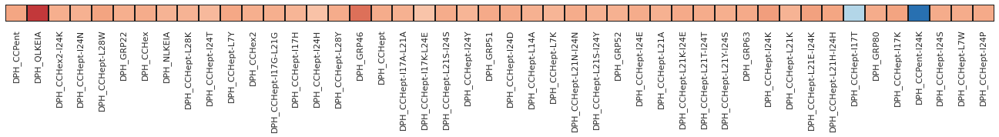


CAD_fortyone


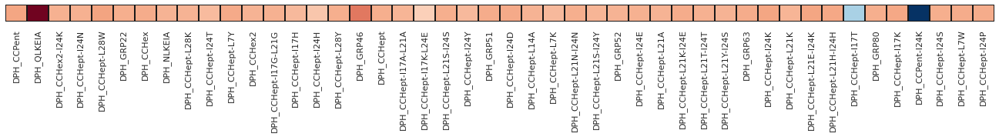


CAD_fortytwo


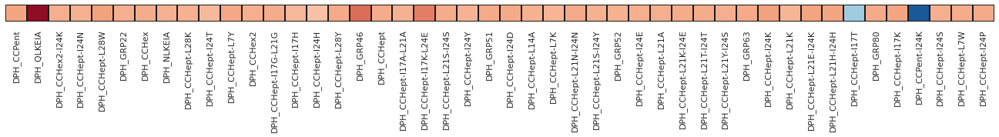


CAD_thirty


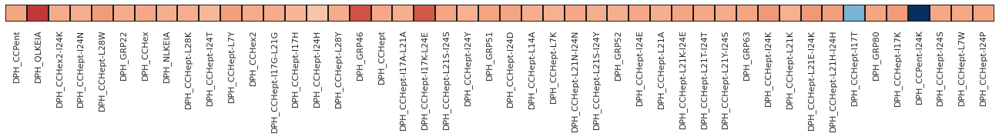


CAD_thirtyeight


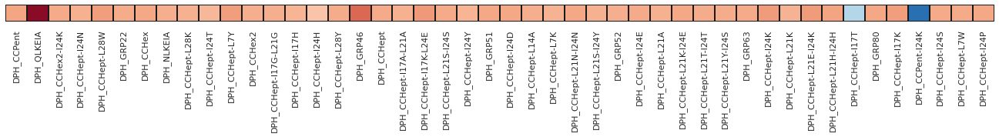


CAD_thirtyfive


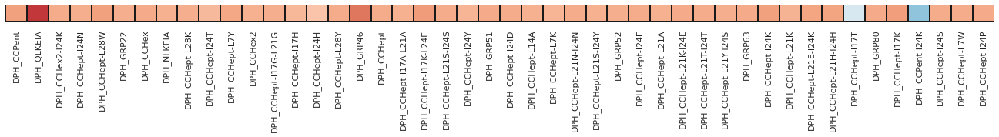


CAD_thirtyfour


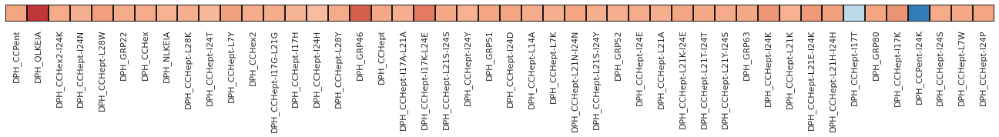


CAD_thirtynine


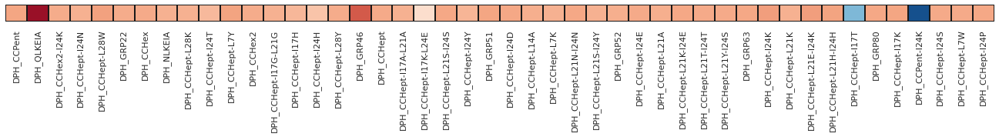


CAD_thirtyone


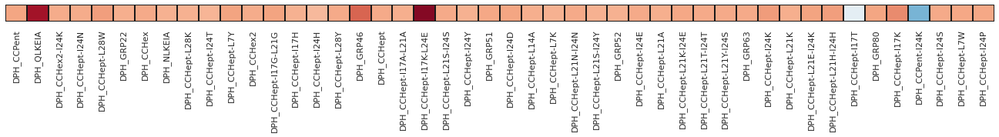


CAD_thirtyseven


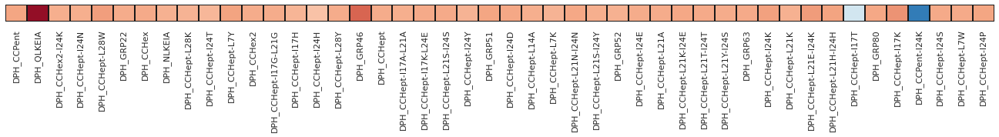


CAD_thirtysix


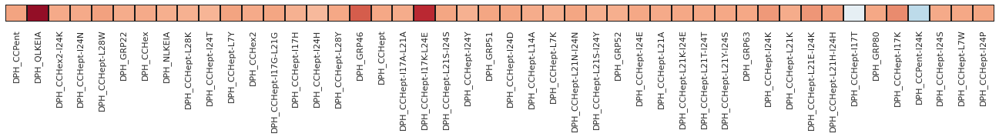


CAD_thirtythree


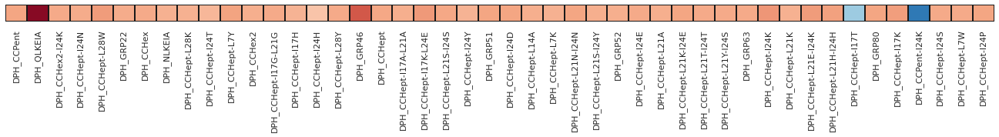


CAD_thirtytwo


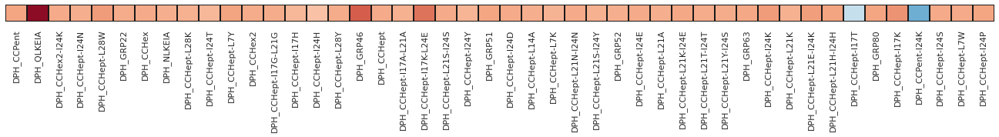


CAD_twentynine


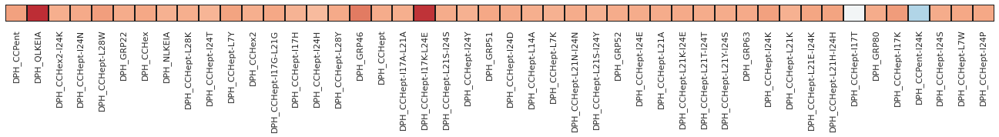


NASH_eighteen


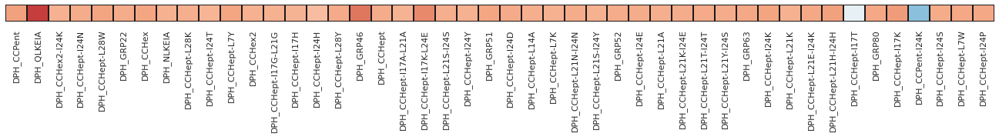


NASH_fifteen


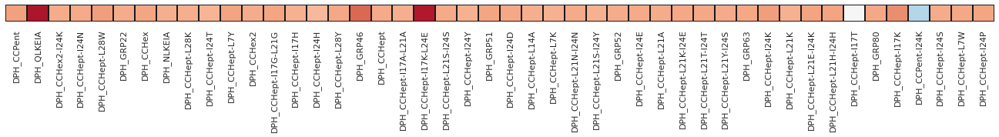


NASH_nineteen


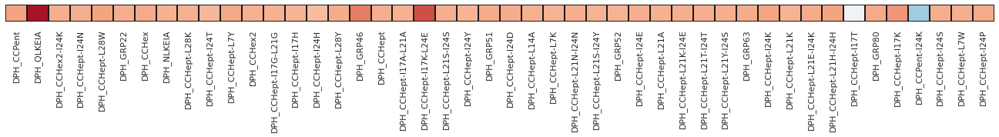


NASH_seventeen


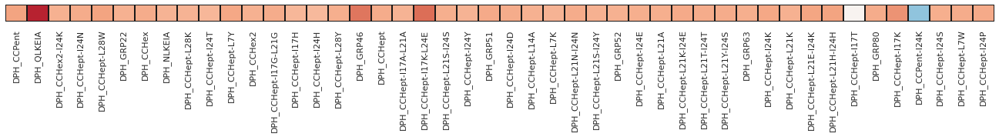


NASH_sixteen


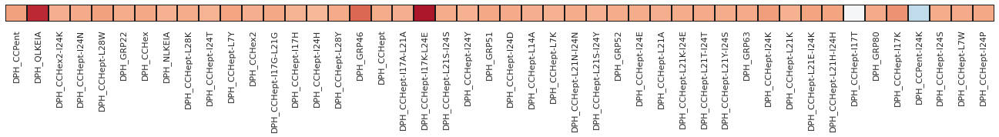


NASH_twenty


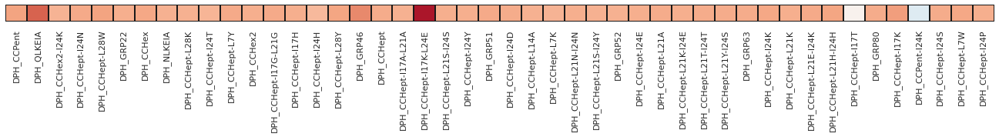


NASH_twentyeight


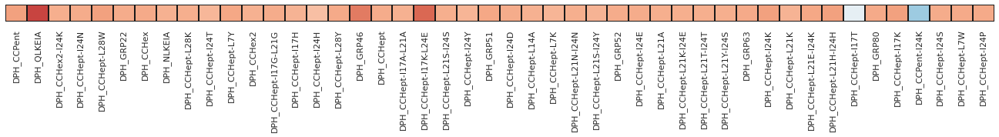


NASH_twentyfive


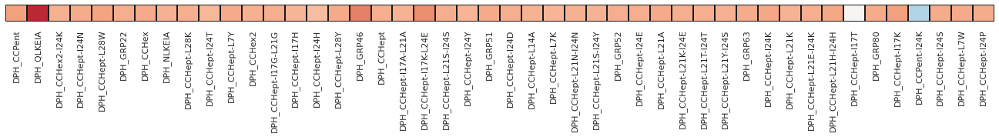


NASH_twentyfour


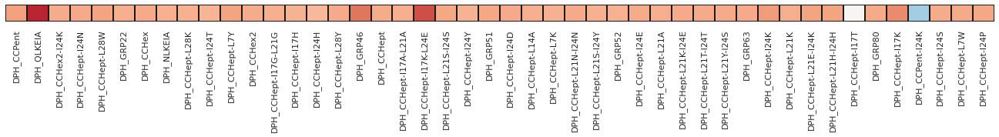


NASH_twentyone


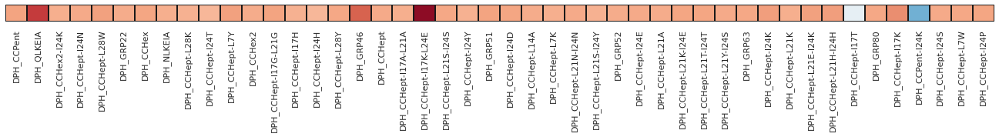


NASH_twentyseven


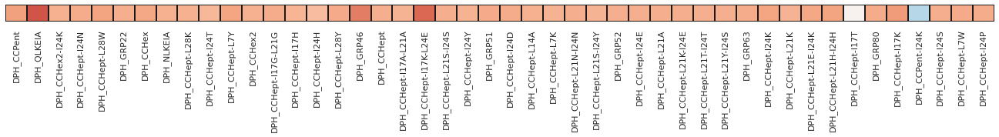


NASH_twentysix


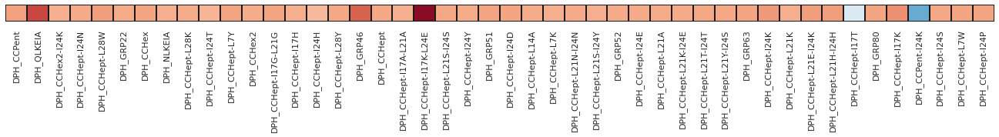


NASH_twentythree


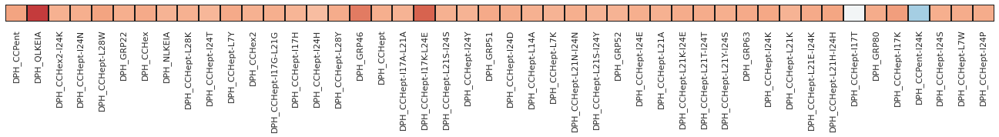


NASH_twentytwo


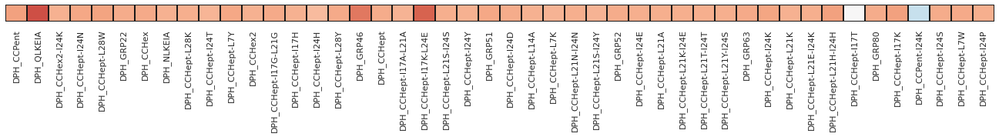


Normal_eight


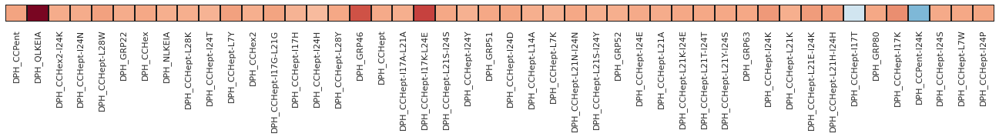


Normal_eleven


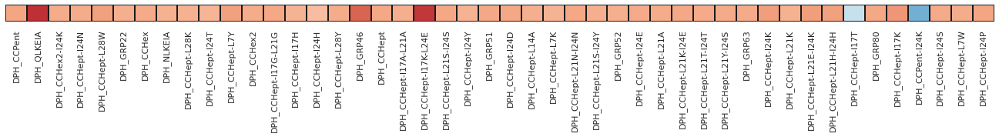


Normal_five


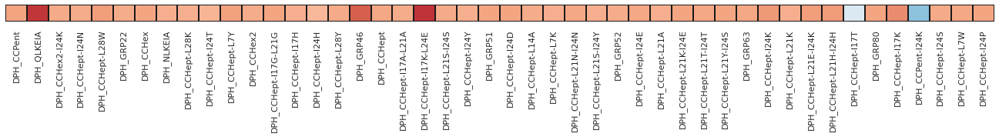


Normal_four


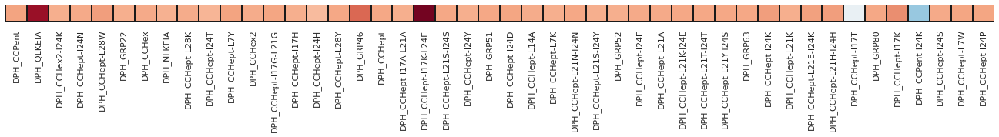


Normal_fourteen


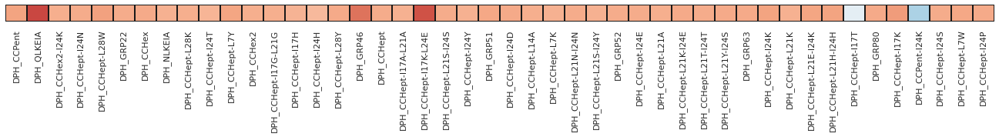


Normal_nine


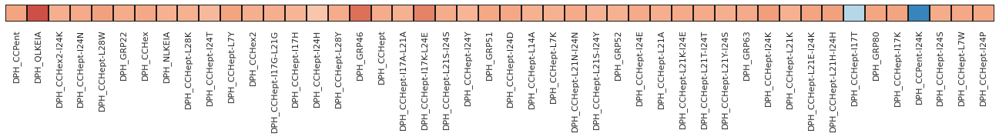


Normal_one


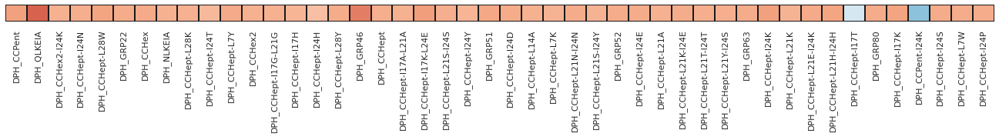


Normal_seven


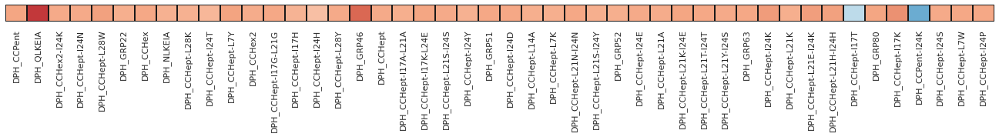


Normal_six


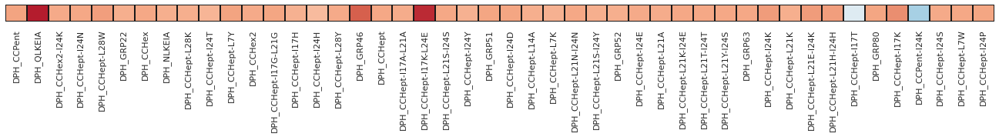


Normal_ten


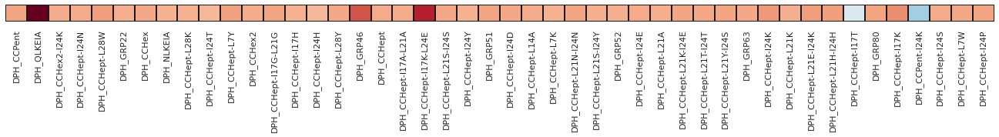


Normal_thirteen


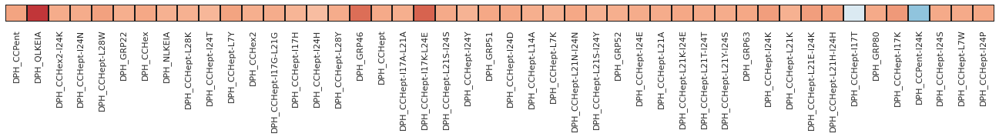


Normal_three


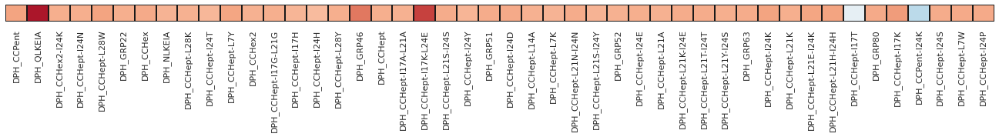


Normal_twelve


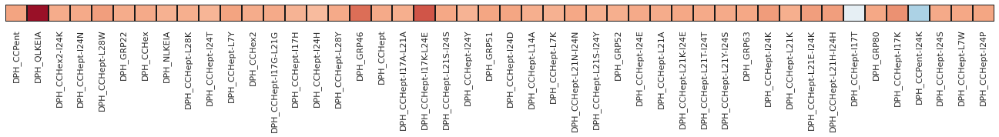


Normal_two


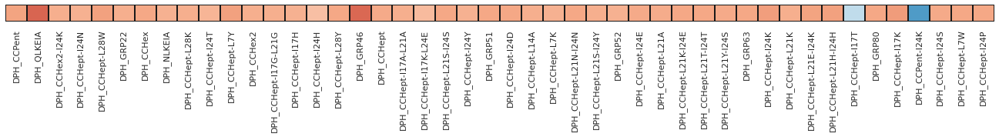




Scaled_data:


CAD_forty


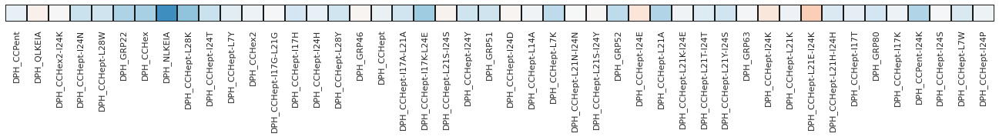


CAD_fortyone


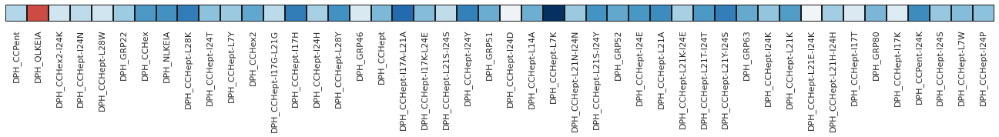


CAD_fortytwo


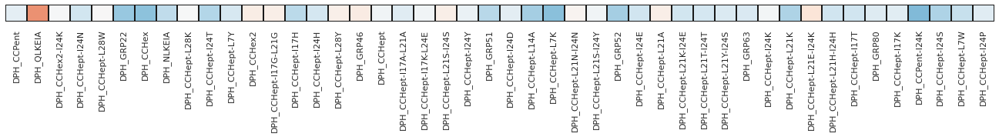


CAD_thirty


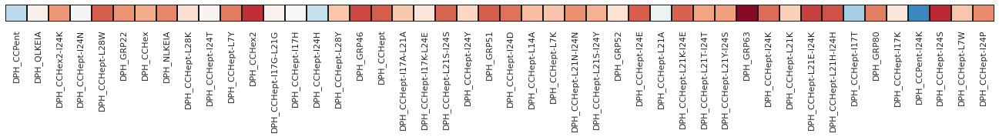


CAD_thirtyeight


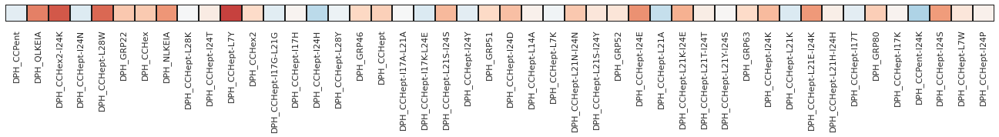


CAD_thirtyfive


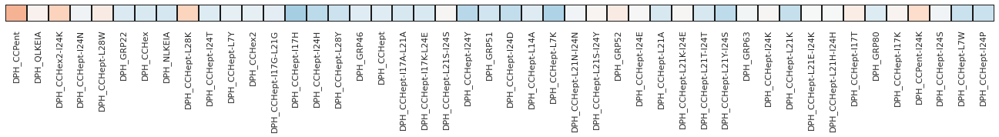


CAD_thirtyfour


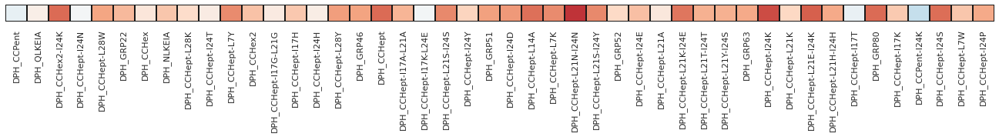


CAD_thirtynine


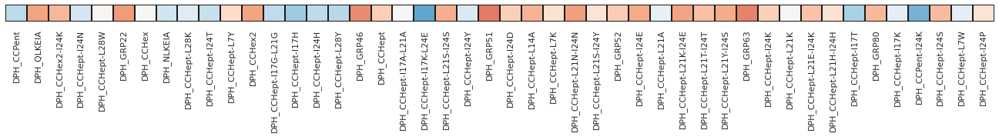


CAD_thirtyone


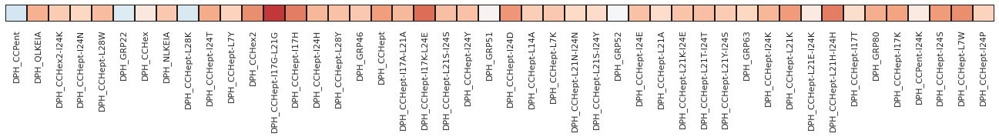


CAD_thirtyseven


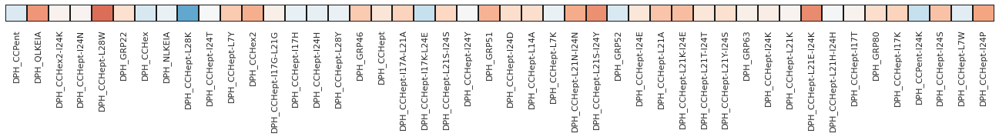


CAD_thirtysix


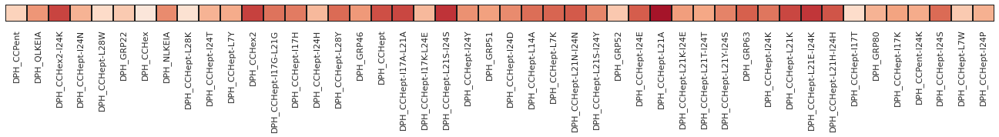


CAD_thirtythree


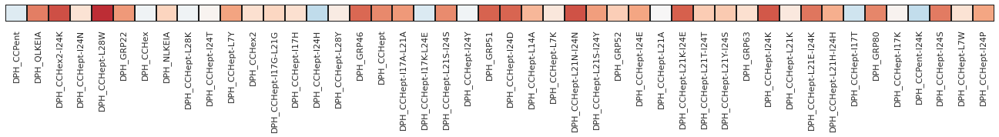


CAD_thirtytwo


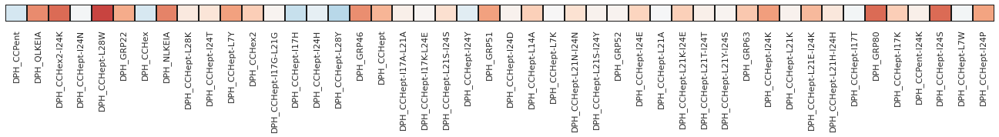


CAD_twentynine


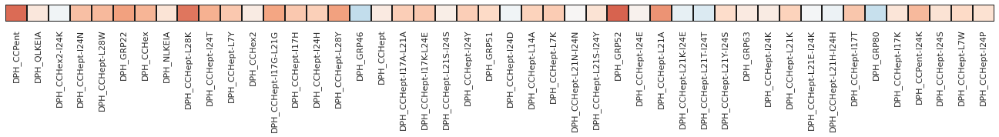


NASH_eighteen


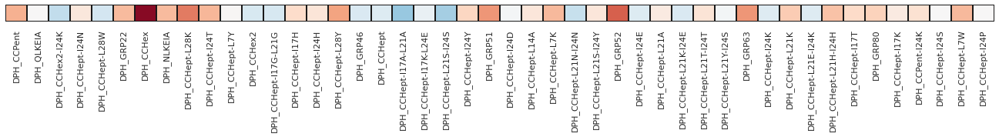


NASH_fifteen


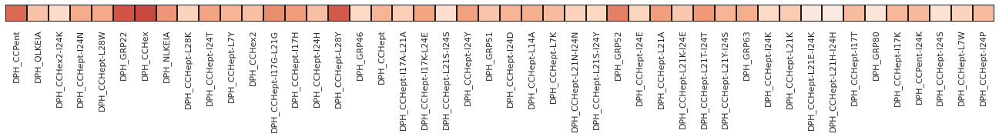


NASH_nineteen


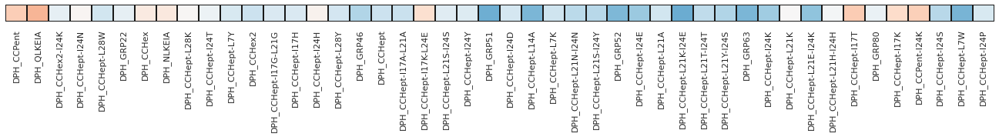


NASH_seventeen


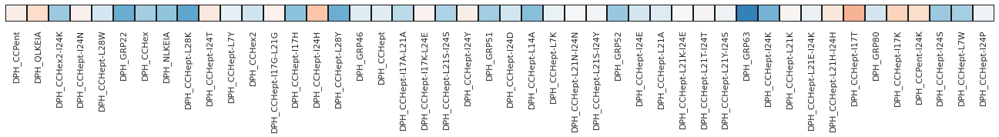


NASH_sixteen


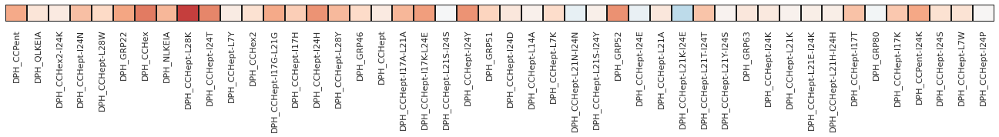


NASH_twenty


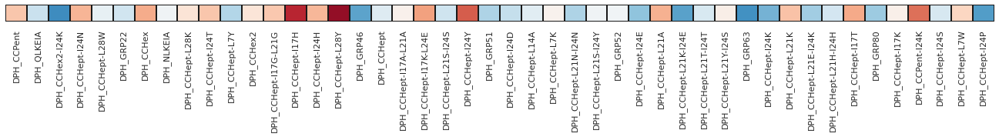


NASH_twentyeight


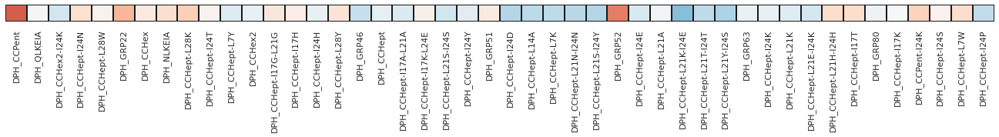


NASH_twentyfive


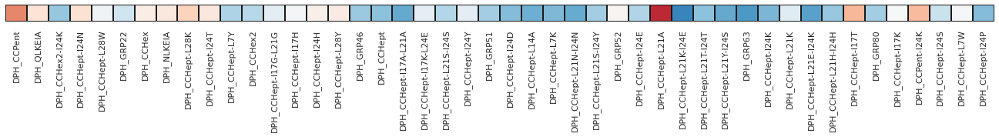


NASH_twentyfour


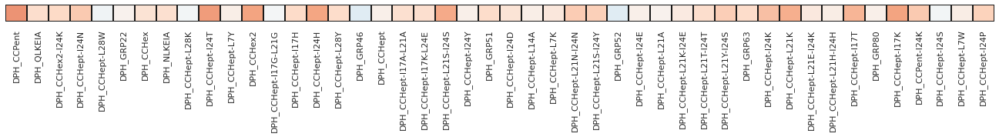


NASH_twentyone


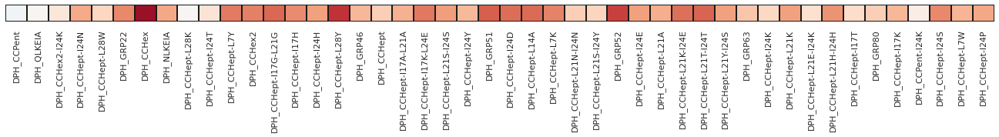


NASH_twentyseven


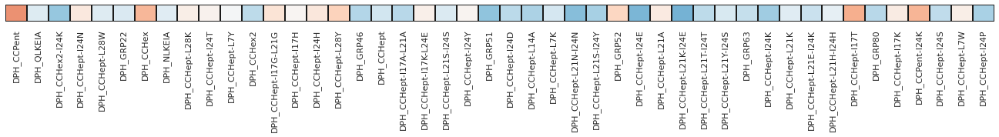


NASH_twentysix


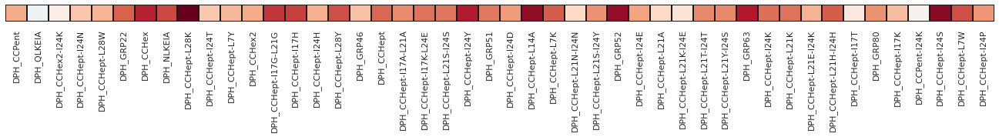


NASH_twentythree


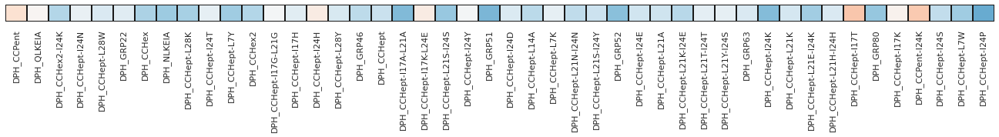


NASH_twentytwo


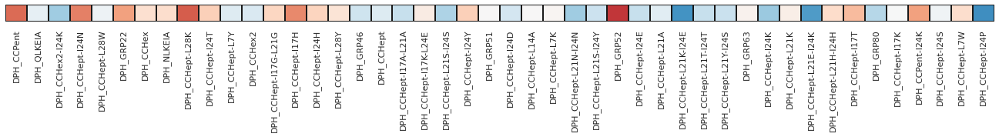


Normal_eight


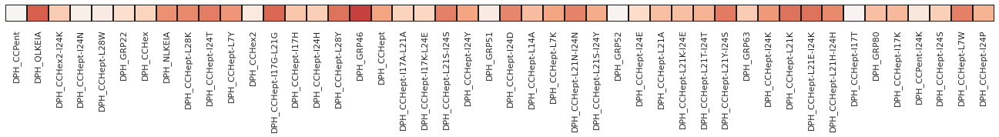


Normal_eleven


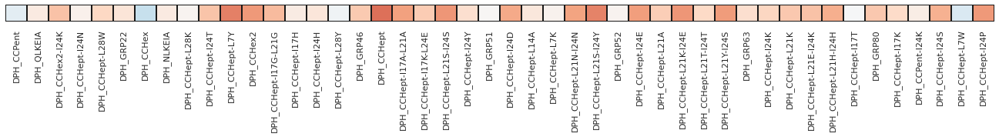


Normal_five


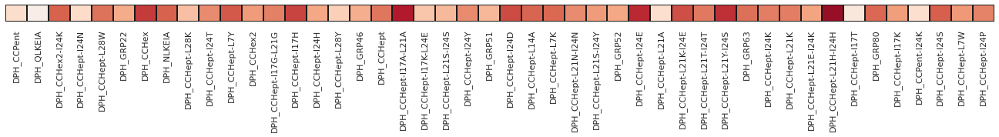


Normal_four


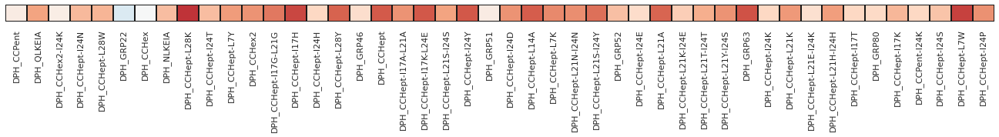


Normal_fourteen


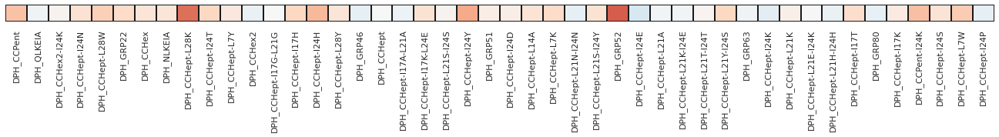


Normal_nine


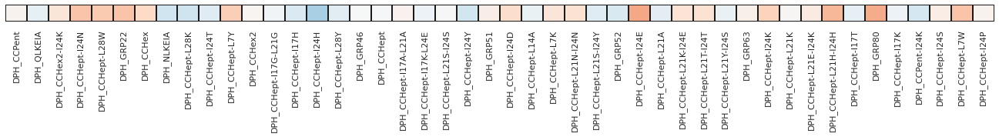


Normal_one


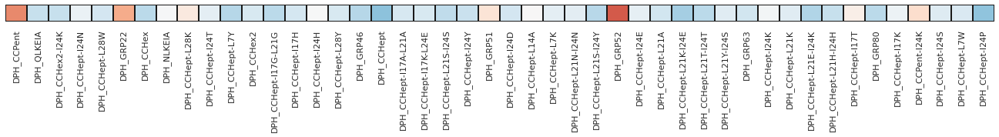


Normal_seven


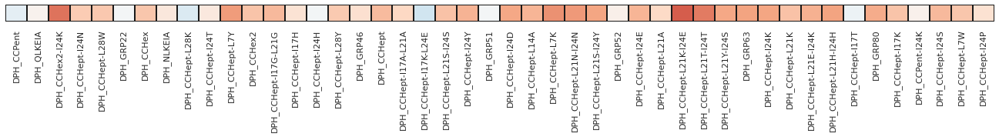


Normal_six


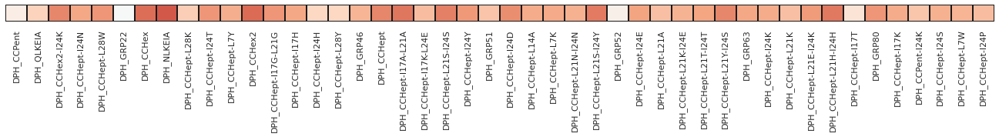


Normal_ten


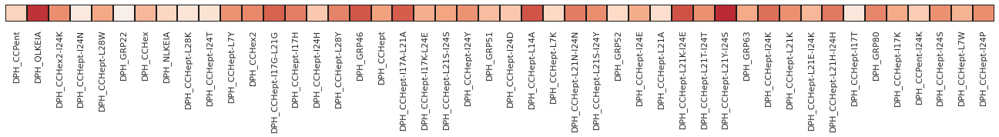


Normal_thirteen


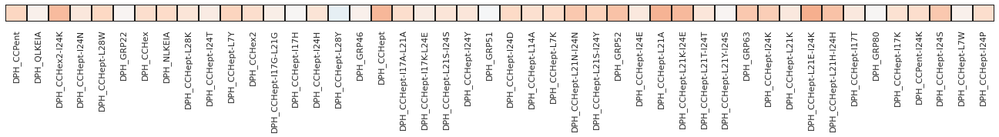


Normal_three


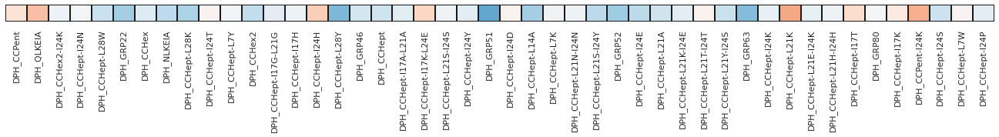


Normal_twelve


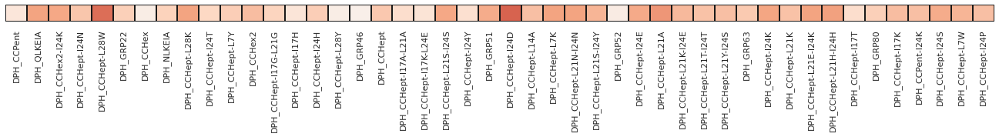


Normal_two


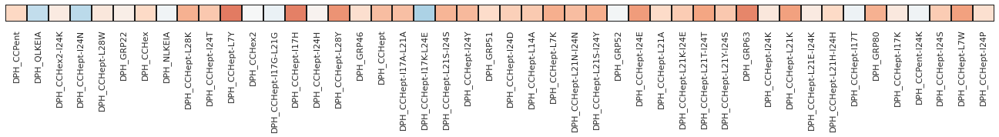




Original_data:



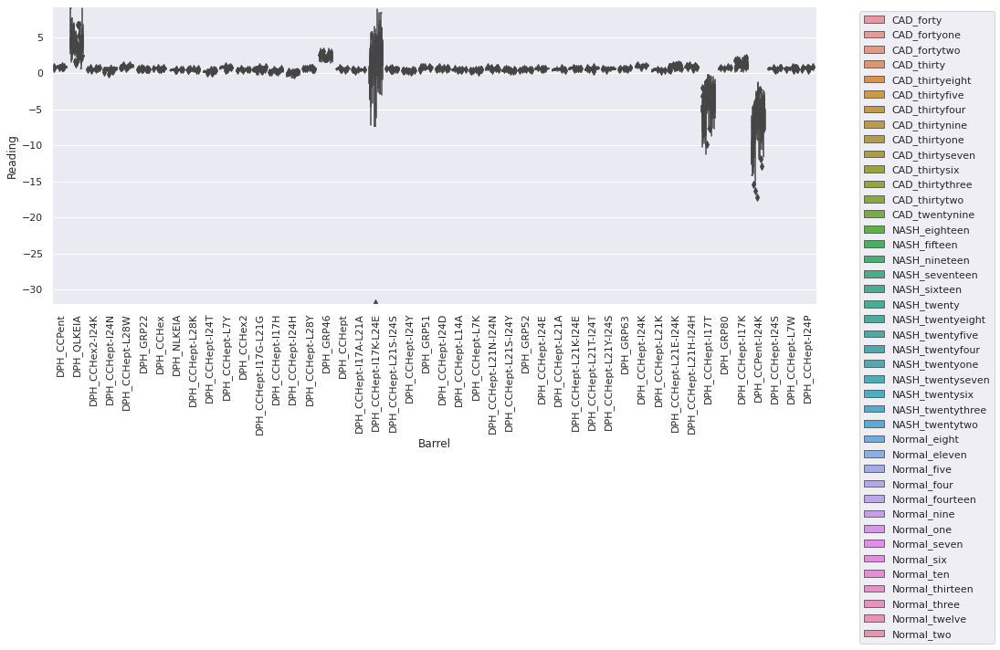

CAD_forty


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


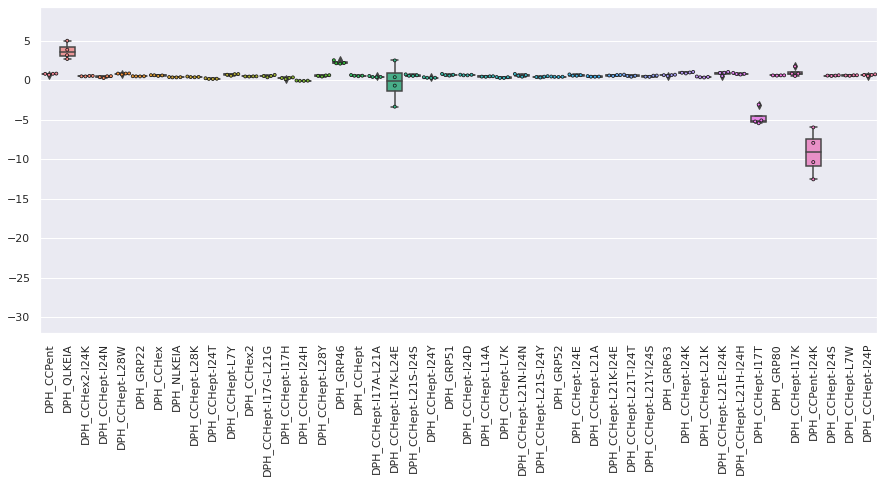

CAD_fortyone


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


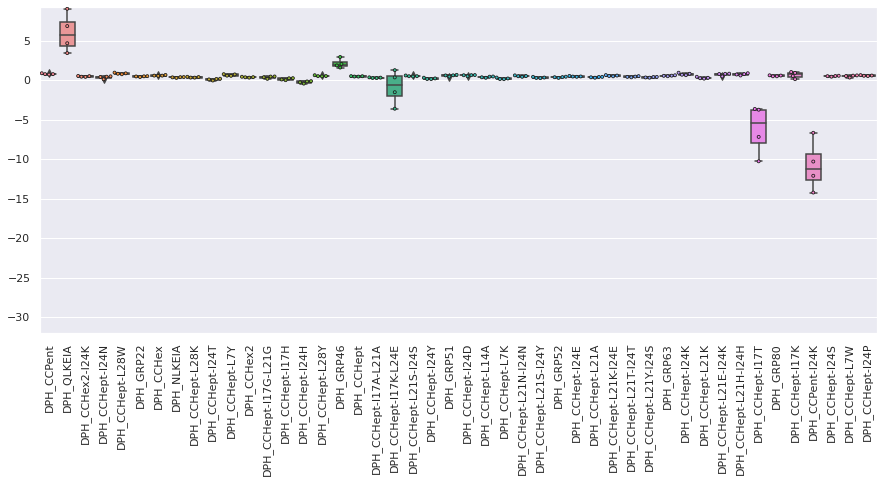

CAD_fortytwo


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


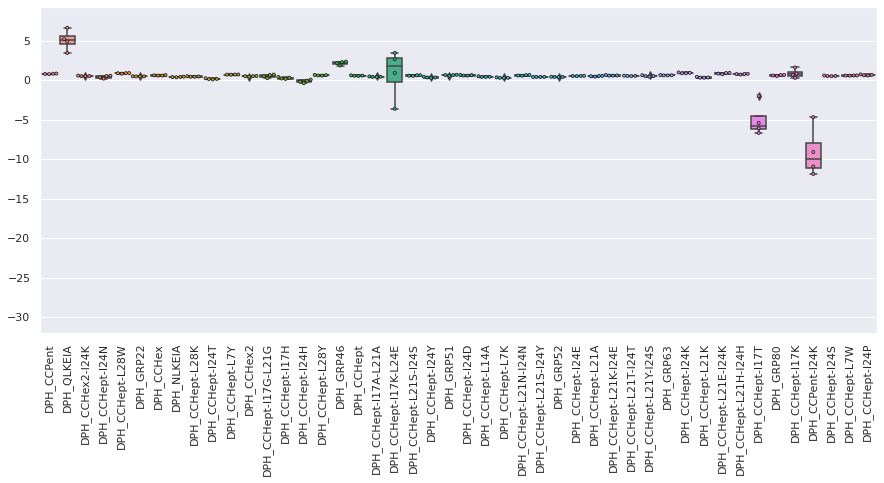

CAD_thirty


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


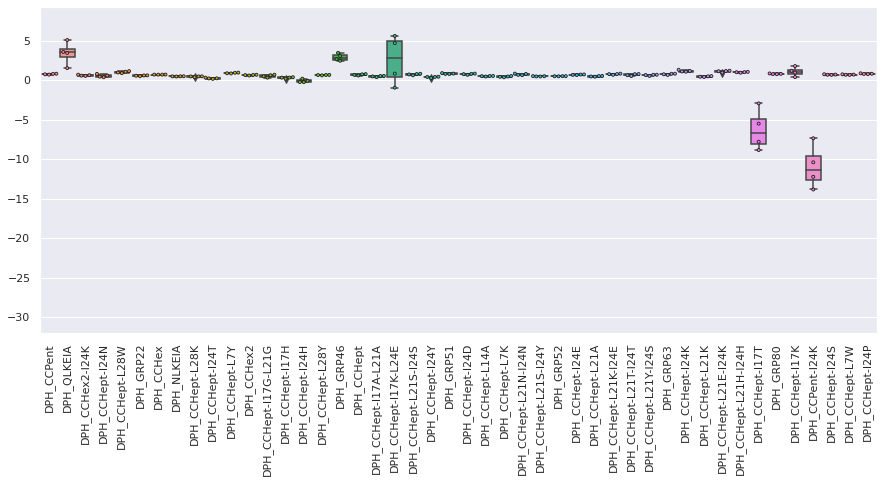

CAD_thirtyeight


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


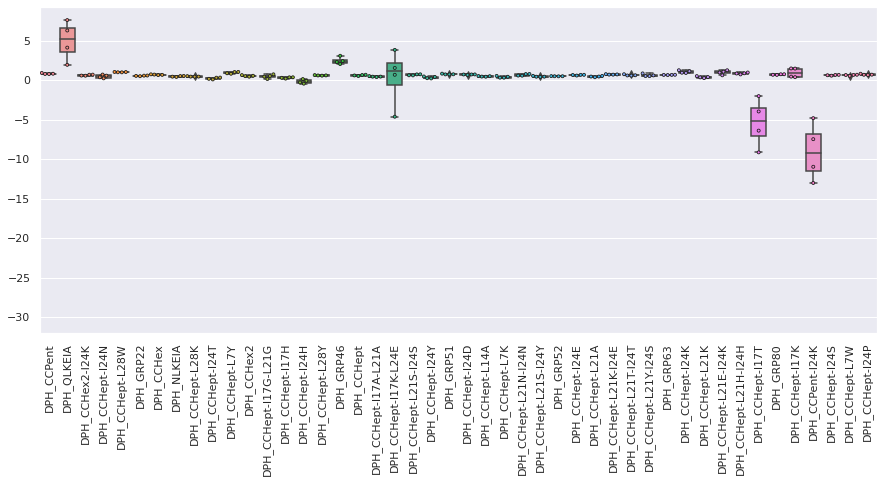

CAD_thirtyfive


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


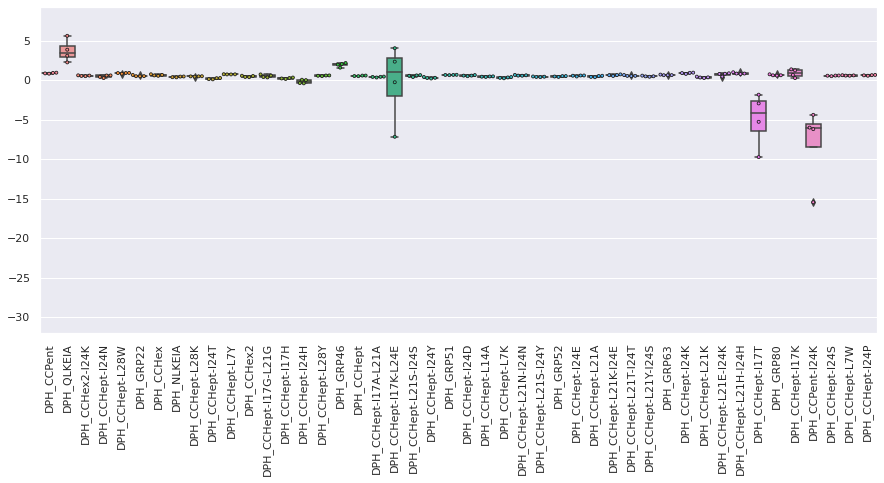

CAD_thirtyfour


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


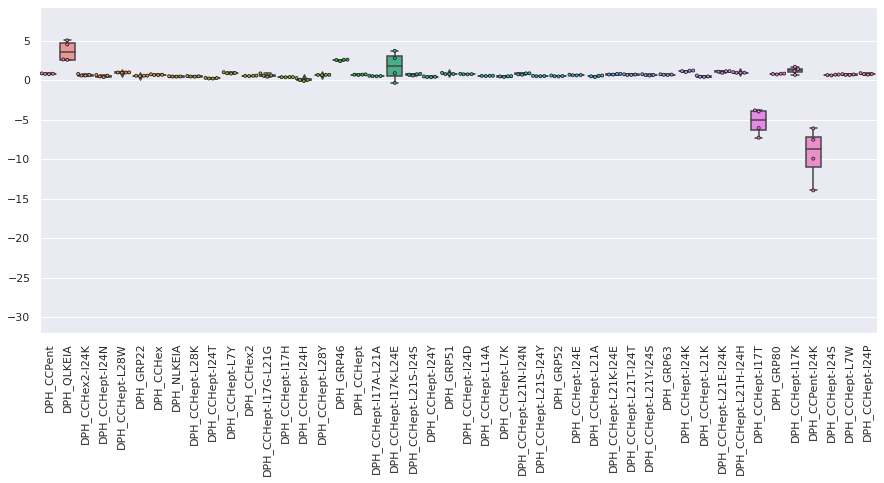

CAD_thirtynine


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


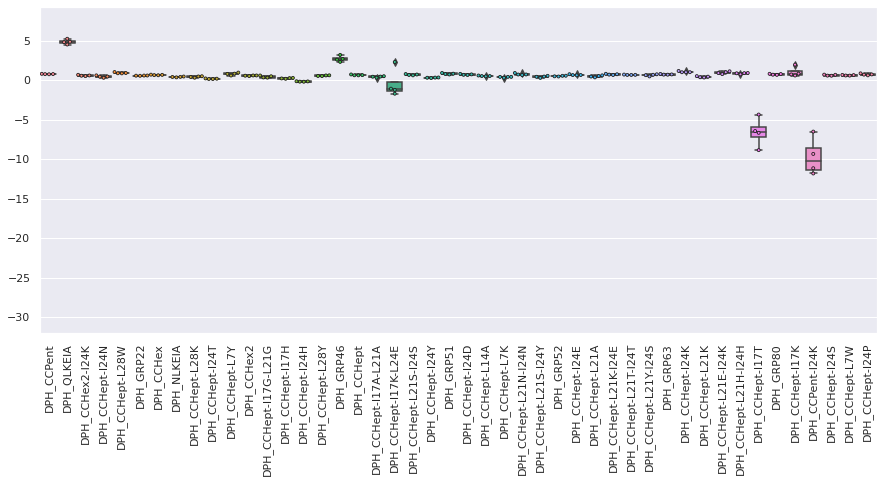

CAD_thirtyone


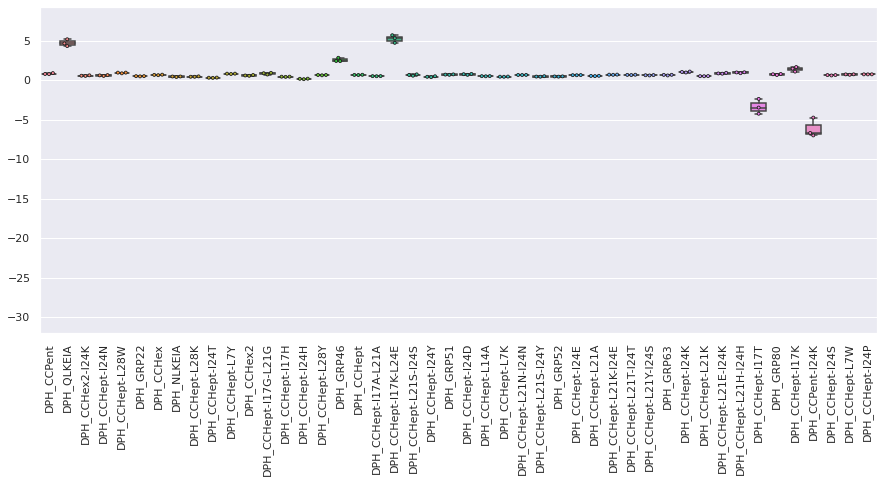

CAD_thirtyseven


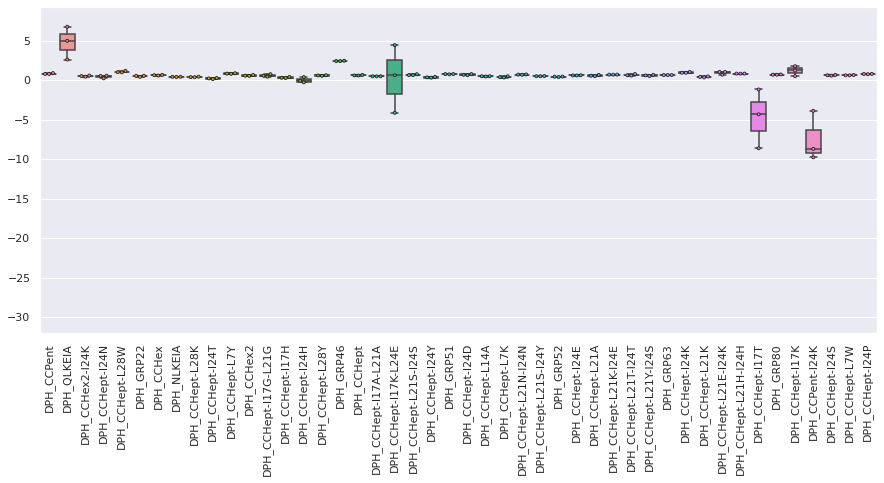

CAD_thirtysix


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


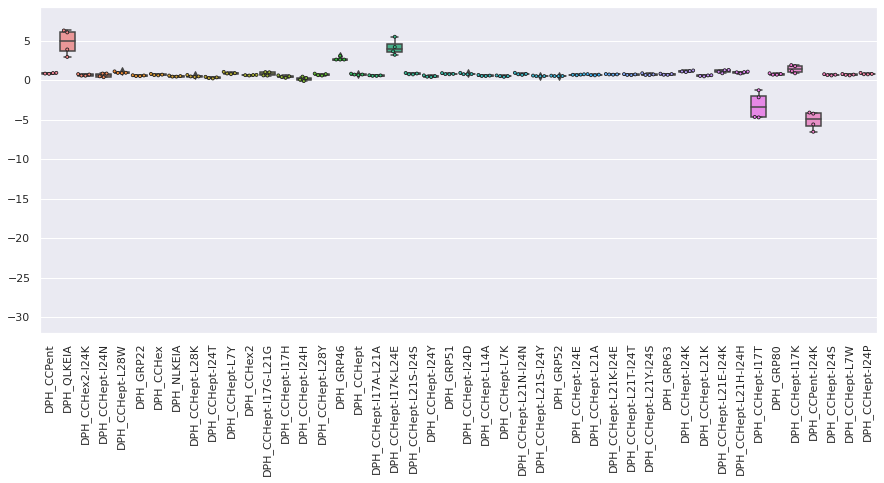

CAD_thirtythree


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


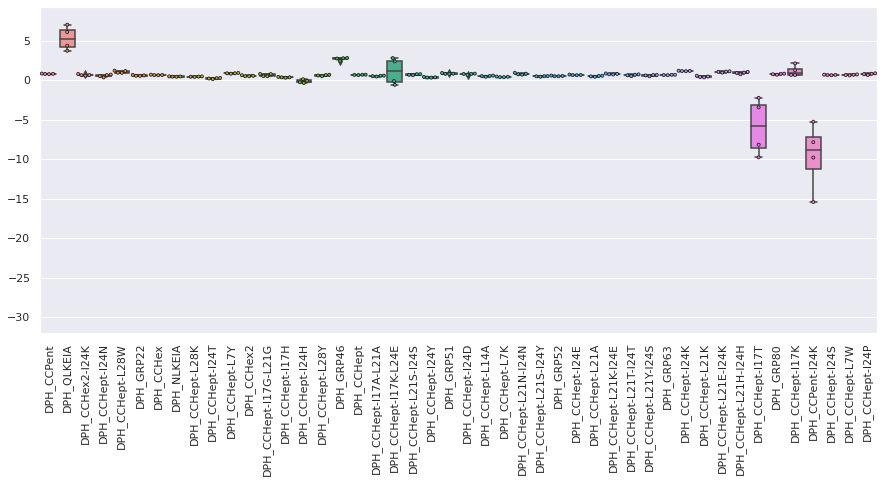

CAD_thirtytwo


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


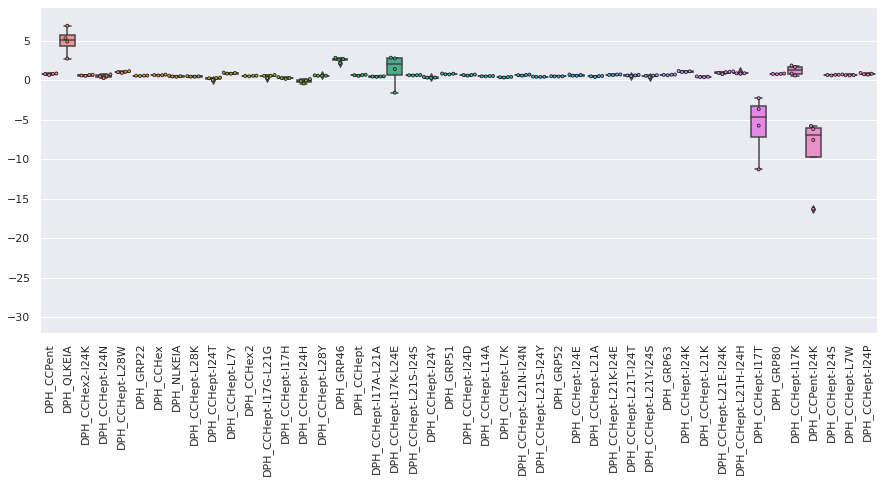

CAD_twentynine


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


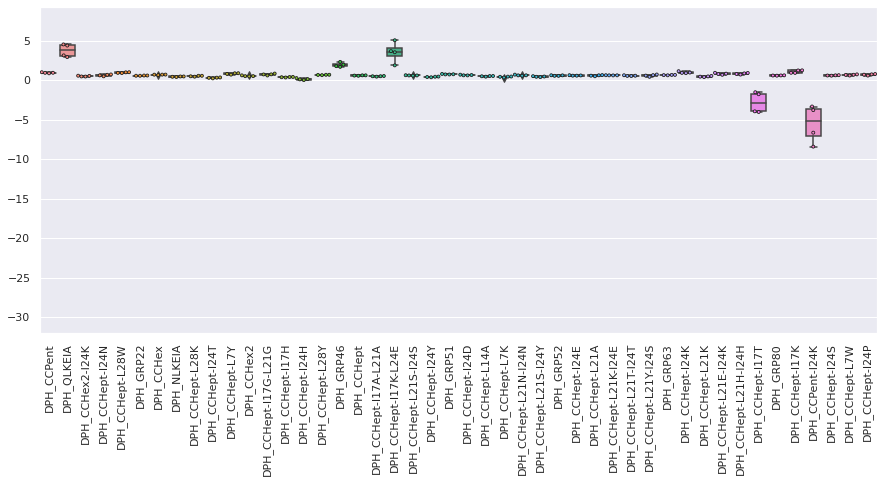

NASH_eighteen


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


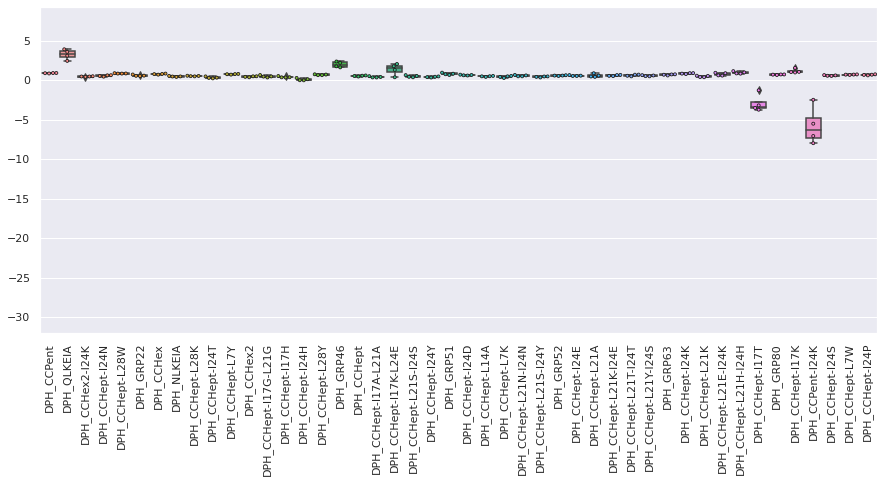

NASH_fifteen


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


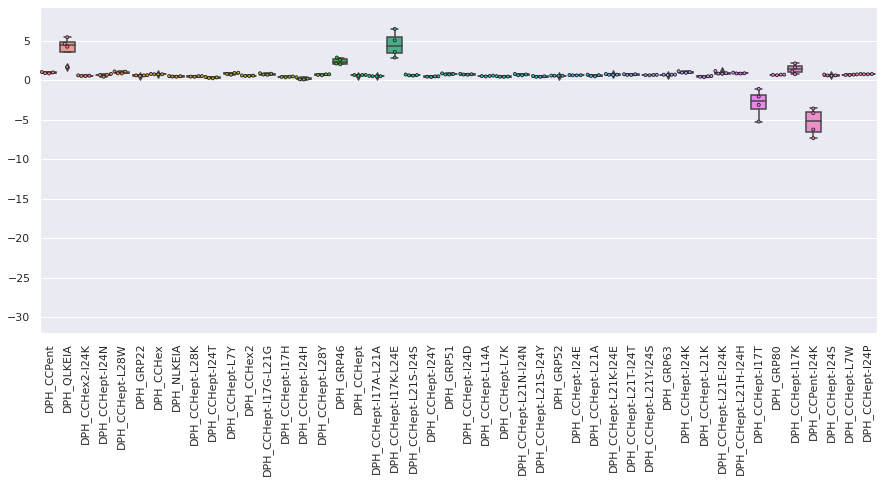

NASH_nineteen


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


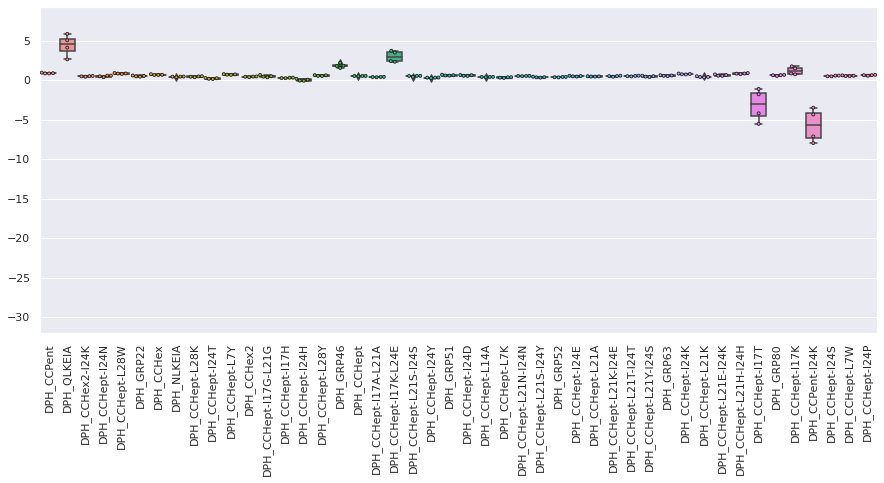

NASH_seventeen


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


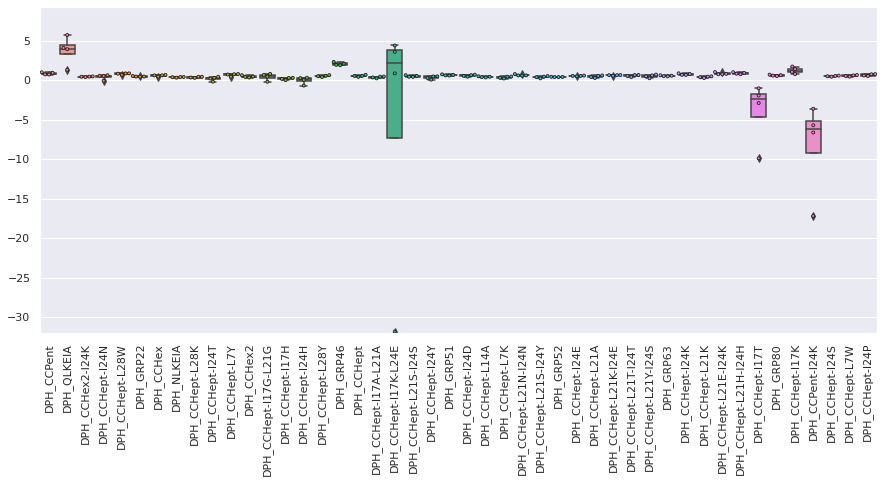

NASH_sixteen


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


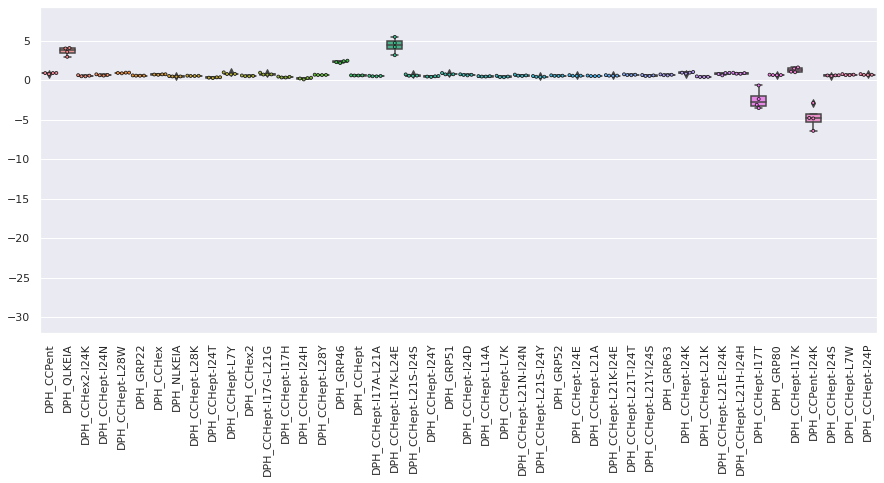

NASH_twenty


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


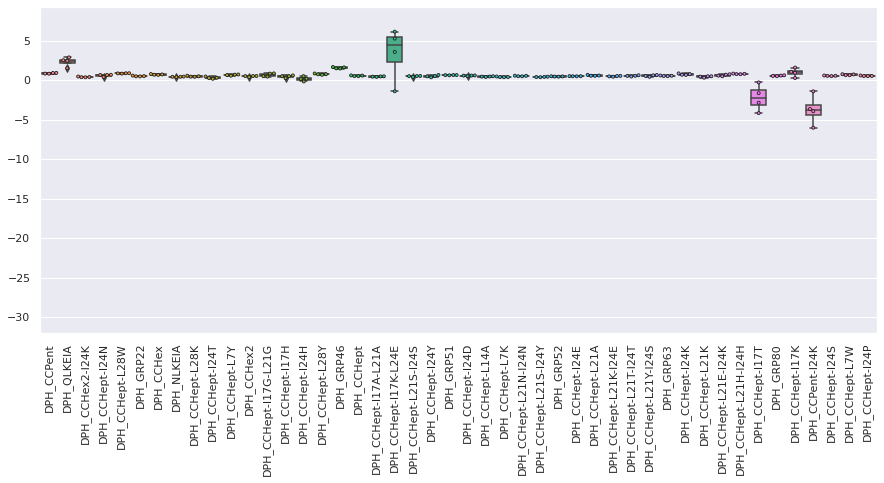

NASH_twentyeight


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


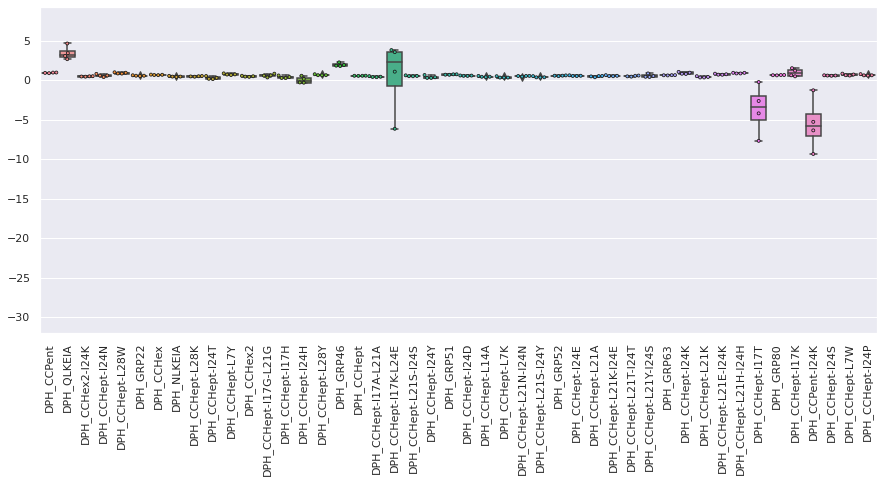

NASH_twentyfive


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


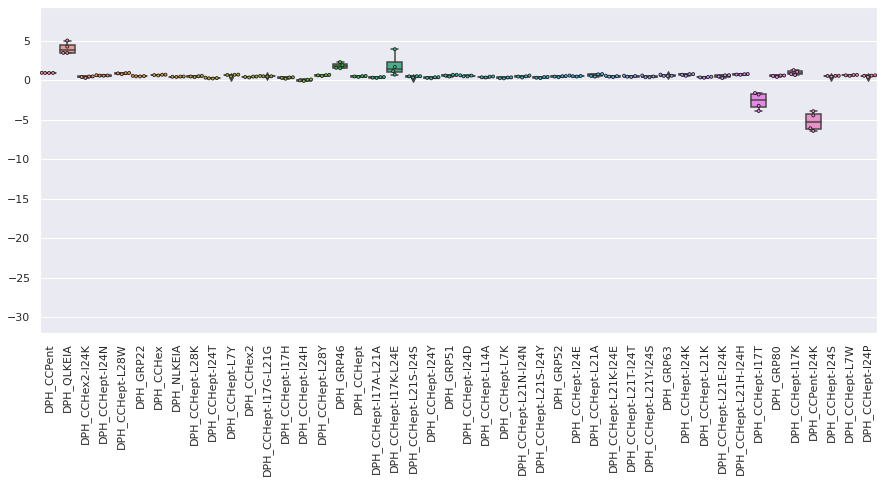

NASH_twentyfour


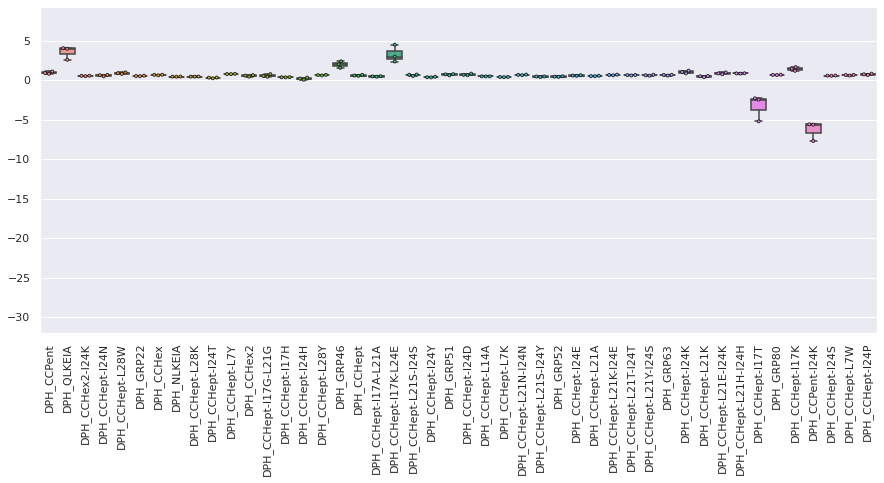

NASH_twentyone


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


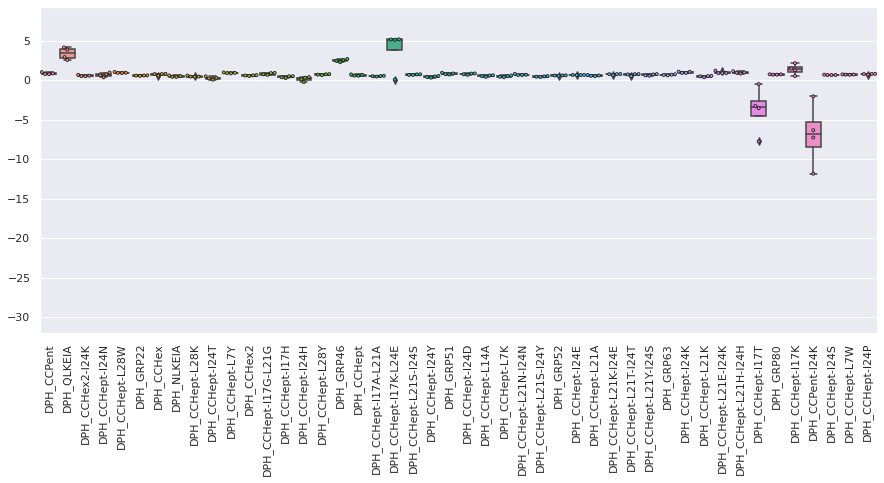

NASH_twentyseven


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


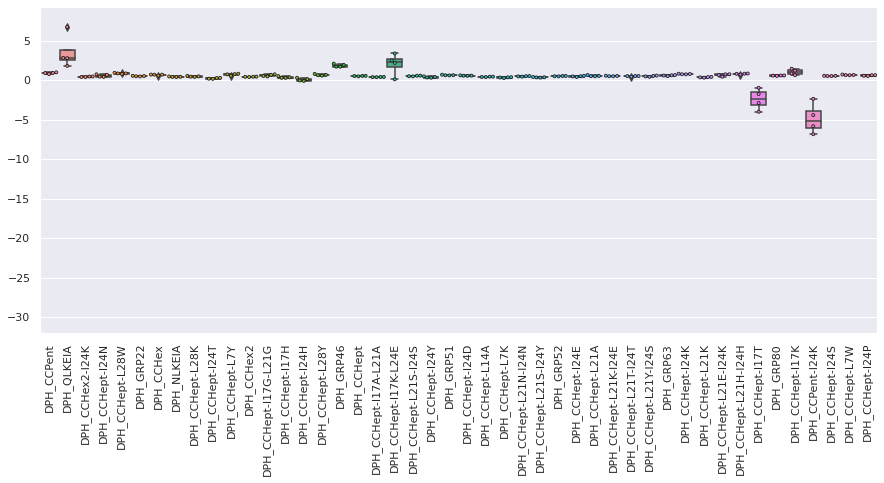

NASH_twentysix


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


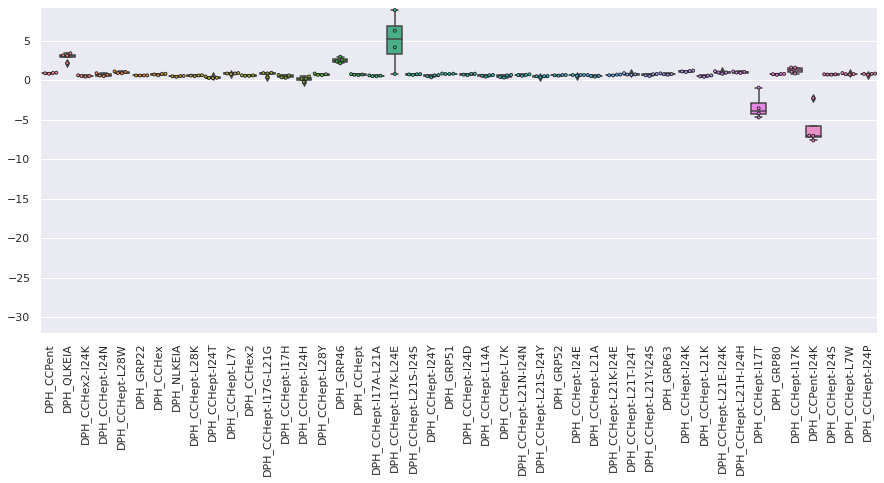

NASH_twentythree


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


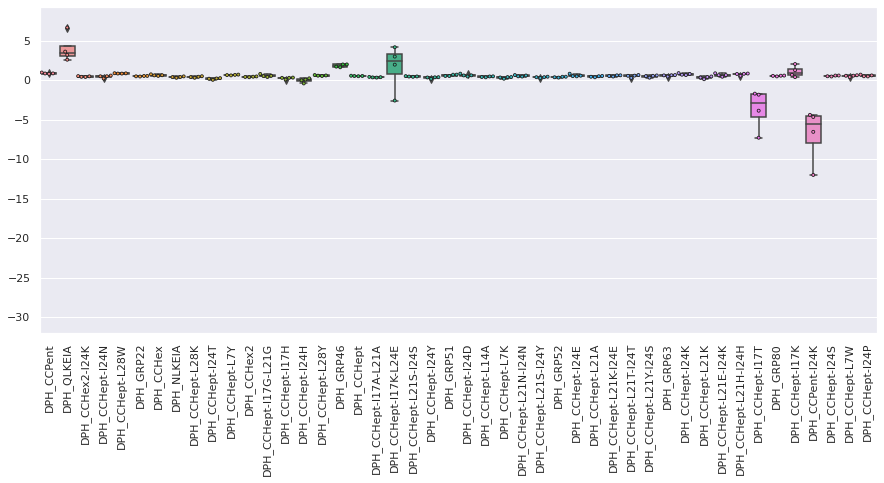

NASH_twentytwo


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


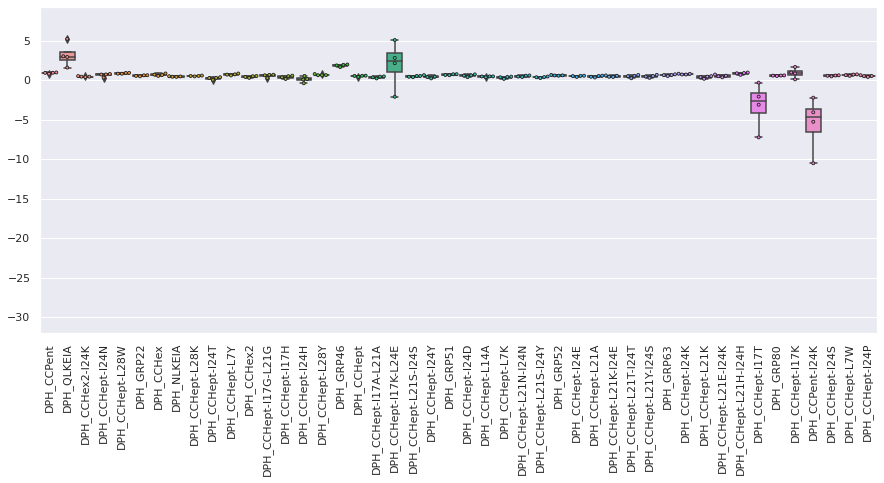

Normal_eight


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


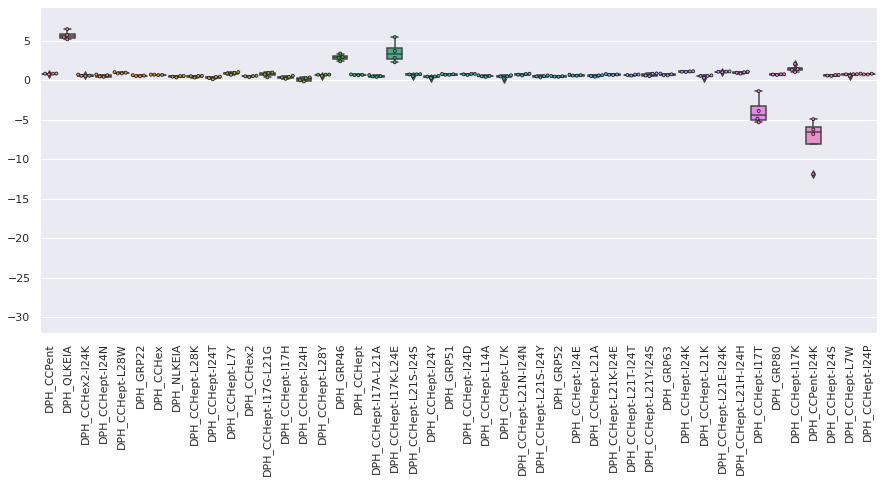

Normal_eleven


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


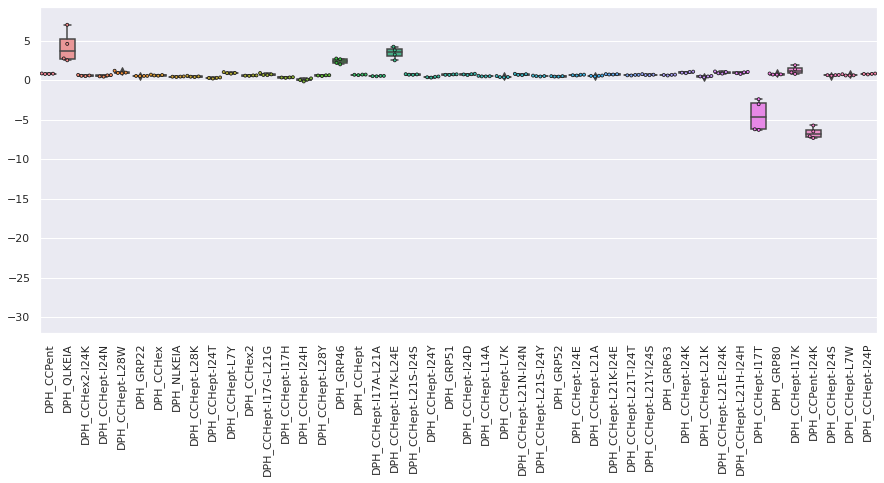

Normal_five


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


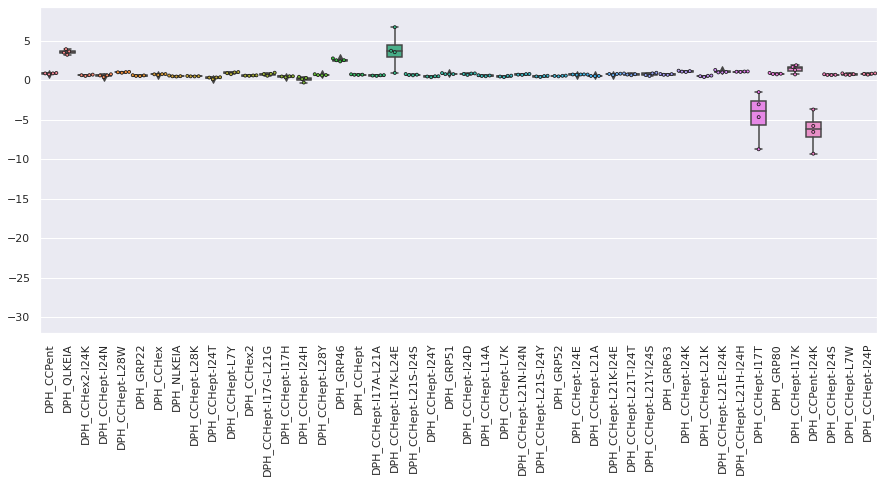

Normal_four


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


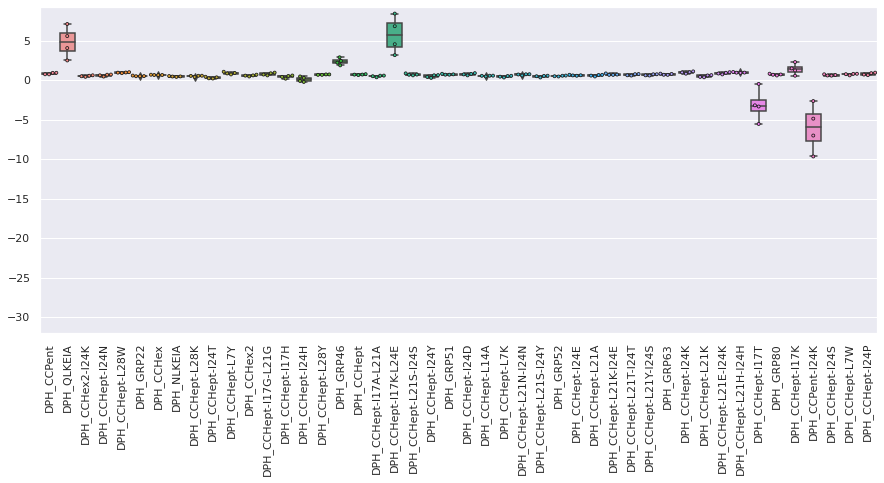

Normal_fourteen


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


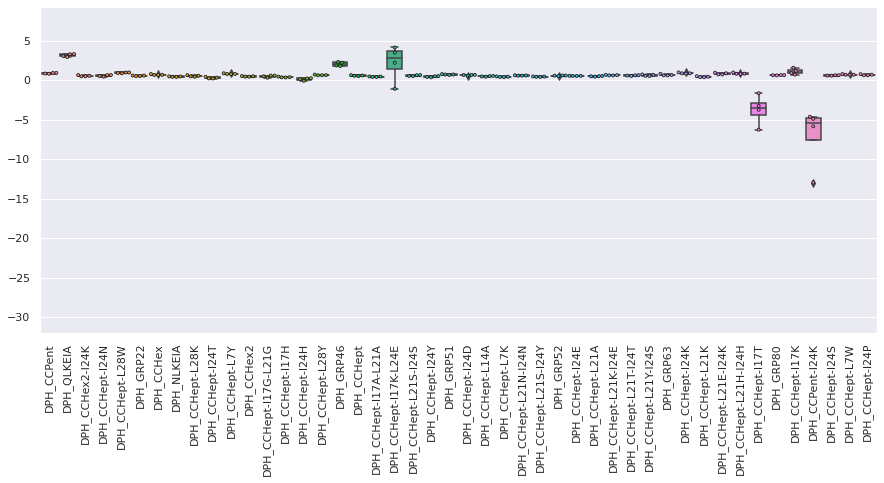

Normal_nine


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


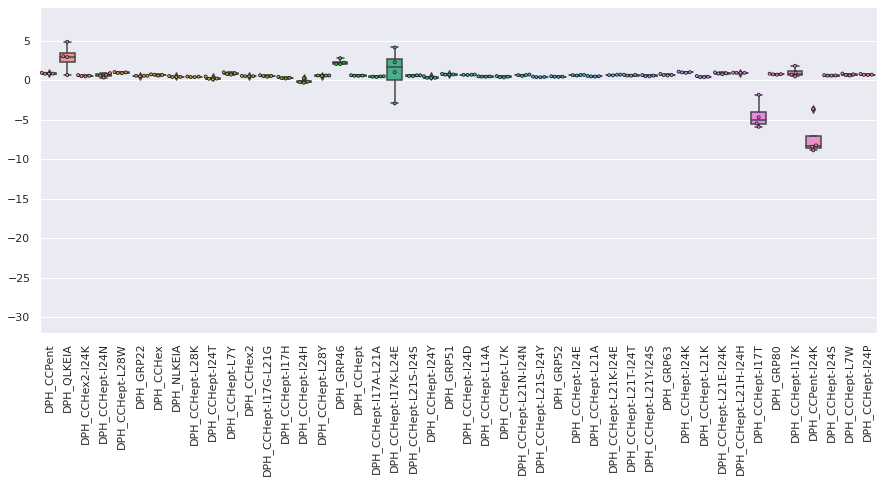

Normal_one


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


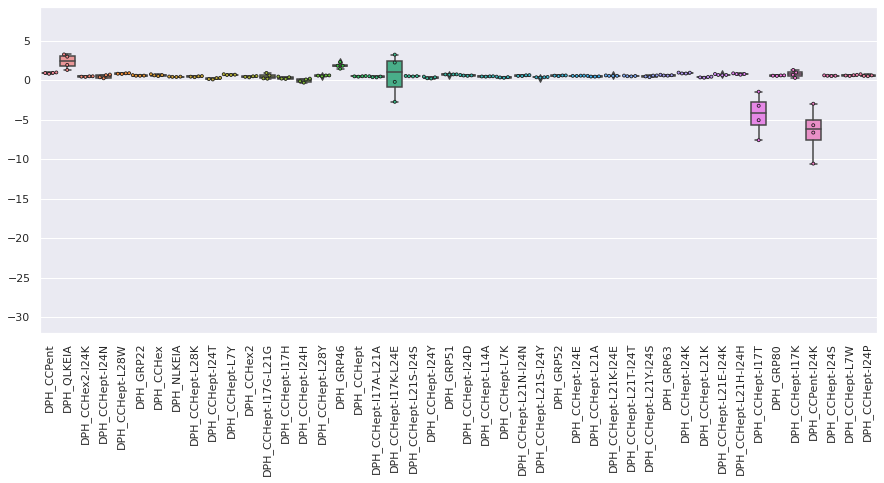

Normal_seven


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


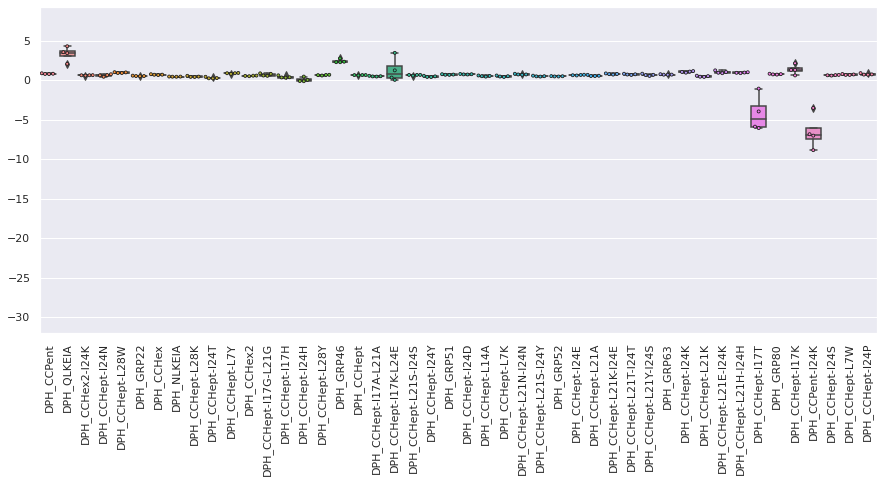

Normal_six


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


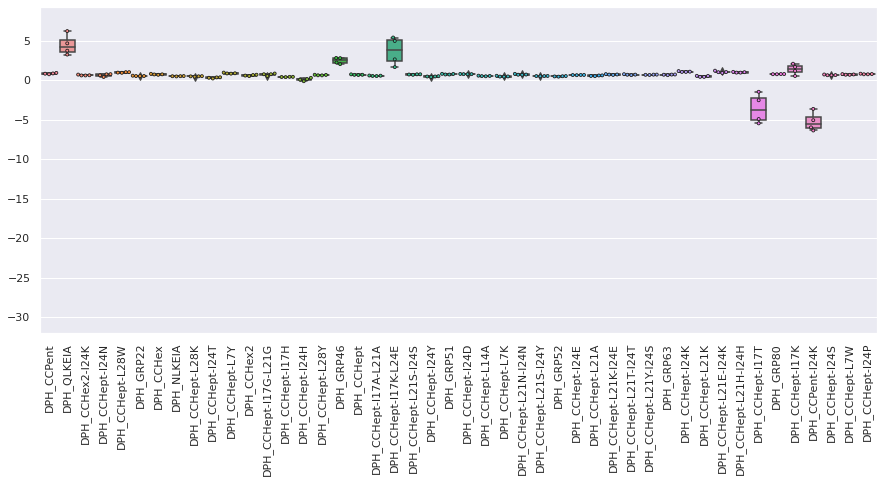

Normal_ten


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


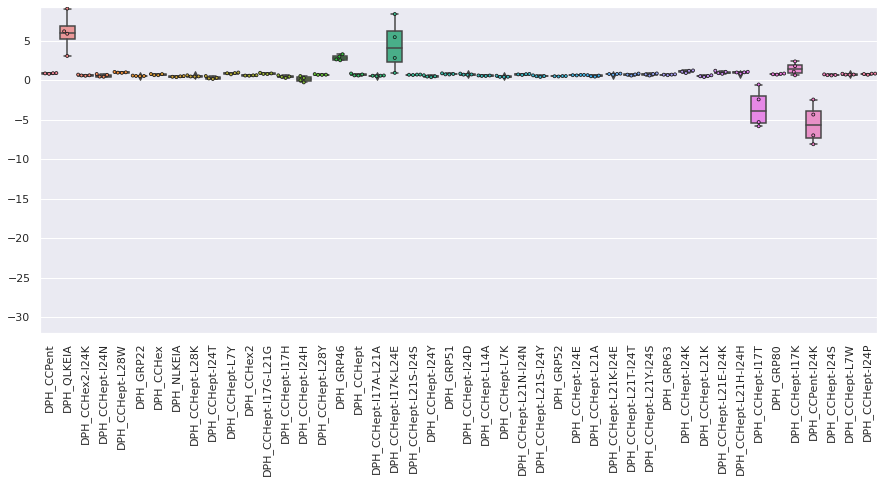

Normal_thirteen


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


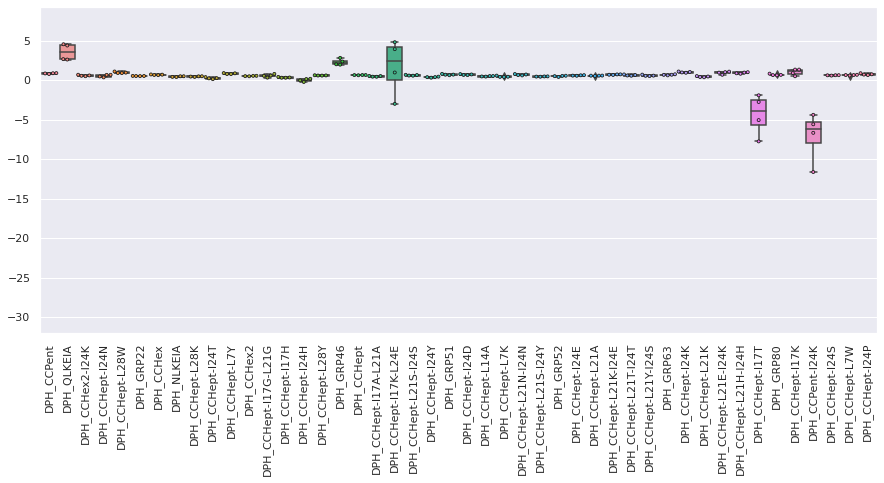

Normal_three


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


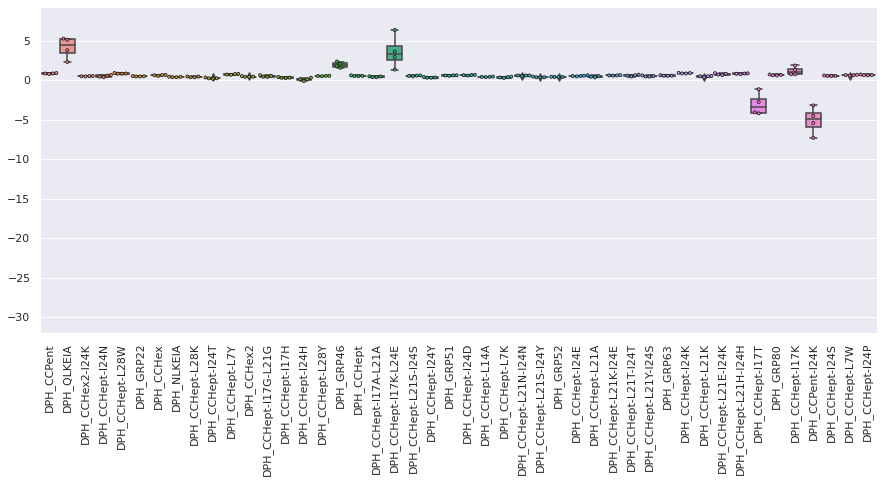

Normal_twelve


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


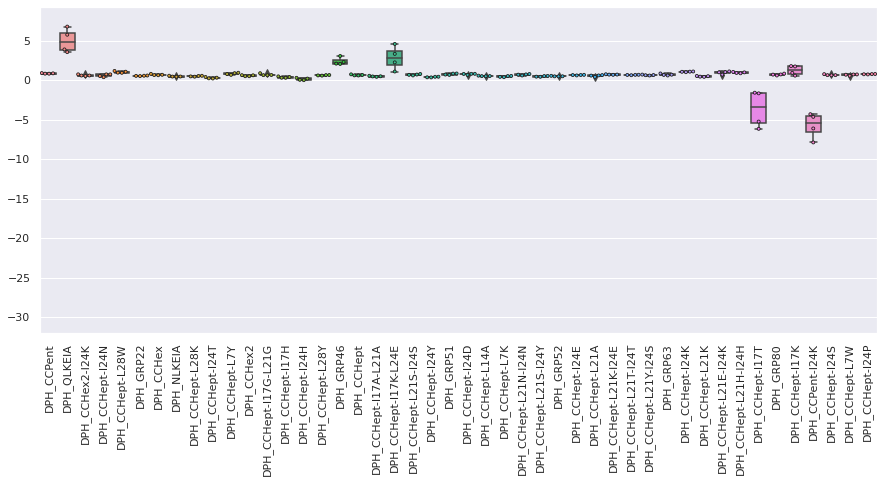

Normal_two


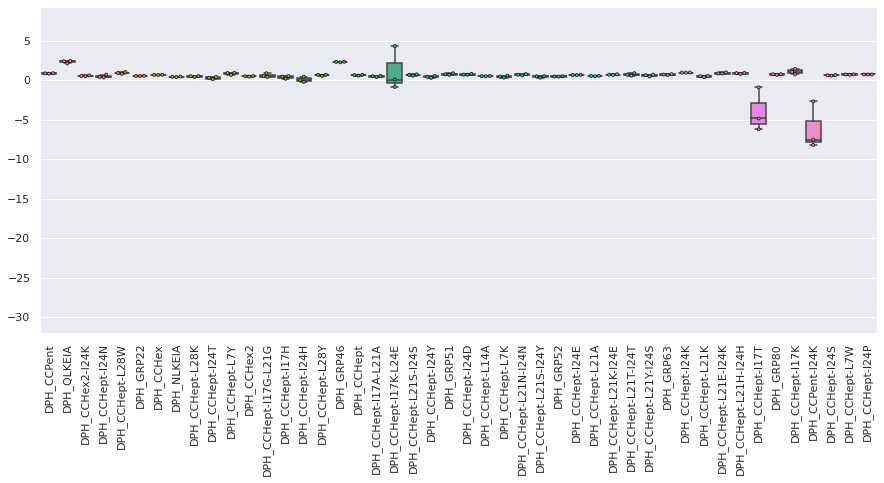




Scaled_data:



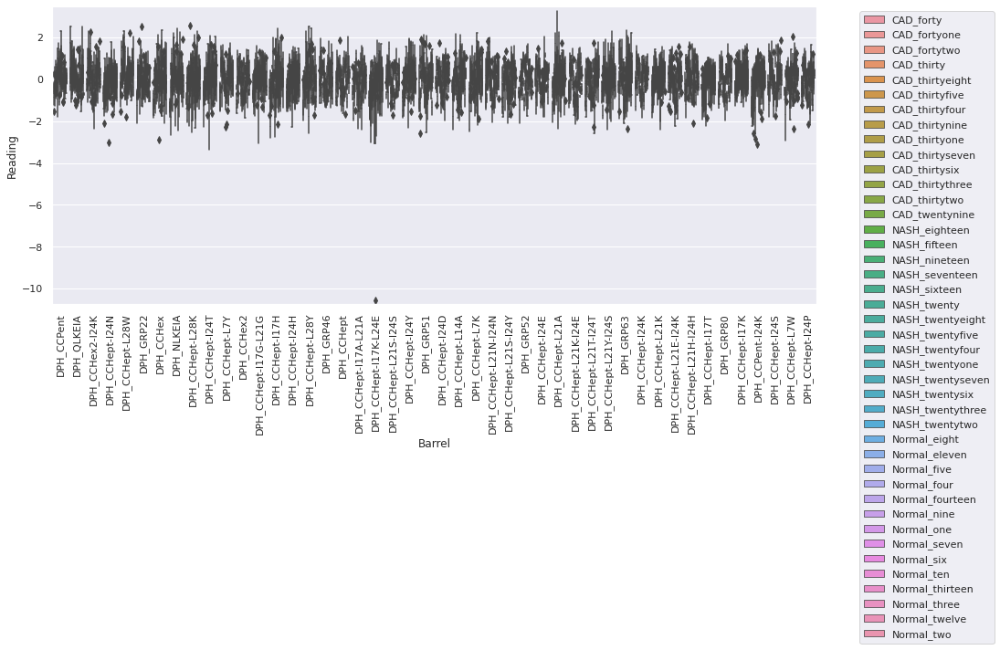

CAD_forty


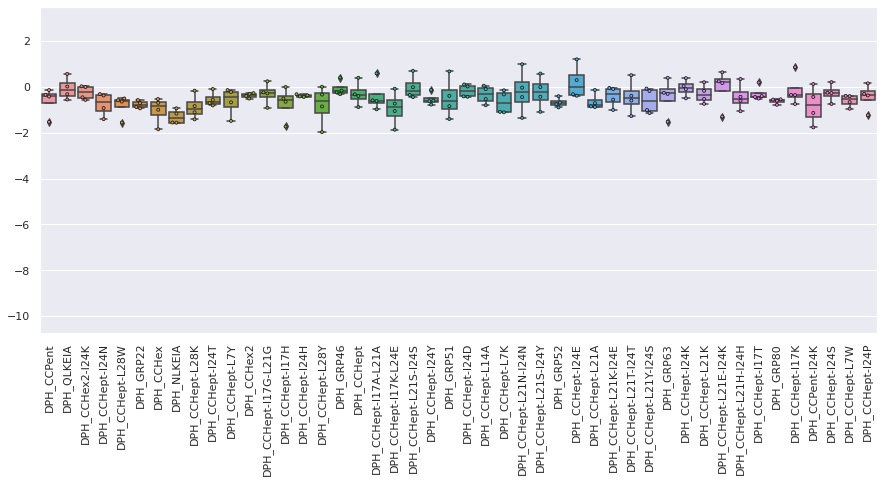

CAD_fortyone


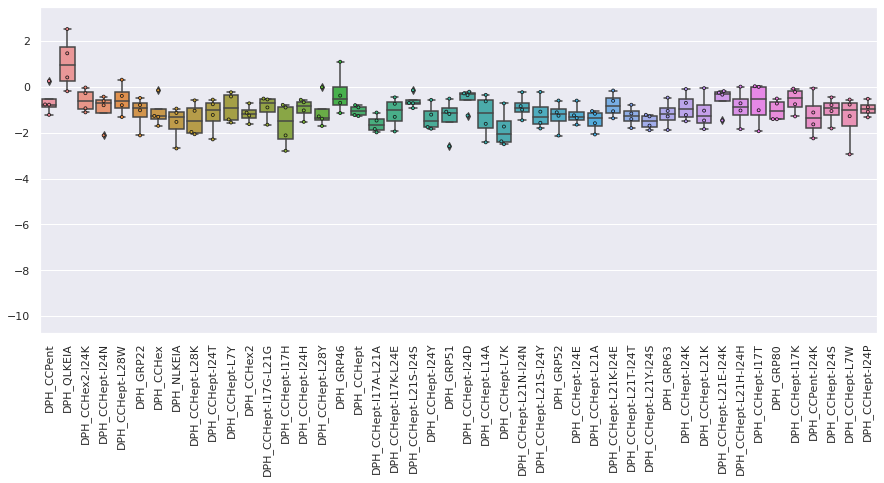

CAD_fortytwo


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


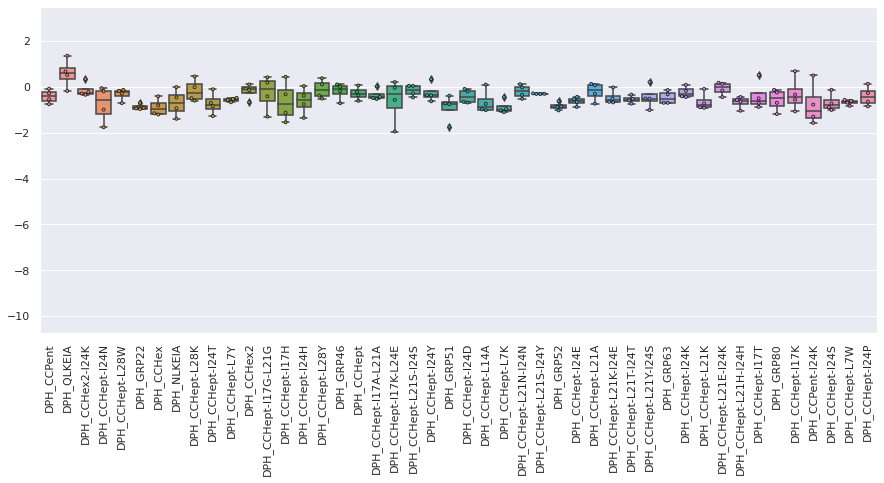

CAD_thirty


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


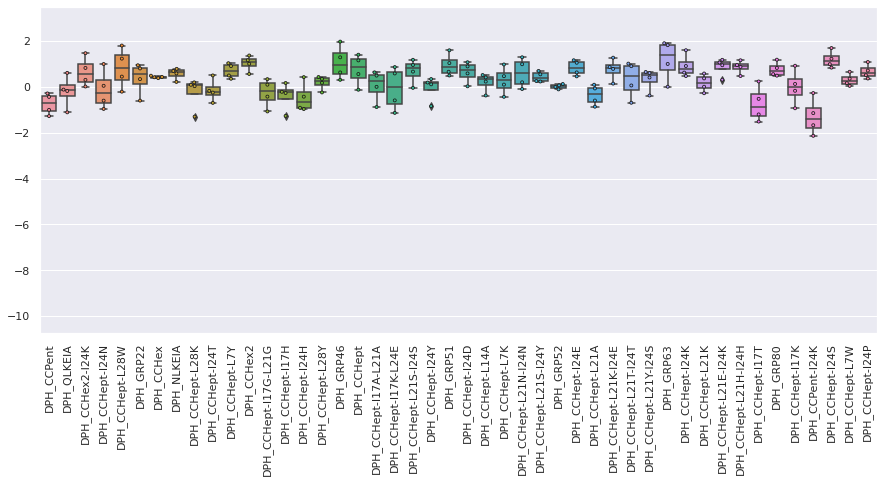

CAD_thirtyeight


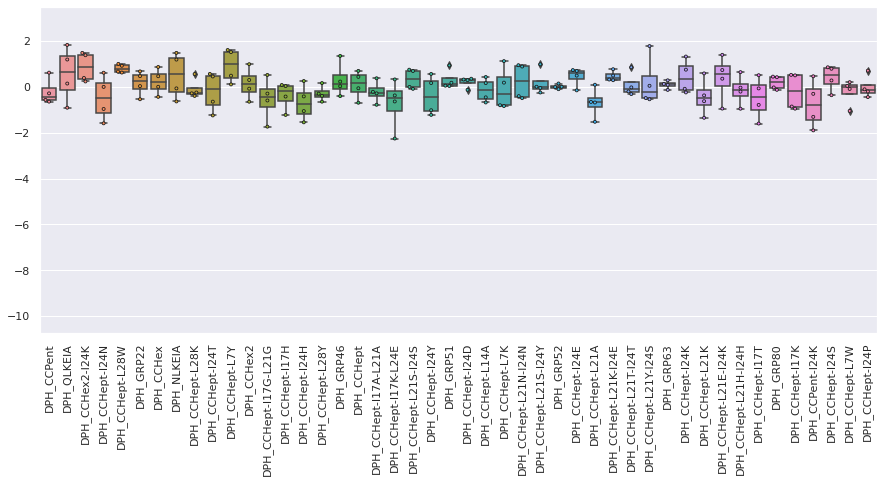

CAD_thirtyfive


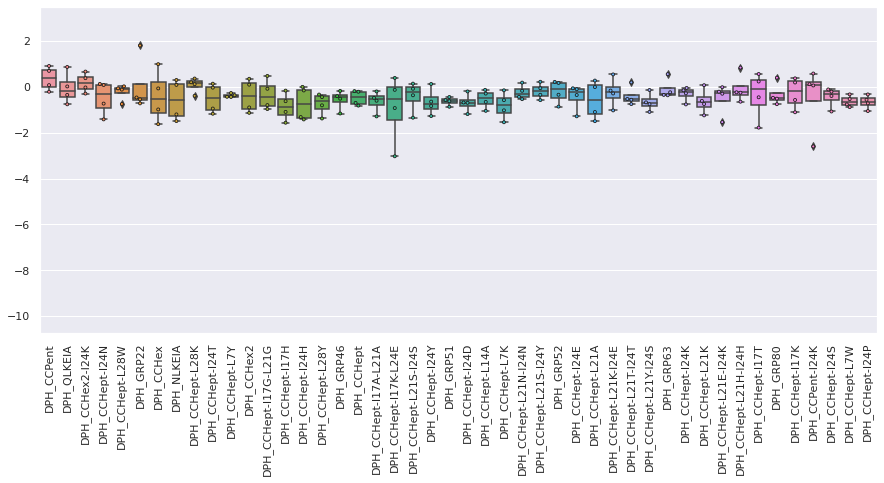

CAD_thirtyfour


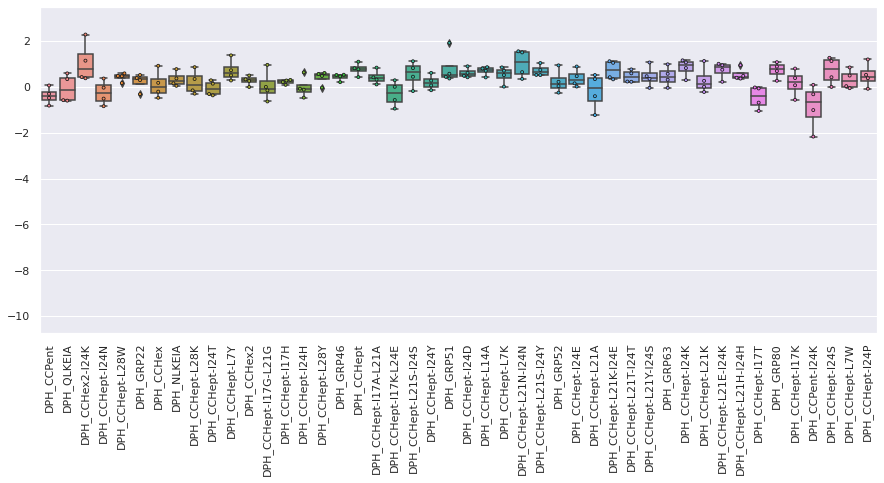

CAD_thirtynine


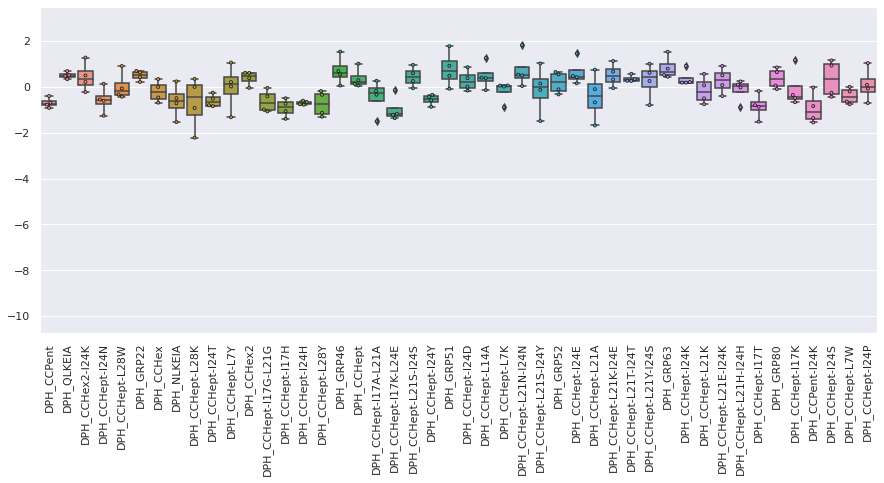

CAD_thirtyone


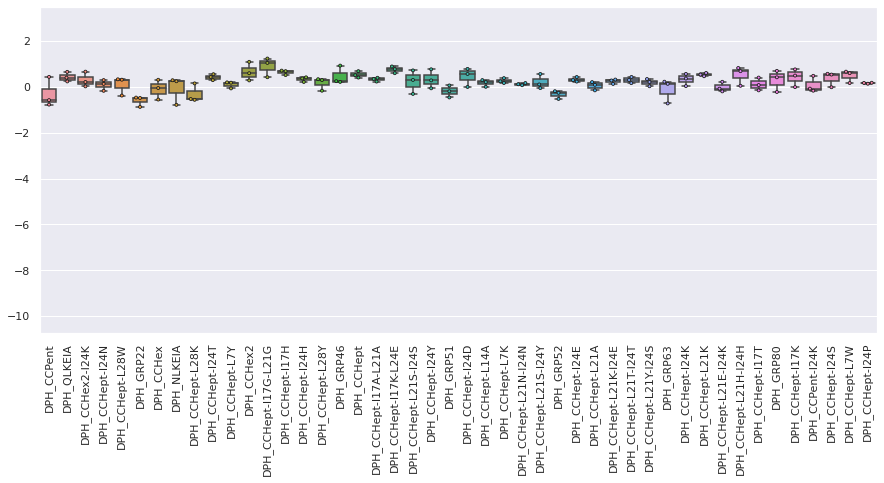

CAD_thirtyseven


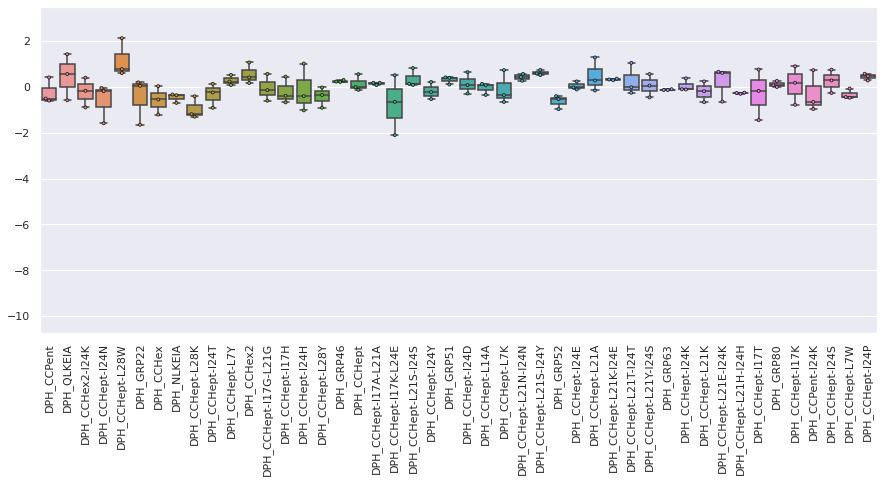

CAD_thirtysix


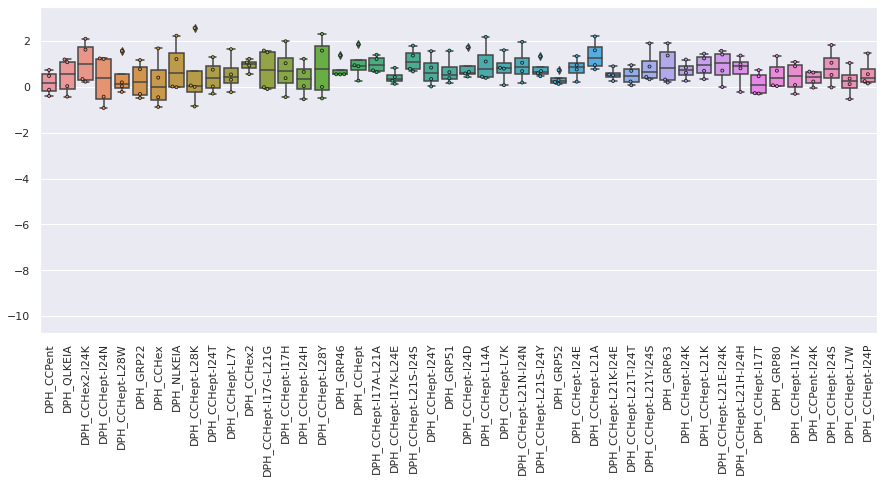

CAD_thirtythree


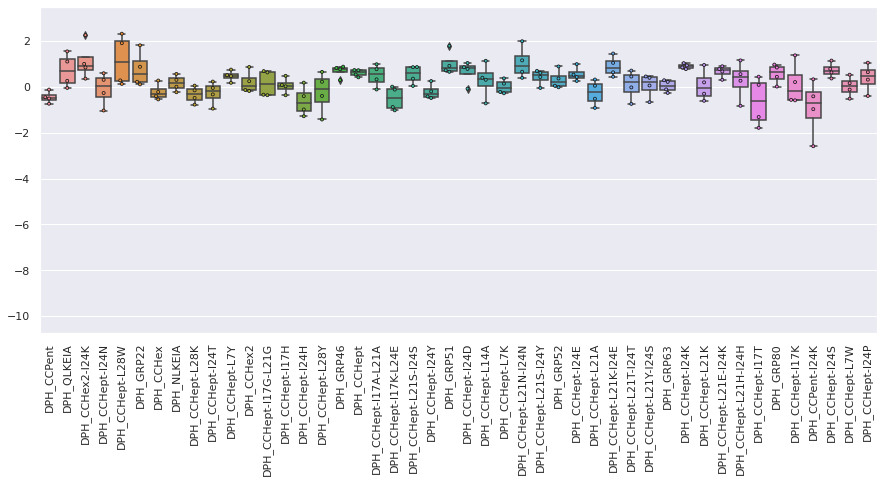

CAD_thirtytwo


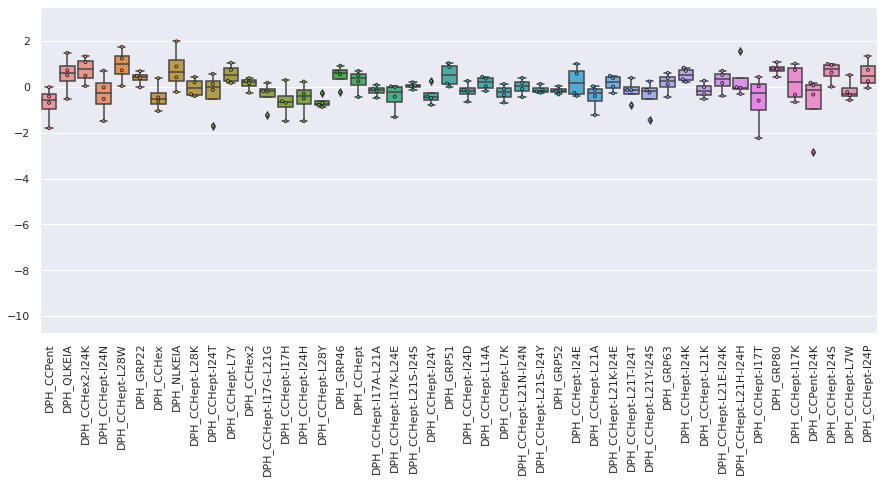

CAD_twentynine


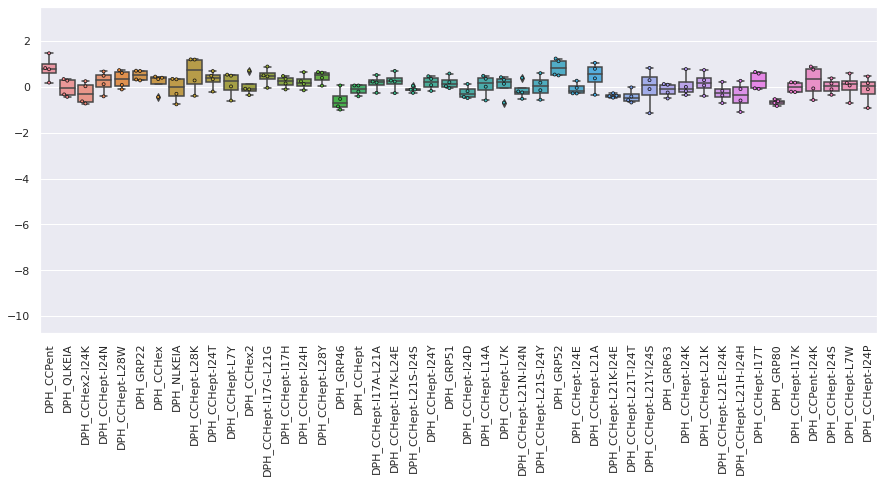

NASH_eighteen


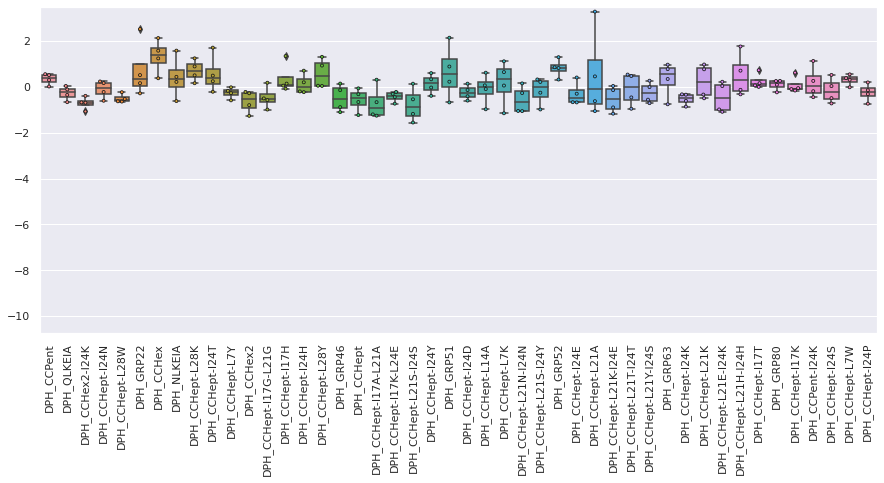

NASH_fifteen


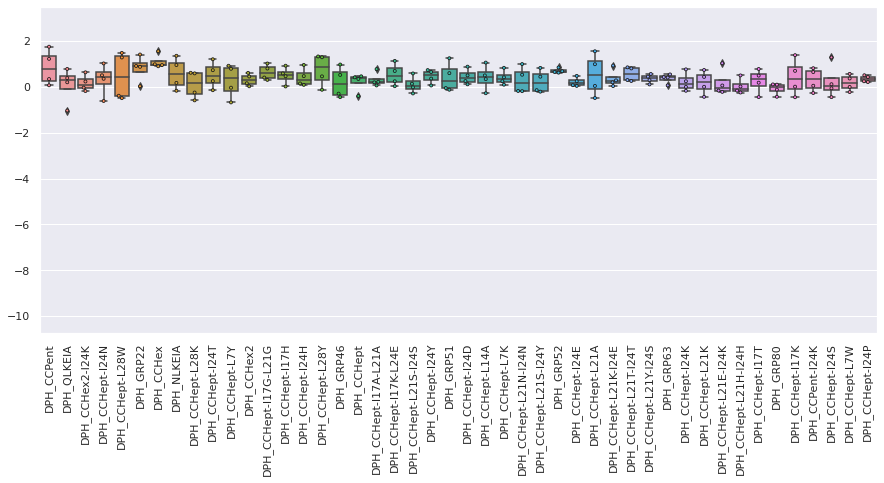

NASH_nineteen


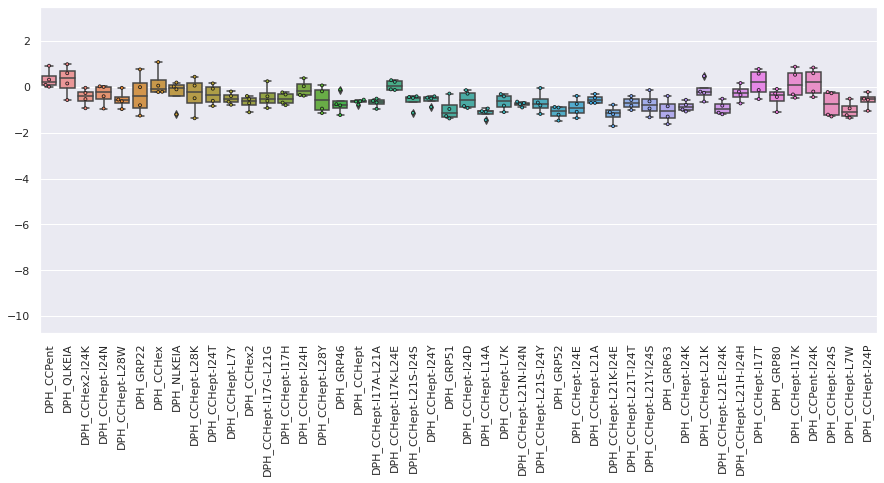

NASH_seventeen


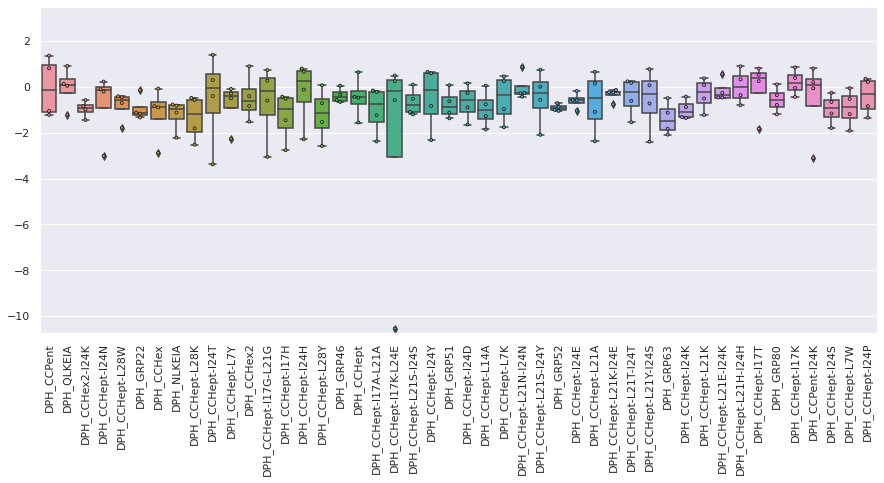

NASH_sixteen


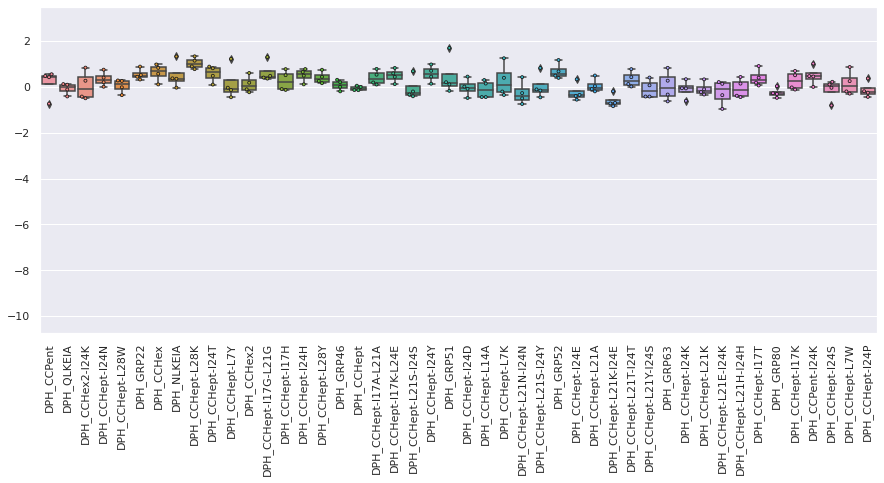

NASH_twenty


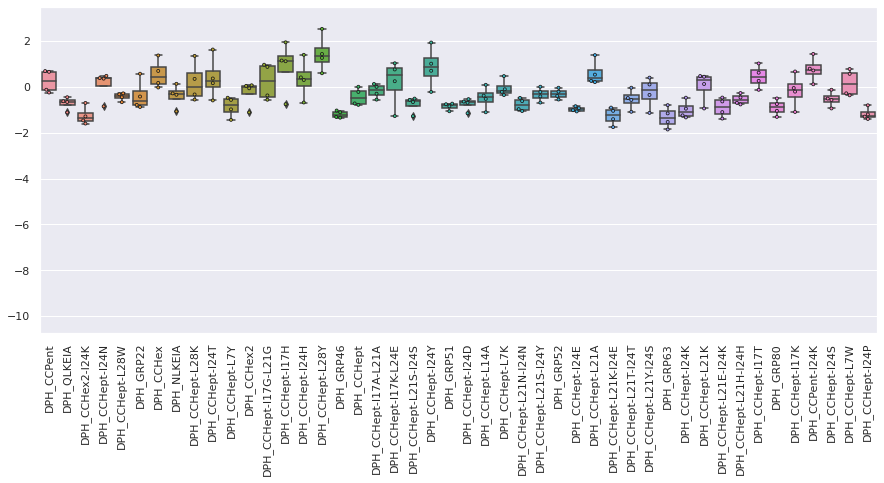

NASH_twentyeight


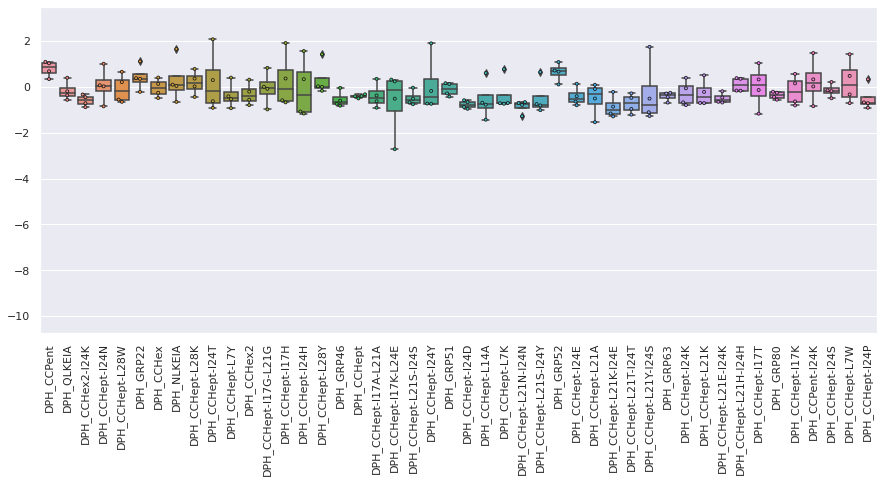

NASH_twentyfive


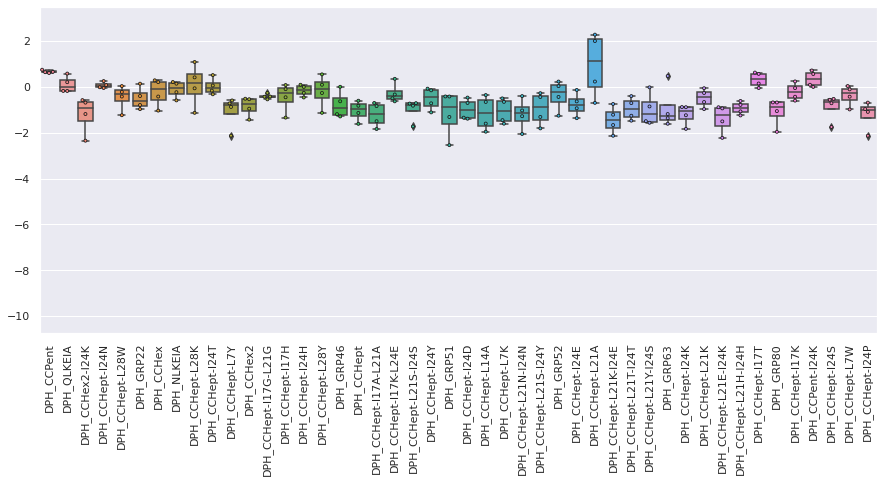

NASH_twentyfour


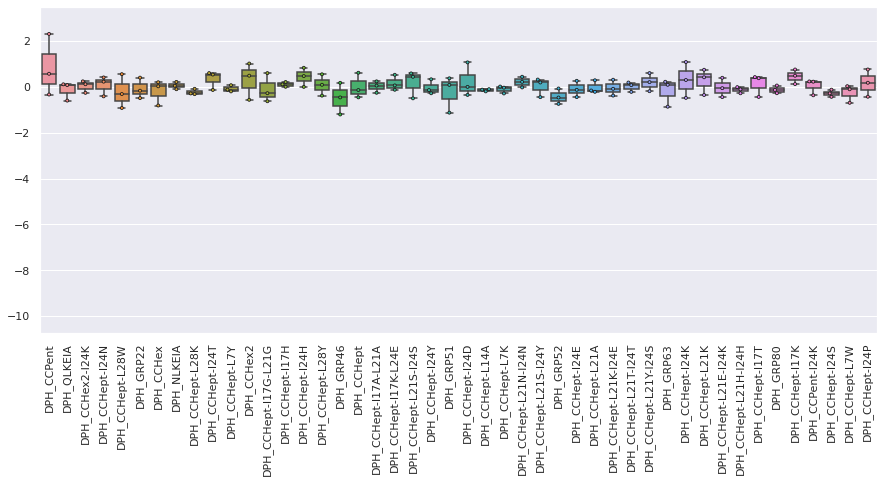

NASH_twentyone


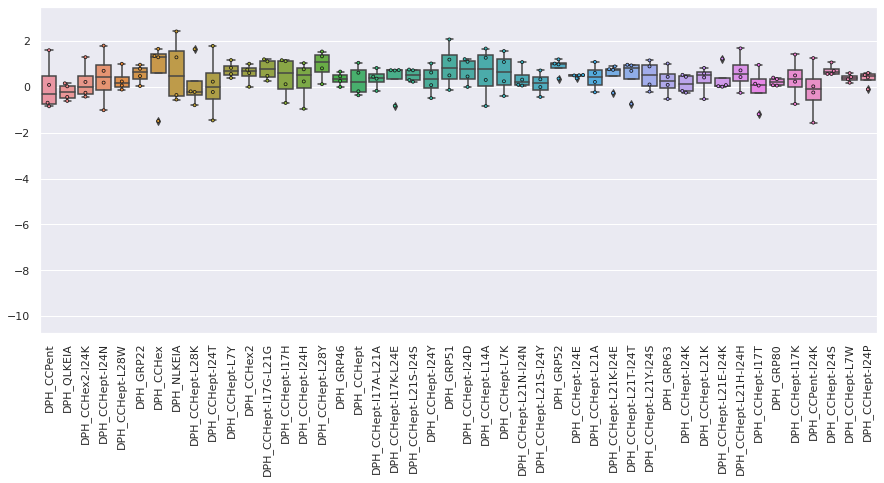

NASH_twentyseven


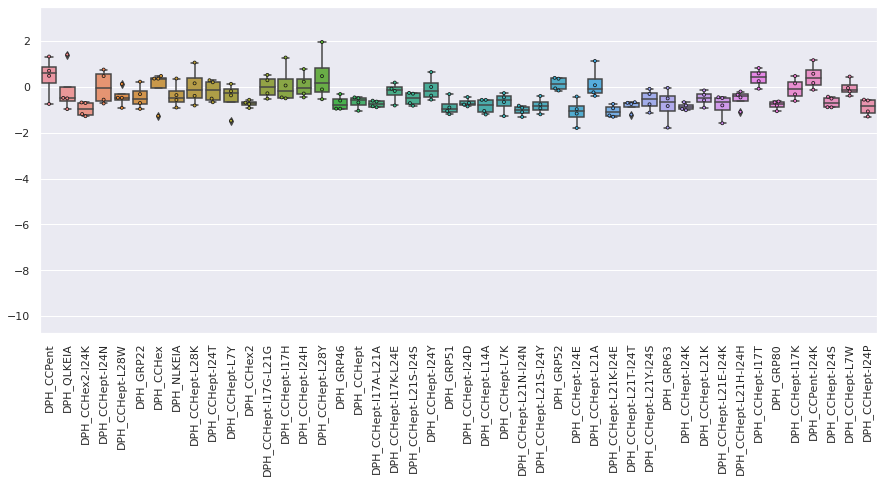

NASH_twentysix


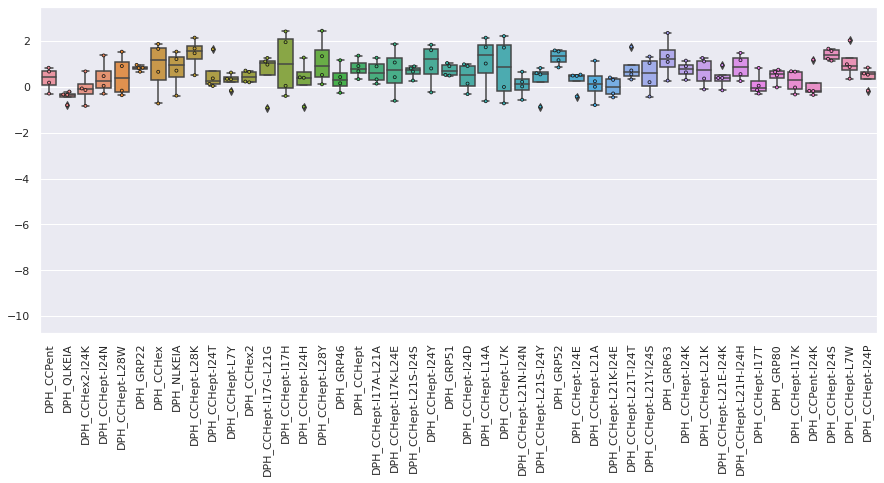

NASH_twentythree


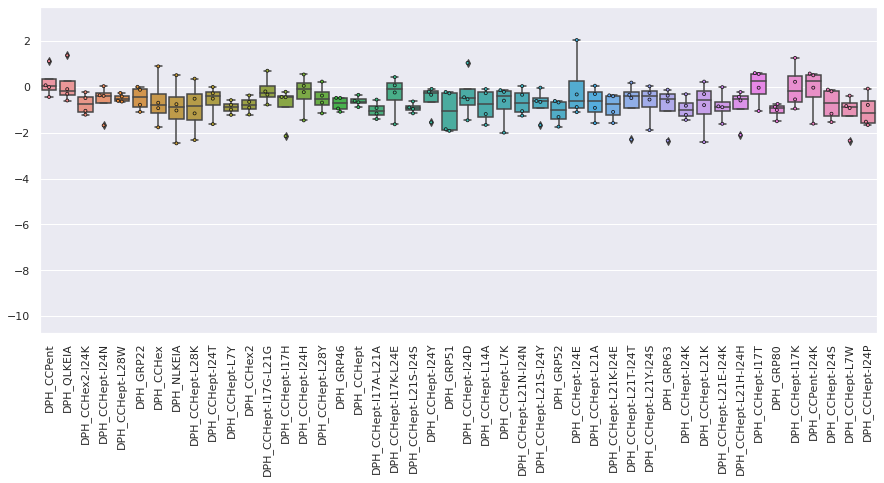

NASH_twentytwo


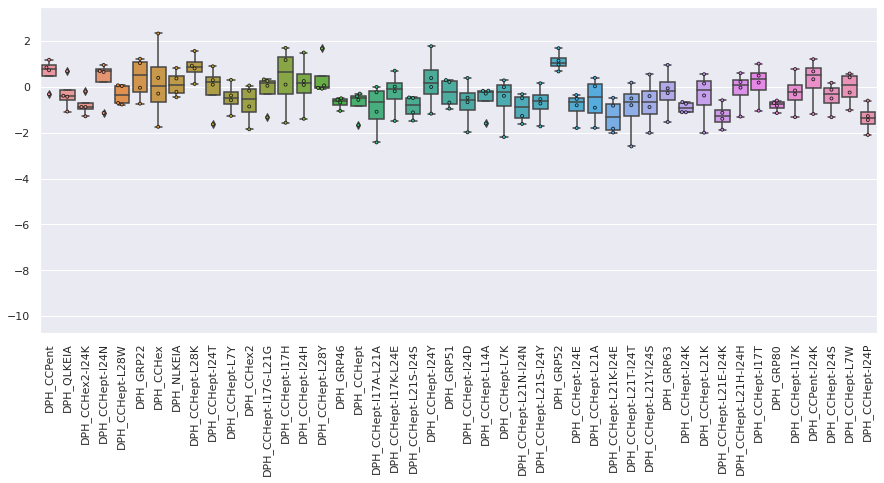

Normal_eight


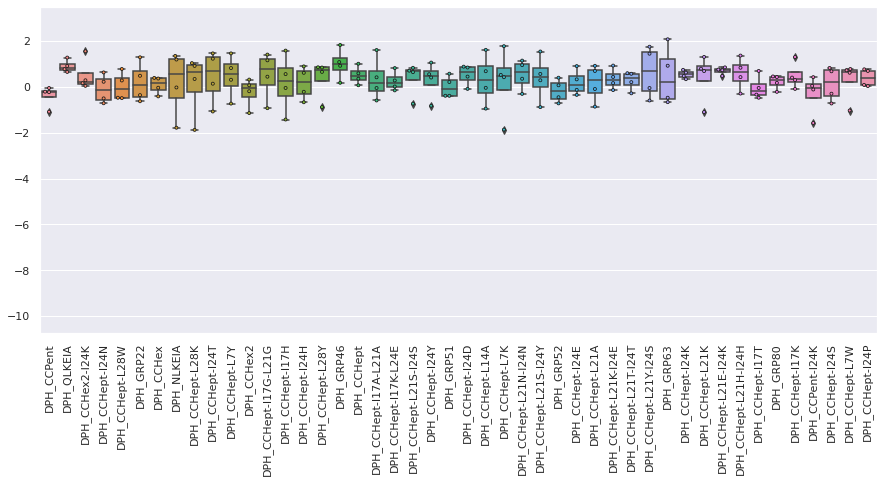

Normal_eleven


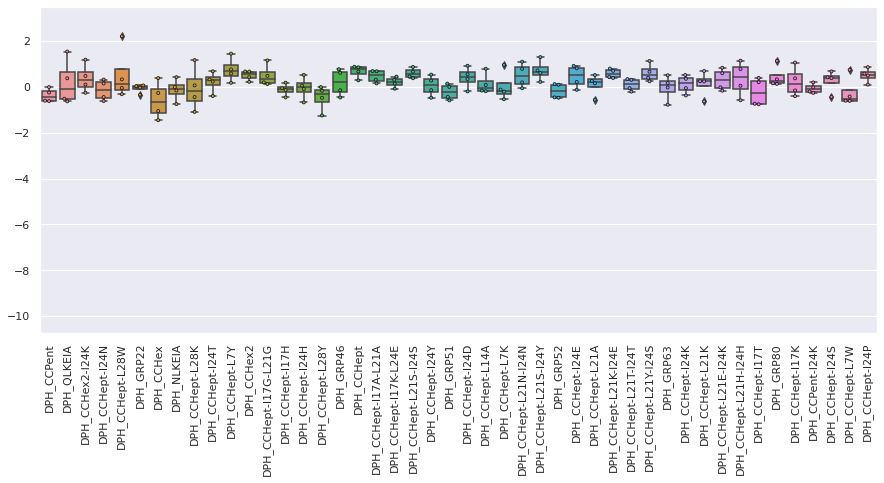

Normal_five


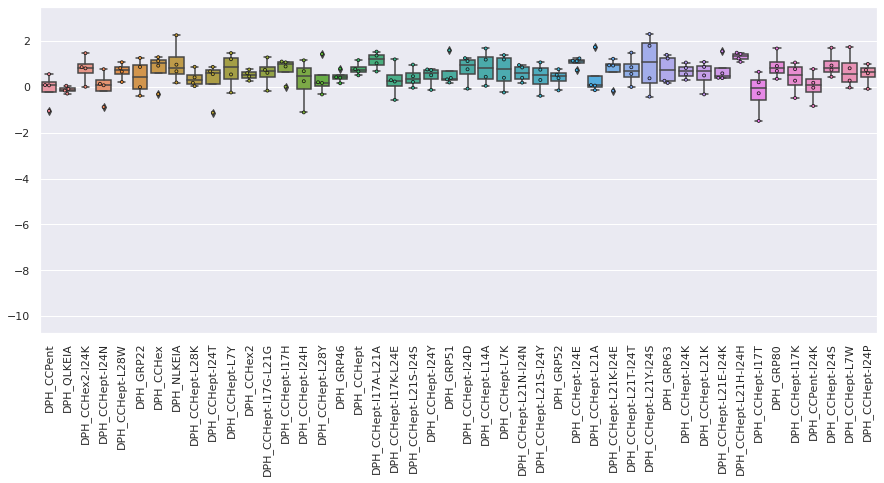

Normal_four


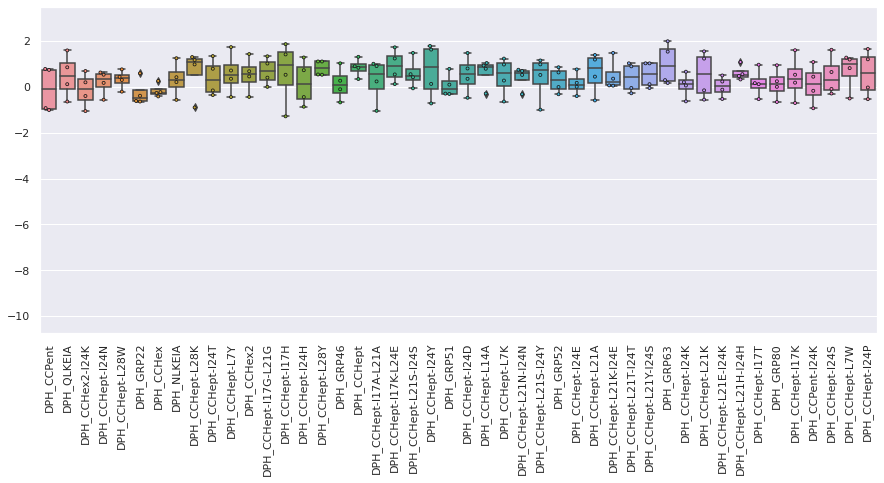

Normal_fourteen


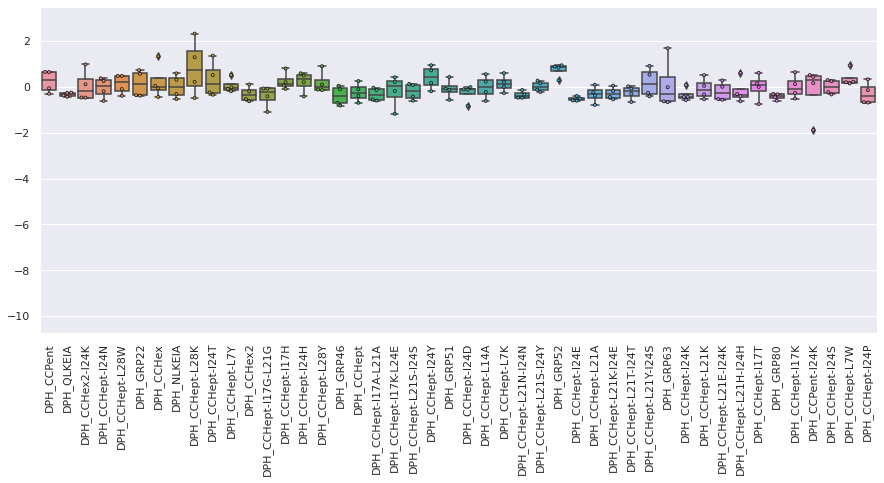

Normal_nine


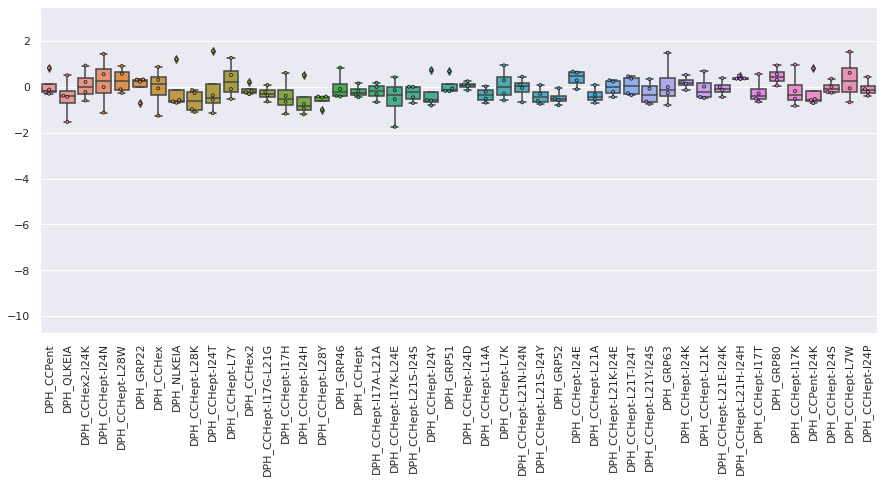

Normal_one


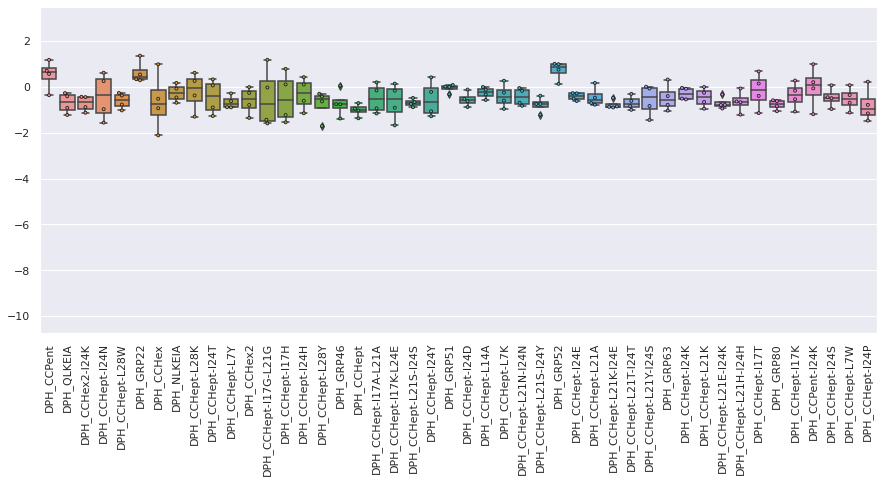

Normal_seven


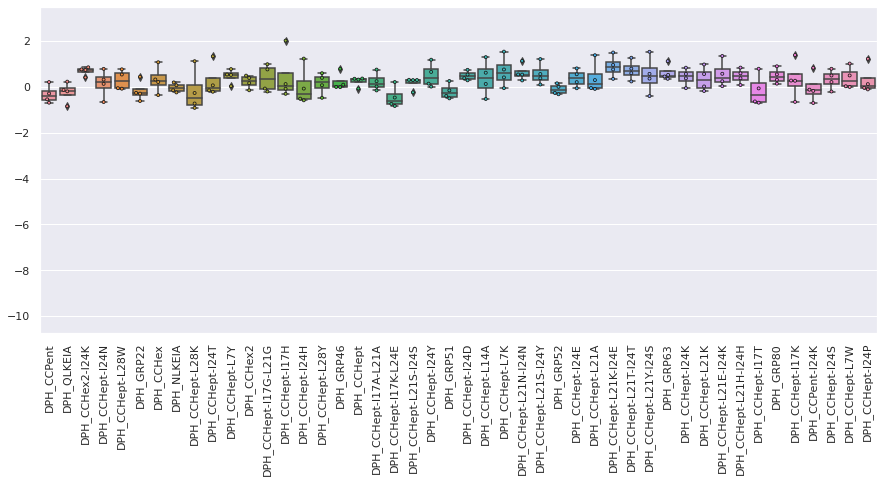

Normal_six


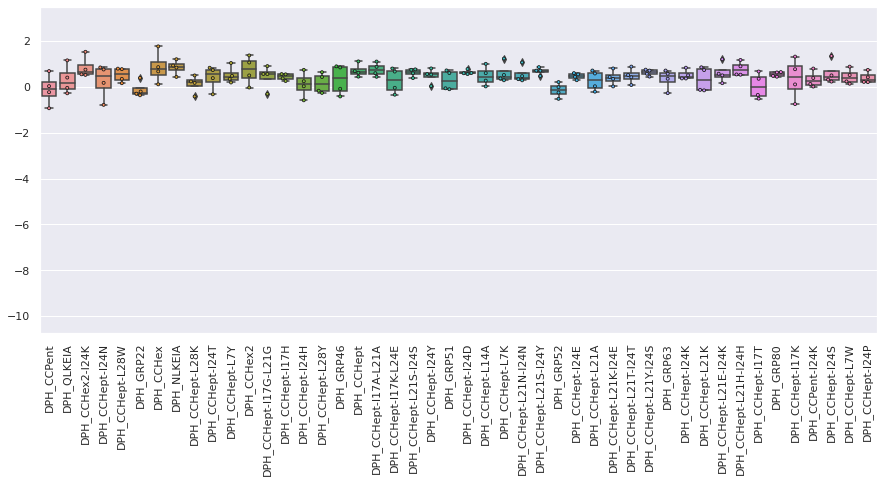

Normal_ten


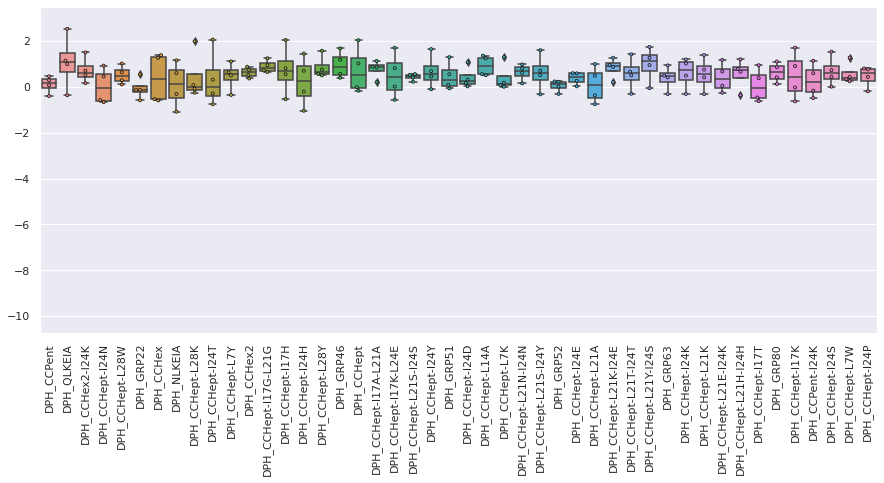

Normal_thirteen


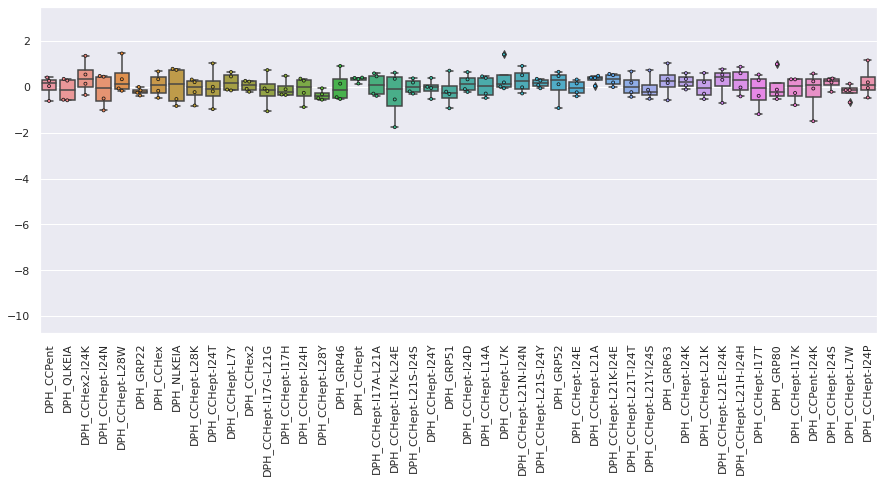

Normal_three


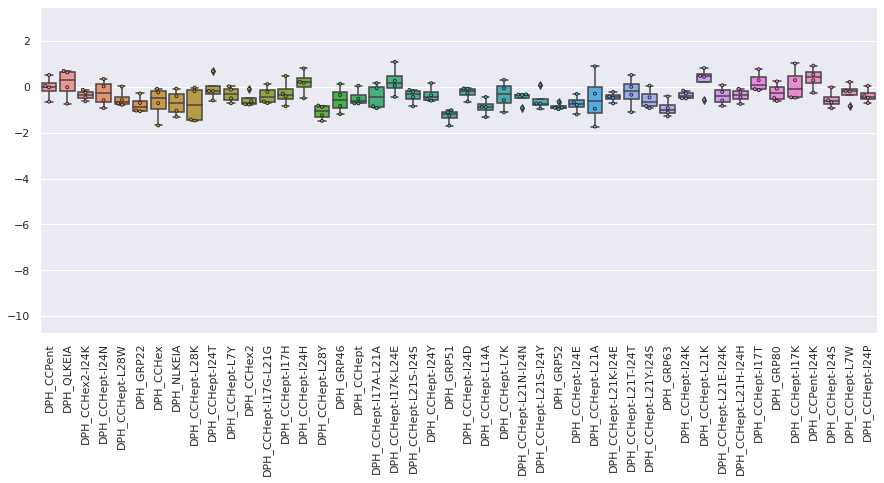

Normal_twelve


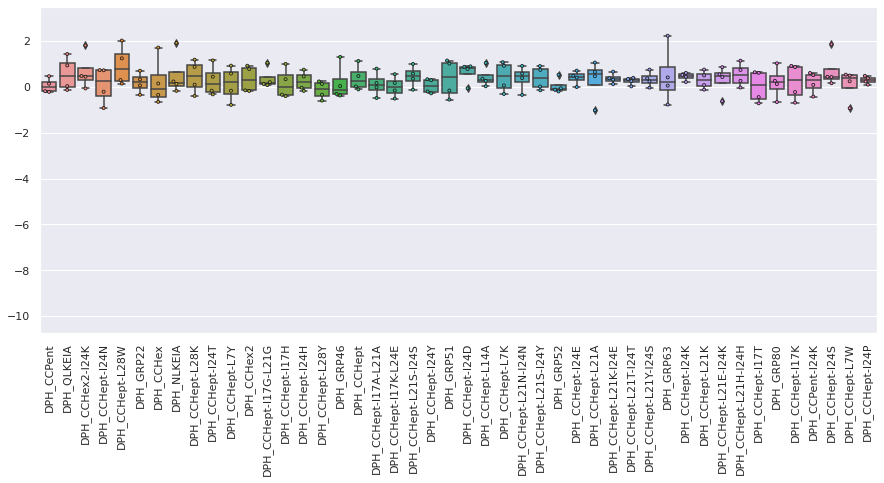

Normal_two


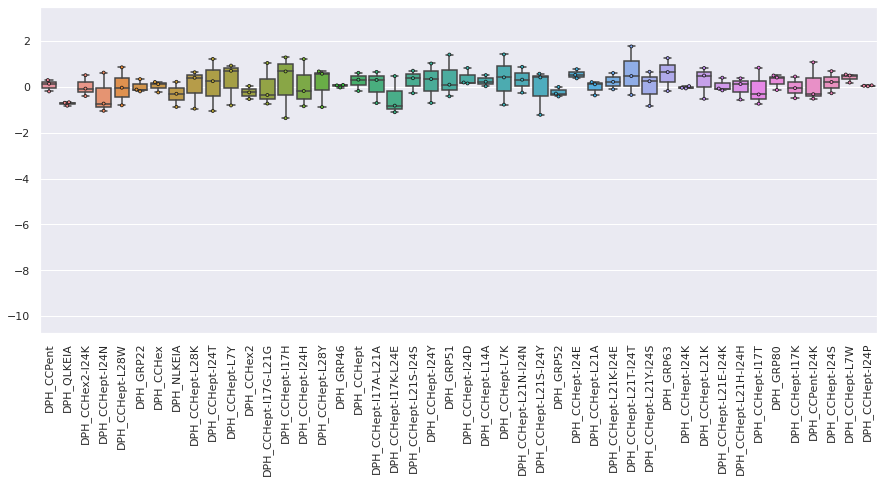

In [8]:
plot_dir = ('/home/ks17361/ML_environment/BADASS/NASH_serum_analysis/NASH_3_classes_split_patient/'
            'NASH_indv_patients')
if os.path.isdir(plot_dir):
    shutil.rmtree(plot_dir)
os.mkdir(plot_dir)

nash_fluor_data.display_data_distribution(prefix='NASH_indv_patients', results_dir=plot_dir)

- As expected from the scatter plots above, the ranges of (unscaled) readings obtained are particularly large for those peptides that have little effect upon DPH fluorescence. It is very difficult from these plots however to see whether this translates into a noticeably (by eye) greater overlap between the ranges of readings measured for the different classes or not - this should be clearer in the per-class box plots below (as opposed to the per-subclass plots above).
- By eye I can't see any class-wide differences between the heatmap fingerprints of the subclasses. ML will hopefully do a better job of distinguishing differences!

In [9]:
orig_ml_fluor_data = copy.deepcopy(nash_fluor_data.ml_fluor_data)

In [10]:
orig_ml_fluor_data

,DPH_CCPent,DPH_QLKEIA,DPH_CCHex2-I24K,DPH_CCHept-I24N,DPH_CCHept-L28W,DPH_GRP22,DPH_CCHex,DPH_NLKEIA,DPH_CCHept-L28K,DPH_CCHept-I24T,...,DPH_CCHept-L21E-I24K,DPH_CCHept-L21H-I24H,DPH_CCHept-I17T,DPH_GRP80,DPH_CCHept-I17K,DPH_CCPent-I24K,DPH_CCHept-I24S,DPH_CCHept-L7W,DPH_CCHept-I24P,Analyte
0,0.829795,3.159468,0.487767,0.506456,0.716915,0.473700,0.532665,0.377288,0.389528,0.160984,...,0.519465,0.710749,-3.092784,0.609407,1.734876,-7.936416,0.532562,0.616832,0.533356,CAD_forty
1,0.798991,2.678947,0.475506,0.493627,0.839228,0.489300,0.596359,0.353584,0.457271,0.178453,...,1.044257,0.806461,-5.456198,0.576462,0.822884,-10.372434,0.575269,0.618227,0.667729,CAD_forty
2,0.807161,3.850318,0.536888,0.374244,0.832106,0.499089,0.618798,0.354047,0.367458,0.147939,...,0.937855,0.779477,-5.095153,0.600997,0.828042,-12.559524,0.574244,0.554462,0.657705,CAD_forty
3,0.677463,4.988372,0.540267,0.269246,0.848924,0.477985,0.631185,0.391186,0.408939,0.240946,...,0.916862,0.924777,-5.231423,0.608025,0.530000,-5.980952,0.615919,0.587127,0.733533,CAD_forty
4,0.873424,6.846512,0.416031,0.482579,0.747166,0.391089,0.576286,0.286431,0.320772,0.093697,...,0.472091,0.591342,-3.643341,0.488976,0.921888,-10.302663,0.438752,0.327586,0.520070,CAD_fortyone
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
159,0.821200,5.755459,0.589244,0.529428,0.930835,0.515272,0.622096,0.454656,0.476029,0.210742,...,0.988203,0.912486,-5.243421,0.828979,0.573678,-6.114350,0.635562,0.557078,0.725785,Normal_twelve
160,0.896548,3.547771,0.734981,0.374457,1.167070,0.561958,0.681881,0.461179,0.554476,0.231459,...,1.105382,1.046794,-6.161446,0.702497,0.921020,-7.883721,0.760665,0.719098,0.781201,Normal_twelve
161,0.877848,2.430464,0.529176,0.710740,1.020066,0.531024,0.686900,0.460314,0.514990,0.411868,...,0.851473,0.929234,-0.915709,0.754863,1.428702,-2.695479,0.573504,0.724223,0.721188,Normal_two
162,0.823427,2.385892,0.493852,0.348596,0.811254,0.562971,0.679888,0.394755,0.400883,0.116464,...,0.829667,0.788279,-4.853242,0.666496,1.049727,-8.207865,0.616494,0.684190,0.718567,Normal_two


In [11]:
nash_fluor_data.ml_fluor_data['Sub_analyte'] = copy.deepcopy(
    nash_fluor_data.ml_fluor_data['Analyte'].tolist()
)
nash_fluor_data.ml_fluor_data['Analyte'] = [
    sub_analyte.split('_')[0] for sub_analyte in nash_fluor_data.ml_fluor_data['Sub_analyte'].tolist()
]

In [12]:
nash_fluor_data.ml_fluor_data

,DPH_CCPent,DPH_QLKEIA,DPH_CCHex2-I24K,DPH_CCHept-I24N,DPH_CCHept-L28W,DPH_GRP22,DPH_CCHex,DPH_NLKEIA,DPH_CCHept-L28K,DPH_CCHept-I24T,...,DPH_CCHept-L21H-I24H,DPH_CCHept-I17T,DPH_GRP80,DPH_CCHept-I17K,DPH_CCPent-I24K,DPH_CCHept-I24S,DPH_CCHept-L7W,DPH_CCHept-I24P,Analyte,Sub_analyte
0,0.829795,3.159468,0.487767,0.506456,0.716915,0.473700,0.532665,0.377288,0.389528,0.160984,...,0.710749,-3.092784,0.609407,1.734876,-7.936416,0.532562,0.616832,0.533356,CAD,CAD_forty
1,0.798991,2.678947,0.475506,0.493627,0.839228,0.489300,0.596359,0.353584,0.457271,0.178453,...,0.806461,-5.456198,0.576462,0.822884,-10.372434,0.575269,0.618227,0.667729,CAD,CAD_forty
2,0.807161,3.850318,0.536888,0.374244,0.832106,0.499089,0.618798,0.354047,0.367458,0.147939,...,0.779477,-5.095153,0.600997,0.828042,-12.559524,0.574244,0.554462,0.657705,CAD,CAD_forty
3,0.677463,4.988372,0.540267,0.269246,0.848924,0.477985,0.631185,0.391186,0.408939,0.240946,...,0.924777,-5.231423,0.608025,0.530000,-5.980952,0.615919,0.587127,0.733533,CAD,CAD_forty
4,0.873424,6.846512,0.416031,0.482579,0.747166,0.391089,0.576286,0.286431,0.320772,0.093697,...,0.591342,-3.643341,0.488976,0.921888,-10.302663,0.438752,0.327586,0.520070,CAD,CAD_fortyone
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
159,0.821200,5.755459,0.589244,0.529428,0.930835,0.515272,0.622096,0.454656,0.476029,0.210742,...,0.912486,-5.243421,0.828979,0.573678,-6.114350,0.635562,0.557078,0.725785,Normal,Normal_twelve
160,0.896548,3.547771,0.734981,0.374457,1.167070,0.561958,0.681881,0.461179,0.554476,0.231459,...,1.046794,-6.161446,0.702497,0.921020,-7.883721,0.760665,0.719098,0.781201,Normal,Normal_twelve
161,0.877848,2.430464,0.529176,0.710740,1.020066,0.531024,0.686900,0.460314,0.514990,0.411868,...,0.929234,-0.915709,0.754863,1.428702,-2.695479,0.573504,0.724223,0.721188,Normal,Normal_two
162,0.823427,2.385892,0.493852,0.348596,0.811254,0.562971,0.679888,0.394755,0.400883,0.116464,...,0.788279,-4.853242,0.666496,1.049727,-8.207865,0.616494,0.684190,0.718567,Normal,Normal_two





Original_data:


CAD


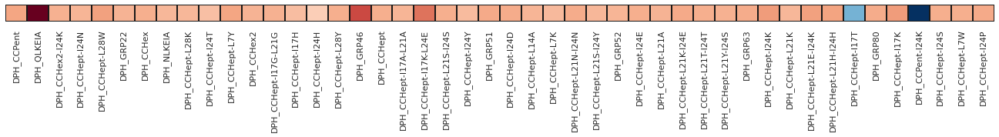


NASH


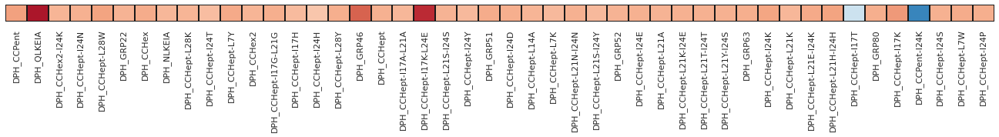


Normal


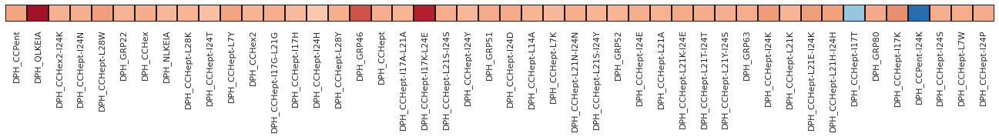




Scaled_data:


CAD


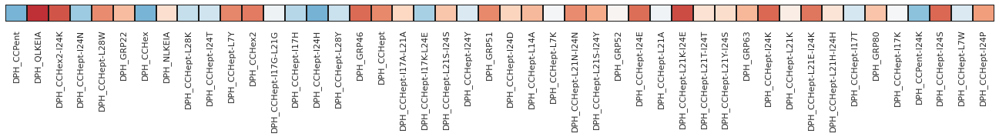


NASH


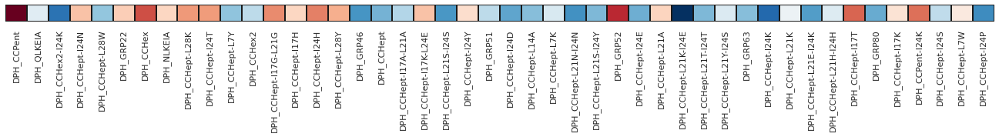


Normal


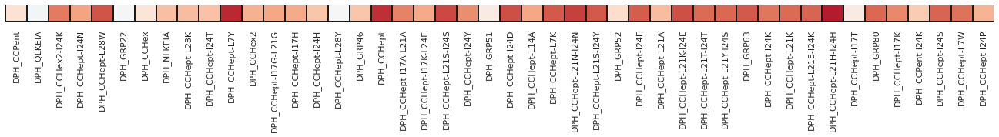




Original_data:



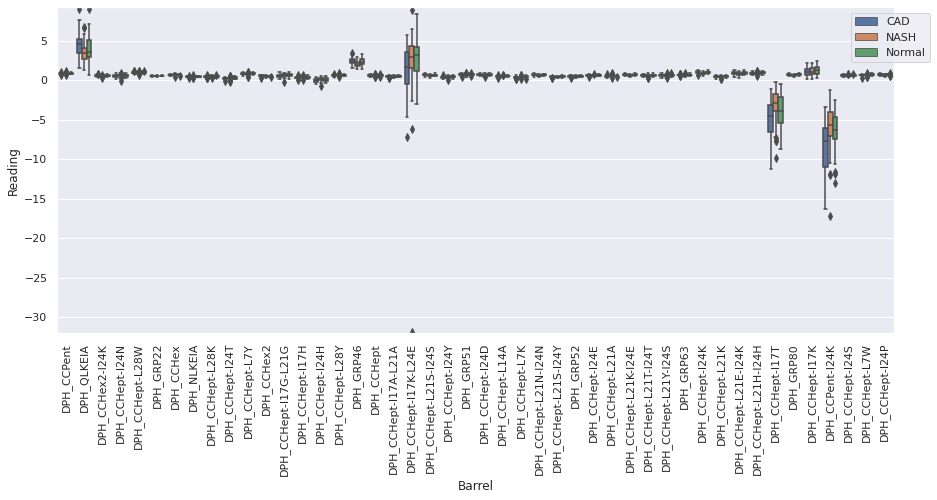

CAD


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 94.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 40.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 87.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 90.7% of the points cannot be placed; you may want 

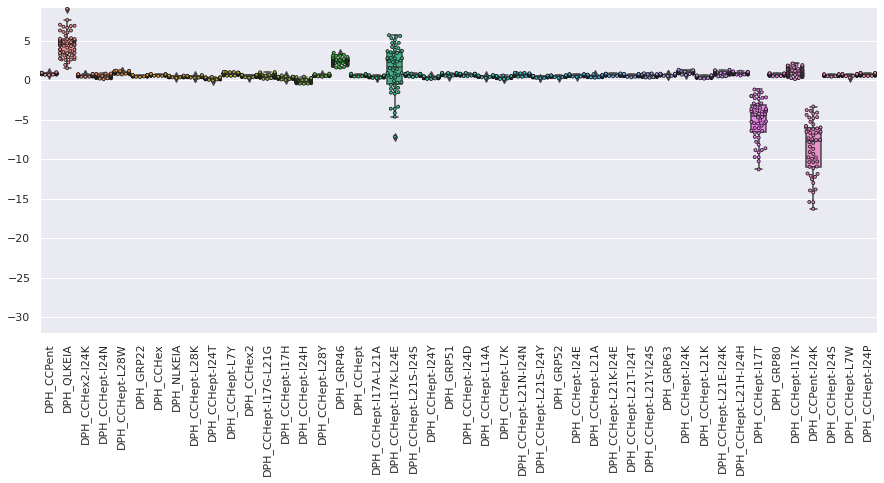

NASH


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 94.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 45.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 85.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 89.1% of the points cannot be placed; you may want 

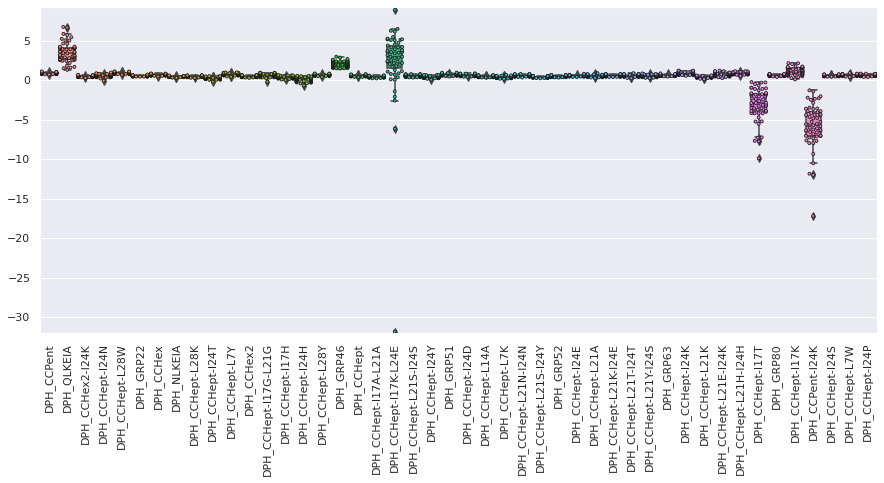

Normal


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 94.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 27.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 89.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 92.7% of the points cannot be placed; you may want 

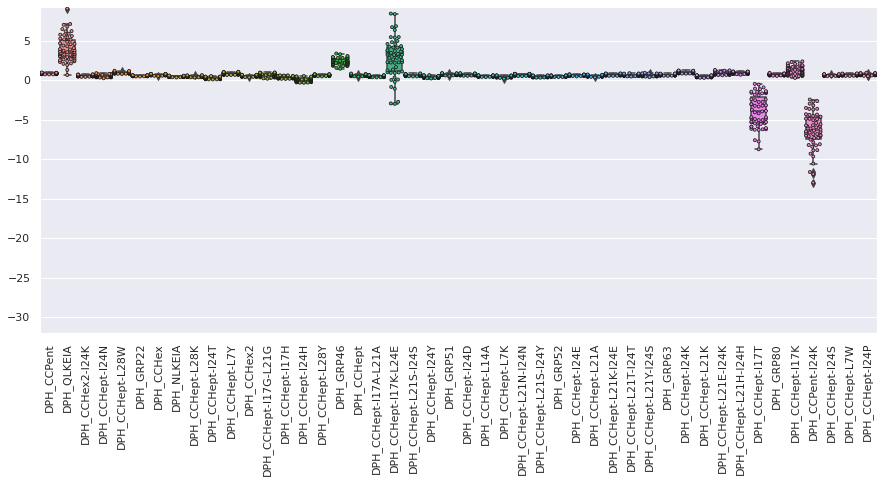




Scaled_data:



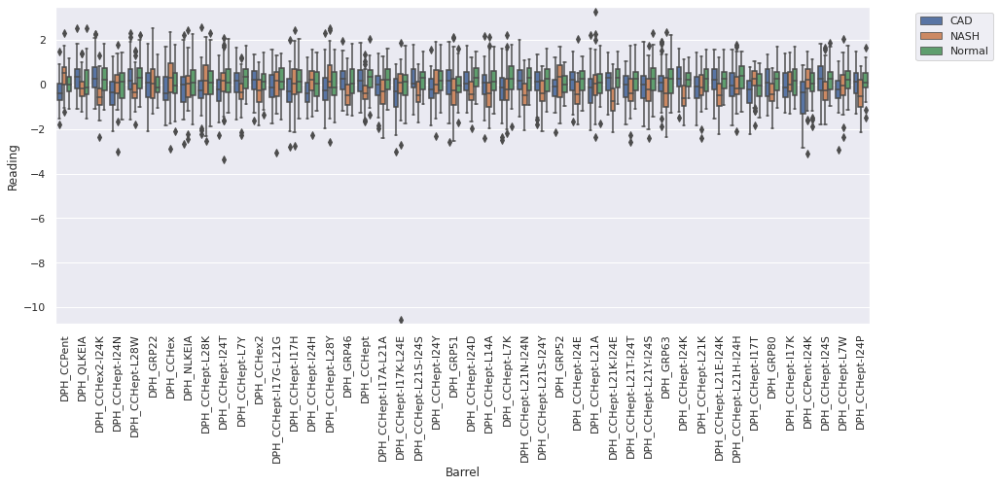

CAD


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 33.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 27.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 22.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 18.5% of the points cannot be placed; you may want 

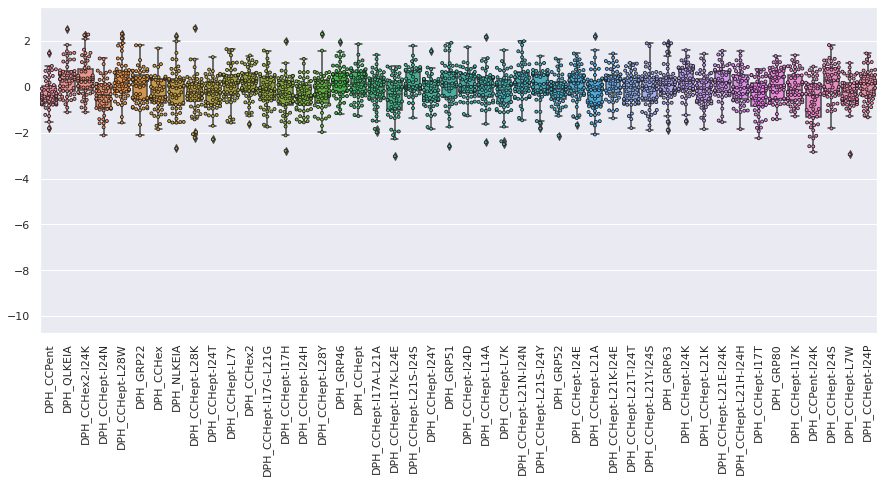

NASH


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 27.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 38.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 32.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 16.4% of the points cannot be placed; you may want 

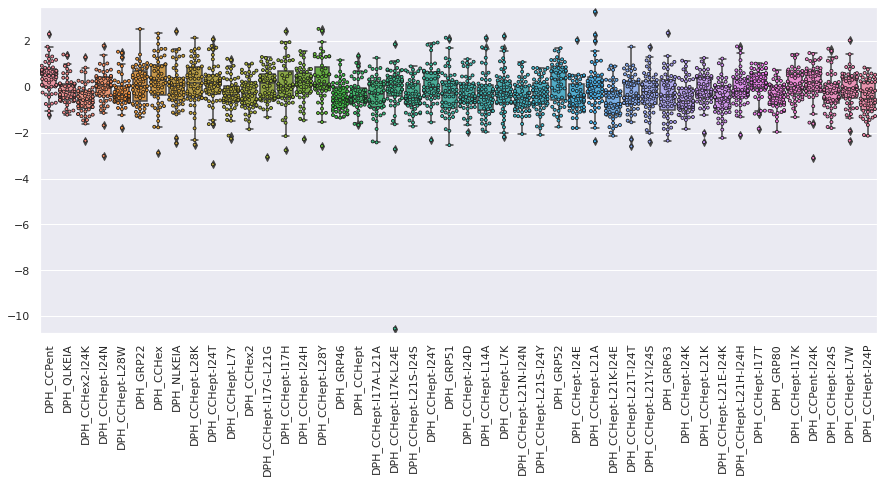

Normal


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 38.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 20.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 32.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 29.1% of the points cannot be placed; you may want 

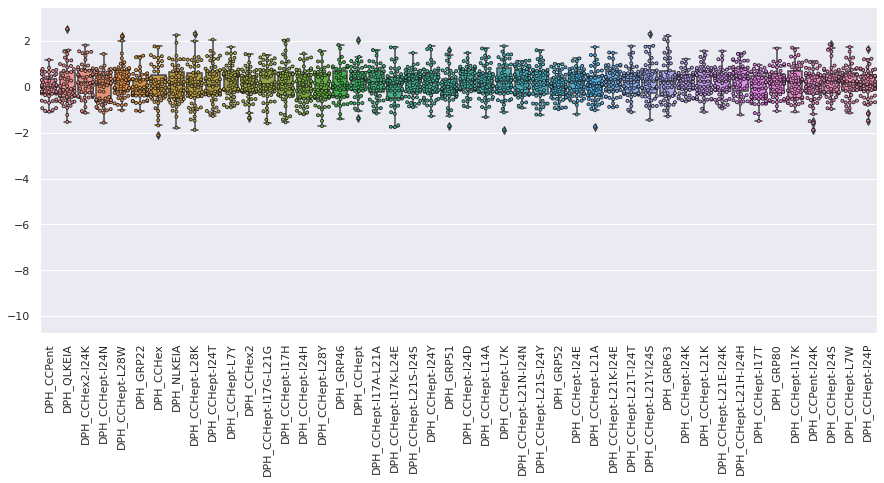

In [13]:
plot_dir = ('/home/ks17361/ML_environment/BADASS/NASH_serum_analysis/NASH_3_classes_split_patient/'
            'NASH_patient_classes')
if os.path.isdir(plot_dir):
    shutil.rmtree(plot_dir)
os.mkdir(plot_dir)

nash_fluor_data.display_data_distribution(
    ml_fluor_data=nash_fluor_data.ml_fluor_data.drop(['Sub_analyte'], axis=1), results_dir=plot_dir,
    prefix='NASH_patient_classes'
)

By eye, when looking at the scaled data box plots, there is not a noticeable difference between the degree of class overlap of the peptides that affect DPH fluorescence very little and hence give very high/low raw readings, as compared to the other peptides. Consequently, I will not be discarding any of the peptides prior to ML analysis. 

#### ML analysis

 *3 classes (Normal, CAD and NASH)*

In [14]:
plt.rcParams['figure.figsize'] = (10, 10)  # Sets default figure size
ml_3_classes = RunML(
    results_dir='/home/ks17361/ML_environment/BADASS/NASH_serum_analysis/NASH_3_classes_split_patient/'
                'NASH_ML_plots',
    fluor_data=nash_fluor_data.ml_fluor_data.drop(['Analyte', 'Sub_analyte'], axis=1),
    classes=nash_fluor_data.ml_fluor_data['Analyte'].tolist(),
    subclasses=nash_fluor_data.ml_fluor_data['Sub_analyte'].tolist(), shuffle=False
)

- Calculate feature correlations

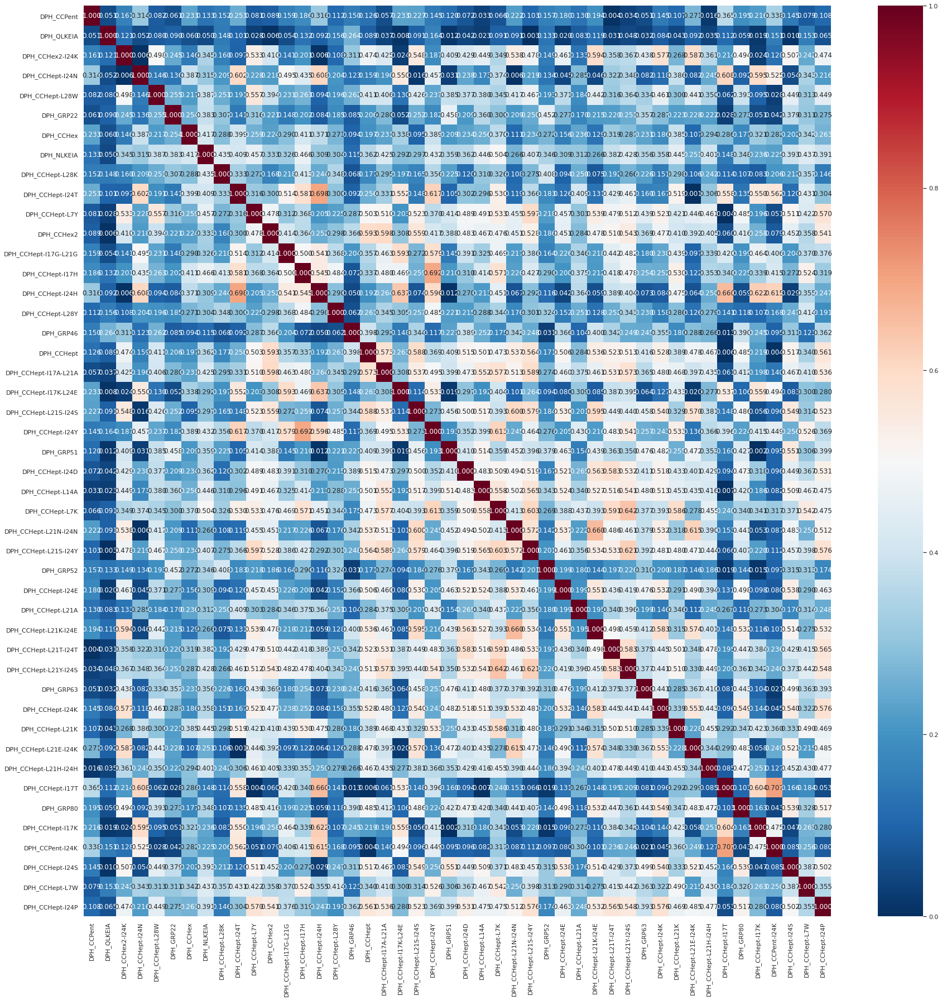

In [15]:
plt.rcParams['figure.figsize'] = (30, 30)
kendall_tau_correlation_matrix = ml_3_classes.calc_feature_correlations(
    fluor_data=ml_3_classes.fluor_data, correlation_coeff='kendall', plt_name='', abs_vals=True
)
plt.rcParams['figure.figsize'] = (10, 10)  # Resets default figure size

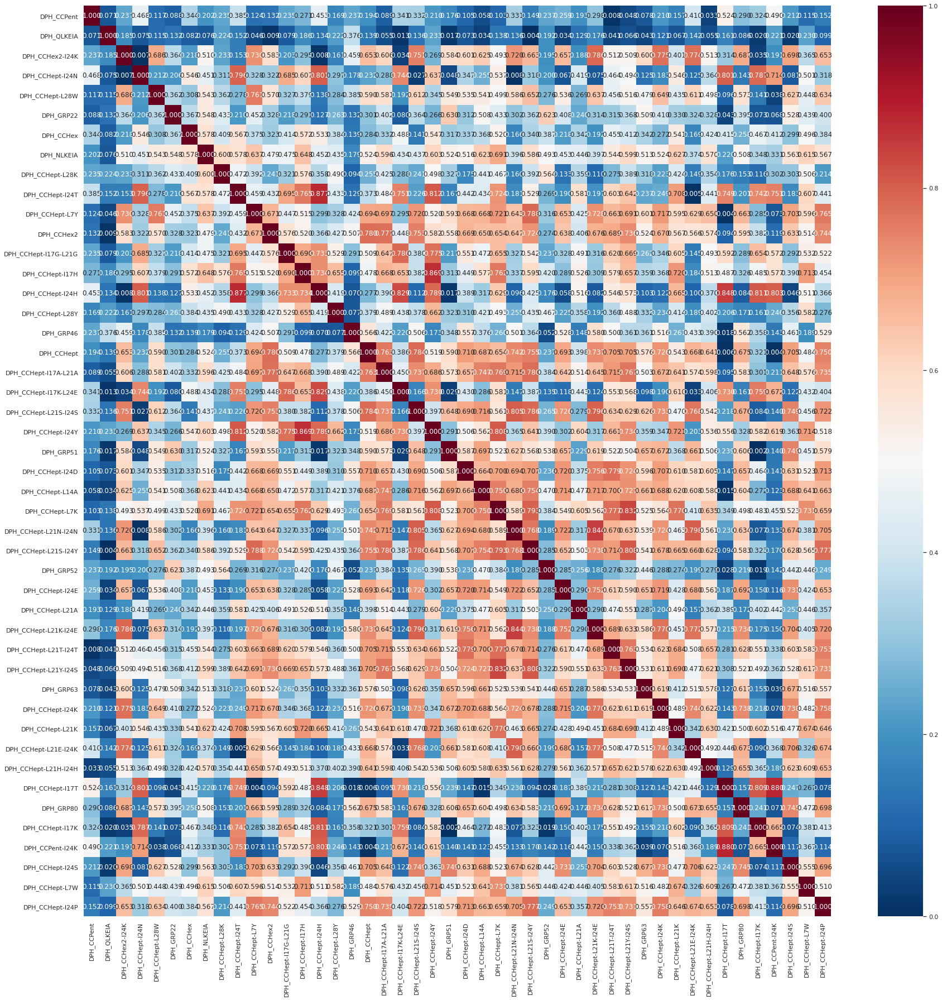

In [16]:
plt.rcParams['figure.figsize'] = (30, 30)
spearman_correlation_matrix = ml_3_classes.calc_feature_correlations(
    fluor_data=ml_3_classes.fluor_data, correlation_coeff='spearman', plt_name='', abs_vals=True
)
plt.rcParams['figure.figsize'] = (10, 10)  # Resets default figure size

So, there is quite a wide range of correlation coefficients across the readings of the different barrels. That some of the barrel pairs show high correlation coefficients is encouraging, as it indicates that at least some of the barrels are likely picking up signal in the data as opposed to just noise. However, the barrels with low correlation coefficients are not necessarily picking up just noise - they may instead be picking up different information from one another (and hence combining the readings from such barrels in the subsequent ML analysis would likely be beneficial for model performance). The following analysis will help to identify which barrels fall into which of these categories!

- Measure the relative importances of the peptides with KBest using one-way ANOVA

<Figure size 720x720 with 0 Axes>

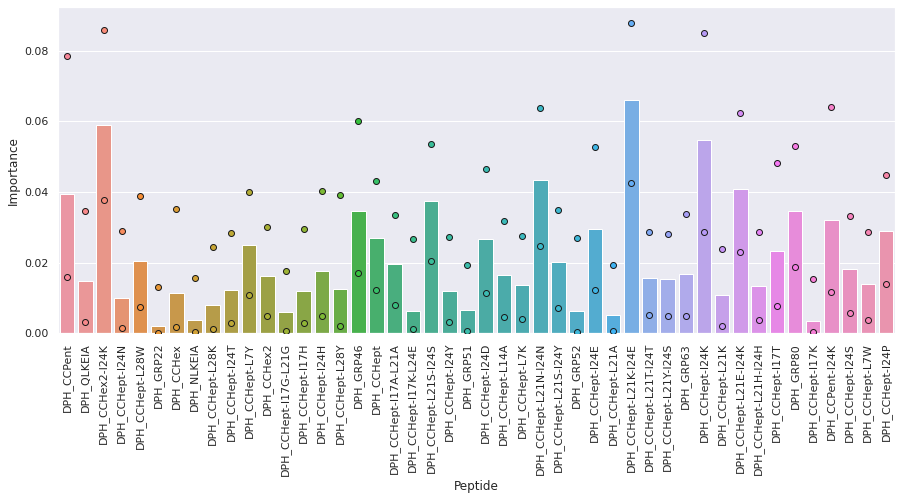

<Figure size 720x720 with 0 Axes>

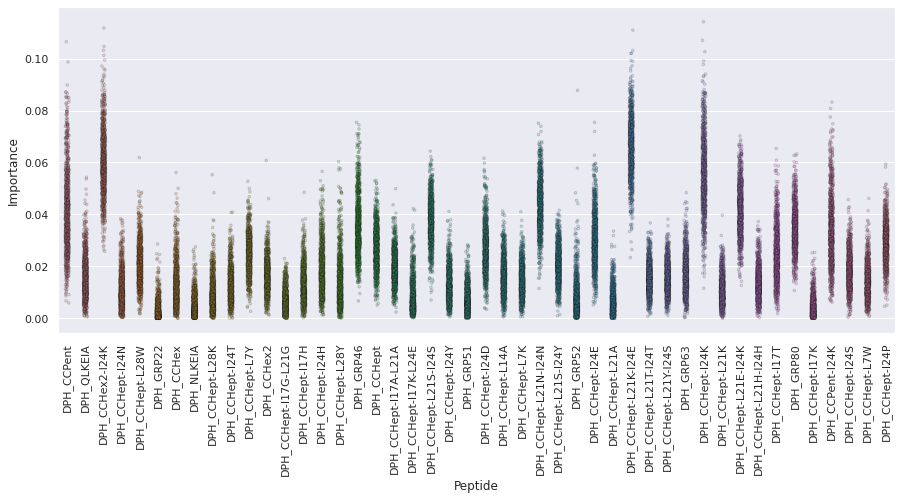

In [17]:
kbest_feat_importances_df, kbest_feat_importances_dict = ml_3_classes.calc_feature_importances_kbest(
    x=ml_3_classes.x, y=ml_3_classes.y, features=None, method_classif='f_classif', num_repeats=1000,
    scale=True, plt_name=''
)

In [18]:
print('Peptides ordered by F-score:')
kbest_feat_importances_df

Peptides ordered by F-score:


,Feature,Score
0,DPH_CCHept-L21K-I24E,0.066021
1,DPH_CCHex2-I24K,0.058817
2,DPH_CCHept-I24K,0.054758
3,DPH_CCHept-L21N-I24N,0.043423
4,DPH_CCHept-L21E-I24K,0.040794
5,DPH_CCPent,0.039351
6,DPH_CCHept-L21S-I24S,0.037497
7,DPH_GRP80,0.034507
8,DPH_GRP46,0.034487
9,DPH_CCPent-I24K,0.032181


KBest analysis is a univariate feature selection method, and hence assumes that the features are independent of one another (the importance scores calculated here are the F-scores from running one-way ANOVA). Consequently, the output importance scores do not reflect correlations between features - the scores represent the information provided by a feature about the output class, rather than the unique information provided by that feature alone. Therefore the most important features highlighted by this method could be providing the same information as one another.

Unsurprisingly, there is an approximate (negative) correlation between the degree of overlap of the readings for the three classes in the box plots above and the importance scores in this analysis (the peptides with the largest importance scores via KBest analysis being CCHept-L21K-I24E, CCHex2-I24K and CCHept-I24K), and vice versa. (These results are broadly similar to those obtained for the per-illness dataset with the same method, plus to the 2 class split of the data (both per-illness and per-patient), which is reassuring!)

- Measure the relative importances of the peptides with decision tree analysis

<Figure size 720x720 with 0 Axes>

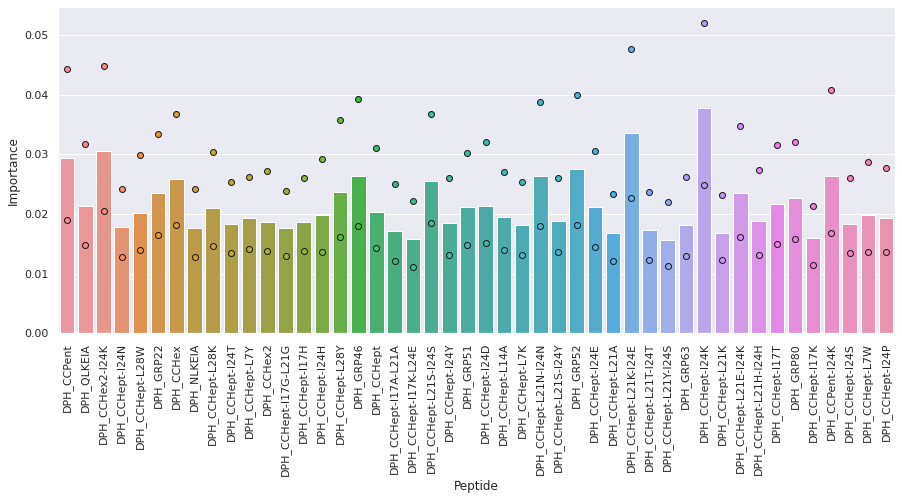

<Figure size 720x720 with 0 Axes>

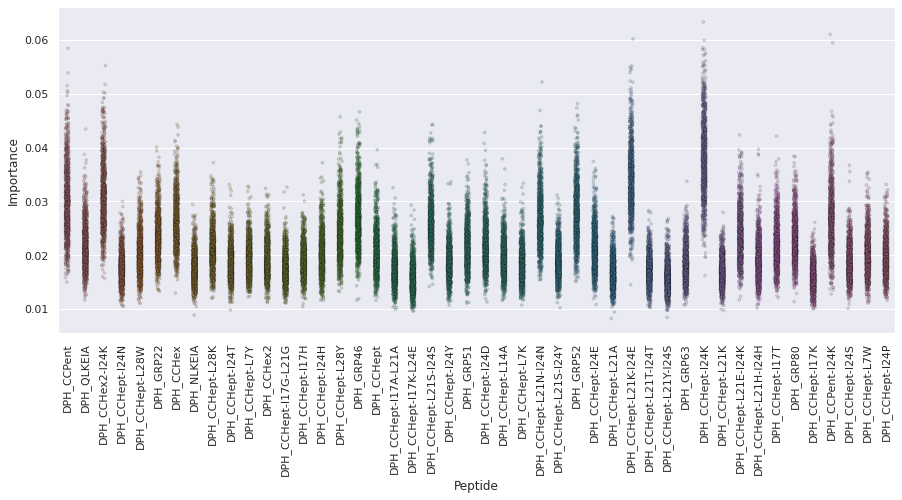

In [19]:
tree_feat_importances_df, tree_feat_importances_dict = ml_3_classes.calc_feature_importances_tree(
    x=ml_3_classes.x, y=ml_3_classes.y, features=None, num_repeats=1000, scale=True, plt_name=''
)

In [20]:
print('Peptides ordered by importance:')
tree_feat_importances_df

Peptides ordered by importance:


,Feature,Score
0,DPH_CCHept-I24K,0.037680
1,DPH_CCHept-L21K-I24E,0.033510
2,DPH_CCHex2-I24K,0.030541
3,DPH_CCPent,0.029430
4,DPH_GRP52,0.027458
5,DPH_CCPent-I24K,0.026370
6,DPH_GRP46,0.026349
7,DPH_CCHept-L21N-I24N,0.026299
8,DPH_CCHex,0.025868
9,DPH_CCHept-L21S-I24S,0.025537


In this method, an ExtraTrees classifier is used to calculate importance scores. The ExtraTrees classifier trains multiple decision trees on the data. Each tree is trained with a random subset of features on a random subset of dataset, the results of these trees are then averaged to make a prediction. Importance scores are calculated as the 
average increase in purity achieved when using a particular feature to split the data across all trees in which that feature is included (i.e. the Gini importance score of the feature). When looking at the Gini importance scores of features in individual trees, correlations between the included features are reflected in the scores. However, as more and more trees, incorporating different subsets of features, are included in the average, feature correlations have less of an effect upon the importance scores. The  number of trees (plus bootstrap repeats) included here means that the correlation between features will have little effect upon the importance scores.

Whilst there are some small differences, the relative order of the peptides identified by this method is very similar to that measured by KBest analysis. The most important peptides identified by this method are essentially the same as those identified by the KBest analysis above (with some small differences in their relative order). The less important peptides are also broadly similar, but unsurprisingly there are more differences in their relative ordering (as the absolute differences between their importance scores are smaller => can lead to more extensive reordering). Consequently, again there is a visible (negative) correlation between the degree of overlap between a peptide's class readings that can be seen in the box plots above and that peptide's importance score.

- Measure the relative importances of the peptides with permutation analysis

<Figure size 720x720 with 0 Axes>

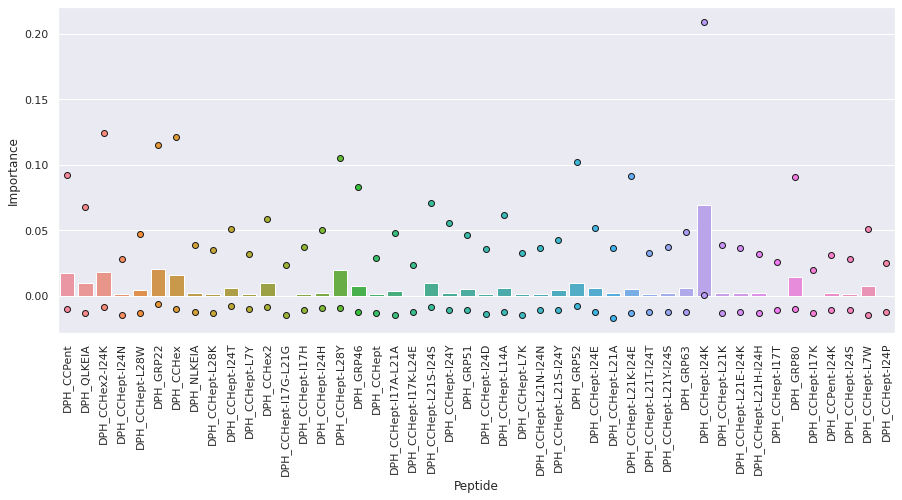

<Figure size 720x720 with 0 Axes>

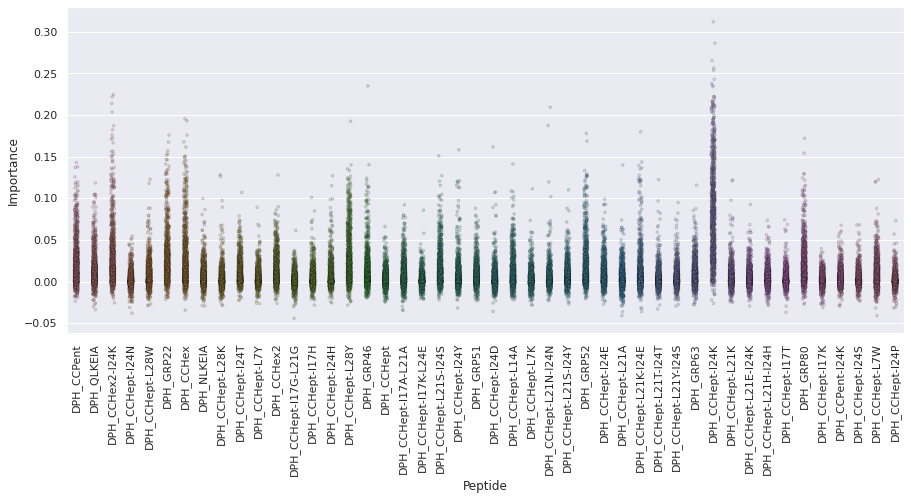

In [21]:
f1 = make_scorer(f1_score, average='weighted')
(
    median_permut_feat_importances_df, permut_feat_importances_dict
) = ml_3_classes.calc_feature_importances_permutation(
    x=ml_3_classes.x, y=ml_3_classes.y, features=None, classifier=AdaBoostClassifier,
    parameters={'n_estimators': np.array([10, 30, 100, 300, 1000])}, model_metric=f1, num_repeats=1000,
    scale=True, plt_name=''
)

In [22]:
print('Peptides ordered by median importance:')
median_permut_feat_importances_df

Peptides ordered by median importance:


,Feature,Score
0,DPH_CCHept-I24K,6.949198e-02
1,DPH_GRP22,2.062211e-02
2,DPH_CCHept-L28Y,1.964031e-02
3,DPH_CCHex2-I24K,1.833213e-02
4,DPH_CCPent,1.706534e-02
5,DPH_CCHex,1.587370e-02
6,DPH_GRP80,1.470420e-02
7,DPH_CCHex2,9.805427e-03
8,DPH_GRP52,9.784795e-03
9,DPH_CCHept-L21S-I24S,9.635629e-03


In [23]:
mean_permut_feat_importances_df = OrderedDict({})
for feat, score_list in permut_feat_importances_dict.items():
    mean_permut_feat_importances_df[feat] = np.mean(score_list)
mean_permut_feat_importances_df = pd.DataFrame({'Feature': list(mean_permut_feat_importances_df.keys()),
                                                'Score': list(mean_permut_feat_importances_df.values())})
mean_permut_feat_importances_df = mean_permut_feat_importances_df.sort_values(
    by=['Score'], axis=0, ascending=False
).reset_index(drop=True)

In [24]:
print('Peptides ordered by mean importance:')
mean_permut_feat_importances_df

Peptides ordered by mean importance:


,Feature,Score
0,DPH_CCHept-I24K,0.078814
1,DPH_CCHex2-I24K,0.029268
2,DPH_GRP22,0.027925
3,DPH_CCHept-L28Y,0.027879
4,DPH_CCHex,0.026993
5,DPH_CCPent,0.023537
6,DPH_GRP80,0.020941
7,DPH_GRP52,0.019537
8,DPH_CCHept-L21S-I24S,0.015680
9,DPH_CCHex2,0.014410


In permutation analysis, importance scores are calculated by training two ML models (in this case I have selected AdaBoost classifiers). The first model is trained using all features, the second is trained with one of the features randomly scrambled: the importance score of the feature is then calculated as the difference in performance (in this case measured via model F1 score) between the two models. Hence this method does take into account correlations between features, and the output importance scores represent the unique information that a feature provides about the output class label.

The results obtained with permutation look more different as compared to the difference between the KBest and ExtraTrees analysis, which is perhaps not surprising given that as described above permutation analysis takes feature correlation into account (whereas the former two methods do not).

Whilst there is broad agreement between the peptides that are identified as relatively more and less important as compared to the KBest and ExtraTrees analysis, permutation analysis finds CCHept-I24K to be the most important peptide by some stretch (~2.5x the second highest importance score when looking at either the median or the mean scores), whereas the former methods find CCHrpt-I24K to be similarly important to several other barrels.

- What percentage of the signal in the data can be measured by N principal components?

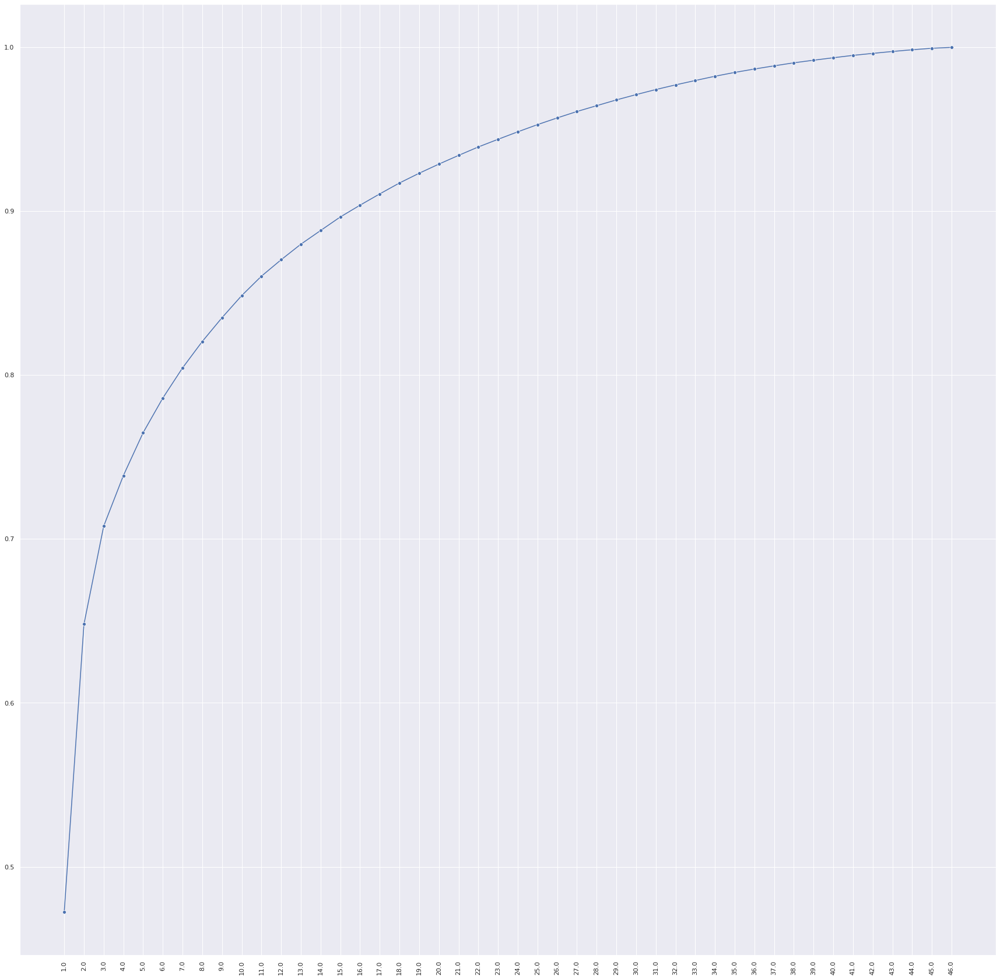

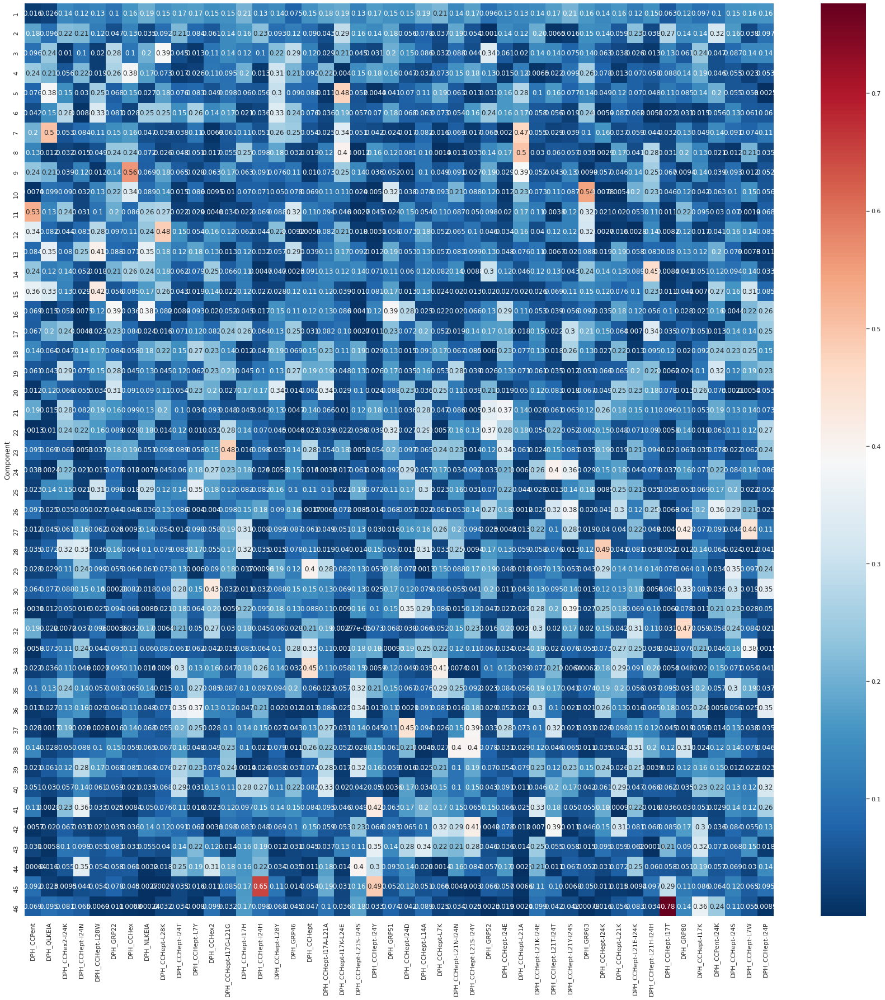

In [25]:
plt.rcParams['figure.figsize'] = (30, 30)  # Sets figure size
pca_model, pca_components = ml_3_classes.run_pca(fluor_data=ml_3_classes.fluor_data, scale=True, plt_name='')
plt.rcParams['figure.figsize'] = (10, 10)  # Resets default figure size

16 components are required to represent ~90% of the variance in the data. Many of the peptides make ~ similar contributions to the first component, whereas the subsequent components tend to be dominated by the signal from one/a few peptides.

Scatter plots of data transformed to PCA dimensions

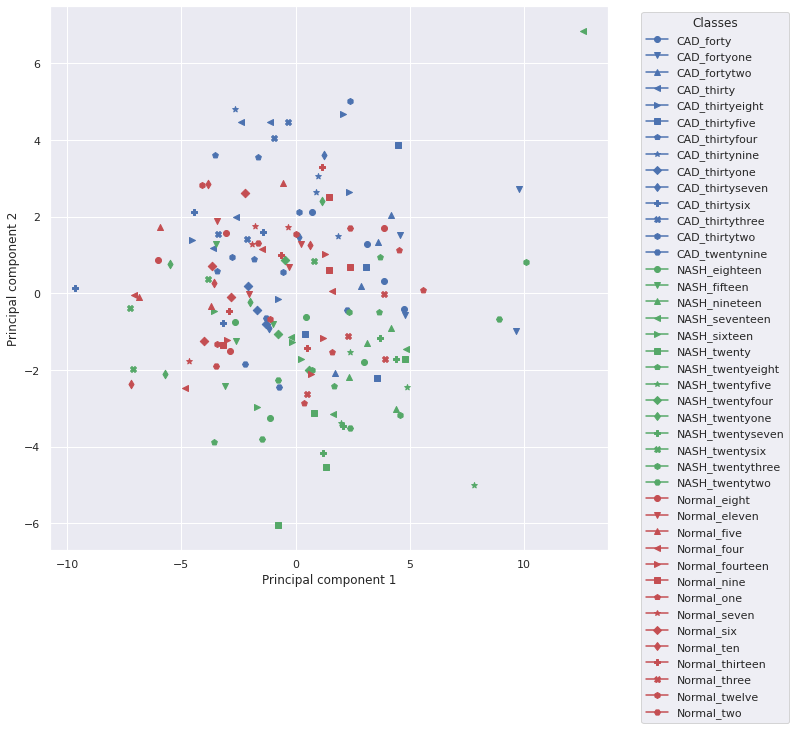

In [26]:
ml_3_classes.plot_scatter_on_pca_axes(
    x=ml_3_classes.x, y=ml_3_classes.y, subclasses=ml_3_classes.sub_classes, num_dimensions=2,
    scale=True, plt_name=''
)

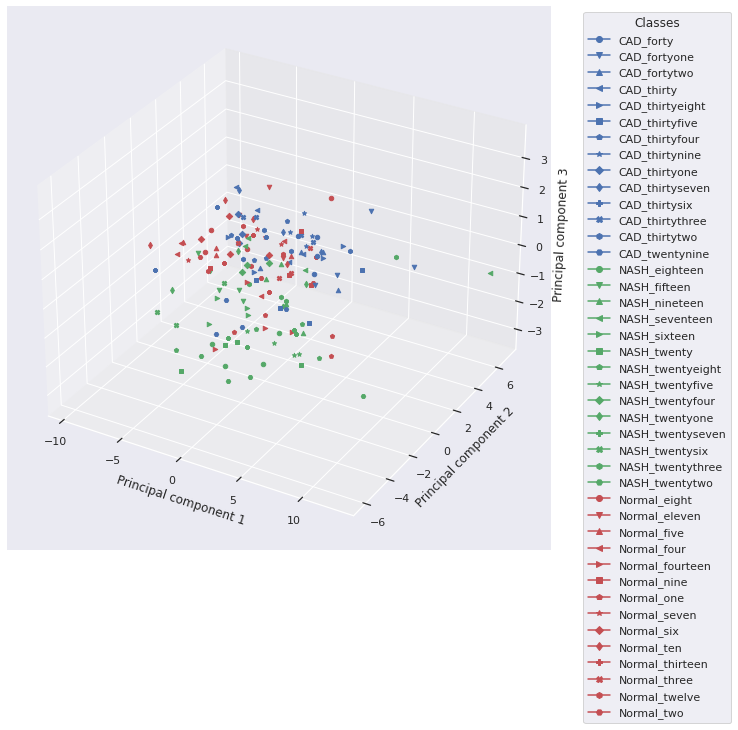

In [27]:
ml_3_classes.plot_scatter_on_pca_axes(
    x=ml_3_classes.x, y=ml_3_classes.y, subclasses=ml_3_classes.sub_classes, num_dimensions=3,
    scale=True, plt_name=''
)

Whilst the 3 classes do not form three distinct clusters on these scatter plots on PCA axes, there is clearly some separation (particularly of the NASH readings from the other two classes). This suggests that it should be possible to train an ML model to distinguish between these classes with an accuracy score etc. outperforming random guessing.

#### How well does a model trained with all features perform?

Runs grid search with nested cross-validation to spot check 5 different ML algorithms. Inner loop identifies the optimal parameter values to use with the ML algorithm; outer loop measures the performance of a model trained using these parameter values.

In [28]:
algorithms = [KNeighborsClassifier, GaussianNB, LinearSVC, SVC, AdaBoostClassifier]
resampling_methods = ['no_balancing']  # Classes are ~balanced, plus the dataset is quite small => decided
# not to test any data resampling methods such as oversampling and SMOTE, etc.

n_components_pca = None
run = 'gridsearch'
n_iter = None
cv_folds_inner_loop = 5
cv_folds_outer_loop = 7
train_scoring_metric = make_scorer(f1_score, average='weighted', zero_division=0)
test_scoring_funcs={accuracy_score: {},
                    recall_score: {'average': 'weighted',
                                   'zero_division': 0},
                    precision_score: {'average': 'weighted',
                                      'zero_division': 0},
                    f1_score: {'average': 'weighted',
                               'zero_division': 0}}

all_feat_searches = OrderedDict({})
all_feat_score_dict = OrderedDict({'Algorithm': [],
                                   'Resampling_method': [],
                                   'Average_accuracy': [],
                                   'Std_dev_accuracy': [],
                                   'Average_recall': [],
                                   'Std_dev_recall': [],
                                   'Average_precision': [],
                                   'Std_dev_precision': [],
                                   'Average_f1': [],
                                   'Std_dev_f1': []})

for algorithm in algorithms:
    for resampling_method in resampling_methods:
        fixed_params = ml_3_classes.define_fixed_model_params(classifier=algorithm())
        if algorithm.__name__ in ['LinearSVC', 'SVC', 'AdaBoostClassifier']:
            fixed_params['random_state'] = 1
        tuned_params = ml_3_classes.define_tuned_model_params(
            classifier=algorithm(), x_train=ml_3_classes.x, n_folds=cv_folds_inner_loop
        )
        nested_cv_search = ml_3_classes.run_nested_CV(
            clf=algorithm, x=ml_3_classes.x, y=ml_3_classes.y, groups=ml_3_classes.sub_classes,
            selected_features=list(ml_3_classes.features), inner_splits=None,
            outer_splits=None, const_split=True, resampling_method=resampling_method,
            n_components_pca=n_components_pca, run=run, fixed_params=fixed_params, tuned_params=tuned_params,
            train_scoring_metric=train_scoring_metric, test_scoring_funcs=test_scoring_funcs, n_iter=n_iter,
            cv_folds_inner_loop=cv_folds_inner_loop, cv_folds_outer_loop=cv_folds_outer_loop,
            draw_conf_mat=False, plt_name=''
        )

        all_feat_searches[
            '{}__{}'.format(algorithm.__name__, resampling_method)
        ] = copy.deepcopy(nested_cv_search)

        all_feat_score_dict['Algorithm'].append(algorithm.__name__)
        all_feat_score_dict['Resampling_method'].append(resampling_method)
        all_feat_score_dict['Average_accuracy'].append(nested_cv_search['average_test_scores']['accuracy'])
        all_feat_score_dict['Std_dev_accuracy'].append(nested_cv_search['stddev_test_scores']['accuracy'])
        all_feat_score_dict['Average_recall'].append(nested_cv_search['average_test_scores']['recall'])
        all_feat_score_dict['Std_dev_recall'].append(nested_cv_search['stddev_test_scores']['recall'])
        all_feat_score_dict['Average_precision'].append(nested_cv_search['average_test_scores']['precision'])
        all_feat_score_dict['Std_dev_precision'].append(nested_cv_search['stddev_test_scores']['precision'])
        all_feat_score_dict['Average_f1'].append(nested_cv_search['average_test_scores']['f1'])
        all_feat_score_dict['Std_dev_f1'].append(nested_cv_search['stddev_test_scores']['f1'])

        # Print output of nested CV
        for i, params in enumerate(nested_cv_search['outer_loop_params']):
            print('\n\n\n')
            print('{}: {}'.format(algorithm.__name__, resampling_method))
            print('Parameters: {}'.format(params))
            print('Accuracy: {}'.format(nested_cv_search['test_scores']['accuracy'][i]))
            print('F1: {}'.format(nested_cv_search['test_scores']['f1'][i]))





KNeighborsClassifier: no_balancing
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 3), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.2916666666666667
F1: 0.32407407407407407




KNeighborsClassifier: no_balancing
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 4), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.75
F1: 0.725




KNeighborsClassifier: no_balancing
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 4), ('p', 2), ('weights', 'distance')])
Accuracy: 0.7916666666666666
F1: 0.7890559732664996




KNeighborsClassifier: no_balancing
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 3), ('p', 2), ('weights', 'distance')])
Accuracy: 0.30434782608695654
F1: 0.25060761544693494




KNeighborsClassifier: no_balancing
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 4), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.47

In [29]:
all_feat_score_df = pd.DataFrame(all_feat_score_dict)

In [30]:
all_feat_score_df

,Algorithm,Resampling_method,Average_accuracy,Std_dev_accuracy,Average_recall,Std_dev_recall,Average_precision,Std_dev_precision,Average_f1,Std_dev_f1
0,KNeighborsClassifier,no_balancing,0.541408,0.191414,0.541408,0.191414,0.563056,0.208008,0.531864,0.192488
1,GaussianNB,no_balancing,0.578675,0.202766,0.578675,0.202766,0.611624,0.178197,0.578791,0.195751
2,LinearSVC,no_balancing,0.572981,0.099063,0.572981,0.099063,0.580912,0.097577,0.559532,0.093693
3,SVC,no_balancing,0.560300,0.163396,0.560300,0.163396,0.572050,0.180332,0.544770,0.170886
4,AdaBoostClassifier,no_balancing,0.534938,0.174050,0.534938,0.174050,0.537946,0.192515,0.513783,0.186342


In [31]:
with open('{}/All_features_CV_search_models.pkl'.format(ml_3_classes.results_dir), 'wb') as f:
    pickle.dump((all_feat_searches, all_feat_score_df), f)

/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/sklearn/svm/_base.py:986: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/sklearn/svm/_base.py:986: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/sklearn/svm/_base.py:986: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)


The algorithms all perform better than random guessing. Will select GaussianNB to take forwards as it performs best. (LinearSVC failed to converge on some of the splits => some of the models will not be properly trained => poor predictions => will not select LinearSVC model in this case.)

In [32]:
all_feat_searches['GaussianNB__no_balancing']['outer_loop_params']

[OrderedDict(),
 OrderedDict(),
 OrderedDict(),
 OrderedDict(),
 OrderedDict(),
 OrderedDict(),
 OrderedDict()]

In [33]:
all_feat_searches['GaussianNB__no_balancing']['best_outer_loop_params']

OrderedDict([('accuracy', OrderedDict()),
             ('recall', OrderedDict()),
             ('precision', OrderedDict()),
             ('f1', OrderedDict())])

In [34]:
all_feat_searches['GaussianNB__no_balancing']['test_scores']['accuracy']

[0.3333333333333333,
 0.6666666666666666,
 0.8333333333333334,
 0.5652173913043478,
 0.391304347826087,
 0.8695652173913043,
 0.391304347826087]

In [35]:
all_feat_nested_pred = all_feat_searches['GaussianNB__no_balancing']['predictions']
all_feat_nested_y_true = all_feat_searches['GaussianNB__no_balancing']['y_true']
all_feat_nested_x_true = all_feat_searches['GaussianNB__no_balancing']['x_true']

all_feat_flat_pred = np.array([pred for pred_array in all_feat_nested_pred for pred in pred_array])
all_feat_flat_y_true = np.array([y for y_array in all_feat_nested_y_true for y in y_array])
all_feat_flat_x_true = np.array([x for x_array in all_feat_nested_x_true for x in x_array])

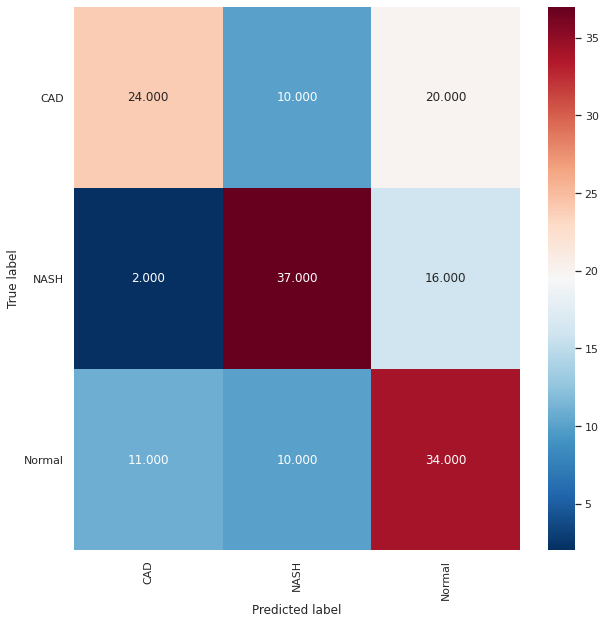

Normalised over true label (rows)


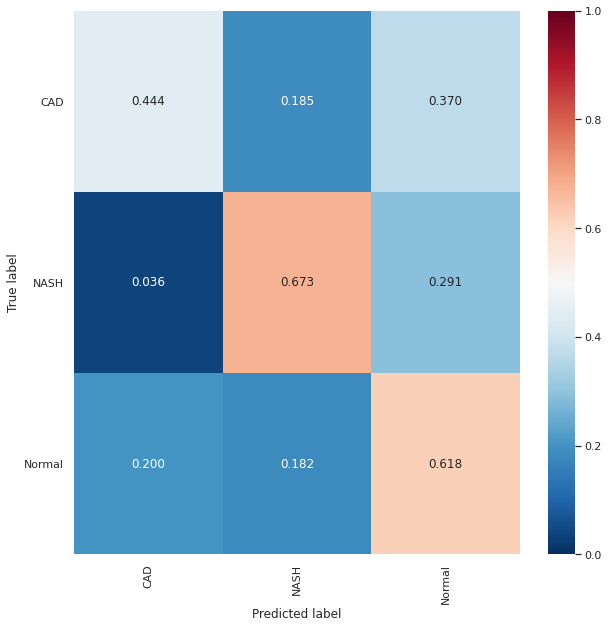

Normalised over pred label (columns)


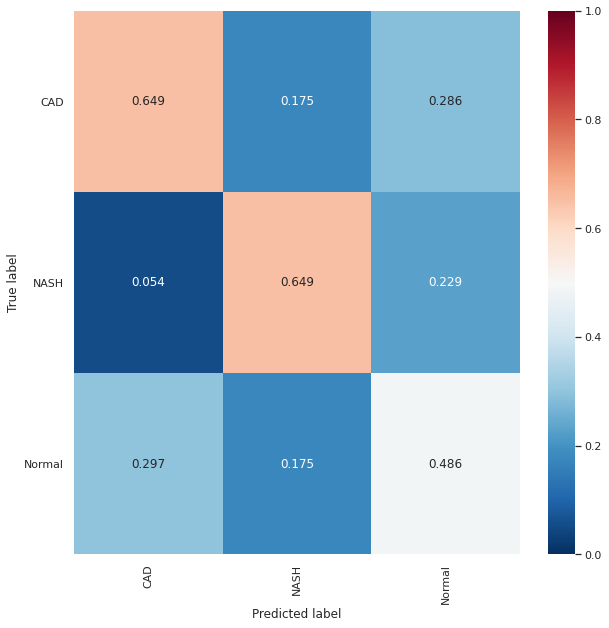

In [36]:
draw_conf_matrices(all_feat_flat_y_true, all_feat_flat_pred, ml_3_classes.results_dir, 'All_features')

In [37]:
all_feat_true_hue = []
for index, y in enumerate(all_feat_flat_y_true):
    if all_feat_flat_pred[index] == y:
        all_feat_true_hue.append('{}_correct'.format(y))
    else:
        all_feat_true_hue.append('{}_incorrect'.format(y))

sub_all_feat_true_hue = []
sub_all_feat_flat_x_true = []
sub_all_feat_flat_y_true = []
for i, true_hue in enumerate(all_feat_true_hue):
    if true_hue.endswith('_incorrect'):
        sub_all_feat_true_hue.append(true_hue)
        sub_all_feat_flat_x_true.append(all_feat_flat_x_true[i])
        sub_all_feat_flat_y_true.append(all_feat_flat_y_true[i])

all_feat_true_hue = np.array(all_feat_true_hue)
sub_all_feat_true_hue = np.array(sub_all_feat_true_hue)
sub_all_feat_flat_x_true = np.array(sub_all_feat_flat_x_true)
sub_all_feat_flat_y_true = np.array(sub_all_feat_flat_y_true)

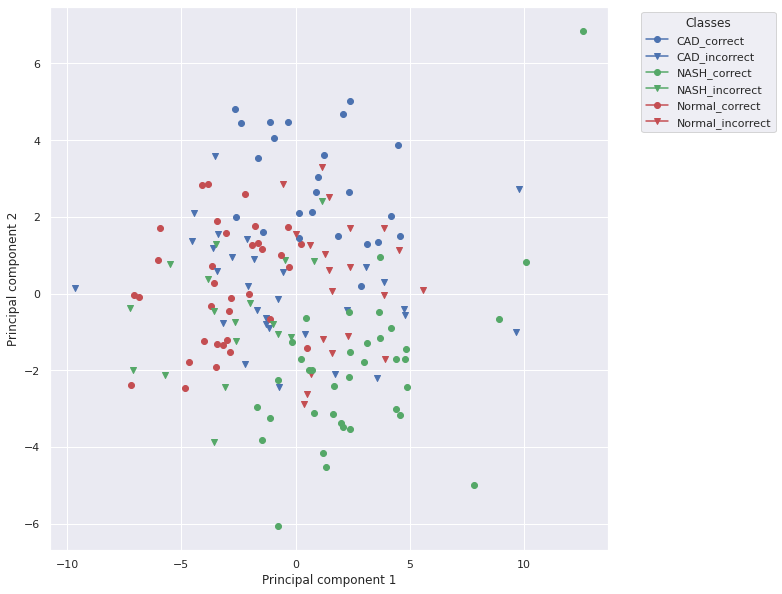

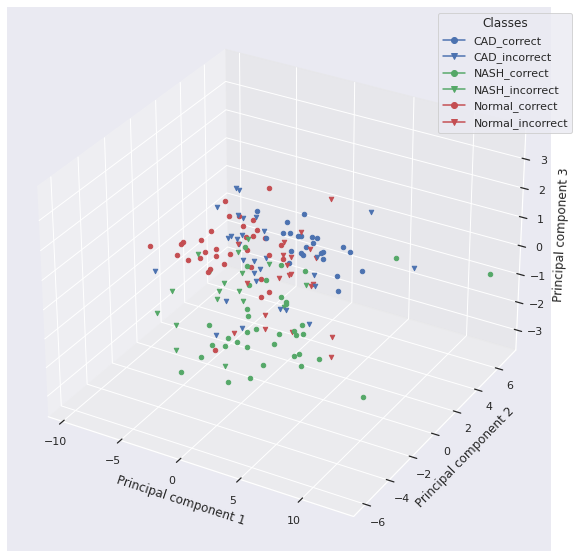

In [38]:
# Scatter plot (axes = top two principal components)
ml_3_classes.plot_scatter_on_pca_axes(
    x=all_feat_flat_x_true, y=all_feat_flat_y_true, subclasses=all_feat_true_hue, num_dimensions=2,
    scale=True, plt_name='All_features_coloured_by_pred'
)

# Scatter plot (axes = top three principal components)
ml_3_classes.plot_scatter_on_pca_axes(
    x=all_feat_flat_x_true, y=all_feat_flat_y_true, subclasses=all_feat_true_hue, num_dimensions=3,
    scale=True, plt_name='All_features_coloured_by_pred'
)

# NASH_incorrect = Value that is actually NASH is predicted to be something else

It is possible to train an ML model that is able to identify the class labels of subclasses it was not exposed to during training, i.e. in this case the model can predict the class ("Normal", "CAD" or "NASH") of a sample from a patient it hasn't seen before better than random guessing. However, the accuracy of the best performing algorithm is only 0.58 (2sf), so there is substantial room for improvement. Can this be achieved by reducing the number of features?

#### Is it possible to maintain/improve model performance when reducing the number of peptides?

Sequentially include features via their feature importance (as measured via KBest/permutation analysis), measure if there is any difference in trained classifier performance.

In [39]:
algorithms = [KNeighborsClassifier, GaussianNB, LinearSVC, SVC, AdaBoostClassifier]
resampling_methods = ['no_balancing']  # Classes are ~ balanced, plus the dataset is quite small => decided
# not to test any data resampling methods such as oversampling and SMOTE, etc.
num_features_list = [1, 2, 3, 4, 5, 10, 15, 20, 30, 46]

ordered_features = {'KBest_Fscore': kbest_feat_importances_df['Feature'].tolist(),
                    'Permutation_score': mean_permut_feat_importances_df['Feature'].tolist()}

n_components_pca = None
run = 'gridsearch'
n_iter = None
cv_folds_inner_loop = 5
cv_folds_outer_loop = 7
train_scoring_metric = make_scorer(f1_score, average='weighted', zero_division=0)
test_scoring_funcs = {accuracy_score: {},
                      recall_score: {'average': 'weighted',
                                     'zero_division': 0},
                      precision_score: {'average': 'weighted',
                                        'zero_division': 0},
                      f1_score: {'average': 'weighted',
                                 'zero_division': 0}}

red_feat_searches = OrderedDict({})
red_feat_score_dict = OrderedDict({'Algorithm': [],
                                   'Resampling_method': [],
                                   'Feature_selection_method': [],
                                   'Num_features': [],
                                   'Average_accuracy': [],
                                   'Std_dev_accuracy': [],
                                   'Average_recall': [],
                                   'Std_dev_recall': [],
                                   'Average_precision': [],
                                   'Std_dev_precision': [],
                                   'Average_f1': [],
                                   'Std_dev_f1': [],})
for algorithm in algorithms:
    for resampling_method in resampling_methods:
        for feat_method, all_features in ordered_features.items():
            for num_features in num_features_list:
                fixed_params = ml_3_classes.define_fixed_model_params(classifier=algorithm())
                if algorithm.__name__ in ['LinearSVC', 'SVC', 'AdaBoostClassifier']:
                    fixed_params['random_state'] = 1
                tuned_params = ml_3_classes.define_tuned_model_params(
                    classifier=algorithm(), x_train=ml_3_classes.x, n_folds=cv_folds_inner_loop
                )
                selected_features = all_features[:num_features]

                nested_cv_search = ml_3_classes.run_nested_CV(
                    clf=algorithm, x=ml_3_classes.x, y=ml_3_classes.y, groups=ml_3_classes.sub_classes,
                    selected_features=selected_features, inner_splits=None, outer_splits=None, const_split=True,
                    resampling_method=resampling_method, n_components_pca=n_components_pca, run=run,
                    fixed_params=fixed_params, tuned_params=tuned_params,
                    train_scoring_metric=train_scoring_metric, test_scoring_funcs=test_scoring_funcs,
                    n_iter=n_iter, cv_folds_inner_loop=cv_folds_inner_loop,
                    cv_folds_outer_loop=cv_folds_outer_loop, draw_conf_mat=False, plt_name=''
                )

                red_feat_searches[
                    '{}__{}__{}__{}'.format(algorithm.__name__, resampling_method, feat_method, num_features)
                ] = copy.deepcopy(nested_cv_search)

                red_feat_score_dict['Algorithm'].append(algorithm.__name__)
                red_feat_score_dict['Resampling_method'].append(resampling_method)
                red_feat_score_dict['Feature_selection_method'].append(feat_method)
                red_feat_score_dict['Num_features'].append(num_features)
                red_feat_score_dict['Average_accuracy'].append(nested_cv_search['average_test_scores']['accuracy'])
                red_feat_score_dict['Std_dev_accuracy'].append(nested_cv_search['stddev_test_scores']['accuracy'])
                red_feat_score_dict['Average_recall'].append(nested_cv_search['average_test_scores']['recall'])
                red_feat_score_dict['Std_dev_recall'].append(nested_cv_search['stddev_test_scores']['recall'])
                red_feat_score_dict['Average_precision'].append(nested_cv_search['average_test_scores']['precision'])
                red_feat_score_dict['Std_dev_precision'].append(nested_cv_search['stddev_test_scores']['precision'])
                red_feat_score_dict['Average_f1'].append(nested_cv_search['average_test_scores']['f1'])
                red_feat_score_dict['Std_dev_f1'].append(nested_cv_search['stddev_test_scores']['f1'])

                # Print output of nested CV
                for index, params in enumerate(nested_cv_search['outer_loop_params']):
                    print('\n\n\n')
                    print('{}: {},  {},  {}'.format(
                        algorithm.__name__, resampling_method, feat_method, num_features
                    ))
                    print('Parameters: {}'.format(params))
                    print('Accuracy: {}'.format(nested_cv_search['test_scores']['accuracy'][index]))
                    print('F1: {}'.format(nested_cv_search['test_scores']['f1'][index]))





KNeighborsClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 20), ('p', 1), ('weights', 'distance')])
Accuracy: 0.4166666666666667
F1: 0.4039682539682539




KNeighborsClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 7), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.625
F1: 0.5873015873015873




KNeighborsClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 1), ('weights', 'distance')])
Accuracy: 0.5
F1: 0.5043478260869566




KNeighborsClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 1), ('weights', 'distance')])
Accuracy: 0.34782608695652173
F1: 0.33690946734425




KNeighborsClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('metric', 'minkow





KNeighborsClassifier: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 10), ('p', 1), ('weights', 'distance')])
Accuracy: 0.2916666666666667
F1: 0.3273809523809524




KNeighborsClassifier: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 15), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.625
F1: 0.5873015873015873




KNeighborsClassifier: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 3), ('p', 2), ('weights', 'distance')])
Accuracy: 0.6666666666666666
F1: 0.6689045183290707




KNeighborsClassifier: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 13), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.391304347826087
F1: 0.3719063545150501




KNeighborsClassifier: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDic





KNeighborsClassifier: no_balancing,  Permutation_score,  3
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 4), ('p', 1), ('weights', 'distance')])
Accuracy: 0.375
F1: 0.3896658896658897




KNeighborsClassifier: no_balancing,  Permutation_score,  3
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 18), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.625
F1: 0.6013366750208856




KNeighborsClassifier: no_balancing,  Permutation_score,  3
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 6), ('p', 1), ('weights', 'distance')])
Accuracy: 0.6666666666666666
F1: 0.6738215488215488




KNeighborsClassifier: no_balancing,  Permutation_score,  3
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 4), ('p', 2), ('weights', 'distance')])
Accuracy: 0.391304347826087
F1: 0.3967963386727688




KNeighborsClassifier: no_balancing,  Permutation_score,  3
Parameters: Orde





KNeighborsClassifier: no_balancing,  Permutation_score,  20
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 21), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.4166666666666667
F1: 0.4542124542124542




KNeighborsClassifier: no_balancing,  Permutation_score,  20
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 5), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.625
F1: 0.5861111111111111




KNeighborsClassifier: no_balancing,  Permutation_score,  20
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 5), ('p', 2), ('weights', 'distance')])
Accuracy: 0.7083333333333334
F1: 0.6926683716965046




KNeighborsClassifier: no_balancing,  Permutation_score,  20
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 16), ('p', 2), ('weights', 'distance')])
Accuracy: 0.43478260869565216
F1: 0.3906354515050167




KNeighborsClassifier: no_balancing,  Permutation_score, 





GaussianNB: no_balancing,  KBest_Fscore,  5
Parameters: OrderedDict()
Accuracy: 0.4166666666666667
F1: 0.4394341290893015




GaussianNB: no_balancing,  KBest_Fscore,  5
Parameters: OrderedDict()
Accuracy: 0.5833333333333334
F1: 0.547008547008547




GaussianNB: no_balancing,  KBest_Fscore,  5
Parameters: OrderedDict()
Accuracy: 0.5833333333333334
F1: 0.5833333333333334




GaussianNB: no_balancing,  KBest_Fscore,  5
Parameters: OrderedDict()
Accuracy: 0.34782608695652173
F1: 0.323435186431552




GaussianNB: no_balancing,  KBest_Fscore,  5
Parameters: OrderedDict()
Accuracy: 0.43478260869565216
F1: 0.39755911517925246




GaussianNB: no_balancing,  KBest_Fscore,  5
Parameters: OrderedDict()
Accuracy: 0.6521739130434783
F1: 0.6036942313157148




GaussianNB: no_balancing,  KBest_Fscore,  5
Parameters: OrderedDict()
Accuracy: 0.34782608695652173
F1: 0.3571947772243909




GaussianNB: no_balancing,  KBest_Fscore,  10
Parameters: OrderedDict()
Accuracy: 0.375
F1: 0.4288156288156288








GaussianNB: no_balancing,  Permutation_score,  5
Parameters: OrderedDict()
Accuracy: 0.4166666666666667
F1: 0.4728395061728395




GaussianNB: no_balancing,  Permutation_score,  5
Parameters: OrderedDict()
Accuracy: 0.5416666666666666
F1: 0.48148148148148145




GaussianNB: no_balancing,  Permutation_score,  5
Parameters: OrderedDict()
Accuracy: 0.7083333333333334
F1: 0.6986243386243386




GaussianNB: no_balancing,  Permutation_score,  5
Parameters: OrderedDict()
Accuracy: 0.4782608695652174
F1: 0.43638443935926774




GaussianNB: no_balancing,  Permutation_score,  5
Parameters: OrderedDict()
Accuracy: 0.4782608695652174
F1: 0.3929606625258799




GaussianNB: no_balancing,  Permutation_score,  5
Parameters: OrderedDict()
Accuracy: 0.6521739130434783
F1: 0.607914927984924




GaussianNB: no_balancing,  Permutation_score,  5
Parameters: OrderedDict()
Accuracy: 0.43478260869565216
F1: 0.4257215929850201




GaussianNB: no_balancing,  Permutation_score,  10
Parameters: OrderedDict()
A





LinearSVC: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.5)])
Accuracy: 0.2916666666666667
F1: 0.3265993265993266




LinearSVC: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 1.0)])
Accuracy: 0.6666666666666666
F1: 0.6428571428571428




LinearSVC: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 1.0)])
Accuracy: 0.625
F1: 0.6203007518796992




LinearSVC: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.125)])
Accuracy: 0.43478260869565216
F1: 0.42779635823114087




LinearSVC: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.43478260869565216
F1: 0.40557413600891856




LinearSVC: no_balanc

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.4166666666666667
F1: 0.4381864623243934




LinearSVC: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.625
F1: 0.5873015873015873




LinearSVC: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.625
F1: 0.6278195488721804




LinearSVC: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.5652173913043478
F1: 0.5566770186335404




LinearSVC: no_balancing,  KBest_Fs





LinearSVC: no_balancing,  Permutation_score,  1
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.25)])
Accuracy: 0.375
F1: 0.40948275862068967




LinearSVC: no_balancing,  Permutation_score,  1
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.5
F1: 0.4341453753218459




LinearSVC: no_balancing,  Permutation_score,  1
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.5
F1: 0.3384615384615384




LinearSVC: no_balancing,  Permutation_score,  1
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.25)])
Accuracy: 0.2608695652173913
F1: 0.1990338164251208




LinearSVC: no_balancing,  Permutation_score,  1
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 1.0)])
Accuracy: 0.4782608695652174
F1: 0.45360436664784487




LinearSVC: no_balancing,

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: no_balancing,  Permutation_score,  10
Parameters: OrderedDic

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0,





SVC: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('random_state', 1), ('C', 256.0), ('gamma', 0.015625), ('kernel', 'rbf')])
Accuracy: 0.2916666666666667
F1: 0.33152173913043476




SVC: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('random_state', 1), ('C', 2048.0), ('gamma', 0.0001220703125), ('kernel', 'rbf')])
Accuracy: 0.6666666666666666
F1: 0.6428812415654521




SVC: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('random_state', 1), ('C', 256.0), ('gamma', 4.0), ('kernel', 'rbf')])
Accuracy: 0.625
F1: 0.6319758672699849




SVC: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('random_state', 1), ('C', 16.0), ('gamma', 2.0), ('kernel', 'rbf')])
Accuracy: 0.34782608695652173
F1: 0.3300848027998385




SVC: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('random_state', 1), ('C', 8192.0), ('gamma', 2.0), ('kernel', 'rbf')])
Accuracy: 0.5652173913043478
F1: 0.5638371290545203




SVC: no_balancing,  KBest_Fscore,  3
Paramet

Range tested: [3.0517578125e-05, 6.103515625e-05, 0.0001220703125, 0.000244140625, 0.00048828125, 0.0009765625, 0.001953125, 0.00390625, 0.0078125, 0.015625, 0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0]
Value selected: 3.0517578125e-05






SVC: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('random_state', 1), ('C', 1024.0), ('gamma', 6.103515625e-05), ('kernel', 'rbf')])
Accuracy: 0.3333333333333333
F1: 0.3775335775335775




SVC: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('random_state', 1), ('C', 4096.0), ('gamma', 3.0517578125e-05), ('kernel', 'rbf')])
Accuracy: 0.625
F1: 0.5873015873015873




SVC: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('random_state', 1), ('C', 4096.0), ('gamma', 6.103515625e-05), ('kernel', 'rbf')])
Accuracy: 0.7916666666666666
F1: 0.793233082706767




SVC: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('random_state', 1), ('C', 1.0), ('gamma', 0.03125), ('kernel', 'rbf')])
Accuracy: 0.4347





SVC: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('random_state', 1), ('C', 8192.0), ('gamma', 0.0625), ('kernel', 'rbf')])
Accuracy: 0.4583333333333333
F1: 0.4777777777777778




SVC: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('random_state', 1), ('C', 8192.0), ('gamma', 0.015625), ('kernel', 'rbf')])
Accuracy: 0.4583333333333333
F1: 0.4037878787878788




SVC: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('random_state', 1), ('C', 16384.0), ('gamma', 0.00390625), ('kernel', 'rbf')])
Accuracy: 0.5
F1: 0.5105042016806722




SVC: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('random_state', 1), ('C', 2048.0), ('gamma', 0.0078125), ('kernel', 'rbf')])
Accuracy: 0.43478260869565216
F1: 0.45432142228480904




SVC: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('random_state', 1), ('C', 4.0), ('gamma', 1.0), ('kernel', 'rbf')])
Accuracy: 0.4782608695652174
F1: 0.45828999375910134




SVC: no_balanc





SVC: no_balancing,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('C', 16.0), ('gamma', 0.00390625), ('kernel', 'rbf')])
Accuracy: 0.4166666666666667
F1: 0.4416666666666667




SVC: no_balancing,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('C', 2.0), ('gamma', 0.03125), ('kernel', 'rbf')])
Accuracy: 0.6666666666666666
F1: 0.6251803751803752




SVC: no_balancing,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('C', 2.0), ('gamma', 0.03125), ('kernel', 'rbf')])
Accuracy: 0.7083333333333334
F1: 0.7046783625730995




SVC: no_balancing,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('C', 8.0), ('gamma', 0.03125), ('kernel', 'rbf')])
Accuracy: 0.43478260869565216
F1: 0.3768115942028986




SVC: no_balancing,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('C', 32.0), ('gamma', 0.001953125), ('kernel', 'rbf')])
Accuracy: 0.30434782608695654
F1: 0.2745995423340961










AdaBoostClassifier: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 1000)])
Accuracy: 0.2916666666666667
F1: 0.3477777777777778




AdaBoostClassifier: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 316)])
Accuracy: 0.5833333333333334
F1: 0.5370370370370371




AdaBoostClassifier: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.5416666666666666
F1: 0.5427323103154306




AdaBoostClassifier: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 3162)])
Accuracy: 0.4782608695652174
F1: 0.48168642951251645




AdaBoostClassifier: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.5217391304347826
F1: 0.46339168078298515




AdaBoostClassifier: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict([('random_state', 1),





AdaBoostClassifier: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.4583333333333333
F1: 0.4873949579831933




AdaBoostClassifier: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.5
F1: 0.4676434676434677




AdaBoostClassifier: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 316)])
Accuracy: 0.625
F1: 0.6231927114280057




AdaBoostClassifier: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10000)])
Accuracy: 0.43478260869565216
F1: 0.42891022021456804




AdaBoostClassifier: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10000)])
Accuracy: 0.43478260869565216
F1: 0.42354515050167224




AdaBoostClassifier: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('random_state', 1), 

In [40]:
red_feat_score_df = pd.DataFrame(red_feat_score_dict)

In [41]:
red_feat_score_df

,Algorithm,Resampling_method,Feature_selection_method,Num_features,Average_accuracy,Std_dev_accuracy,Average_recall,Std_dev_recall,Average_precision,Std_dev_precision,Average_f1,Std_dev_f1
0,KNeighborsClassifier,no_balancing,KBest_Fscore,1,0.518375,0.100886,0.518375,0.100886,0.545412,0.115186,0.499651,0.099188
1,KNeighborsClassifier,no_balancing,KBest_Fscore,2,0.437629,0.085169,0.437629,0.085169,0.507840,0.154576,0.417147,0.057348
2,KNeighborsClassifier,no_balancing,KBest_Fscore,3,0.438406,0.158923,0.438406,0.158923,0.465970,0.143134,0.427321,0.152507
3,KNeighborsClassifier,no_balancing,KBest_Fscore,4,0.493012,0.140567,0.493012,0.140567,0.529318,0.122605,0.498460,0.129858
4,KNeighborsClassifier,no_balancing,KBest_Fscore,5,0.486542,0.188982,0.486542,0.188982,0.523848,0.171605,0.483843,0.179043
...,...,...,...,...,...,...,...,...,...,...,...,...
95,AdaBoostClassifier,no_balancing,Permutation_score,10,0.561077,0.155727,0.561077,0.155727,0.594634,0.146440,0.554729,0.159723
96,AdaBoostClassifier,no_balancing,Permutation_score,15,0.603520,0.168124,0.603520,0.168124,0.659791,0.173594,0.592954,0.169025
97,AdaBoostClassifier,no_balancing,Permutation_score,20,0.530280,0.108032,0.530280,0.108032,0.547267,0.115503,0.525942,0.112245
98,AdaBoostClassifier,no_balancing,Permutation_score,30,0.542443,0.161358,0.542443,0.161358,0.552905,0.166271,0.519505,0.161190


In [42]:
with open('{}/Red_features_CV_search_models.pkl'.format(ml_3_classes.results_dir), 'wb') as f:
    pickle.dump((red_feat_searches, red_feat_score_df), f)

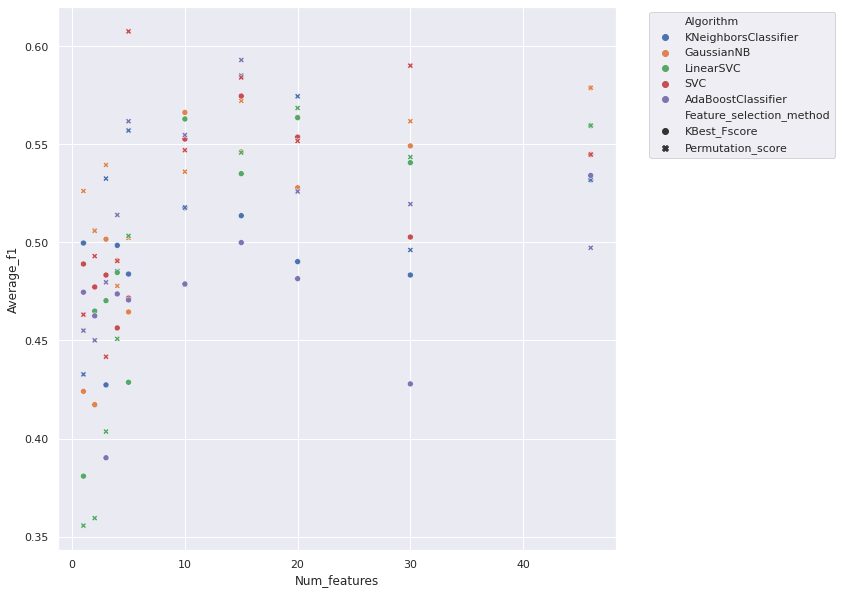

/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/sklearn/svm/_base.py:986: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/sklearn/svm/_base.py:986: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/sklearn/svm/_base.py:986: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/sklearn/svm/_base.py:986: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", Converge

In [43]:
plt.clf()
sns.scatterplot(
    x=red_feat_score_df['Num_features'], y=red_feat_score_df['Average_f1'],
    hue=red_feat_score_df['Algorithm'], style=red_feat_score_df['Feature_selection_method']
)
plt.legend(bbox_to_anchor=(1.05,1))
plt.savefig('{}/Number_of_features_vs_performance_scatter_plot.svg'.format(ml_3_classes.results_dir))
plt.show()

Model performance reaches a plateau by ~5-10 features (depending upon the algorithm). So, appears that whilst the additional peptides outside of this top 5-10 don't contribute much new information, they also don't contribute sufficient noise to cause model performance to decline.

(Again, issues with convergence of some of the LinearSVC models => will not select these models for comparison with the original GaussianNB model).

In [44]:
sub_red_feat_score_df = red_feat_score_df[
      (red_feat_score_df['Num_features'] == 5)
    & (red_feat_score_df['Feature_selection_method'] == 'Permutation_score')
].reset_index(drop=True)

In [45]:
sub_red_feat_score_df

,Algorithm,Resampling_method,Feature_selection_method,Num_features,Average_accuracy,Std_dev_accuracy,Average_recall,Std_dev_recall,Average_precision,Std_dev_precision,Average_f1,Std_dev_f1
0,KNeighborsClassifier,no_balancing,Permutation_score,5,0.560041,0.128561,0.560041,0.128561,0.587201,0.143995,0.557030,0.130322
1,GaussianNB,no_balancing,Permutation_score,5,0.530021,0.102908,0.530021,0.102908,0.523490,0.102887,0.502275,0.102235
2,LinearSVC,no_balancing,Permutation_score,5,0.530538,0.075991,0.530538,0.075991,0.538569,0.088570,0.503314,0.067687
3,SVC,no_balancing,Permutation_score,5,0.615424,0.095928,0.615424,0.095928,0.625060,0.119465,0.607543,0.104662
4,AdaBoostClassifier,no_balancing,Permutation_score,5,0.578416,0.076876,0.578416,0.076876,0.628943,0.098070,0.561745,0.089818


Most of the algorithms perform similarly well, but will select SVC classifier as it has the highest performance scores across three of the four metrics.

In [46]:
red_feat_searches['SVC__no_balancing__Permutation_score__5']['outer_loop_params']

[OrderedDict([('random_state', 1),
              ('C', 8.0),
              ('gamma', 0.125),
              ('kernel', 'rbf')]),
 OrderedDict([('random_state', 1),
              ('C', 8.0),
              ('gamma', 0.125),
              ('kernel', 'rbf')]),
 OrderedDict([('random_state', 1),
              ('C', 32.0),
              ('gamma', 0.0625),
              ('kernel', 'rbf')]),
 OrderedDict([('random_state', 1),
              ('C', 4096.0),
              ('gamma', 0.0009765625),
              ('kernel', 'rbf')]),
 OrderedDict([('random_state', 1),
              ('C', 2.0),
              ('gamma', 0.125),
              ('kernel', 'rbf')]),
 OrderedDict([('random_state', 1),
              ('C', 64.0),
              ('gamma', 0.03125),
              ('kernel', 'rbf')]),
 OrderedDict([('random_state', 1),
              ('C', 32768.0),
              ('gamma', 0.00048828125),
              ('kernel', 'rbf')])]

In [47]:
red_feat_searches['SVC__no_balancing__Permutation_score__5']['best_outer_loop_params']

OrderedDict([('accuracy',
              OrderedDict([('random_state', 1),
                           ('C', 32.0),
                           ('gamma', 0.0625),
                           ('kernel', 'rbf')])),
             ('recall',
              OrderedDict([('random_state', 1),
                           ('C', 32.0),
                           ('gamma', 0.0625),
                           ('kernel', 'rbf')])),
             ('precision',
              OrderedDict([('random_state', 1),
                           ('C', 32768.0),
                           ('gamma', 0.00048828125),
                           ('kernel', 'rbf')])),
             ('f1',
              OrderedDict([('random_state', 1),
                           ('C', 32.0),
                           ('gamma', 0.0625),
                           ('kernel', 'rbf')]))])

In [48]:
red_feat_nested_pred = red_feat_searches['SVC__no_balancing__Permutation_score__5']['predictions']
red_feat_nested_y_true = red_feat_searches['SVC__no_balancing__Permutation_score__5']['y_true']
red_feat_nested_x_true = red_feat_searches['SVC__no_balancing__Permutation_score__5']['x_true']

red_feat_flat_pred = np.array([pred for pred_array in red_feat_nested_pred for pred in pred_array])
red_feat_flat_y_true = np.array([y for y_array in red_feat_nested_y_true for y in y_array])
red_feat_flat_x_true = np.array([x for x_array in red_feat_nested_x_true for x in x_array])

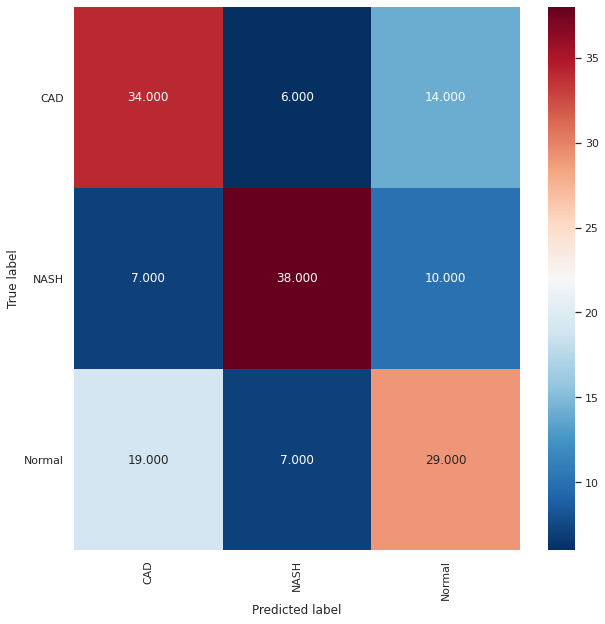

Normalised over true label (rows)


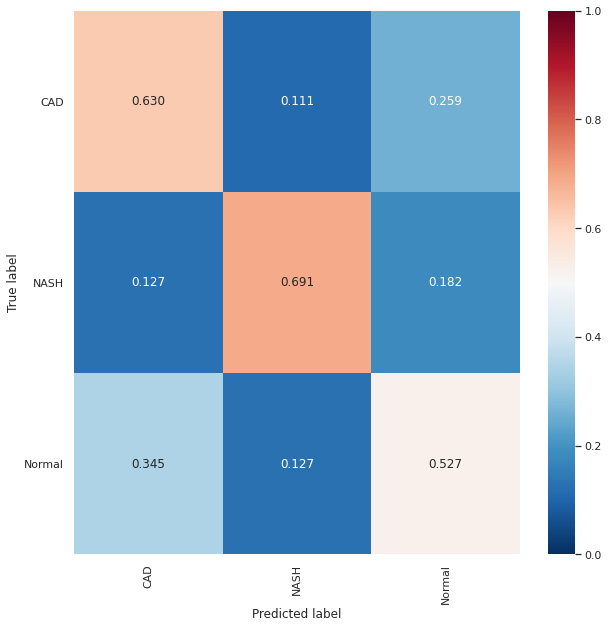

Normalised over pred label (columns)


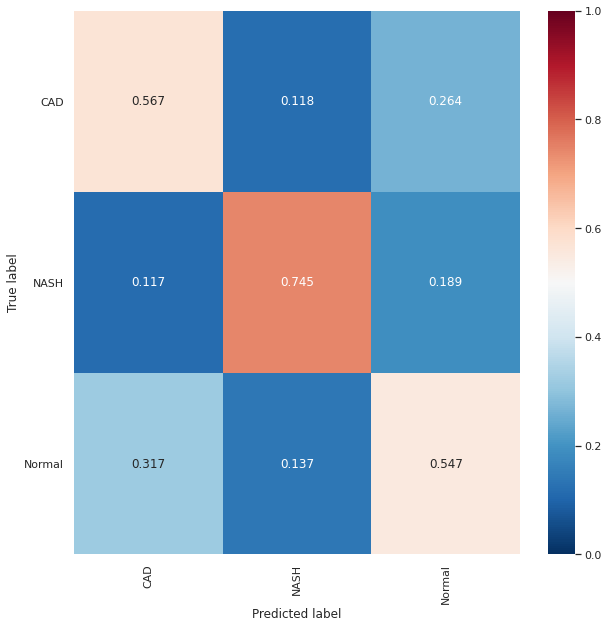

In [49]:
draw_conf_matrices(red_feat_flat_y_true, red_feat_flat_pred, ml_3_classes.results_dir, 'Red_features')

In [50]:
red_feat_true_hue = []
for index, y in enumerate(red_feat_flat_y_true):
    if red_feat_flat_pred[index] == y:
        red_feat_true_hue.append('{}_correct'.format(y))
    else:
        red_feat_true_hue.append('{}_incorrect'.format(y))

sub_red_feat_true_hue = []
sub_red_feat_flat_x_true = []
sub_red_feat_flat_y_true = []
for i, true_hue in enumerate(red_feat_true_hue):
    if true_hue.endswith('_incorrect'):
        sub_red_feat_true_hue.append(true_hue)
        sub_red_feat_flat_x_true.append(red_feat_flat_x_true[i])
        sub_red_feat_flat_y_true.append(red_feat_flat_y_true[i])

red_feat_true_hue = np.array(red_feat_true_hue)
sub_red_feat_true_hue = np.array(sub_red_feat_true_hue)
sub_red_feat_flat_x_true = np.array(sub_red_feat_flat_x_true)
sub_red_feat_flat_y_true = np.array(sub_red_feat_flat_y_true)

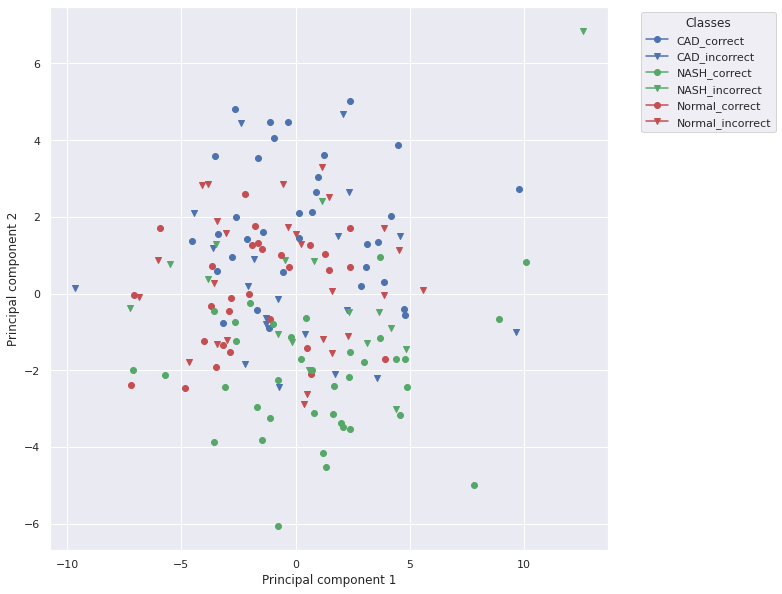

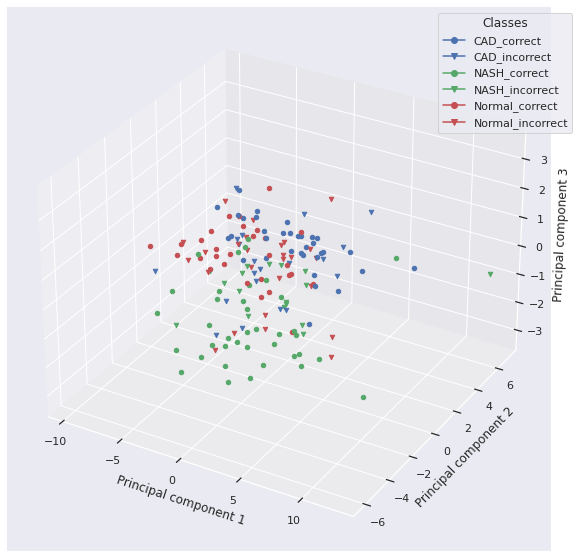

In [51]:
# Scatter plot (axes = top two principal components)
ml_3_classes.plot_scatter_on_pca_axes(
    x=red_feat_flat_x_true, y=red_feat_flat_y_true, subclasses=red_feat_true_hue, num_dimensions=2,
    scale=True, plt_name='Red_features_coloured_by_pred'
)

# Scatter plot (axes = top three principal components)
ml_3_classes.plot_scatter_on_pca_axes(
    x=red_feat_flat_x_true, y=red_feat_flat_y_true, subclasses=red_feat_true_hue, num_dimensions=3,
    scale=True, plt_name='Red_features_coloured_by_pred'
)

# NASH_incorrect = Value that is actually NASH is predicted to be something else

So, SVC model trained with just 5 peptides performs similarly well to a GaussianNB model trained with all features. Unfortunately feature reduction doesn't appear to lead to any improvement in model performance.

Is there a significant difference between the two models?

In [52]:
params_1 = all_feat_searches['GaussianNB__no_balancing']['best_outer_loop_params']['f1']
selected_features_1 = list(ml_3_classes.features)
params_2 = red_feat_searches['SVC__no_balancing__Permutation_score__5']['best_outer_loop_params']['f1']
selected_features_2 = mean_permut_feat_importances_df['Feature'].tolist()[:5]

print('Model 1:')
print('Algorithm: GaussianNB')
print('Parameters:\n{}'.format(params_1))
print('Features:\n{}'.format(selected_features_1))
print('\n\n\n')
print('Model 2:')
print('Algorithm: SVC')
print('Parameters:\n{}'.format(params_2))
print('Features:\n{}'.format(selected_features_2))

F, p = ml_3_classes.run_group_5x2_CV_combined_F_test(
    x=ml_3_classes.x, y=ml_3_classes.y, groups=ml_3_classes.sub_classes, selected_features_1=selected_features_1,
    selected_features_2=selected_features_2, classifier_1=GaussianNB, classifier_2=SVC, params_1=params_1,
    params_2=params_2, resampling_method_1='no_balancing', resampling_method_2='no_balancing',
    n_components_pca_1=None, n_components_pca_2=None
)

Model 1:
Algorithm: GaussianNB
Parameters:
OrderedDict()
Features:
['DPH_CCPent', 'DPH_QLKEIA', 'DPH_CCHex2-I24K', 'DPH_CCHept-I24N', 'DPH_CCHept-L28W', 'DPH_GRP22', 'DPH_CCHex', 'DPH_NLKEIA', 'DPH_CCHept-L28K', 'DPH_CCHept-I24T', 'DPH_CCHept-L7Y', 'DPH_CCHex2', 'DPH_CCHept-I17G-L21G', 'DPH_CCHept-I17H', 'DPH_CCHept-I24H', 'DPH_CCHept-L28Y', 'DPH_GRP46', 'DPH_CCHept', 'DPH_CCHept-I17A-L21A', 'DPH_CCHept-I17K-L24E', 'DPH_CCHept-L21S-I24S', 'DPH_CCHept-I24Y', 'DPH_GRP51', 'DPH_CCHept-I24D', 'DPH_CCHept-L14A', 'DPH_CCHept-L7K', 'DPH_CCHept-L21N-I24N', 'DPH_CCHept-L21S-I24Y', 'DPH_GRP52', 'DPH_CCHept-I24E', 'DPH_CCHept-L21A', 'DPH_CCHept-L21K-I24E', 'DPH_CCHept-L21T-I24T', 'DPH_CCHept-L21Y-I24S', 'DPH_GRP63', 'DPH_CCHept-I24K', 'DPH_CCHept-L21K', 'DPH_CCHept-L21E-I24K', 'DPH_CCHept-L21H-I24H', 'DPH_CCHept-I17T', 'DPH_GRP80', 'DPH_CCHept-I17K', 'DPH_CCPent-I24K', 'DPH_CCHept-I24S', 'DPH_CCHept-L7W', 'DPH_CCHept-I24P']




Model 2:
Algorithm: SVC
Parameters:
OrderedDict([('random_state', 1),

In [53]:
print('F score: {}'.format(F))
print('p value: {}'.format(p))

F score: 0.8072621192262355
p value: 0.6396082301816277


So, there is no significant difference in performance when reduce the number of peptides from 46 to 5.